<a href="https://colab.research.google.com/github/hzoscar/ds_challenge_2_Data_Insider/blob/main/challenge_3_data_insider.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Insider

In this challenge that corresponds to **The second challenge of the Alura LATAM Data Science challenges**, The objective is to produce a detailed report to objectively understand the behavior of large corporations worldwide using the different editions of Forbes 2000 from 2015 onwards. I was provided with all the data until 2022 and I included the Forbes 2000 edition 2023 dataset  from:

https://data.world/aroissues/forbes-global-2000-2008-2019

To make things interesting we were also provided with the different editions of Fortune 500 from 2015 onwards. The idea was to merge all Forbes 2000 datasets from 2015 to 2022 with the Fortune Global 500 datasets and try to locate the names of companies appearing on the Fortune list that did not correspond to the Forbes list. This was the most challenging part, but without a doubt the part I learned the most from!  I got help from the library **fuzzywuzzy**. All the code related to this part of the challenge is found in the section 4 **Table Summarisation and Exploratory Analysis**.

After the datasets were ready, analyses and insights are documented as the questionnaires provided, to guide us, are answered. For each question we were asked to make a graph. Furthermore, I did a couple of **racing bar chart** suggested by the challenge.

In addition to what was asked I added three sections. Two of them related to analysis done by me (From those analysis **I made a presentation that it is found in this repository**) and one dedicated to an interactive bubble plot by using the library: **bubbly**.

There are plenty of other things that I learned from this challenge, all of them related to **data visualization using seaborn and matplotlib**.

The challenge is divided into 8 parts:

**1. Setting up the environment:**  In the first part, the working environment is prepared by installing all the libraries needed.

**2. Data collection:** The databases to work with are imported and it is obtained the historical data of the shares of 5 companies of the same industry by using **the API of polygon**.

**3. Data Wrangling:** the aim is to transform raw data into clean, coherent data to be analysed using a range of data visualisation techniques.

**4. Table Summarisation and Exploratory Analysis:** The aim is to merge all the datasets provided. **the most challenging part**

**5. Data query:** There are 2 questionnaires with several questions to guide us in the analysis. For each question, a plot is made.

**6. Insights:** In this section, there are further analysis about the datasets provided.

**7. Bubble plot:** In this section there is an interactive bubble plot.

**8. Insights - 2:** In this sections there are further analysis about the datasets provided. From these analysis **I made a presentation that it is found in this repository**



---
#1. Setting up the environment
---




In [ ]:
pip install polygon

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.3/111.3 kB 870.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.8/77.8 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 6.5 MB/s eta 0:00:00


In [ ]:
pip install fuzzywuzzy

In [ ]:
pip install bar_chart_race

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 156.8/156.8 kB 3.9 MB/s eta 0:00:00


In [ ]:
pip install bubbly

  Preparing metadata (setup.py) ... done
  Created wheel for bubbly: filename=bubbly-1.0.2-py3-none-any.whl size=5415 sha256=a45efd51b7c0f17e32b32c3261b4e8748affd8ac7aa1d7a98884a9e2d7c3099a
  Stored in directory: /root/.cache/pip/wheels/dc/b4/ab/043c77f064dbbb38983593a3bed54363cc1910d0fb20ba6f66
Successfully built bubbly


In [ ]:
import polygon
from polygon import StocksClient
from datetime import date, datetime, timedelta
from dateutil.relativedelta import relativedelta
import pandas as pd
from pandas import json_normalize
from fuzzywuzzy import fuzz, process
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import bar_chart_race as bcr
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")
from bubbly.bubbly import bubbleplot
from __future__ import division
import plotly.graph_objects as go
from IPython.display import HTML
import matplotlib as mpl
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colorbar import ColorbarBase
from matplotlib.colors import Normalize

/usr/local/lib/python3.10/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive



---
# 2. Data collection
---



## 2.1 Obtaining data from Polygon

In [ ]:
# industry retailing
walmart_index='WMT'
amazon_index='AMZN'
the_home_depot_index='HD'
costco_index='COST'
lowes_index='LOW'

In [ ]:
api_key = 'jxVFNPuynNRIKllvOolKd9zXLT2yfOqt'
stocks_client = polygon.StocksClient(api_key)

In [ ]:
# this function is responsible for obtaining and preparing stock price data
# for a specific company using the Polygon API, returning a structured DataFrame
# with this information.
def getting_data_from_polygon(name_company,symbol):

  # get yesterday's date
  yesterday = date.today()- timedelta(days=1)

  # Get the date from a year ago from yesterday
  one_year_ago_from_yesterday= yesterday - relativedelta(years=1)

  # Get share price data from Polygon
  json_file= stocks_client.get_aggregate_bars(symbol=symbol,from_date= one_year_ago_from_yesterday,to_date= yesterday,adjusted=True,sort='desc',multiplier=1,timespan='day')
  json_copy=json_file.copy()
  # Normalise the JSON and convert it to a pandas DataFrame
  df = json_normalize(json_copy['results'])

  # Remove unwanted columns
  if 'otc' in df.columns:
    df.drop(['v', 'vw', 'n', 'otc'],axis=1,inplace=True)
  else:
    df.drop(['v', 'vw', 'n'],axis=1,inplace=True)

  # Rename columns
  new_columns=['precio_apertura','precio_cierre','precio_max','precio_min','fecha']
  change_columns=dict(zip(df.columns,new_columns))
  df.rename(columns=change_columns,inplace=True)

  # Add column 'symbol' with company name
  df['simbolo']=name_company

  # Reorder columns
  df=df[['simbolo','fecha','precio_apertura', 'precio_cierre', 'precio_max', 'precio_min']]

  # Convert the column 'date' to the appropriate date format and set as index
  df = df.assign(date=lambda x: pd.to_datetime(x['fecha'], unit='ms').dt.date)
  df=df.set_index('fecha')

  return df

In [ ]:
# Obtain share price data for some companies in the retailing industry.

df_walmart=getting_data_from_polygon('walmart',walmart_index)
df_amazon=getting_data_from_polygon('amazon',amazon_index)
df_the_home_depot=getting_data_from_polygon('the_home_depot',the_home_depot_index)
df_costco=getting_data_from_polygon('costco',costco_index)
df_lowes=getting_data_from_polygon('lowes',lowes_index)

In [ ]:
# Saving the data of companies in the retailing industry

df_walmart.to_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/walmart.csv',)
df_amazon.to_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/amazon.csv')
df_the_home_depot.to_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/the_home_depot.csv')
df_costco.to_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/costco.csv')
df_lowes.to_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/lowes.csv')

## 2.2 Forbes Global 2000 from 2008 to 2022 datasets

In [ ]:
# Se crea una lista llamada dataframes_forbes y se llena con los DataFrames
# provenientes de archivos Excel correspondientes a diferentes años.
dataframes_forbes=[]

# Iterar sobre los años desde 2008 hasta 2022 (incluso)
for i in range(2008,2023):
  # Construir la ruta del archivo Excel para el año actual
  path='/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/aroissues-forbes-global-2000-2008-2019/aroissues-forbes-global-2000-2008-2019/Forbes Global 2000 - '+str(i)+' — unified industry.xlsx'

  # Leer el archivo Excel y cargarlo en un DataFrame
  df = pd.read_excel(path)

  # Agregar el DataFrame a la lista de DataFrames de Forbes
  dataframes_forbes.append(df)

In [ ]:
dataframes_forbes[0].head()

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
0,1,HSBC Holdings,Banking,United Kingdom,146500.0,19130.0,2348980.0,180810.0
1,2,General Electric,Conglomerates,United States,172740.0,22210.0,795340.0,330930.0
2,3,Bank of America,Banking,United States,119190.0,14980.0,1715750.0,176530.0
3,4,JPMorgan Chase,Banking,United States,116350.0,15370.0,1562150.0,136880.0
4,5,ExxonMobil,Oil & Gas Operations,United States,358600.0,40610.0,242080.0,465510.0


## 2.3 Fortune Global 500 from 2008 to 2022 datasets

In [ ]:
# Lista para almacenar los DataFrames de Fortune
dataframes_fortune=[]

# Iterar sobre los años desde 2015 hasta 2022 (incluso)
for i in range(2015,2023):
  # Construir la ruta del archivo HTML para el año actual
  path='/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/fortune_global_500/fortune_global_'+str(i)+'.html'

  # Leer el archivo HTML y cargarlo en un DataFrame
  df = pd.read_html(path)[0]

  # Agregar el DataFrame a la lista de DataFrames de Fortune
  dataframes_fortune.append(df)

In [ ]:
# Mostrar las primeras filas del primer DataFrame de la lista dataframes?fortune
dataframes_fortune[7].head()

,RemoveRank,RemoveName,RemoveRevenues ($M),RemoveRevenue Percent Change,RemoveProfits ($M),RemoveProfits Percent Change,RemoveAssets ($M),RemoveEmployees,RemoveChange in Rank,RemoveYears on Global 500 List
0,1,Walmart,"$572,754",2.4%,"$13,673",1.2%,"$244,860",2300000,-,28
1,2,Amazon,"$469,822",21.7%,"$33,364",56.4%,"$420,549",1608000,1,14
2,3,State Grid,"$460,616.9",19.1%,"$7,137.8",27.9%,"$735,429.9",871145,-1,22
3,4,China National Petroleum,"$411,692.9",45%,"$9,637.5",110.6%,"$660,007.6",1090345,-,22
4,5,Sinopec Group,"$401,313.5",41.4%,"$8,316.1",34%,"$380,674.7",542286,-,24


## 2.4 Geographic data collection

In [ ]:
continentes=pd.read_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/continentes_y_paises/continente.csv')

paises=pd.read_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/continentes_y_paises/country_code.csv')

## 2.5 Forbes Global 2000 2023 dataset

In [ ]:
forbes_2023 = pd.read_excel('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/file_2023/Forbes Global 2000 - 2023   unified industry.xlsx')

## 2.6 Fortune Global 500 2023 dataset

In [ ]:
fortune_2023 = pd.read_excel('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/file_2023/fortune_500_2023.xlsx')

---
# 3. Data Wrangling
---



## 3.1 Forbes Global 2000 datasets (2015 - 2023)

In [ ]:
# Dado que el análisis se hará a partir del año 2015
# se hace el tratamiento de errores (imputación) desde dicho dataframe
# hasta llegar al 2022
dataframes_forbes_from_2015 = dataframes_forbes[7:]
print('En este lista los índices representan los años de la siguiente manera:\n 0 --> 2015 \n 1 --> 2016\n 2 --> 2017\n 3 --> 2018\n 4 --> 2019\n 5 --> 2020\n 6 --> 2021 \n 7 --> 2022')

En este lista los índices representan los años de la siguiente manera:
 0 --> 2015 
 1 --> 2016
 2 --> 2017
 3 --> 2018
 4 --> 2019
 5 --> 2020
 6 --> 2021 
 7 --> 2022


### 3.1.1 Imputación valores nulos (datasets 2015 - 2022)

In [ ]:
#Este código te permite ver la cantidad de valores nulos
# en cada columna de cada DataFrame de Forbes, junto con el año correspondiente.
for index, df in enumerate(dataframes_forbes_from_2015,start=2015):

  # Imprimir el índice del DataFrame actual que empieza desde 2008
  print(index)

  # Calcular y mostrar la suma de valores nulos de cada dataset
  print(f'La cantidad de valores en este dataset es {df.isnull().sum().sum()}')

  # Imprimir una línea para separar los resultados de los diferentes DataFrames
  print('______________________________________')

2015
La cantidad de valores en este dataset es 3
______________________________________
2016
La cantidad de valores en este dataset es 8
______________________________________
2017
La cantidad de valores en este dataset es 4
______________________________________
2018
La cantidad de valores en este dataset es 8
______________________________________
2019
La cantidad de valores en este dataset es 6
______________________________________
2020
La cantidad de valores en este dataset es 0
______________________________________
2021
La cantidad de valores en este dataset es 2
______________________________________
2022
La cantidad de valores en este dataset es 0
______________________________________


**Dado que todos los valuros nulos por imputar pertenecen a valores numéricos lo que se hace es reemplazar dicho valor nulo con el valor medio o con la media de la industria a la cual pertenece la empresa que tiene dichos valores nulos.**

In [ ]:
def graficar_boxplot_por_industria(numero_en_lista,variable_numerica, año):
  # Sort the DataFrame by median 'Sales' values in descending order
  sorted_df = dataframes_forbes_from_2015[numero_en_lista].groupby('Industry')[variable_numerica].median().sort_values(ascending=False).index
  sns.set_style('darkgrid')
  # Set the tick labels to appear at the top
  plt.rcParams['xtick.top'] = True

  # Slice sorted industries into groups of 11
  grupos = [sorted_df[i:i+11] for i in range(0, len(sorted_df), 11)]

  fig, axes = plt.subplots(nrows=len(grupos), figsize=(12, 4 * len(grupos)), sharex=True)
  fig.suptitle(f'Boxplot de {variable_numerica} para todas las industrias', y=1, fontsize=16,weight='bold')

  for i, grupo in enumerate(grupos):
    # Filter DataFrame to include only the categories in the current group
    df_grupo = dataframes_forbes_from_2015[numero_en_lista][dataframes_forbes_from_2015[numero_en_lista]['Industry'].isin(grupo)]

    # Set the order of 'Industry' column based on the order in 'grupo'
    df_grupo['Industry'] = pd.Categorical(df_grupo['Industry'], categories=grupo, ordered=True)

    # Create the boxplot
    sns.boxplot(y=df_grupo['Industry'], x=df_grupo[variable_numerica],
                flierprops={"marker": "x"}, medianprops={"color": "r", "linewidth": 2}, color="w", linecolor="#137", ax=axes[i])

        # Set labels and titles
    axes[i].set_ylabel('Industrias')
    axes[0].set_title(f'Forbes 2000 - Edición {año}', fontsize=16, pad=30)

  plt.tight_layout(rect=[0, 0, 1, 0.96])

  plt.show()

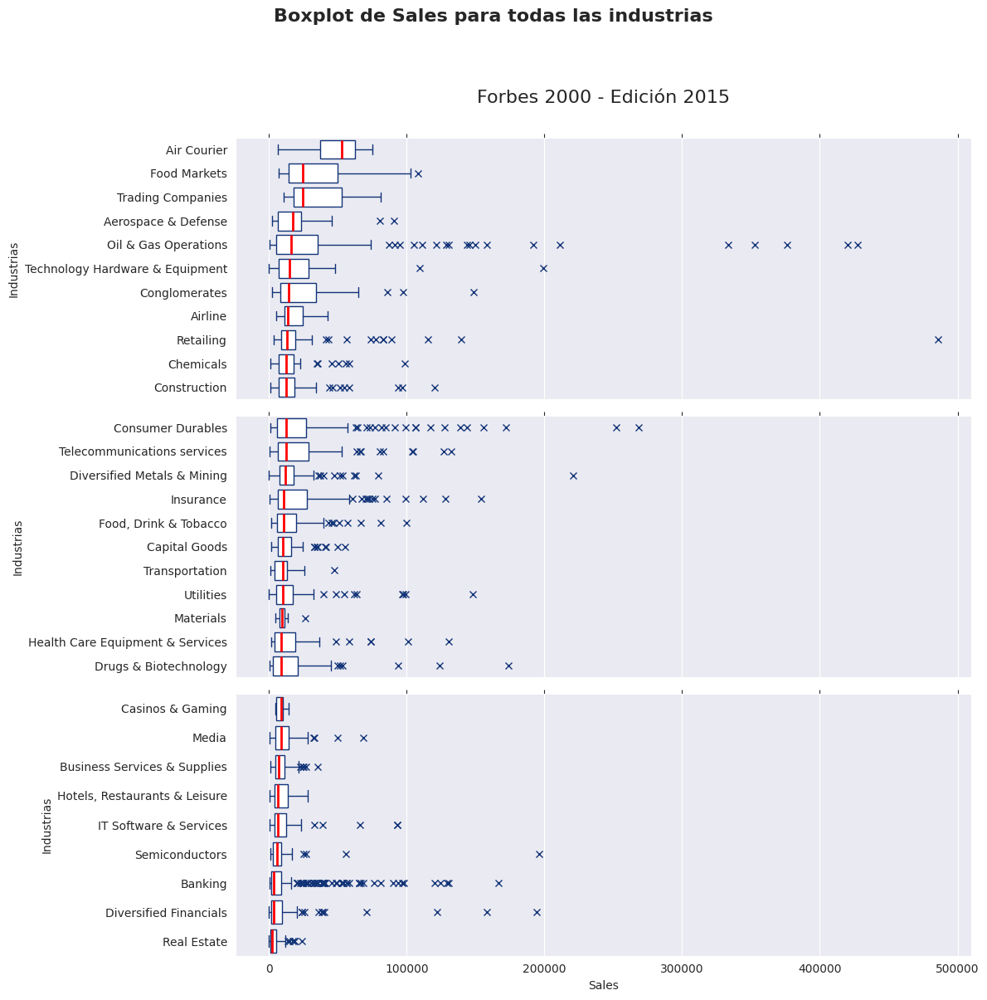

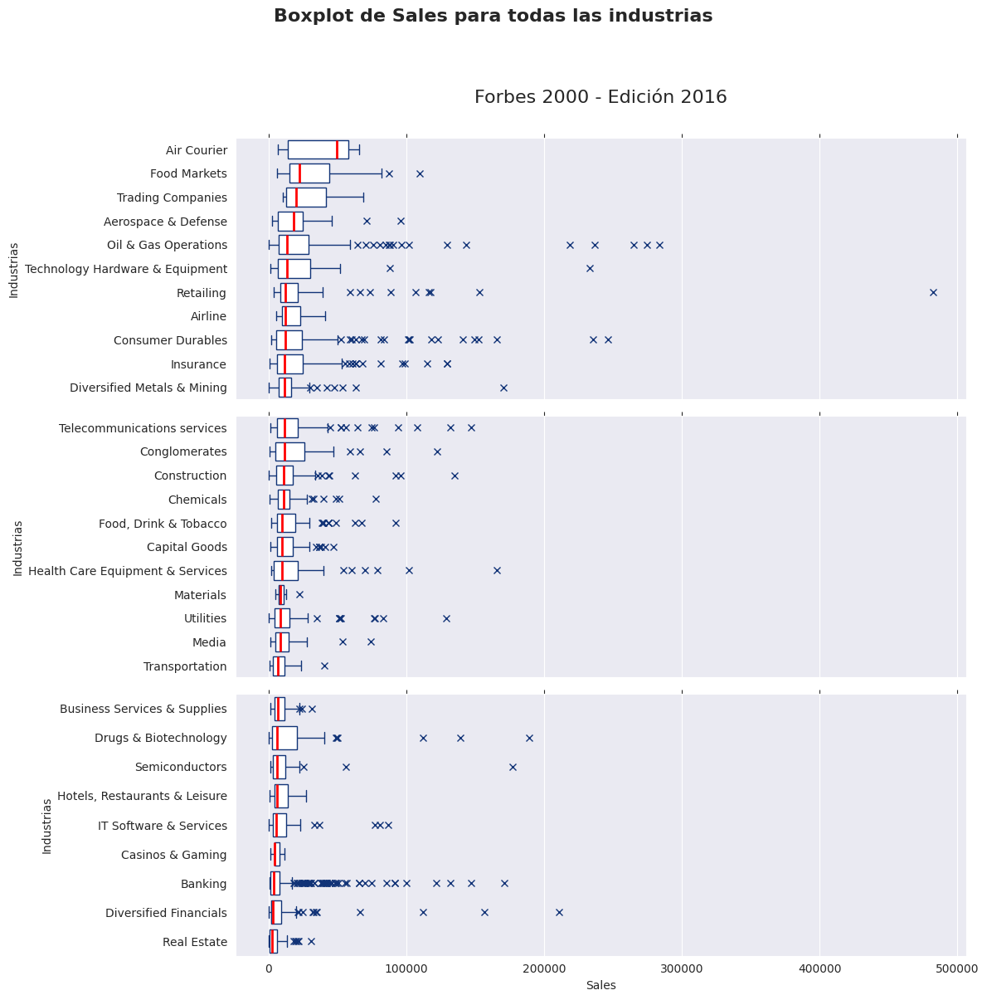

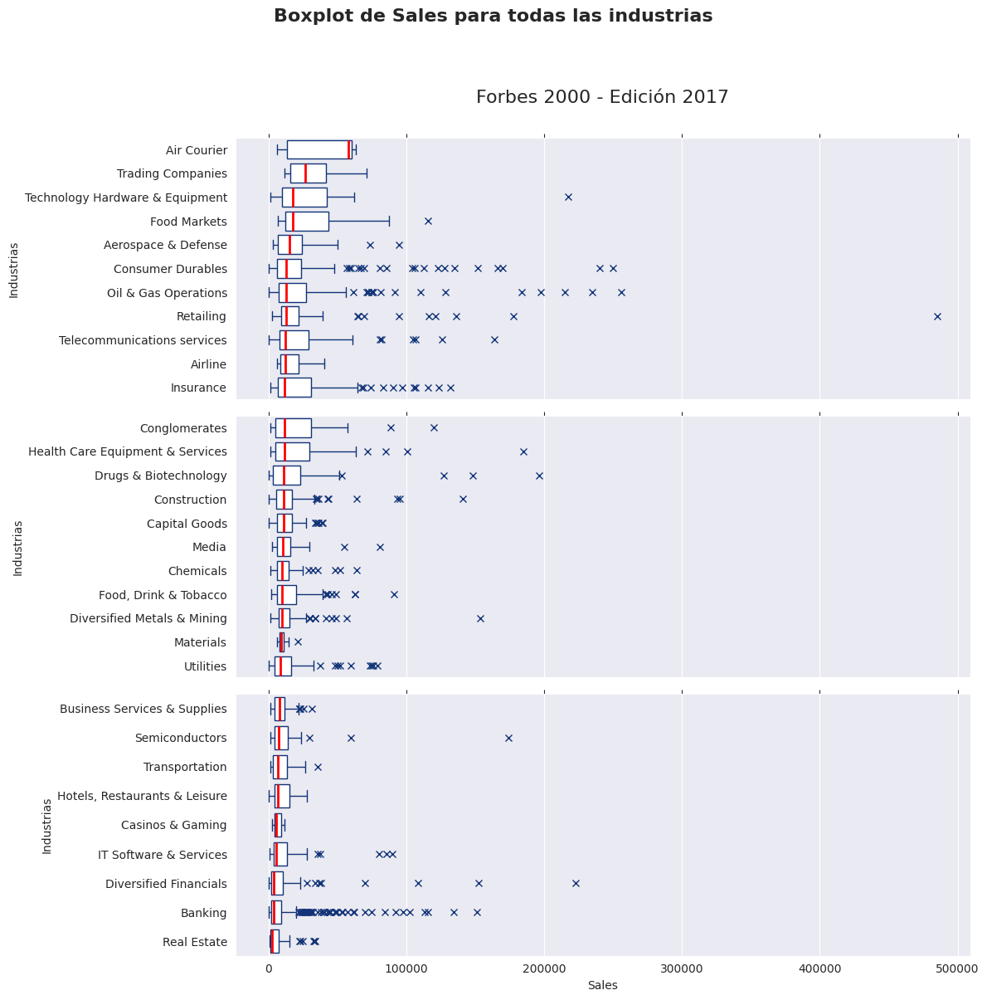

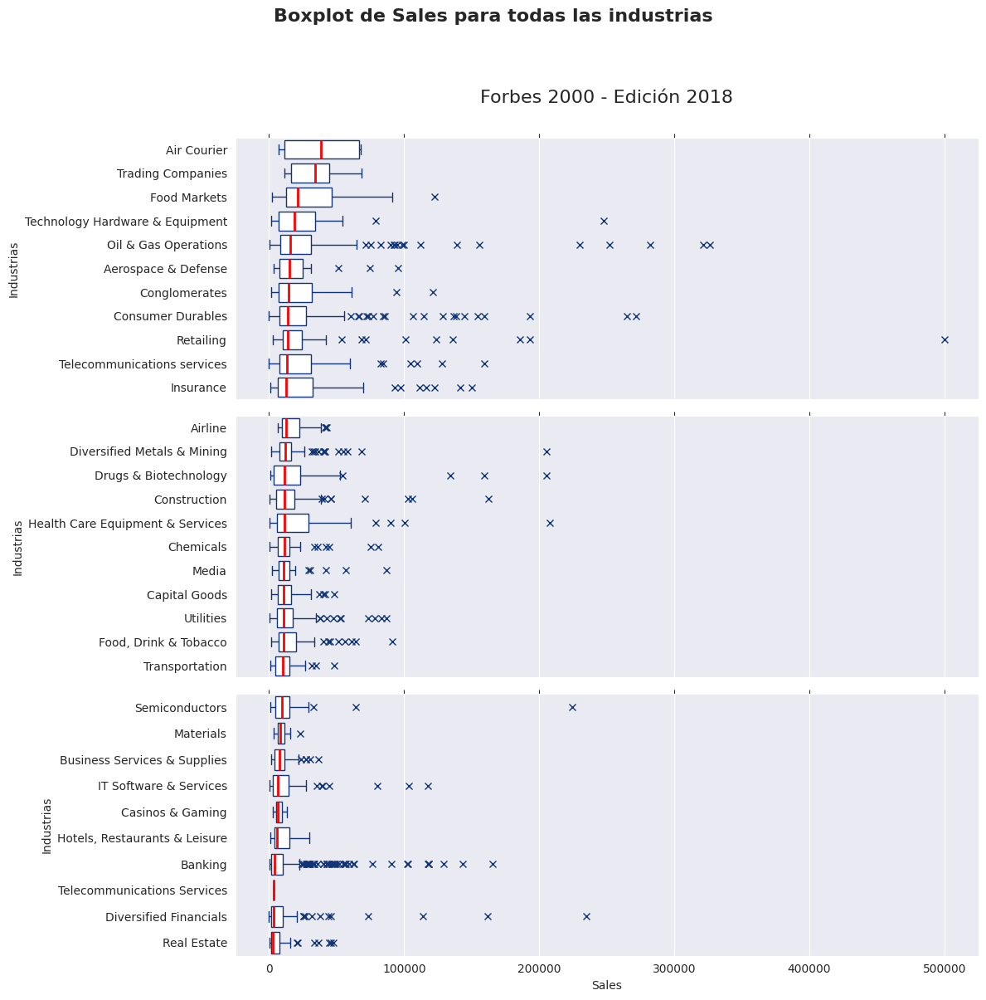

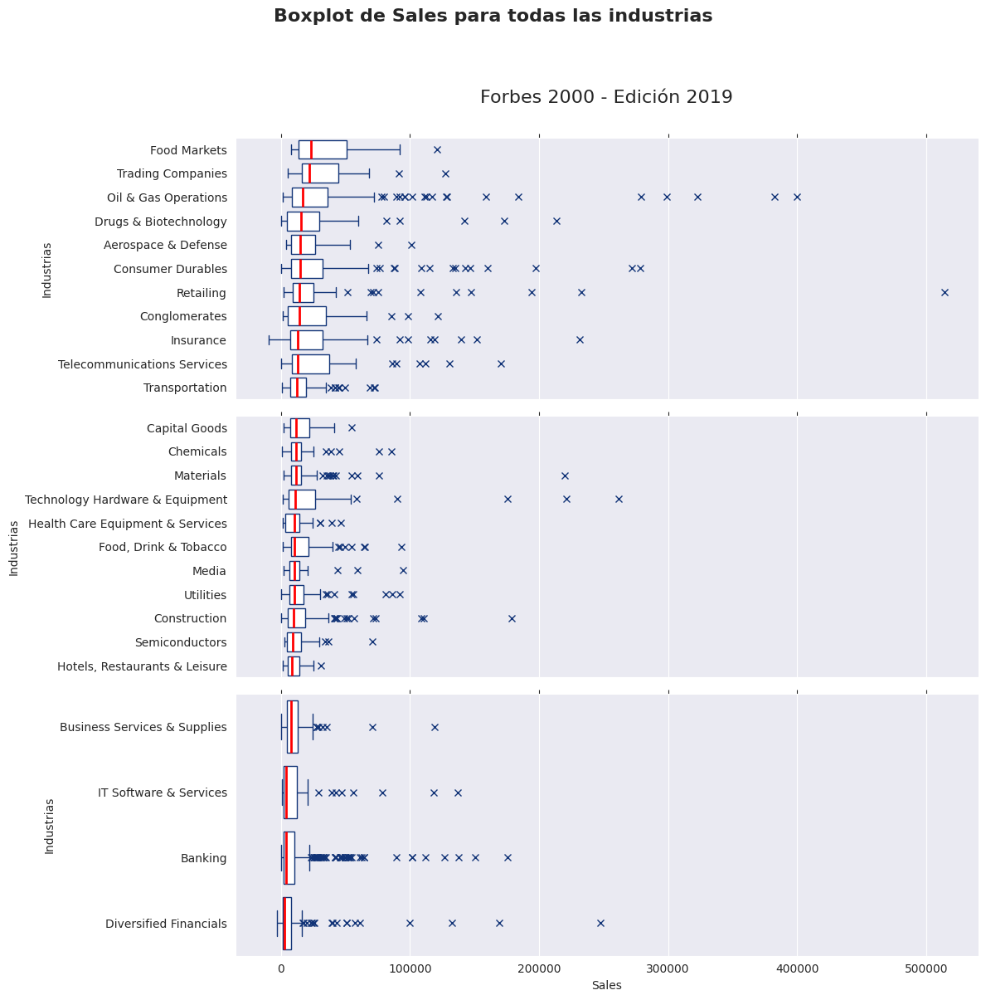

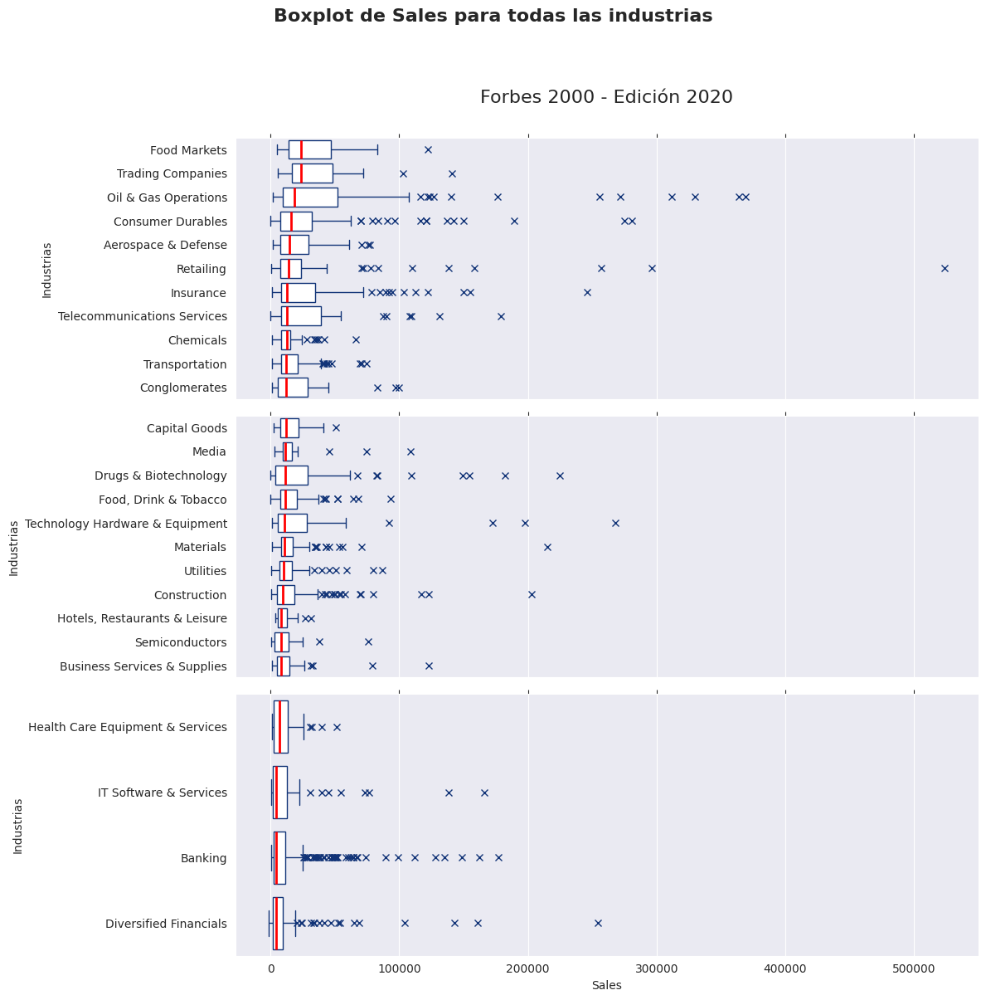

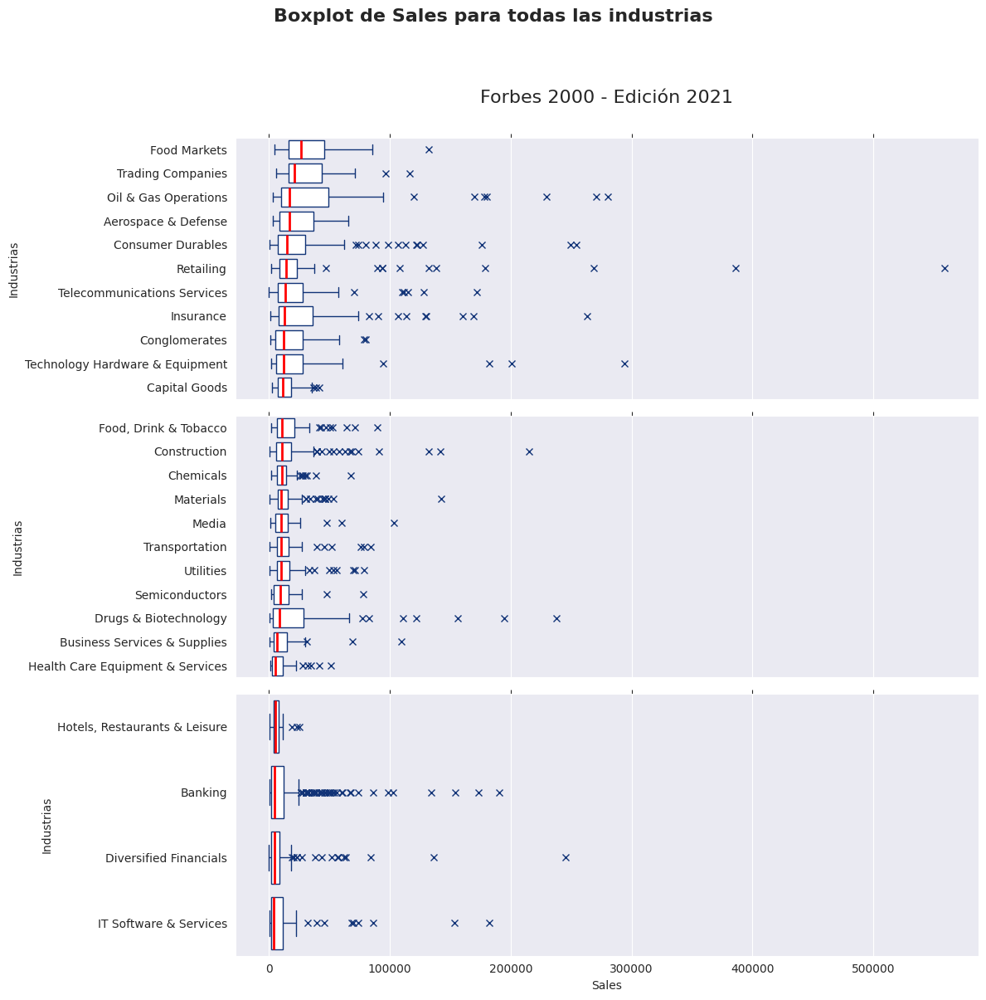

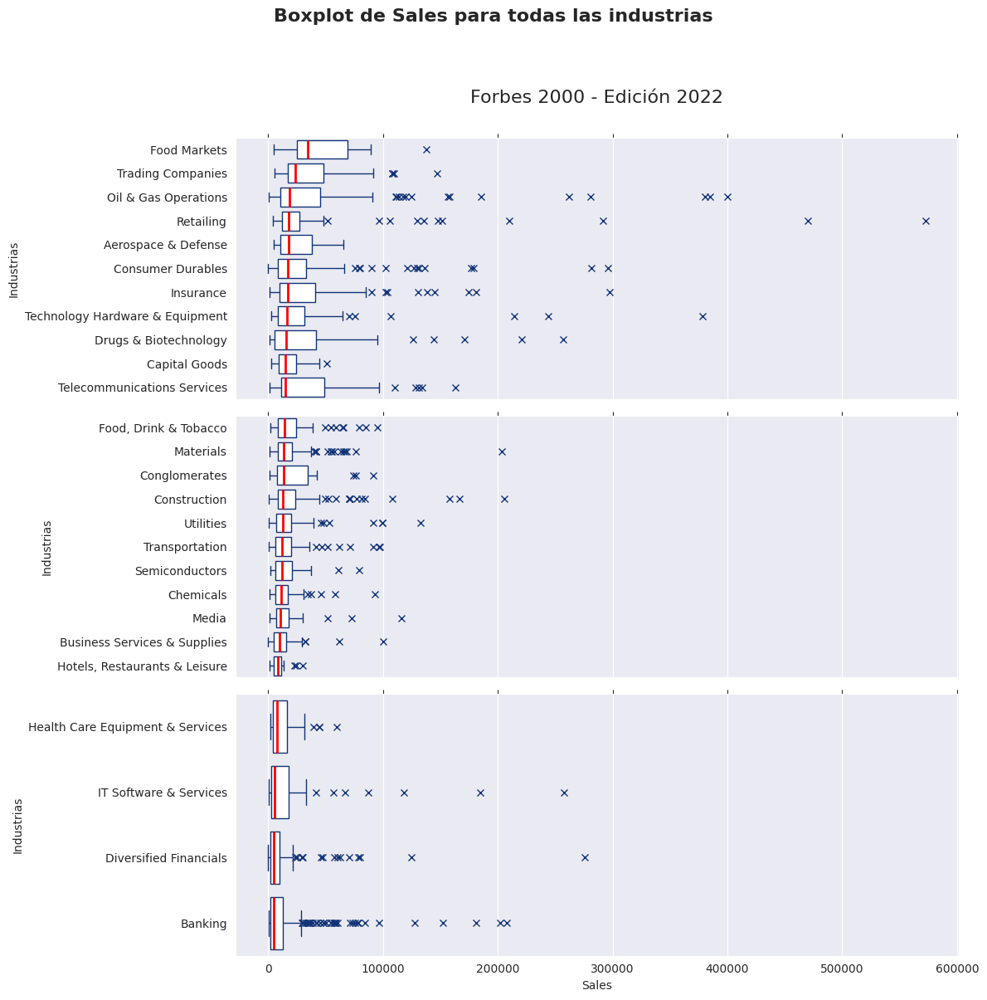

In [ ]:
for index,value in enumerate(range(2015,2023,1)):
  graficar_boxplot_por_industria(index,'Sales',value)

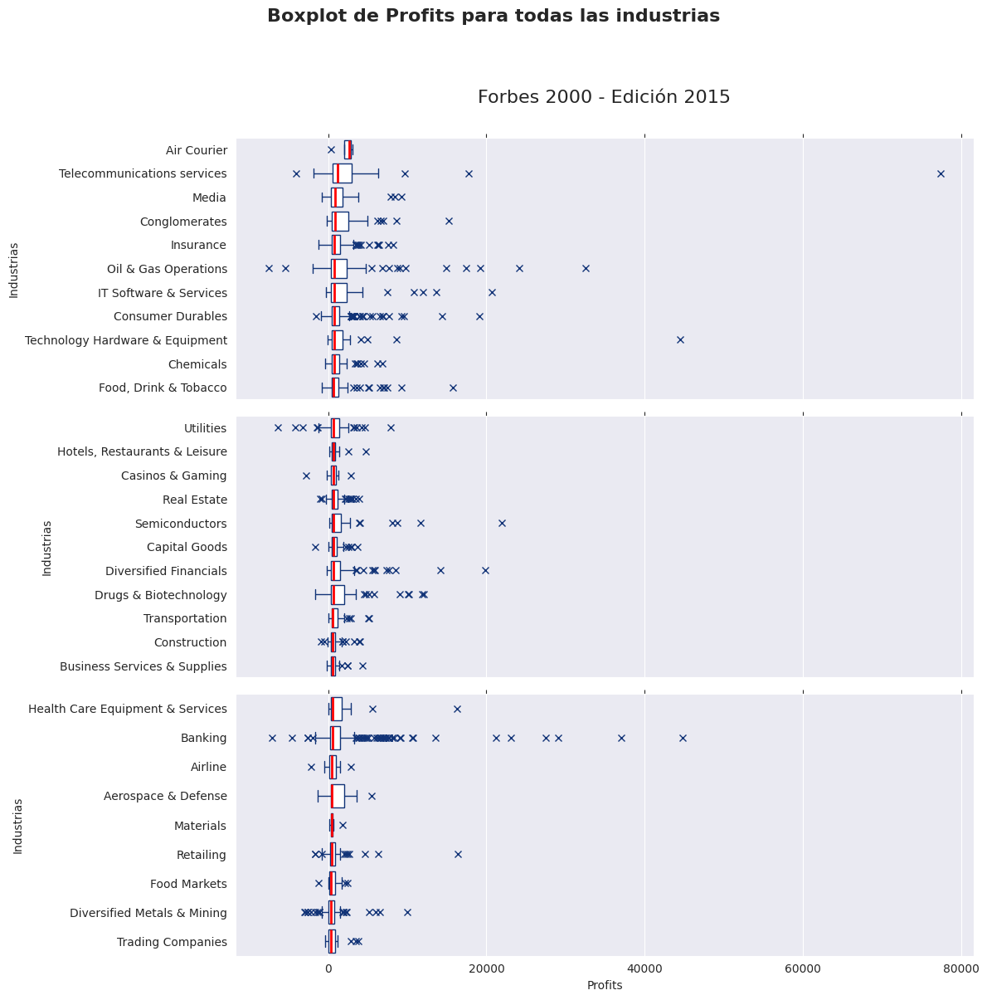

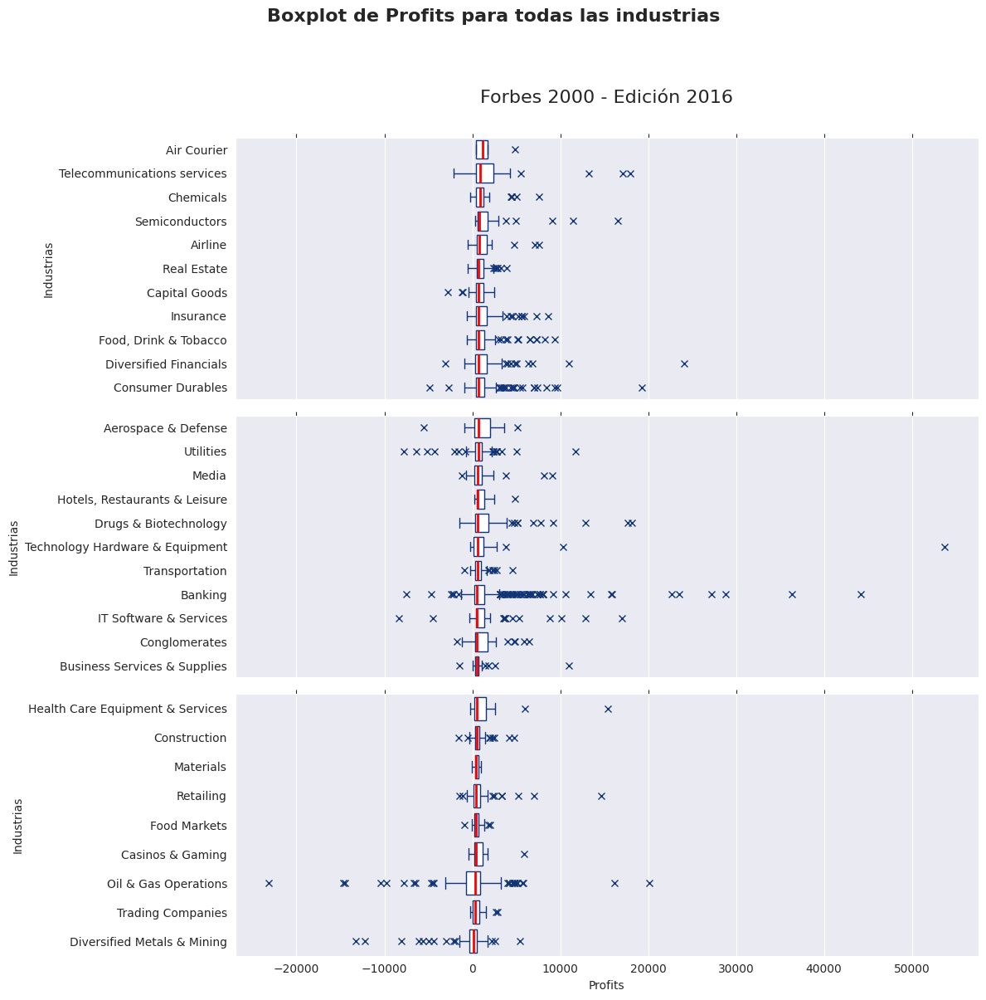

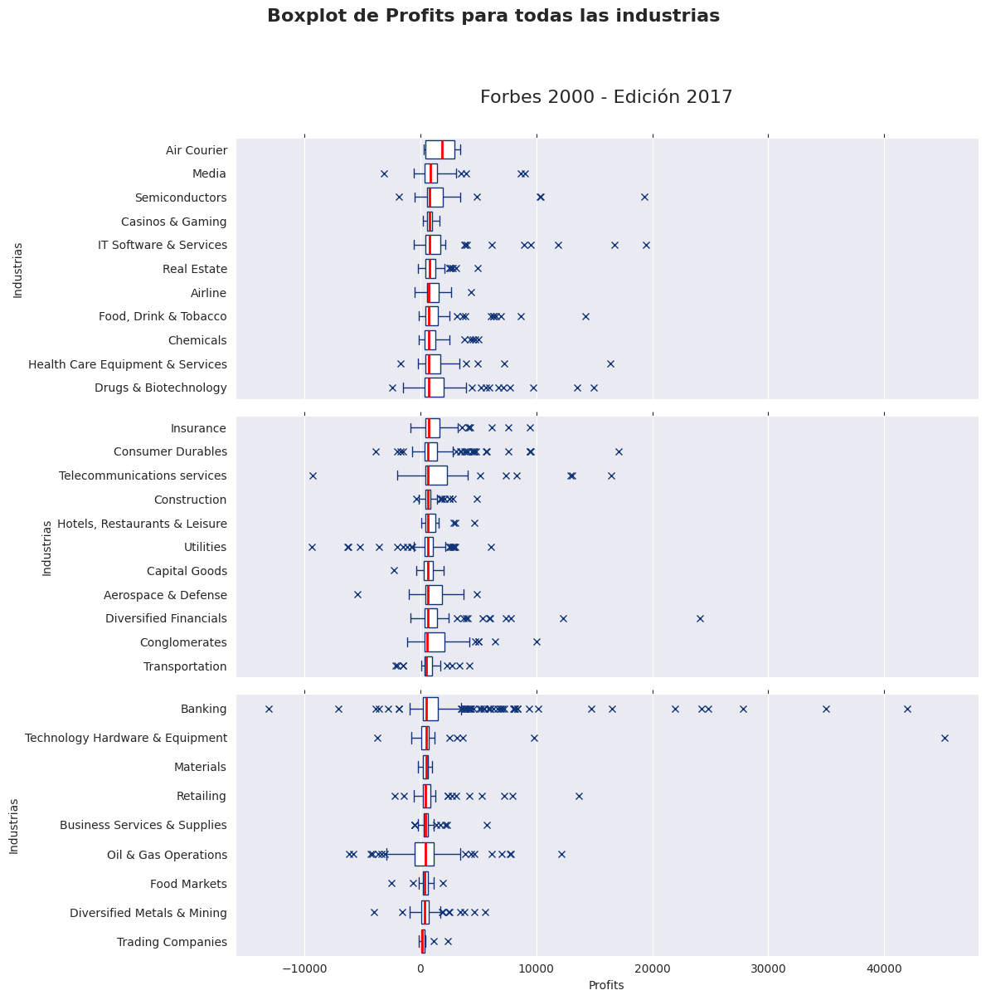

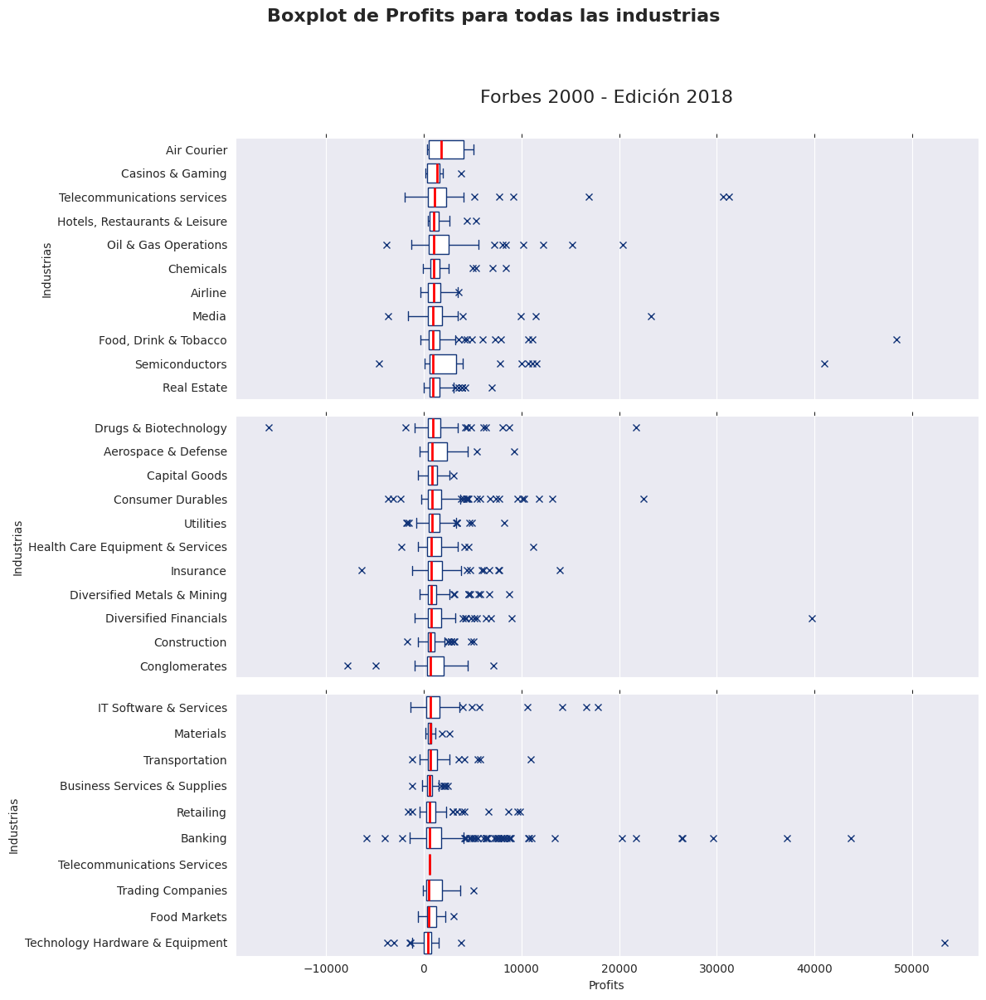

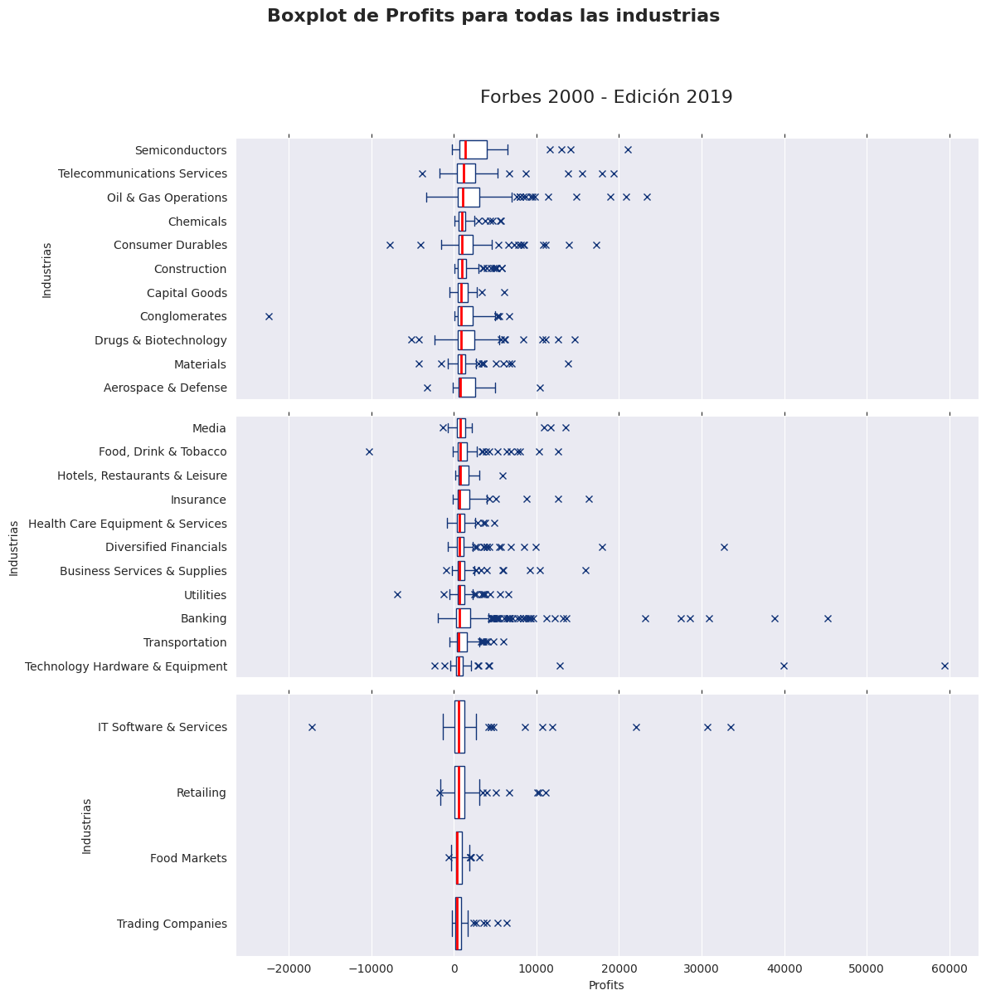

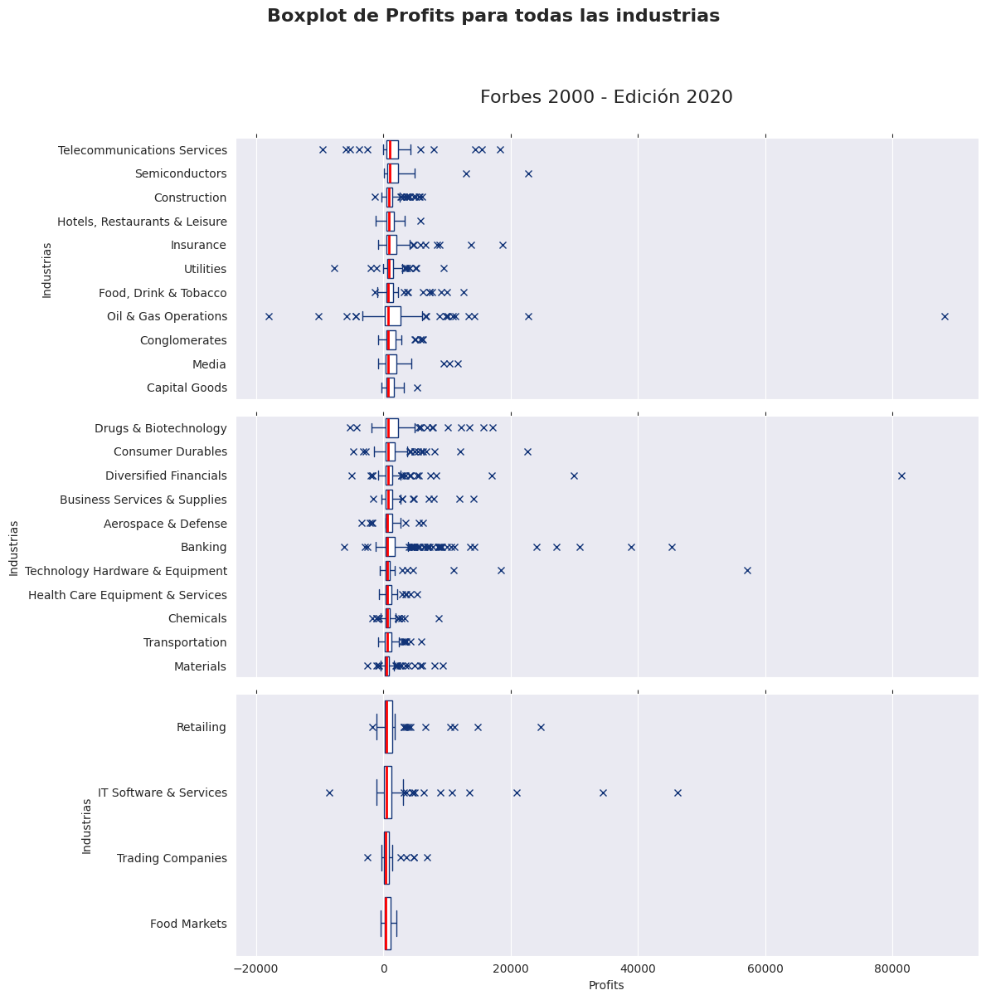

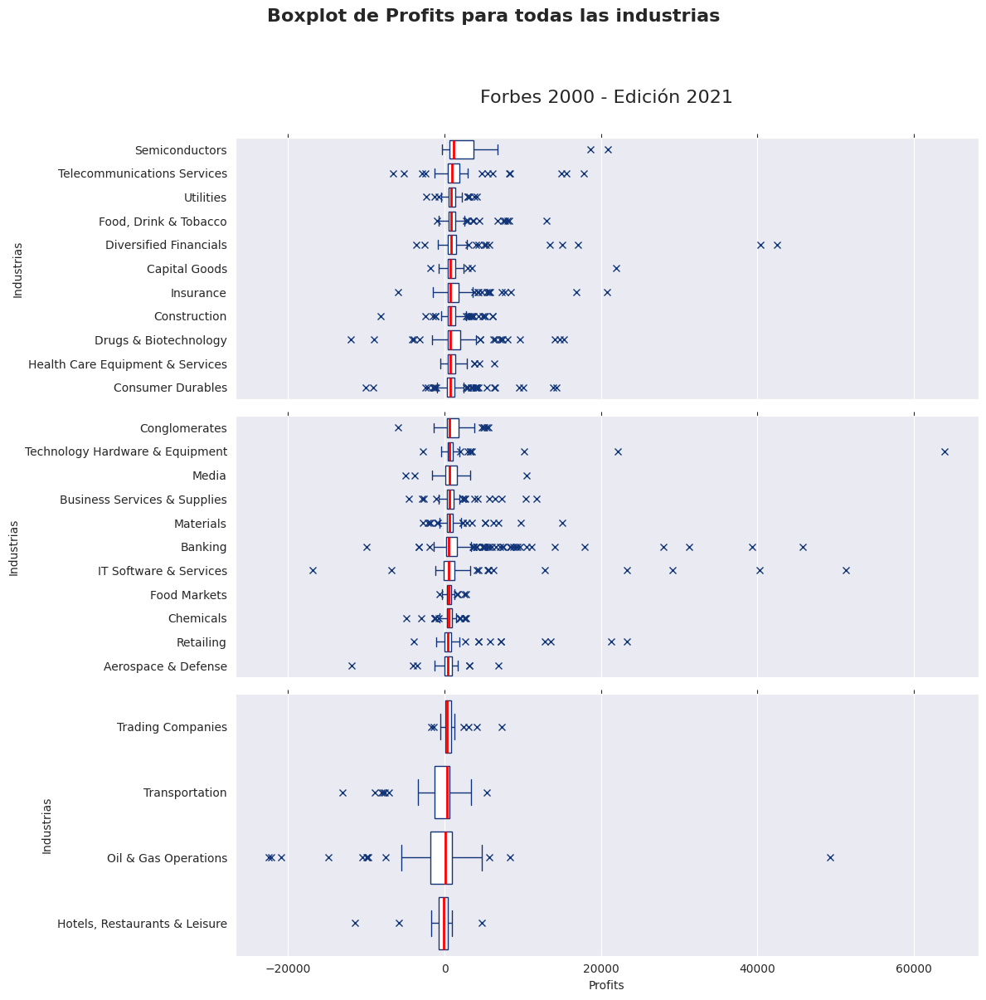

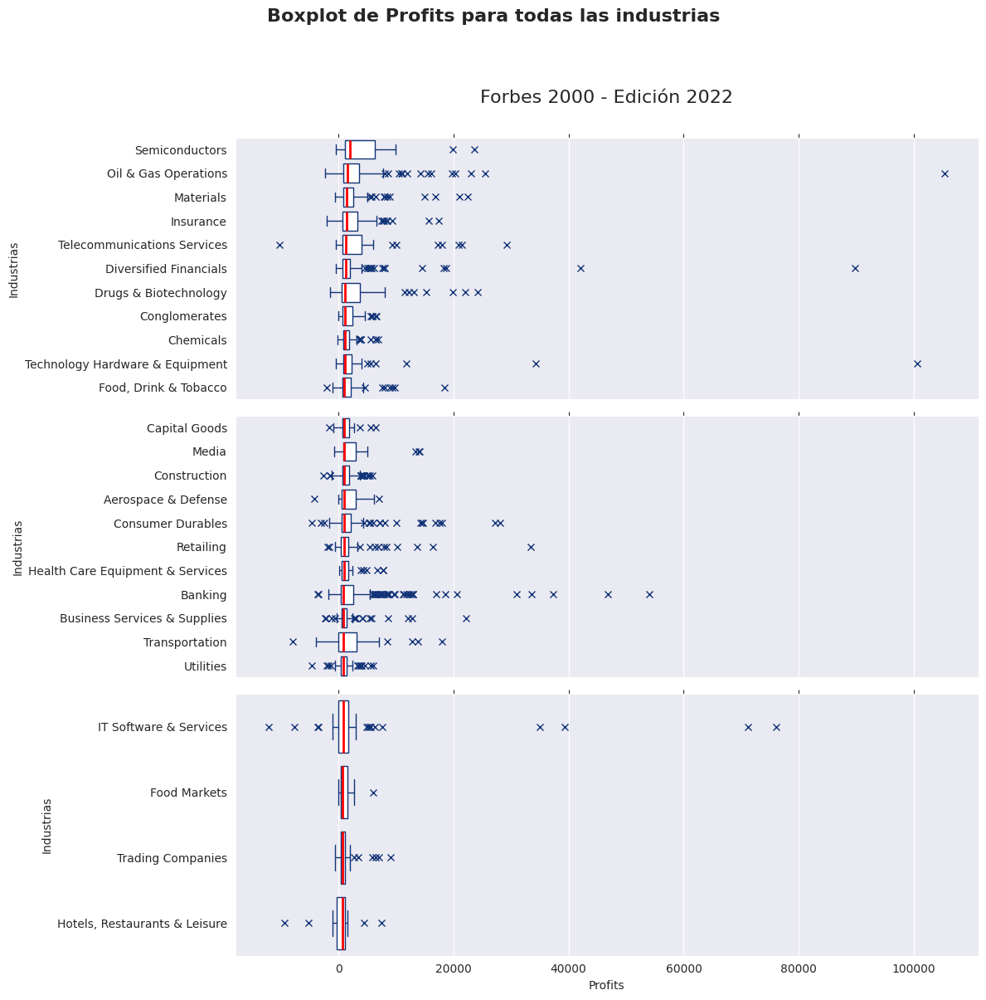

In [ ]:
for index,value in enumerate(range(2015,2023,1)):
  graficar_boxplot_por_industria(index,'Profits',value)

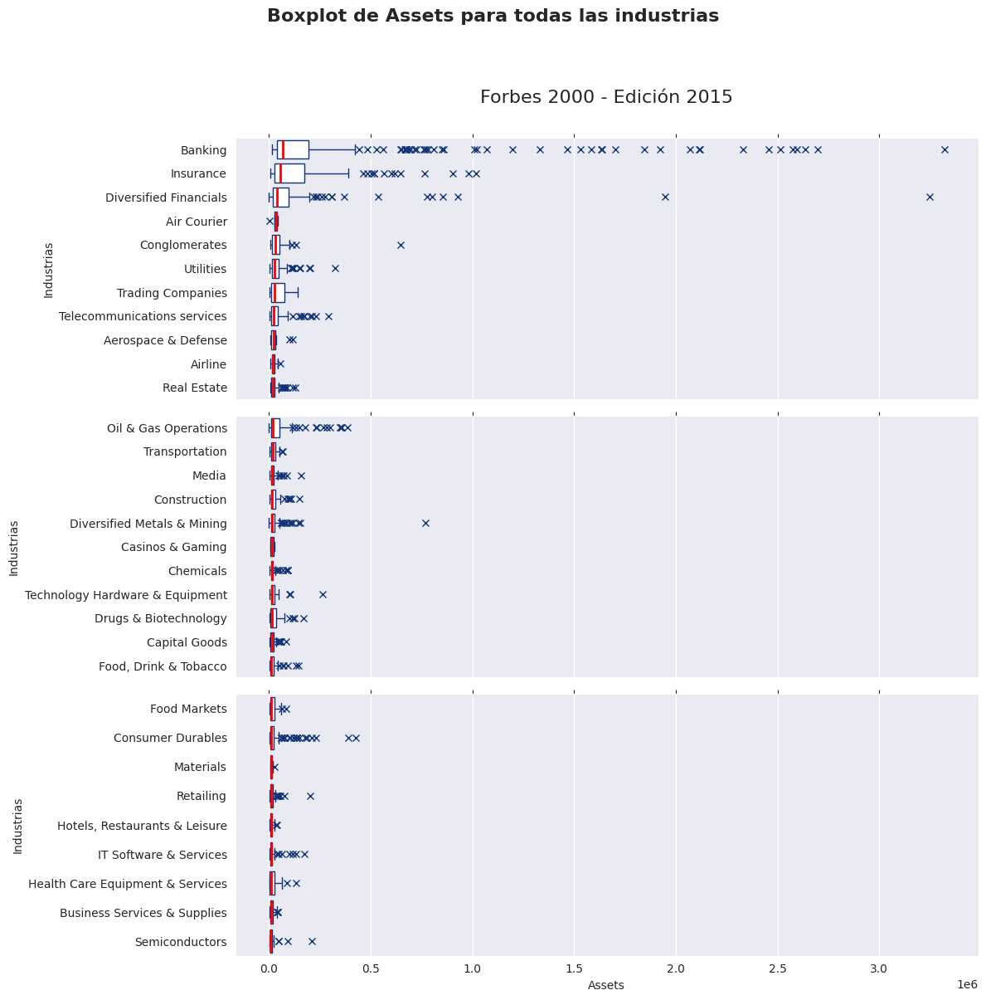

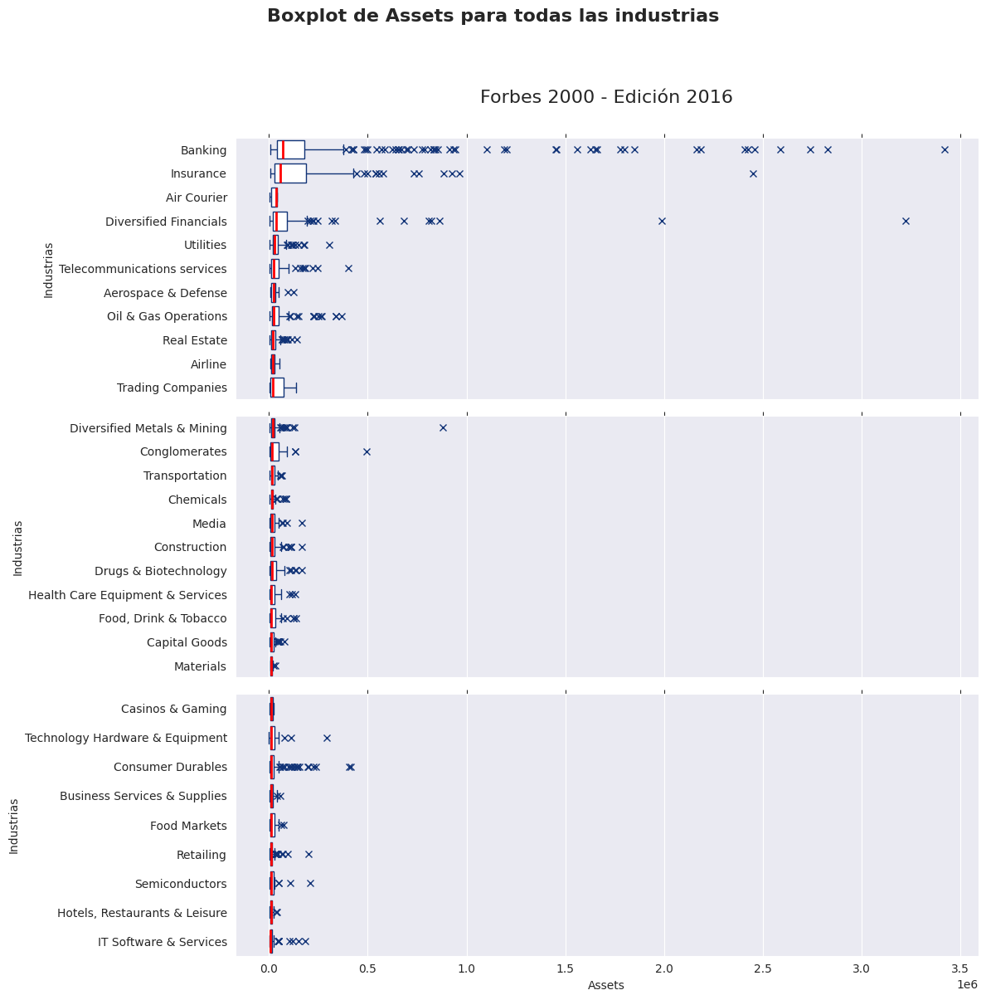

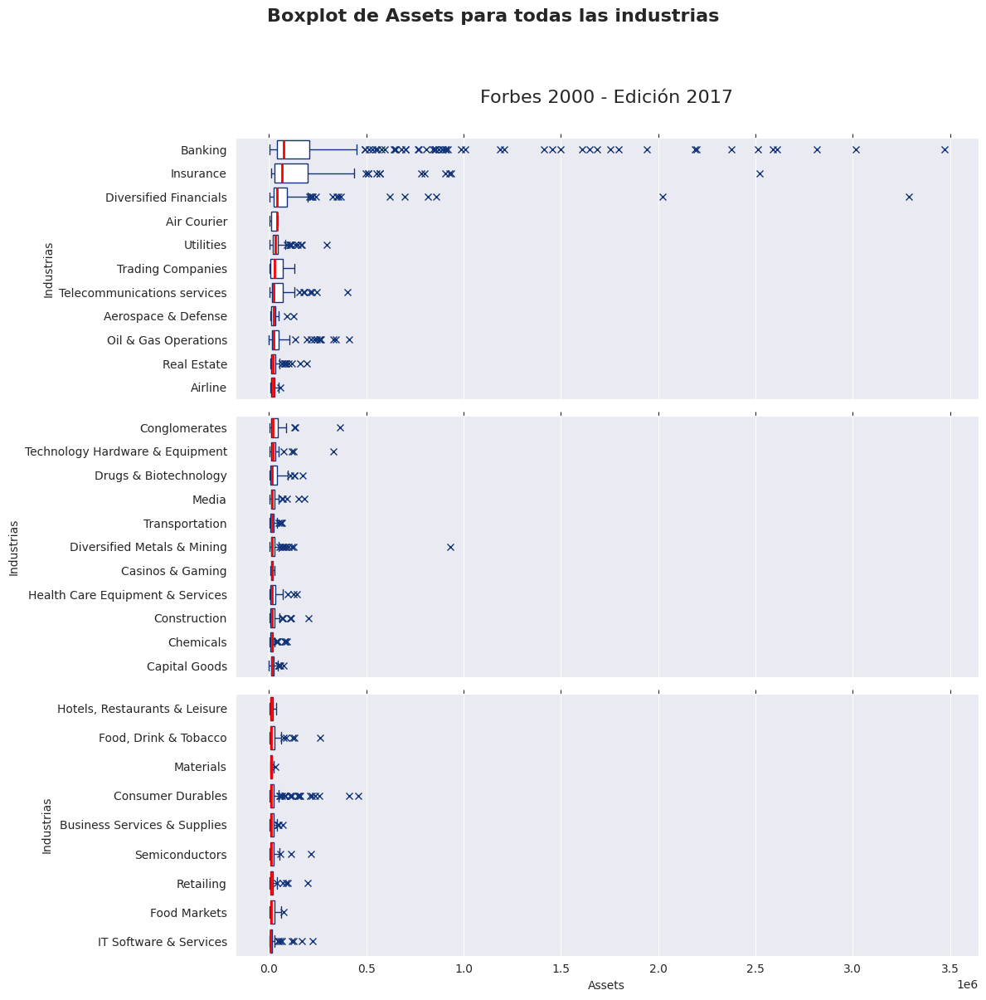

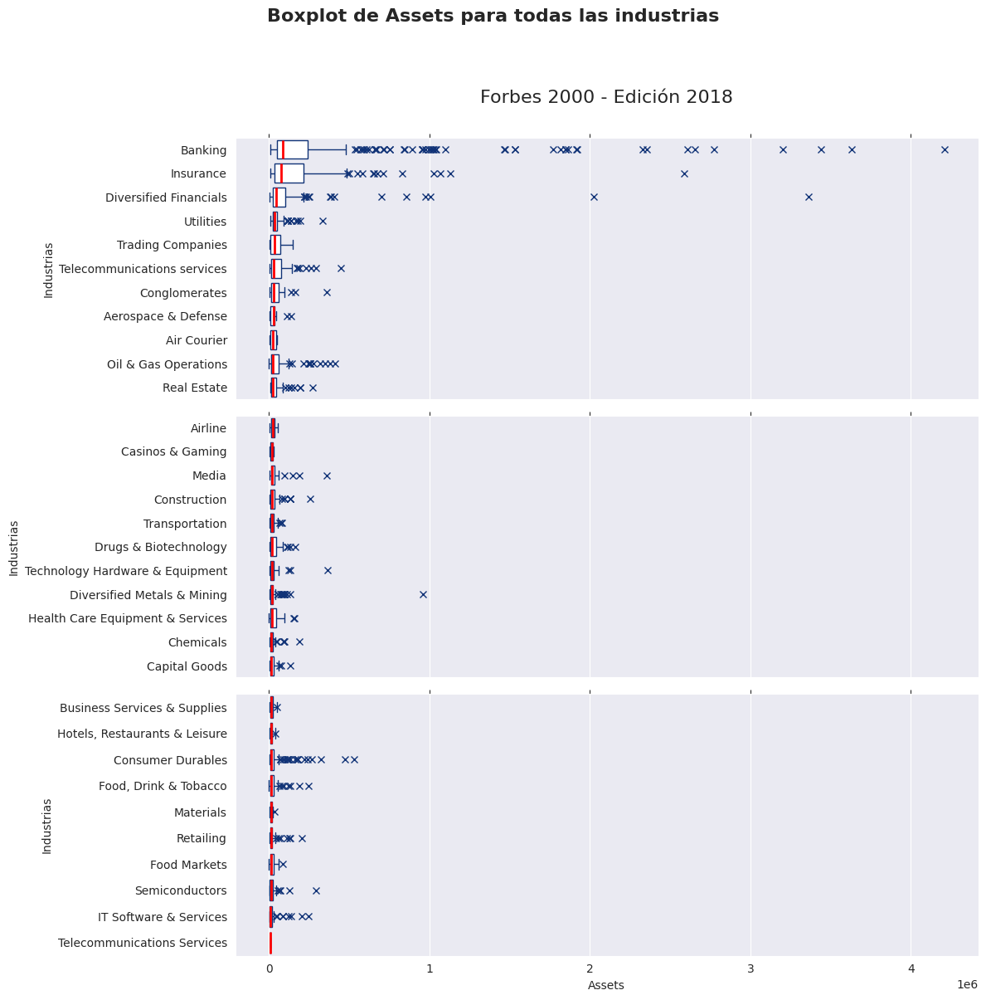

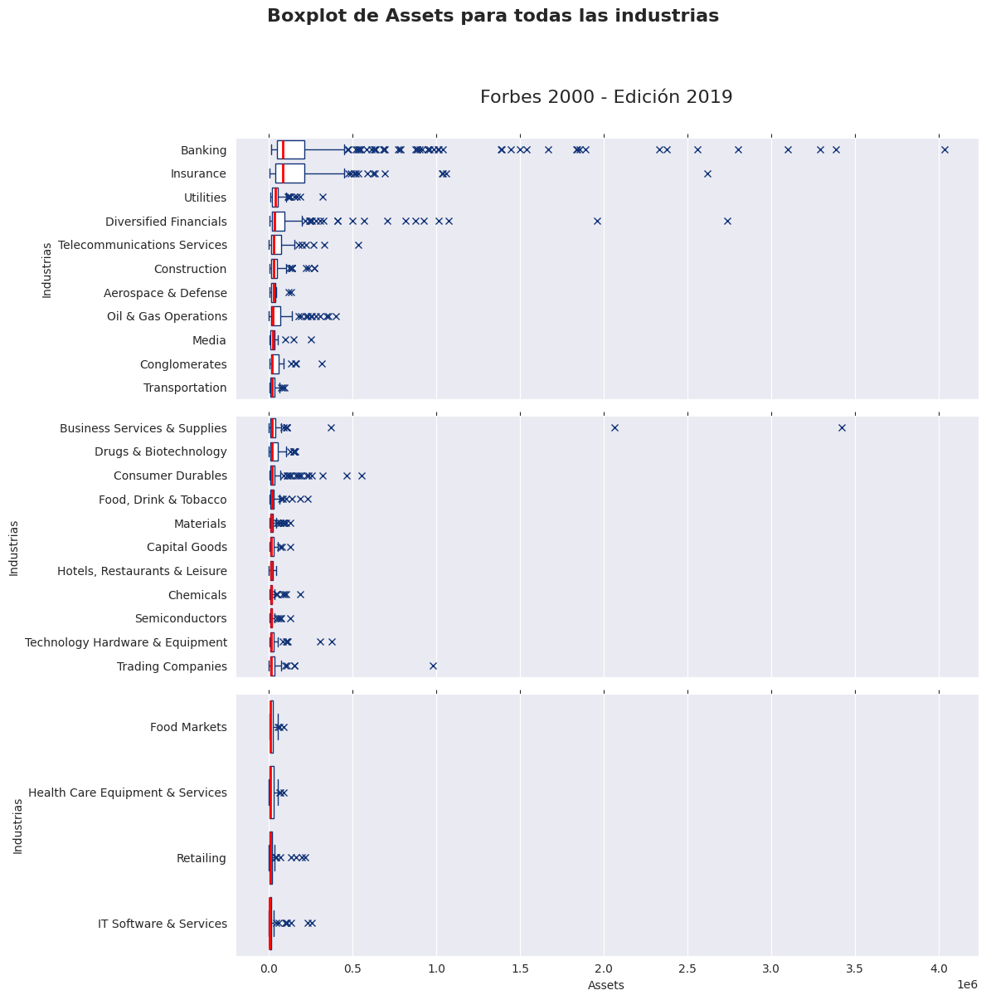

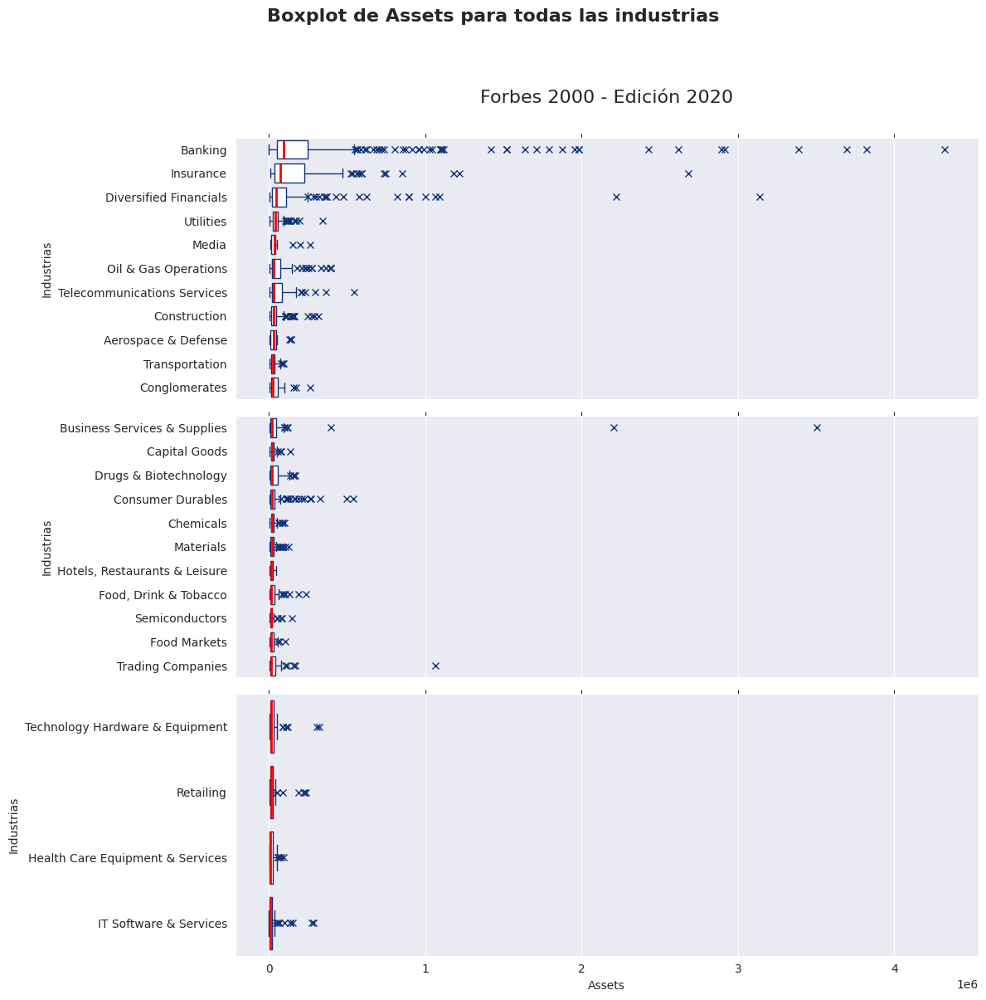

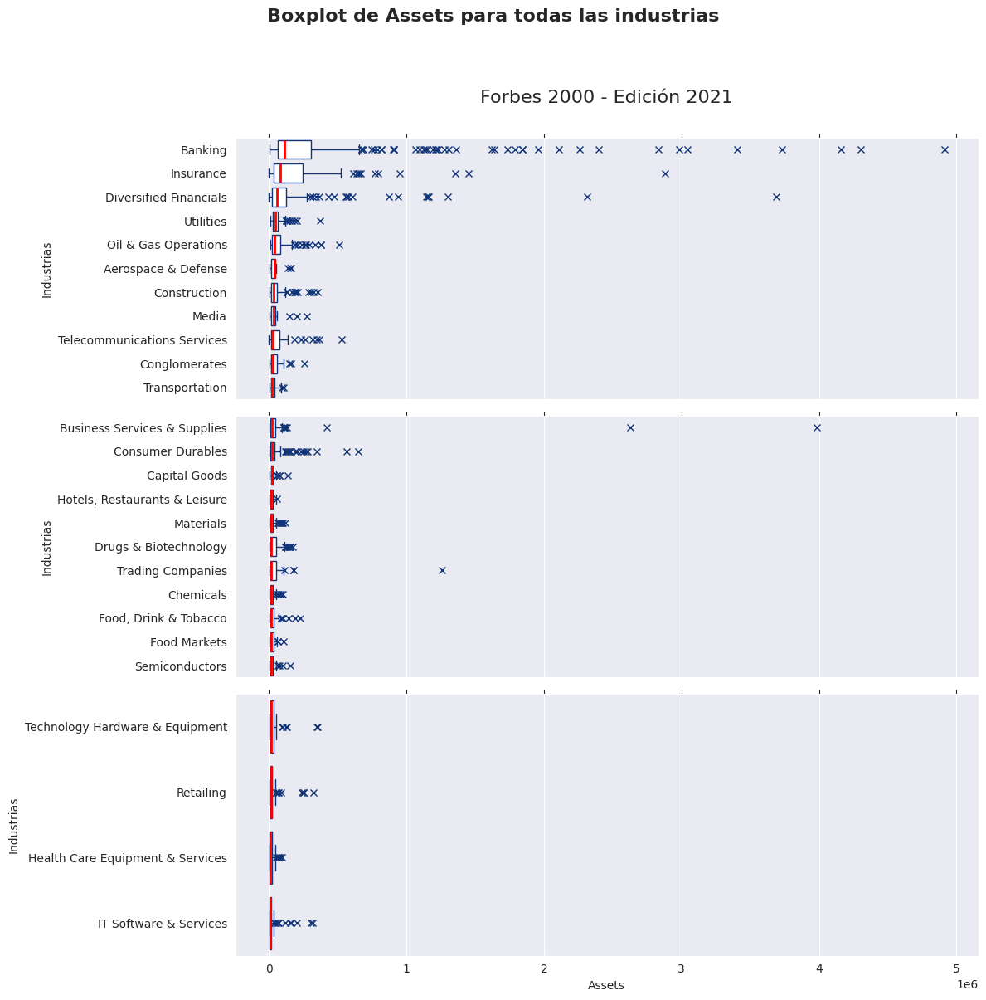

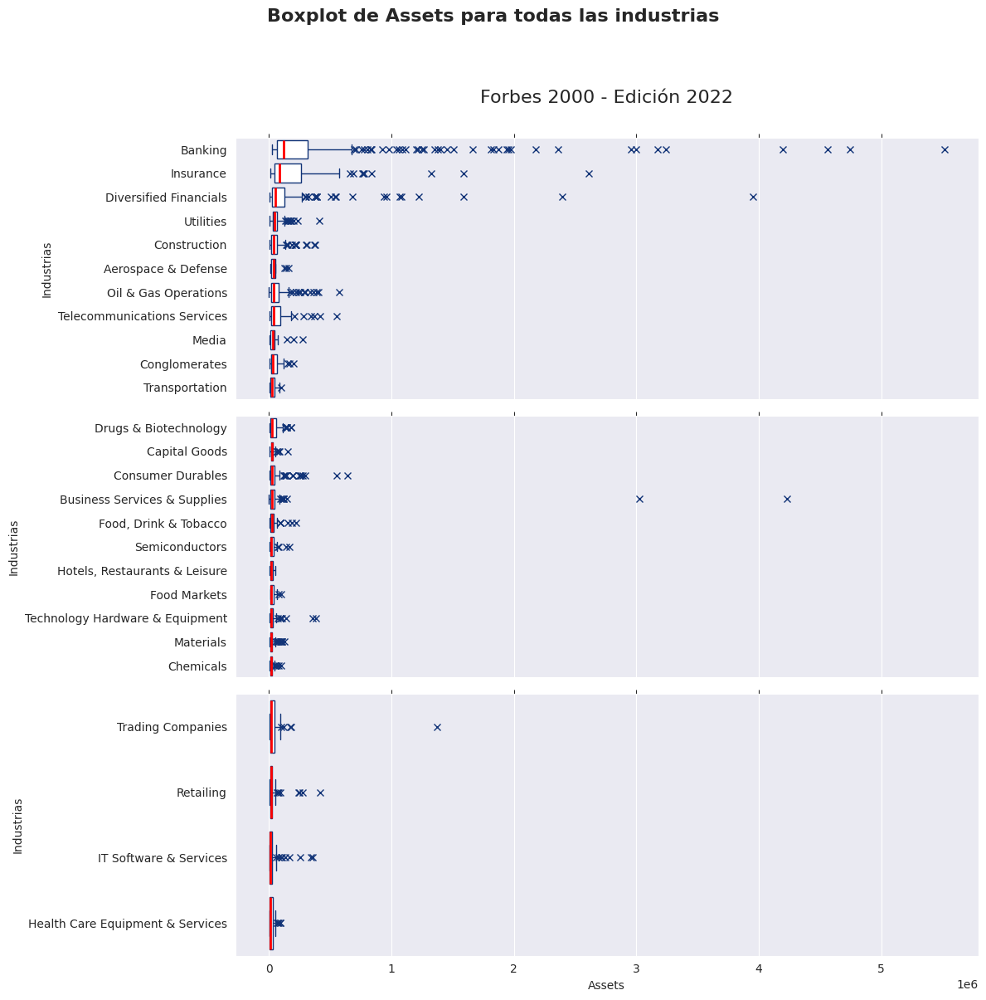

In [ ]:
for index,value in enumerate(range(2015,2023,1)):
  graficar_boxplot_por_industria(index,'Assets',value)

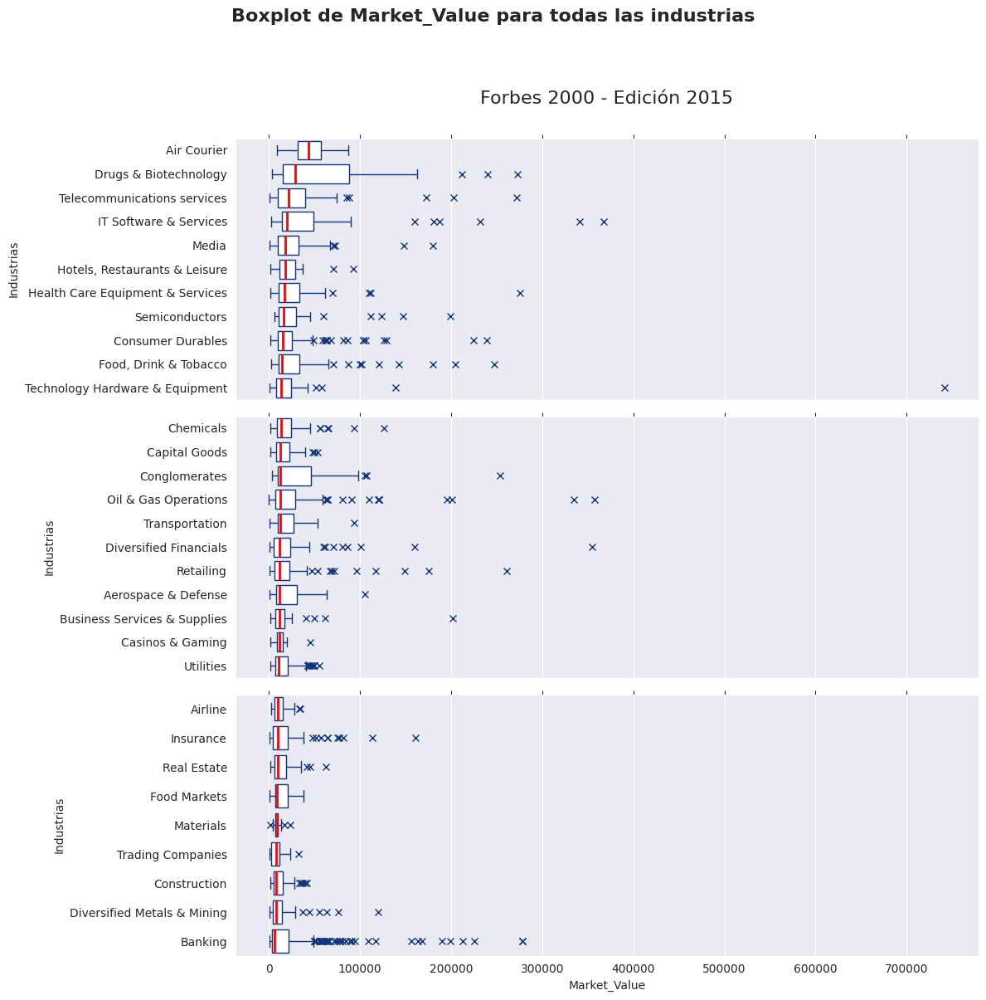

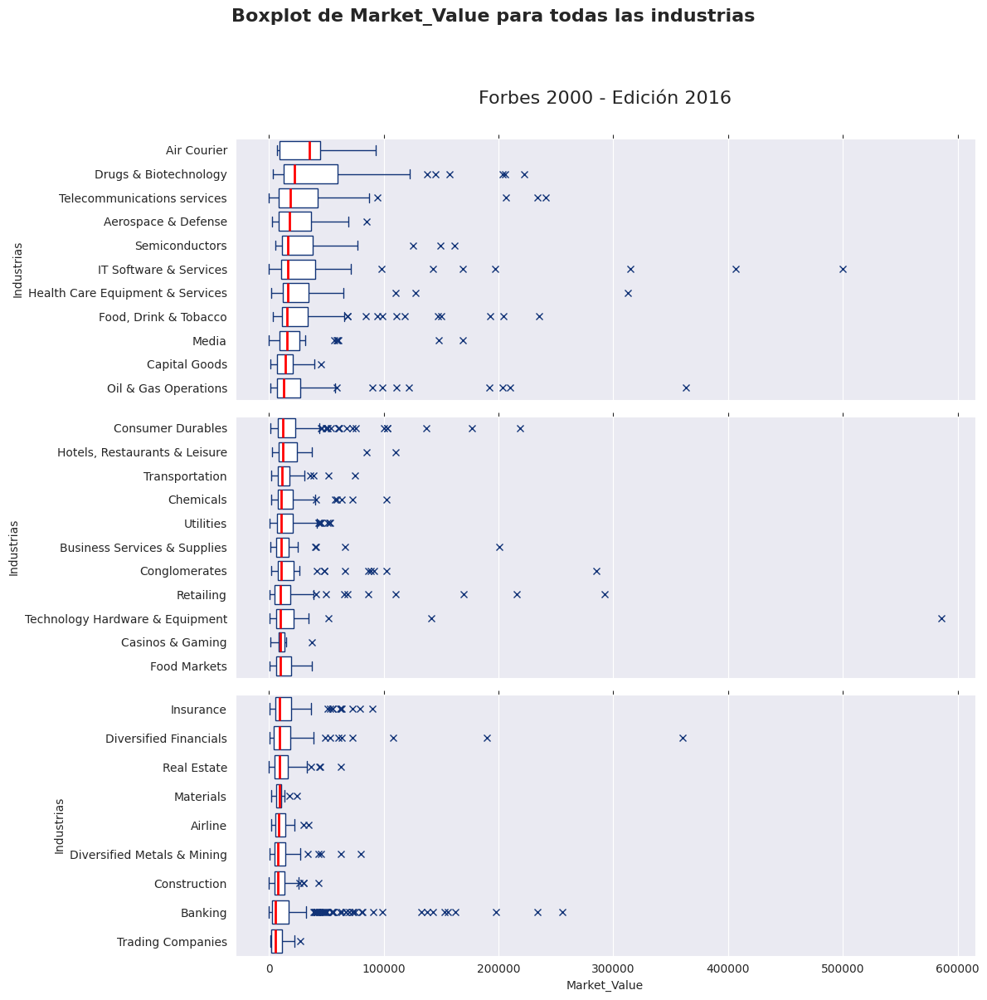

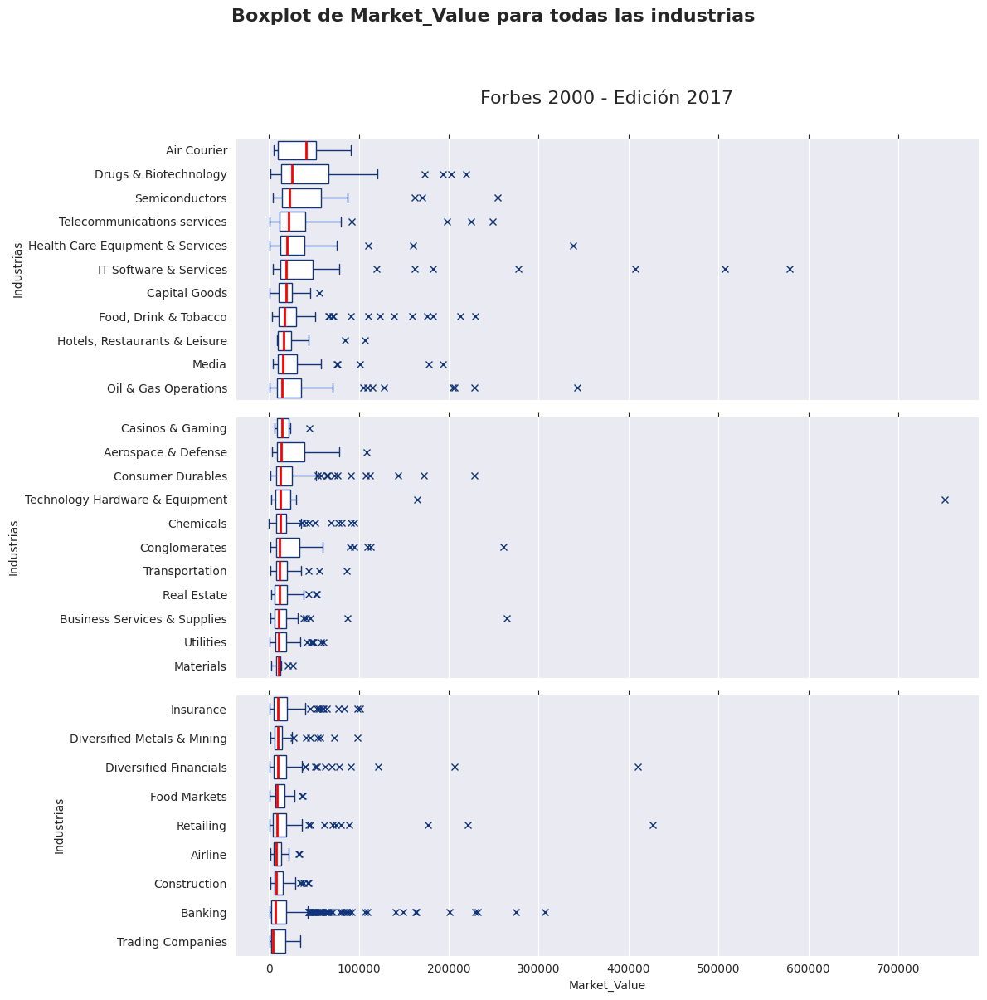

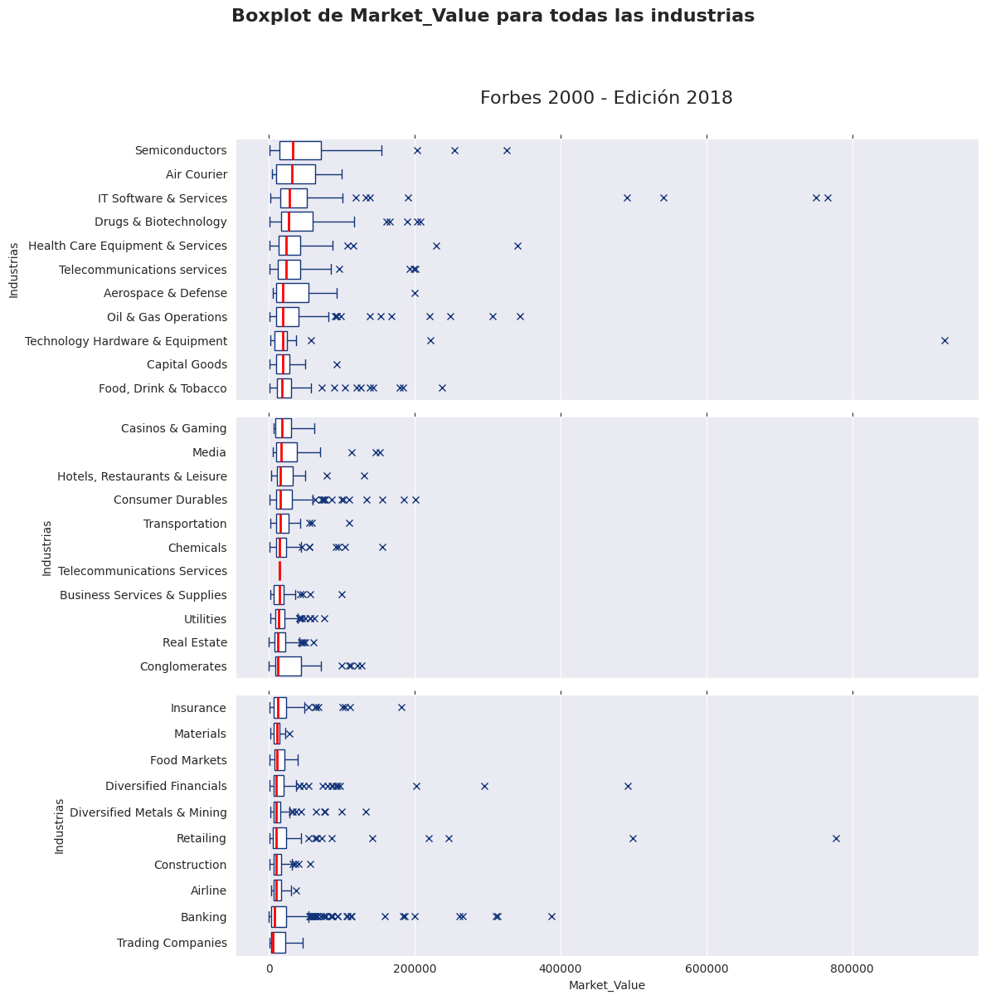

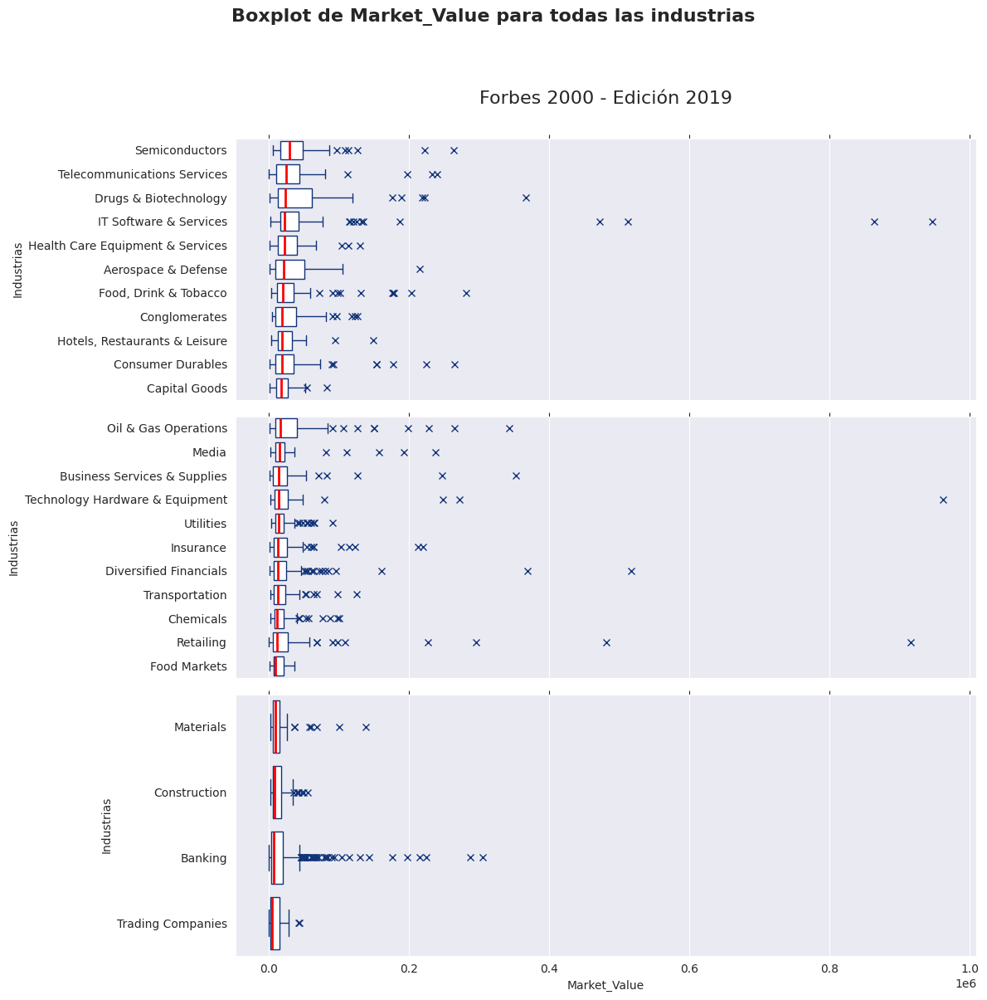

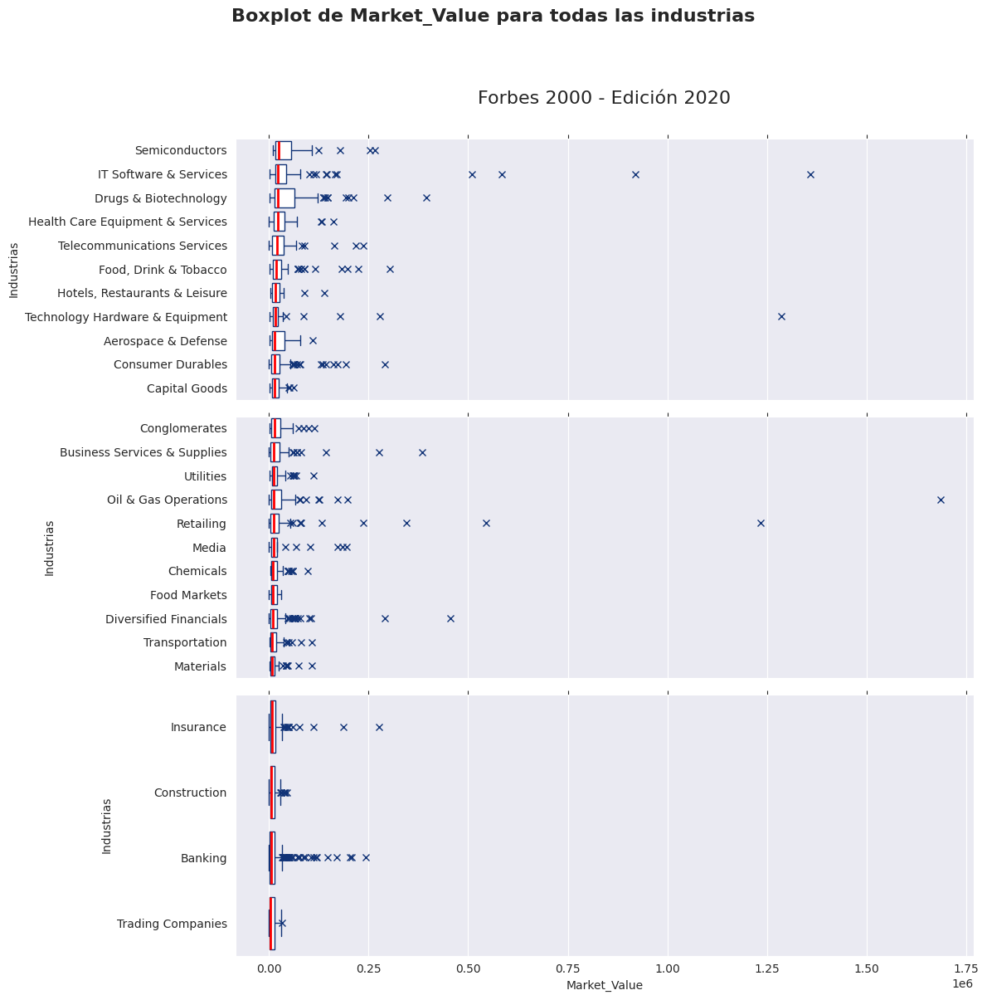

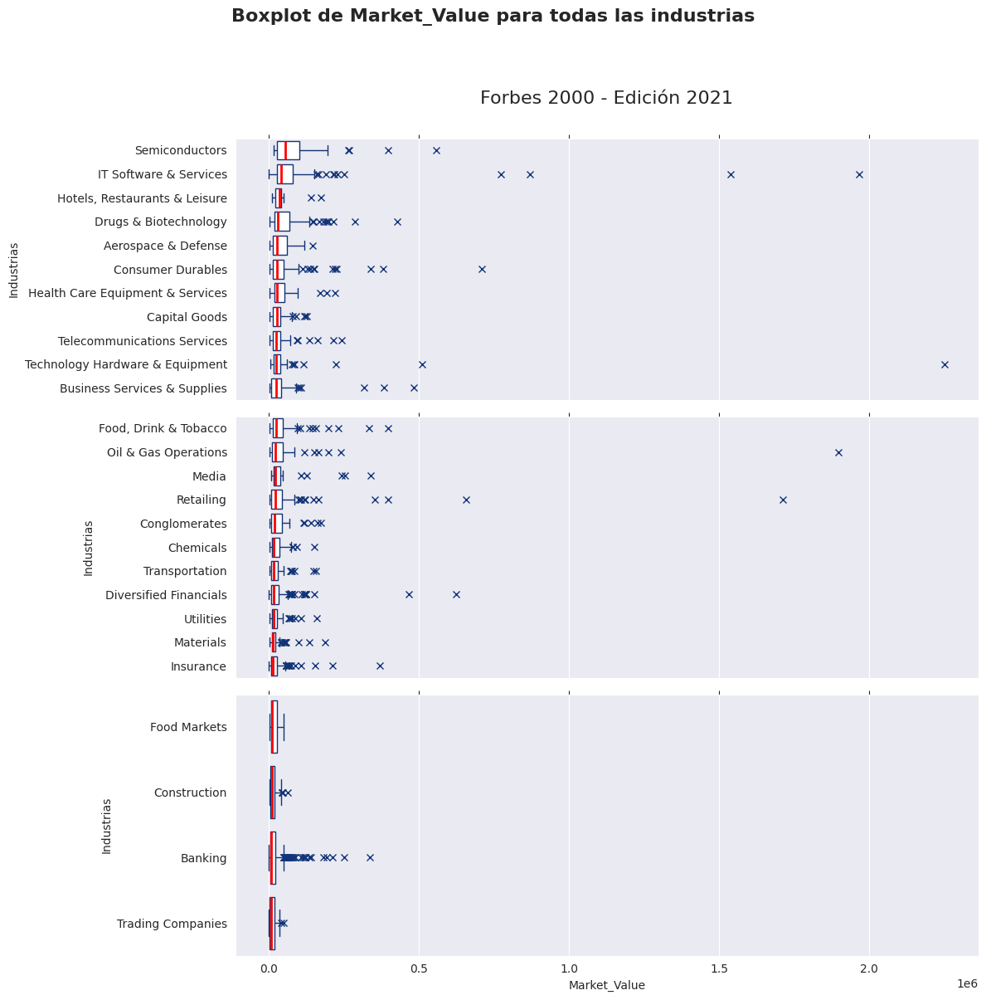

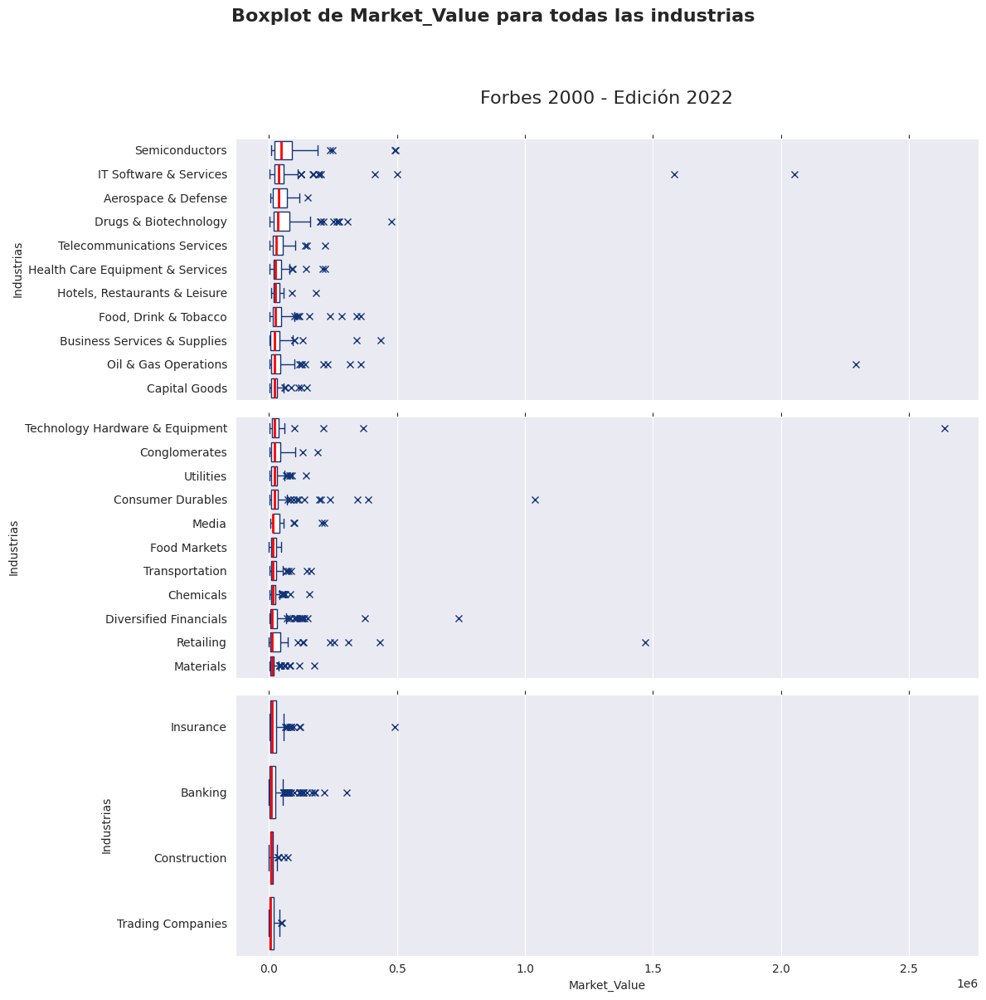

In [ ]:
for index,value in enumerate(range(2015,2023,1)):
  graficar_boxplot_por_industria(index,'Market_Value',value)

1. **Dado que la distribución de cada industria con respecto a cada variable numérica relevante no se comporta de forma normal, se considera utilizar la mediana de la industria de la columna en la que se encuentra el valor nulo  como medida para realizar la imputación de los datos.**

2. **Un aspecto relevante de este análisis es que hubo una disminución del número de industrias consideradas a partir del 2019.**

In [ ]:
def imputar_df_con_la_mediana(index_df_en_lista):
  indexes_filas_con_nan = dataframes_forbes_from_2015[index_df_en_lista][dataframes_forbes_from_2015[index_df_en_lista].isnull().any(axis=1)].index

  for index_fila_nan in indexes_filas_con_nan:
    fila_de_interes = dataframes_forbes_from_2015[index_df_en_lista].iloc[index_fila_nan]
    columnas_con_nan = fila_de_interes[fila_de_interes.isnull()].index

    for columna_con_nan in columnas_con_nan:
      industria = dataframes_forbes_from_2015[index_df_en_lista].at[index_fila_nan,'Industry']

      condition = dataframes_forbes_from_2015[index_df_en_lista].Industry==industria
      valor = dataframes_forbes_from_2015[index_df_en_lista].loc[condition][columna_con_nan].median()
      dataframes_forbes_from_2015[index_df_en_lista].at[index_fila_nan,columna_con_nan] = valor

      print(f'index: {index_fila_nan}, columna con valor nulo: {columna_con_nan}, industria: {industria}, Mediana: {valor}')
      print(dataframes_forbes_from_2015[index_df_en_lista].loc[condition][columna_con_nan].median(),' = '
      ,dataframes_forbes_from_2015[index_df_en_lista].at[index_fila_nan, columna_con_nan] )
      # Imprimir una línea para separar los resultados de los diferentes DataFrames
      print('______________________________________')


#### 3.1.1.1 Imputación dataset 2015

In [ ]:
dataframes_forbes_from_2015[0].isnull().sum()

Rank_nr         0
Company         0
Industry        0
Country         0
Sales           2
Profits         0
Assets          1
Market_Value    0
dtype: int64

In [ ]:
dataframes_forbes_from_2015[0][dataframes_forbes_from_2015[0].isnull().any(axis=1)]

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
693,695,Porsche Automobil Holding,Consumer Durables,Germany,NaN,4016.0,36864.0,15287
1487,1489,Dexia,Banking,Belgium,NaN,-803.8,299028.0,2352
1926,1927,Shanghai Material Trading,Trading Companies,China,12381.0,6.2,NaN,908


In [ ]:
imputar_df_con_la_mediana(0)

index: 693, columna con valor nulo: Sales, industria: Consumer Durables, Mediana: 12530.0
12530.0  =  12530.0
______________________________________
index: 1487, columna con valor nulo: Sales, industria: Banking, Mediana: 3465.5
3465.5  =  3465.5
______________________________________
index: 1926, columna con valor nulo: Assets, industria: Trading Companies, Mediana: 26844.0
26844.0  =  26844.0
______________________________________


#### 3.1.1.2 Imputación dataset 2016

In [ ]:
dataframes_forbes_from_2015[1].isnull().sum()

Rank_nr         0
Company         0
Industry        0
Country         0
Sales           3
Profits         1
Assets          2
Market_Value    2
dtype: int64

In [ ]:
dataframes_forbes_from_2015[1][dataframes_forbes_from_2015[1].isnull().any(axis=1)]

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
670,672,Porsche Automobil Holding,Consumer Durables,Germany,NaN,3516.9,34910.0,16556.0
683,685,Gree Electric Appliances,Consumer Durables,China,19684.0,2294.6,26787.0,NaN
1070,1072,Kyushu Financial Group,Banking,Japan,NaN,812.3,72979.0,2640.0
1396,1398,RHB Capital,Banking,Malaysia,NaN,386.6,53736.0,4890.0
1490,1492,Ambac Financial Group,Insurance,United States,638.0,NaN,NaN,NaN
1838,1840,Banque nationale de Belgique,Banking,Belgium,1742.0,902.8,NaN,1343.0


In [ ]:
imputar_df_con_la_mediana(1)

index: 670, columna con valor nulo: Sales, industria: Consumer Durables, Mediana: 12155.5
12155.5  =  12155.5
______________________________________
index: 683, columna con valor nulo: Market_Value, industria: Consumer Durables, Mediana: 12204.0
12204.0  =  12204.0
______________________________________
index: 1070, columna con valor nulo: Sales, industria: Banking, Mediana: 3553.5
3553.5  =  3553.5
______________________________________
index: 1396, columna con valor nulo: Sales, industria: Banking, Mediana: 3553.5
3553.5  =  3553.5
______________________________________
index: 1490, columna con valor nulo: Profits, industria: Insurance, Mediana: 734.8
734.8  =  734.8
______________________________________
index: 1490, columna con valor nulo: Assets, industria: Insurance, Mediana: 58883.0
58883.0  =  58883.0
______________________________________
index: 1490, columna con valor nulo: Market_Value, industria: Insurance, Mediana: 9638.0
9638.0  =  9638.0
_________________________________

#### 3.1.1.3 Imputación dataset 2017

In [ ]:
dataframes_forbes_from_2015[2].isnull().sum()

Rank_nr         0
Company         0
Industry        0
Country         0
Sales           2
Profits         0
Assets          1
Market_Value    1
dtype: int64

In [ ]:
dataframes_forbes_from_2015[2][dataframes_forbes_from_2015[2].isnull().any(axis=1)]

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
1272,1274,Banca MPS,Banking,Italy,5887.0,-3585.3,161828.0,NaN
1725,1727,Bank of Greece,Banking,Greece,1935.0,1208.4,NaN,240.0
1795,1796,Grupo Zuliano,Chemicals,Venezuela,NaN,998.9,1521.0,72.0
1912,1914,Technipfmc,Oil & Gas Operations,United Kingdom,NaN,0.0,1.0,15631.0


In [ ]:
imputar_df_con_la_mediana(2)

index: 1272, columna con valor nulo: Market_Value, industria: Banking, Mediana: 6630.5
6630.5  =  6630.5
______________________________________
index: 1725, columna con valor nulo: Assets, industria: Banking, Mediana: 75799.5
75799.5  =  75799.5
______________________________________
index: 1795, columna con valor nulo: Sales, industria: Chemicals, Mediana: 9896.5
9896.5  =  9896.5
______________________________________
index: 1912, columna con valor nulo: Sales, industria: Oil & Gas Operations, Mediana: 12562.0
12562.0  =  12562.0
______________________________________


#### 3.1.1.4 Imputación dataset 2018

In [ ]:
dataframes_forbes_from_2015[3].isnull().sum()

Rank_nr         0
Company         0
Industry        0
Country         0
Sales           1
Profits         0
Assets          4
Market_Value    3
dtype: int64

In [ ]:
dataframes_forbes_from_2015[3][dataframes_forbes_from_2015[3].isnull().any(axis=1)]

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
841,842,Infineon Technologies,Semiconductors,Germany,8486.0,1275.0,NaN,32351.0
1107,1108,Hainan Airlines,Airline,China,9381.0,582.7,29643.0,NaN
1231,1231,Hna Technology,Transportation,China,48093.0,118.0,17870.0,NaN
1250,1250,Wanhua Chemical Group,Chemicals,China,8323.0,1883.9,10557.0,NaN
1649,1650,IndusInd Bank,Banking,India,2770.0,427.7,NaN,16896.0
1859,1860,Bank of Greece,Banking,Greece,1679.0,1062.3,NaN,354.0
1913,1914,Grupo Zuliano,Chemicals,Venezuela,NaN,998.9,NaN,139.0


In [ ]:
imputar_df_con_la_mediana(3)

index: 841, columna con valor nulo: Assets, industria: Semiconductors, Mediana: 11850.0
11850.0  =  11850.0
______________________________________
index: 1107, columna con valor nulo: Market_Value, industria: Airline, Mediana: 9874.0
9874.0  =  9874.0
______________________________________
index: 1231, columna con valor nulo: Market_Value, industria: Transportation, Mediana: 15302.0
15302.0  =  15302.0
______________________________________
index: 1250, columna con valor nulo: Market_Value, industria: Chemicals, Mediana: 14701.5
14701.5  =  14701.5
______________________________________
index: 1649, columna con valor nulo: Assets, industria: Banking, Mediana: 87090.5
87090.5  =  87090.5
______________________________________
index: 1859, columna con valor nulo: Assets, industria: Banking, Mediana: 87090.5
87090.5  =  87090.5
______________________________________
index: 1913, columna con valor nulo: Sales, industria: Chemicals, Mediana: 11363.0
11363.0  =  11363.0
_____________________

#### 3.1.1.5 Imputación dataset 2019

In [ ]:
dataframes_forbes_from_2015[4].isnull().sum()

Rank_nr         0
Company         0
Industry        0
Country         0
Sales           0
Profits         1
Assets          5
Market_Value    0
dtype: int64

In [ ]:
dataframes_forbes_from_2015[4][dataframes_forbes_from_2015[4].isnull().any(axis=1)]

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
971,973,Mahindra & Mahindra,Consumer Durables,India,15189.0,833.0,NaN,12252.0
1091,1092,SM Investments,Retailing,Philippines,8538.0,NaN,18951.0,21639.0
1452,1453,Chongqing Rural Bank,Banking,China,6936.0,1369.0,NaN,6144.0
1525,1526,Finatis,Trading Companies,France,44249.0,-92.0,NaN,260.0
1814,1812,Yes Bank,Banking,India,3965.0,657.0,NaN,8523.0
1976,1977,Drilling Company of 1972,Oil & Gas Operations,Denmark,1429.0,941.0,NaN,3202.0


In [ ]:
imputar_df_con_la_mediana(4)

index: 971, columna con valor nulo: Assets, industria: Consumer Durables, Mediana: 17684.0
17684.0  =  17684.0
______________________________________
index: 1091, columna con valor nulo: Profits, industria: Retailing, Mediana: 564.0
564.0  =  564.0
______________________________________
index: 1452, columna con valor nulo: Assets, industria: Banking, Mediana: 84414.0
84414.0  =  84414.0
______________________________________
index: 1525, columna con valor nulo: Assets, industria: Trading Companies, Mediana: 12544.0
12544.0  =  12544.0
______________________________________
index: 1814, columna con valor nulo: Assets, industria: Banking, Mediana: 84414.0
84414.0  =  84414.0
______________________________________
index: 1976, columna con valor nulo: Assets, industria: Oil & Gas Operations, Mediana: 26503.0
26503.0  =  26503.0
______________________________________


#### 3.1.1.6 Imputación dataset 2020

In [ ]:
dataframes_forbes_from_2015[6].isnull().sum()

Rank_nr         0
Company         0
Industry        0
Country         0
Sales           0
Profits         0
Assets          2
Market_Value    0
dtype: int64

In [ ]:
dataframes_forbes_from_2015[6][dataframes_forbes_from_2015[6].isnull().any(axis=1)]

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
1469,True,fred/companies/F2K/2021/105837,IT Software & Services,5855,68126,1793.0,NaN,235
1932,1933,Bank of Greece,Banking,Greece,1324,942.8,NaN,366


In [ ]:
imputar_df_con_la_mediana(6)

index: 1469, columna con valor nulo: Assets, industria: IT Software & Services, Mediana: 7869.0
7869.0  =  7869.0
______________________________________
index: 1932, columna con valor nulo: Assets, industria: Banking, Mediana: 110569.0
110569.0  =  110569.0
______________________________________


#### 3.1.1.7 resultado final

In [ ]:
#Este código te permite ver la cantidad de valores nulos
# en cada columna de cada DataFrame de Forbes, junto con el año correspondiente.
for index, df in enumerate(dataframes_forbes_from_2015,start=2015):

  # Imprimir el índice del DataFrame actual que empieza desde 2008
  print(index)

  # Calcular y mostrar la suma de valores nulos de cada dataset
  print(df.isnull().sum().sum())

  # Imprimir una línea para separar los resultados de los diferentes DataFrames
  print('______________________________________')

2015
0
______________________________________
2016
0
______________________________________
2017
0
______________________________________
2018
0
______________________________________
2019
0
______________________________________
2020
0
______________________________________
2021
0
______________________________________
2022
0
______________________________________


### 3.1.2 Establecer el mismo número de industrias para cada dataset (datasets 2015 - 2022)

In [ ]:
dataframes_forbes_from_2015_copy= dataframes_forbes_from_2015.copy()

In [ ]:
for i in range(len(dataframes_forbes_from_2015_copy)):
  print(f'El número total de industrias del dataset del año {i+2015} es {len(dataframes_forbes_from_2015_copy[i].Industry.unique())}')

El número total de industrias del dataset del año 2015 es 31
El número total de industrias del dataset del año 2016 es 31
El número total de industrias del dataset del año 2017 es 31
El número total de industrias del dataset del año 2018 es 32
El número total de industrias del dataset del año 2019 es 26
El número total de industrias del dataset del año 2020 es 26
El número total de industrias del dataset del año 2021 es 26
El número total de industrias del dataset del año 2022 es 26


#### 3.1.2.1 Verificando el contenido de la columna "Industria" para cada dataset

**Dado que el número de industrias cambia de 31 a 32 y después a 26. La primera cosa es revisar si los años que tienen la misma cantidad de industrias, las industrias son las mismas.**

In [ ]:
industries_2015=dataframes_forbes_from_2015_copy[0].Industry.unique()
industries_2015.sort()

In [ ]:
industries_2016=dataframes_forbes_from_2015_copy[1].Industry.unique()
industries_2016.sort()

In [ ]:
industries_2017=dataframes_forbes_from_2015_copy[2].Industry.unique()
industries_2017.sort()

In [ ]:
industries_2015 ==industries_2016

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True])

In [ ]:
industries_2016== industries_2017

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True])

**Los primeros 3 años tienen las mismas industrias. Ahora se revisa la misma información de los últimos 4 años.**

In [ ]:
industries_2019=dataframes_forbes_from_2015_copy[4].Industry.unique()
industries_2019.sort()
industries_2020=dataframes_forbes_from_2015_copy[5].Industry.unique()
industries_2020.sort()
industries_2021=dataframes_forbes_from_2015_copy[6].Industry.unique()
industries_2021.sort()
industries_2022=dataframes_forbes_from_2015_copy[7].Industry.unique()
industries_2022.sort()

In [ ]:
industries_2019==industries_2020

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True])

In [ ]:
industries_2021==industries_2022

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True])

In [ ]:
industries_2020==industries_2021

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True])

**Los últimos 4 años tienen las mismas industrias. Ahora se revisa cual es la industria adicional que tiene el año 2019. Para este fin, comparo el dataset del año 2017 con el del año 2018.**

In [ ]:
industries_2018=dataframes_forbes_from_2015_copy[3].Industry.unique()
industries_2018.sort()

In [ ]:
industries_2018_set=set(industries_2018)
industries_2017_set=set(industries_2017)
industries_2018_set.difference(industries_2017_set)

{'Telecommunications Services'}

**La columna adicional es 'Telecommunications Services' que en realidad existe en los datasets anteriores con a s minúscula en "services". Sin embargo, en los datasets siguientes aparecen con la letra mayúscula S en "Services". Para dejar todos los datasets con el mismo nombre se procede con dejar la versión de la s en mayúscula.**

In [ ]:
for df in dataframes_forbes_from_2015_copy:
  df.Industry= df.Industry.replace('Telecommunications services','Telecommunications Services')

In [ ]:
for i in range(len(dataframes_forbes_from_2015_copy)):
  print(f'El número total de industrias del dataset del año {i+2015} es {len(dataframes_forbes_from_2015_copy[i].Industry.unique())}')

El número total de industrias del dataset del año 2015 es 31
El número total de industrias del dataset del año 2016 es 31
El número total de industrias del dataset del año 2017 es 31
El número total de industrias del dataset del año 2018 es 31
El número total de industrias del dataset del año 2019 es 26
El número total de industrias del dataset del año 2020 es 26
El número total de industrias del dataset del año 2021 es 26
El número total de industrias del dataset del año 2022 es 26


#### 3.1.2.2 Hallar las 5 industrias faltantes

In [ ]:
industries_2019_set_update=set(dataframes_forbes_from_2015_copy[4].Industry.unique())
industries_2018_set_update=set(dataframes_forbes_from_2015_copy[3].Industry.unique())
industrias_desaparecidas=industries_2018_set_update.difference(industries_2019_set_update)
industrias_desaparecidas=list(industrias_desaparecidas)
industrias_desaparecidas

['Air Courier',
 'Casinos & Gaming',
 'Diversified Metals & Mining',
 'Airline',
 'Real Estate']

In [ ]:
# Esta función ayuda a visualizar la relación entre las industrias de dos DataFrames,
# mostrando cuántas empresas pertenecientes a ciertas industrias en un DataFrame también están presentes en otro DataFrame.

def graficando_heat_map_match_industria(lista_industrias,df_1,df_2):
  # Filtra las empresas en df_1 que pertenecen a las industrias especificadas en lista_industrias.
  empresas_industrias_lista_industrias_en_df_1=df_1.loc[df_1.Industry.isin(lista_industrias)]
  # Obtiene los nombres de estas empresas.
  nombre_empresas_industrias_lista_industrias_en_df_1 = empresas_industrias_lista_industrias_en_df_1['Company']
  # Filtra las empresas en df_2 que coinciden con las empresas de df_1 en las industrias especificadas.
  query_empresas_df1_en_df2=df_2.loc[df_2.Company.isin(nombre_empresas_industrias_lista_industrias_en_df_1)]
  # Realiza una fusión de los datos para obtener las industrias correspondientes a cada empresa.
  result = pd.merge(empresas_industrias_lista_industrias_en_df_1[['Company','Industry']],query_empresas_df1_en_df2[['Company','Industry']], how="left", on=['Company'])

# Crea un mapa de calor (heatmap) que muestra el recuento de empresas por industria que
# no fueron consideradas en años posteriores y sus correspondientes industrias en años posteriores.

  plt.subplots(figsize=(8, 8))
  df_2dhist = pd.DataFrame({
    x_label: grp['Industry_y'].value_counts()
    for x_label, grp in result.fillna('not match').groupby('Industry_x')
  })
  ax = sns.heatmap(df_2dhist, cmap='viridis')

  plt.xlabel('Industrias no consideradas en años posteriores')
  plt.ylabel('Industrias imágenes')

  plt.title('Industrias no consideradas en años posteriores y sus imágenes')

  # Anota cada celda del mapa de calor con el valor del recuento.
  for i in range(len(df_2dhist)):
      for j in range(len(df_2dhist.columns)):
          ax.text(j + 0.5, i + 0.5, df_2dhist.iloc[i, j],
                  ha='center', va='center', color='white', fontsize=10)
  # Muestra el mapa de calor.
  plt.show()

  # Finalmente, la función devuelve el DataFrame resultante de la fusión.
  return result

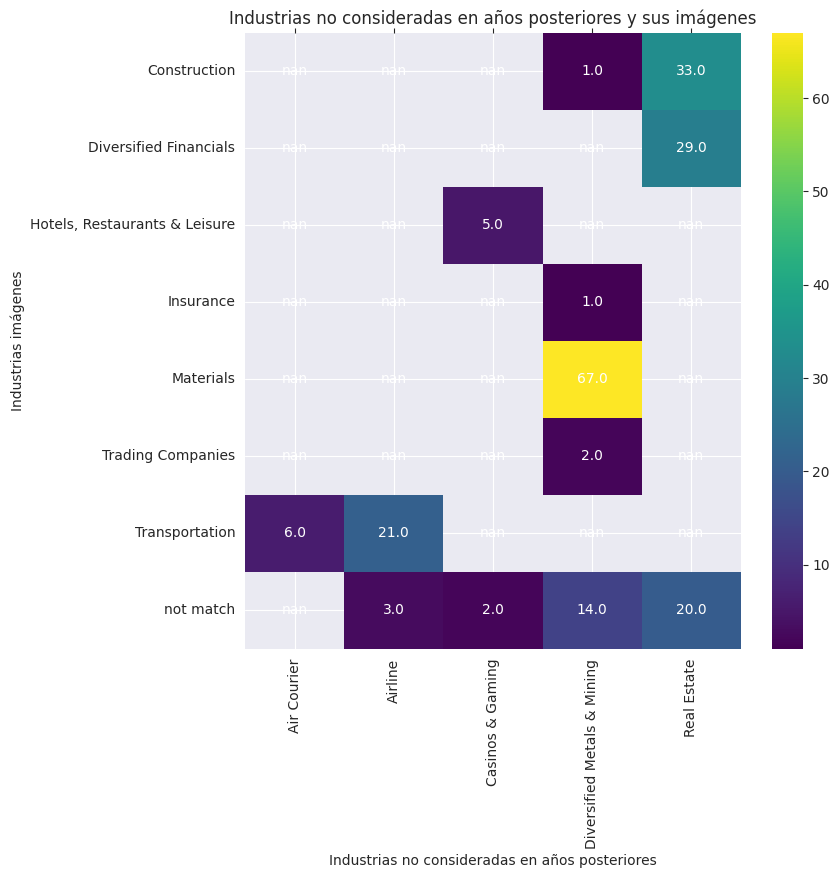

,Company,Industry_x,Industry_y
0,Glencore International,Diversified Metals & Mining,Materials
1,Citic Pacific,Diversified Metals & Mining,NaN
2,BHP Billiton,Diversified Metals & Mining,NaN
3,Rio Tinto,Diversified Metals & Mining,Materials
4,China Evergrande Group,Real Estate,Construction
...,...,...,...
199,Aeroflot-Russian Airlines,Airline,NaN
200,CNX Resources,Diversified Metals & Mining,NaN
201,Sinotrans Ltd.,Air Courier,Transportation
202,HCP,Real Estate,NaN


In [ ]:
graficando_heat_map_match_industria(industrias_desaparecidas,dataframes_forbes_from_2015_copy[3],dataframes_forbes_from_2015_copy[4])

**El gráfico anterior nos brinda bastante información relevante sobre lo que se podría hacer en los casos en los cuales no se obtiene un match entre las empresas de los datasets. En primer lugar, las industrias "Air Courier" y "Airline" se pueden sustituir por la industria "Transportation". En segundo lugar, la industria "Casinos & Gaming" se puede sustituir por la industria "Hotels, Restaurants & Leisure". En cuarto lugar, la industria "Diversified Metal & Mining" se puede sustituir por la industria "Materials" ya que es la que tiene la mayor frecuencia. Finalmente, para la industria "Real Estate" no se puede determinar por cual industria sustituir los casos en los que no se obtiene un match ya que hay dos industrias "Diversified financials" y "construction" con una frecuencia elevada.**

#### 3.1.2.3 Reduciendo el número de industrias a 26

In [ ]:
df_2015 = dataframes_forbes_from_2015_copy[0].copy()

df_2016 = dataframes_forbes_from_2015_copy[1].copy()

df_2017 = dataframes_forbes_from_2015_copy[2].copy()

df_2018 = dataframes_forbes_from_2015_copy[3].copy()

df_2019 = dataframes_forbes_from_2015_copy[4].copy()

df_2020 = dataframes_forbes_from_2015_copy[5].copy()

df_2021 = dataframes_forbes_from_2015_copy[6].copy()

df_2022 = dataframes_forbes_from_2015_copy[7].copy()

In [ ]:
df_26 = [df_2019, df_2020, df_2021, df_2022]

In [ ]:
def reducir_numero_industrias(lista_industrias_desaparecidas,df_31_industrias,df_26_industrias):
  nombre_empresas_industrias_desaparecidas = df_31_industrias.loc[df_31_industrias.Industry.isin(lista_industrias_desaparecidas)]['Company']
  match_empresas_26_y_31_industrias=df_26_industrias.loc[df_26_industrias.Company.isin(nombre_empresas_industrias_desaparecidas)]['Company']
  for company in match_empresas_26_y_31_industrias:
    value = df_26_industrias.loc[df_26_industrias['Company']== company]['Industry'].values[0]
    df_31_industrias.loc[df_31_industrias['Company'] == company,'Industry'] = value
    #print(value)
  print(df_31_industrias.Industry.value_counts())

In [ ]:
def  reducir_numero_industrias_matching(lista_industrias_desaparecidas,df_31_industrias,list_df_26_industrias):
  for df in list_df_26_industrias:
    nombre_empresas_industrias_desaparecidas = df_31_industrias.loc[df_31_industrias.Industry.isin(lista_industrias_desaparecidas)]['Company']
    match_empresas_26_y_31_industrias=df.loc[df.Company.isin(nombre_empresas_industrias_desaparecidas)]['Company']
    for company in match_empresas_26_y_31_industrias:
      value = df.loc[df['Company']== company]['Industry'].values[0]
      df_31_industrias.loc[df_31_industrias['Company'] == company,'Industry'] = value

In [ ]:
def  reducir_numero_industrias_replacing(df):
  df.Industry=df.Industry.replace(['Airline','Air Courier','Casinos & Gaming','Diversified Metals & Mining'],['Transportation', 'Air Courier', 'Hotels, Restaurants & Leisure','Materials'])

##### 3.1.2.3.1 Reduciendo el número de industrias dataset 2018

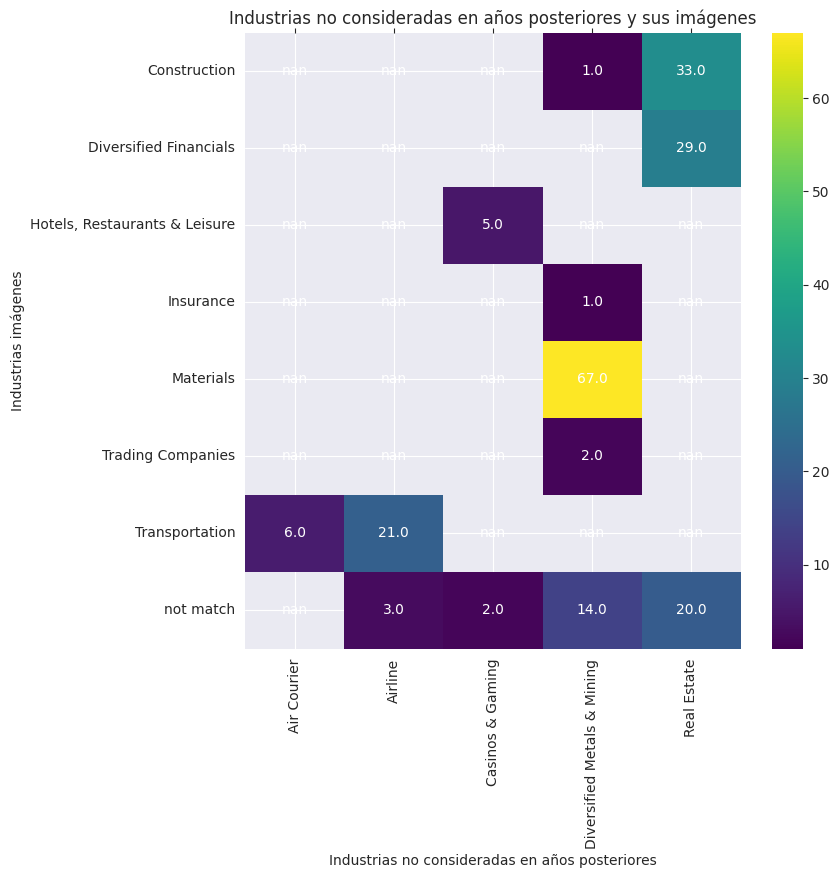

,Company,Industry_x,Industry_y
0,Glencore International,Diversified Metals & Mining,Materials
1,Citic Pacific,Diversified Metals & Mining,NaN
2,BHP Billiton,Diversified Metals & Mining,NaN
3,Rio Tinto,Diversified Metals & Mining,Materials
4,China Evergrande Group,Real Estate,Construction
...,...,...,...
199,Aeroflot-Russian Airlines,Airline,NaN
200,CNX Resources,Diversified Metals & Mining,NaN
201,Sinotrans Ltd.,Air Courier,Transportation
202,HCP,Real Estate,NaN


In [ ]:
graficando_heat_map_match_industria(industrias_desaparecidas,df_2018,df_2019)

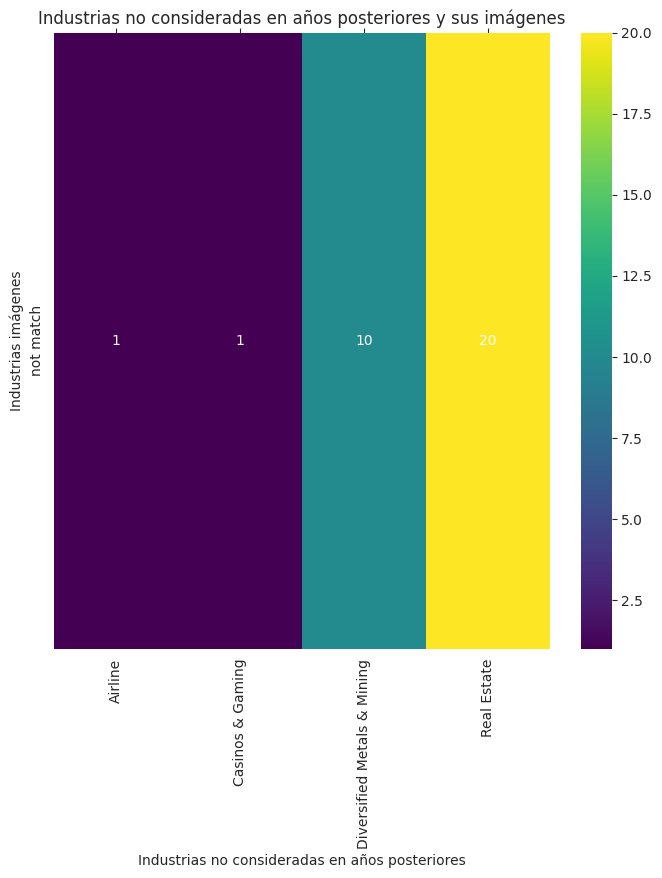

,Company,Industry_x,Industry_y
0,Citic Pacific,Diversified Metals & Mining,NaN
1,BHP Billiton,Diversified Metals & Mining,NaN
2,Poly Real Estate,Real Estate,NaN
3,Nippon Steel & Sumitomo Metal,Diversified Metals & Mining,NaN
4,United Continental Holdings,Airline,NaN
5,Cheung Kong Property Holdings,Real Estate,NaN
6,Longfor Properties,Real Estate,NaN
7,Abitare In Spa,Real Estate,NaN
8,Westfield,Real Estate,NaN
9,Agile Property Holdings,Real Estate,NaN


In [ ]:
reducir_numero_industrias_matching(industrias_desaparecidas,df_2018,df_26)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2018,df_2019)

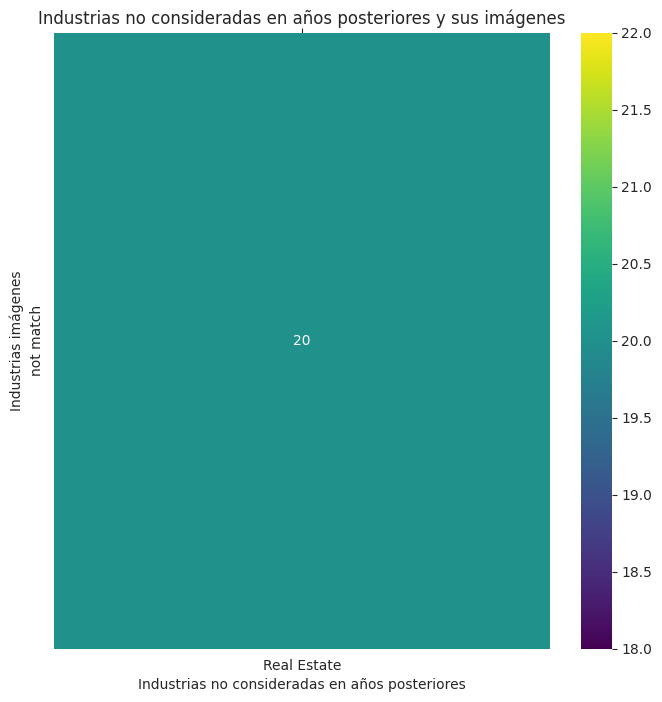

,Company,Industry_x,Industry_y
0,Poly Real Estate,Real Estate,NaN
1,Cheung Kong Property Holdings,Real Estate,NaN
2,Longfor Properties,Real Estate,NaN
3,Abitare In Spa,Real Estate,NaN
4,Westfield,Real Estate,NaN
5,Agile Property Holdings,Real Estate,NaN
6,General Growth Properties,Real Estate,NaN
7,Sino-Ocean Land Holdings,Real Estate,NaN
8,Foncière des Régions,Real Estate,NaN
9,Future Land Development Holdings,Real Estate,NaN


In [ ]:
reducir_numero_industrias_replacing(df_2018)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2018,df_2019)

In [ ]:
empresas_industria_desconocida_2018={'Poly Real Estate':'Construction',
                                     'Cheung Kong Property Holdings':'Construction',
                                     'Longfor Properties':'Construction',
                                     'Abitare In Spa':'Construction',
                                     'Westfield':'Diversified Financials',
                                     'Agile Property Holdings':'Construction',
                                     'General Growth Properties':'Diversified Financials',
                                     'Sino-Ocean Land Holdings':'Construction',
                                     'Foncière des Régions':'Diversified Financials',
                                     'Future Land Development Holdings':'Construction',
                                     'British Land':'Diversified Financials',
                                     'Sino Land':'Construction',
                                     'Stockland Australia':'Construction',
                                     'Vicinity Centres':'Construction',
                                     'Two Harbors Investment':'Diversified Financials',
                                     'UOL Group':'Diversified Financials',
                                     'Inmobiliaria Colonial,':'Construction',
                                     'CPI Property Group.':'Diversified Financials',
                                      'Shanghai Lujianzi':'Construction',
                                     'HCP':'Diversified Financials'}

In [ ]:
for key in empresas_industria_desconocida_2018:
  df_2018.loc[df_2018.Company==key, 'Industry'] = empresas_industria_desconocida_2018[key]

In [ ]:
len(df_2018.Industry.unique())

26

##### 3.1.2.3.2 Reduciendo el número de industrias dataset 2017

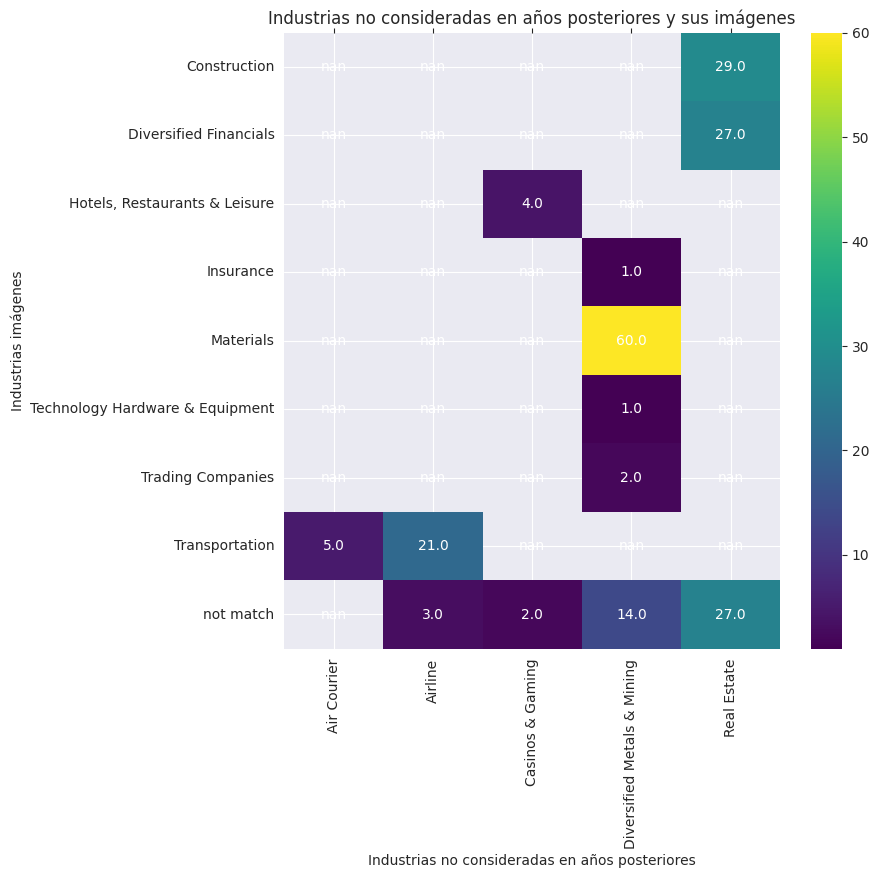

,Company,Industry_x,Industry_y
0,Citic Pacific,Diversified Metals & Mining,NaN
1,Rio Tinto,Diversified Metals & Mining,Materials
2,BHP Billiton,Diversified Metals & Mining,NaN
3,Vale,Diversified Metals & Mining,Materials
4,United Parcel Service,Air Courier,Transportation
...,...,...,...
191,Steel Authority of India,Diversified Metals & Mining,Materials
192,US Steel,Diversified Metals & Mining,Materials
193,Shanxi Taigang Stainless,Diversified Metals & Mining,Materials
194,Shaanxi Coal Industry,Diversified Metals & Mining,Materials


In [ ]:
graficando_heat_map_match_industria(industrias_desaparecidas,df_2017,df_2019)

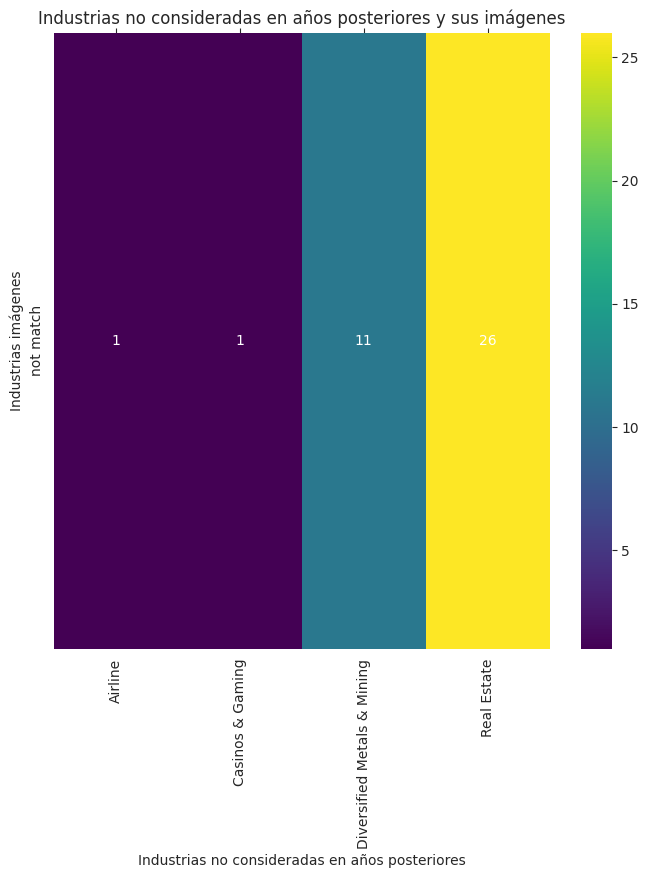

,Company,Industry_x,Industry_y
0,Citic Pacific,Diversified Metals & Mining,NaN
1,BHP Billiton,Diversified Metals & Mining,NaN
2,United Continental Holdings,Airline,NaN
3,Poly Real Estate,Real Estate,NaN
4,Cheung Kong Property Holdings,Real Estate,NaN
5,Nippon Steel & Sumitomo Metal,Diversified Metals & Mining,NaN
6,Longfor Properties,Real Estate,NaN
7,Freeport-mcmoran,Diversified Metals & Mining,NaN
8,General Growth Properties,Real Estate,NaN
9,Westfield,Real Estate,NaN


In [ ]:
reducir_numero_industrias_matching(industrias_desaparecidas,df_2017,df_26)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2017,df_2019)

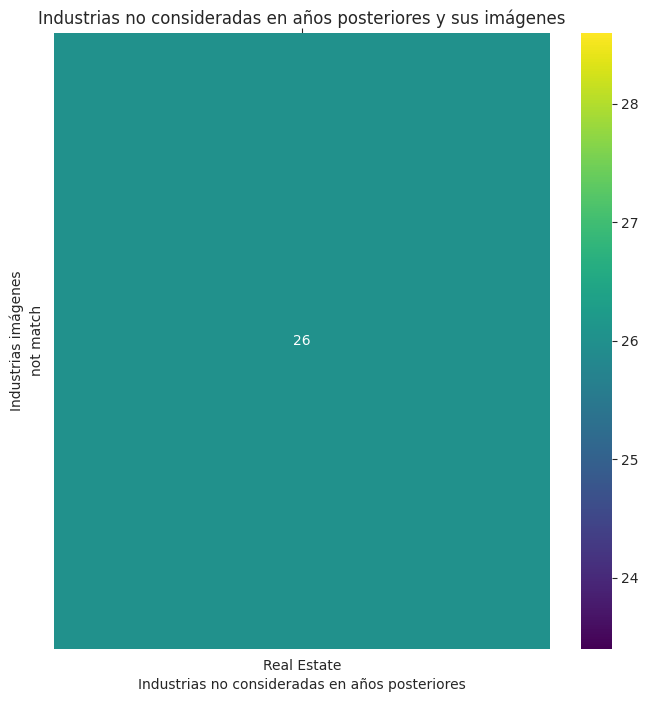

,Company,Industry_x,Industry_y
0,Poly Real Estate,Real Estate,NaN
1,Cheung Kong Property Holdings,Real Estate,NaN
2,Longfor Properties,Real Estate,NaN
3,General Growth Properties,Real Estate,NaN
4,Westfield,Real Estate,NaN
5,Lend Lease Group,Real Estate,NaN
6,HCP,Real Estate,NaN
7,Global Logistic Properties,Real Estate,NaN
8,Vicinity Centres,Real Estate,NaN
9,Foncière des Régions,Real Estate,NaN


In [ ]:
reducir_numero_industrias_replacing(df_2017)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2017,df_2019)

In [ ]:
for key in empresas_industria_desconocida_2018:
  df_2017.loc[df_2017.Company==key, 'Industry'] = empresas_industria_desconocida_2018[key]

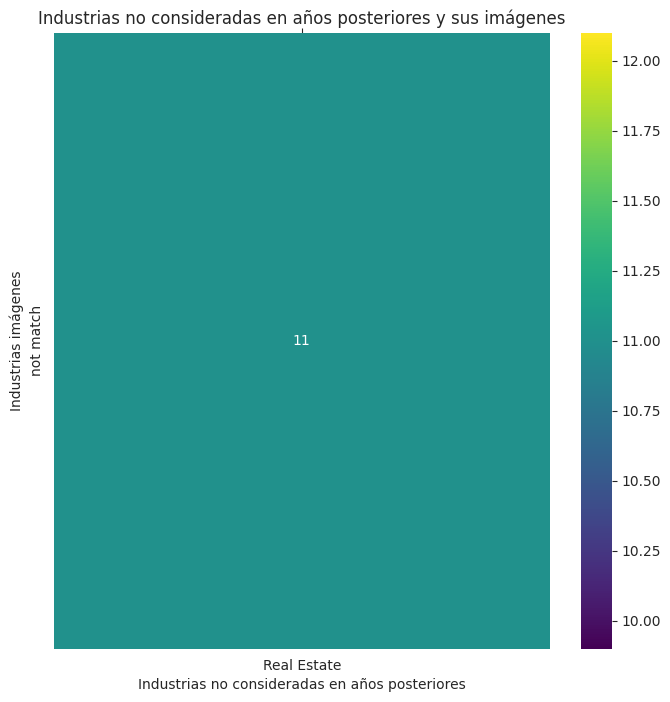

,Company,Industry_x,Industry_y
0,Lend Lease Group,Real Estate,NaN
1,Global Logistic Properties,Real Estate,NaN
2,Ezdan Holding Group,Real Estate,NaN
3,SL Green Realty,Real Estate,NaN
4,City Developments,Real Estate,NaN
5,Damac Properties,Real Estate,NaN
6,Shanghai Industrial Holdings,Real Estate,NaN
7,Chinese Estates,Real Estate,NaN
8,Aroundtown Property Holdings,Real Estate,NaN
9,Aldar Properties,Real Estate,NaN


In [ ]:
reducir_numero_industrias_replacing(df_2017)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2017,df_2019)

In [ ]:
empresas_industria_desconocida_2017={'Lend Lease Group':'Construction',
                                     'Global Logistic Properties':'Diversified Financials',
                                     'Ezdan Holding Group':'Construction',
                                     'SL Green Realty':'Diversified Financials',
                                     'City Developments':'Construction',
                                     'Damac Properties':'Construction',
                                     'Shanghai Industrial Holdings':'Construction',
                                     'Chinese Estates':'Construction',
                                     'Aroundtown Property Holdings':'Diversified Financials',
                                     'Aldar Properties':'Construction',
                                     'Vereit':'Diversified Financials'}

In [ ]:
for key in empresas_industria_desconocida_2017:
  df_2017.loc[df_2017.Company==key, 'Industry'] = empresas_industria_desconocida_2017[key]

In [ ]:
len(df_2017.Industry.unique())

26

##### 3.1.2.3.3 Reduciendo el número de industrias dataset 2016

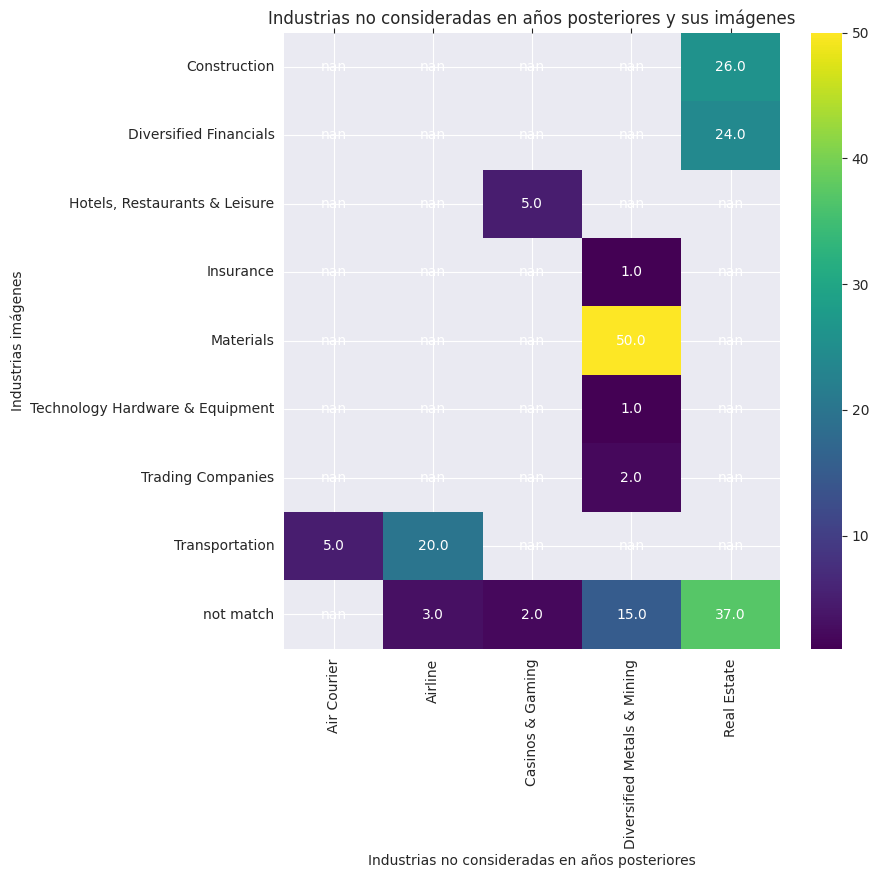

,Company,Industry_x,Industry_y
0,Citic Pacific,Diversified Metals & Mining,NaN
1,United Parcel Service,Air Courier,Transportation
2,China Shenhua Energy,Diversified Metals & Mining,Materials
3,Delta Air Lines,Airline,Transportation
4,China Vanke,Real Estate,Construction
...,...,...,...
186,Beijing Capital Development,Real Estate,Construction
187,Wintime Energy,Diversified Metals & Mining,NaN
188,Ivanhoe Mines,Diversified Metals & Mining,NaN
189,Wynn Resorts,Casinos & Gaming,"Hotels, Restaurants & Leisure"


In [ ]:
graficando_heat_map_match_industria(industrias_desaparecidas,df_2016,df_2019)

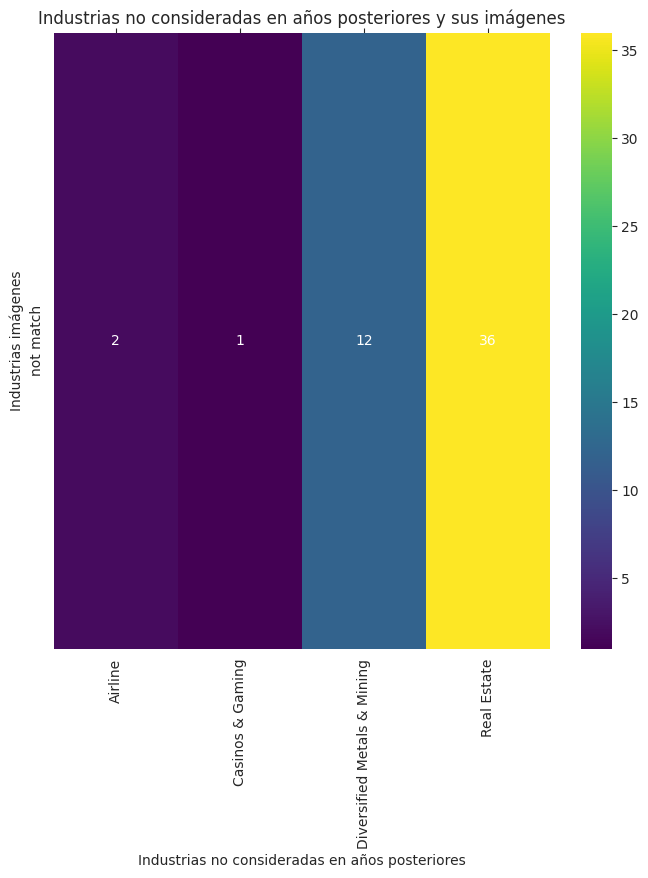

,Company,Industry_x,Industry_y
0,Citic Pacific,Diversified Metals & Mining,NaN
1,Nippon Steel & Sumitomo Metal,Diversified Metals & Mining,NaN
2,United Continental Holdings,Airline,NaN
3,Poly Real Estate,Real Estate,NaN
4,Evergrande Real Estate,Real Estate,NaN
5,Cheung Kong Property Holdings,Real Estate,NaN
6,BHP Billiton,Diversified Metals & Mining,NaN
7,Longfor Properties,Real Estate,NaN
8,Freeport,Diversified Metals & Mining,NaN
9,General Growth Properties,Real Estate,NaN


In [ ]:
reducir_numero_industrias_matching(industrias_desaparecidas,df_2016,df_26)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2016,df_2019)

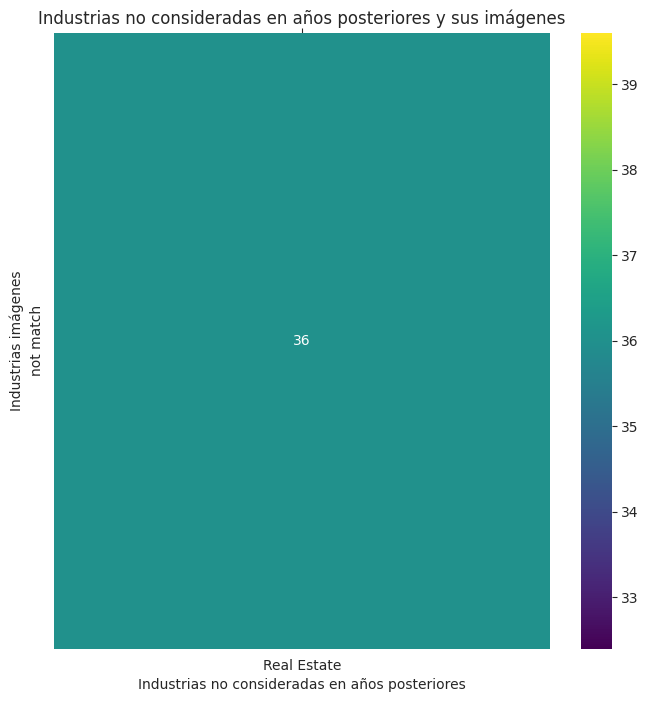

,Company,Industry_x,Industry_y
0,Poly Real Estate,Real Estate,NaN
1,Evergrande Real Estate,Real Estate,NaN
2,Cheung Kong Property Holdings,Real Estate,NaN
3,Longfor Properties,Real Estate,NaN
4,General Growth Properties,Real Estate,NaN
5,Westfield,Real Estate,NaN
6,British Land,Real Estate,NaN
7,Avalonbay Communities,Real Estate,NaN
8,Lend Lease Group,Real Estate,NaN
9,Global Logistic Properties,Real Estate,NaN


In [ ]:
reducir_numero_industrias_replacing(df_2016)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2016,df_2019)

In [ ]:
for key in empresas_industria_desconocida_2018:
  df_2016.loc[df_2016.Company==key, 'Industry'] = empresas_industria_desconocida_2018[key]

for key in empresas_industria_desconocida_2017:
  df_2016.loc[df_2016.Company==key, 'Industry'] = empresas_industria_desconocida_2017[key]

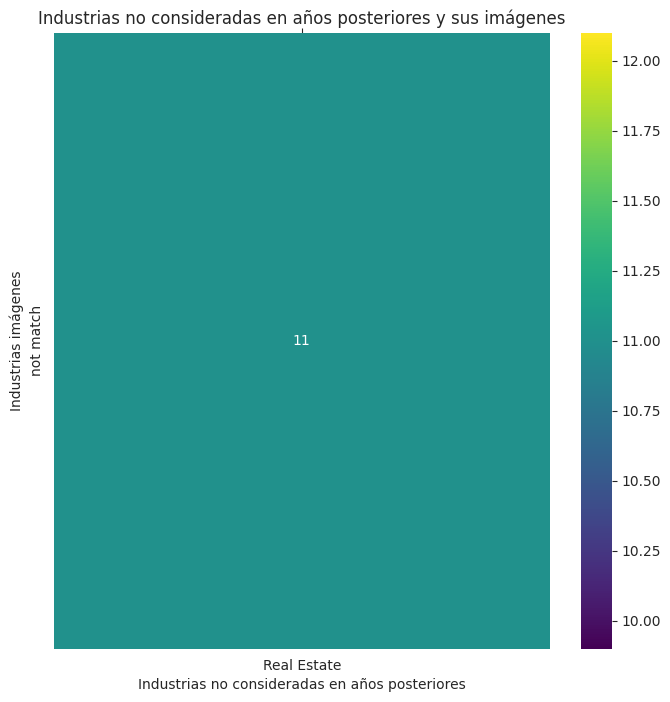

,Company,Industry_x,Industry_y
0,Evergrande Real Estate,Real Estate,NaN
1,Avalonbay Communities,Real Estate,NaN
2,Hammerson,Real Estate,NaN
3,Intu Properties,Real Estate,NaN
4,American Capital Agency,Real Estate,NaN
5,Corporacion Geo,Real Estate,NaN
6,Derwent London,Real Estate,NaN
7,Great Portland Estates,Real Estate,NaN
8,Macerich,Real Estate,NaN
9,Barwa Real Estate,Real Estate,NaN


In [ ]:
graficando_heat_map_match_industria(industrias_desaparecidas,df_2016,df_2019)

In [ ]:
empresas_industria_desconocida_2016={'Evergrande Real Estate':'Construction',
                                     'Avalonbay Communities':'Construction',
                                     'Hammerson':'Diversified Financials',
                                     'Intu Properties':'Diversified Financials',
                                     'American Capital Agency':'Diversified Financials',
                                     'Corporacion Geo':'Construction',
                                     'Derwent London':'Diversified Financials',
                                     'Great Portland Estates': 'Diversified Financials',
                                     'Macerich': 'Diversified Financials',
                                     'Barwa Real Estate':'Construction',
                                     'Shaftesbury':'Diversified Financials'}

In [ ]:
for key in empresas_industria_desconocida_2016:
  df_2016.loc[df_2016.Company==key, 'Industry'] = empresas_industria_desconocida_2016[key]

In [ ]:
len(df_2016.Industry.unique())

26

##### 3.1.2.3.4 Reduciendo el número de industrias dataset 2015

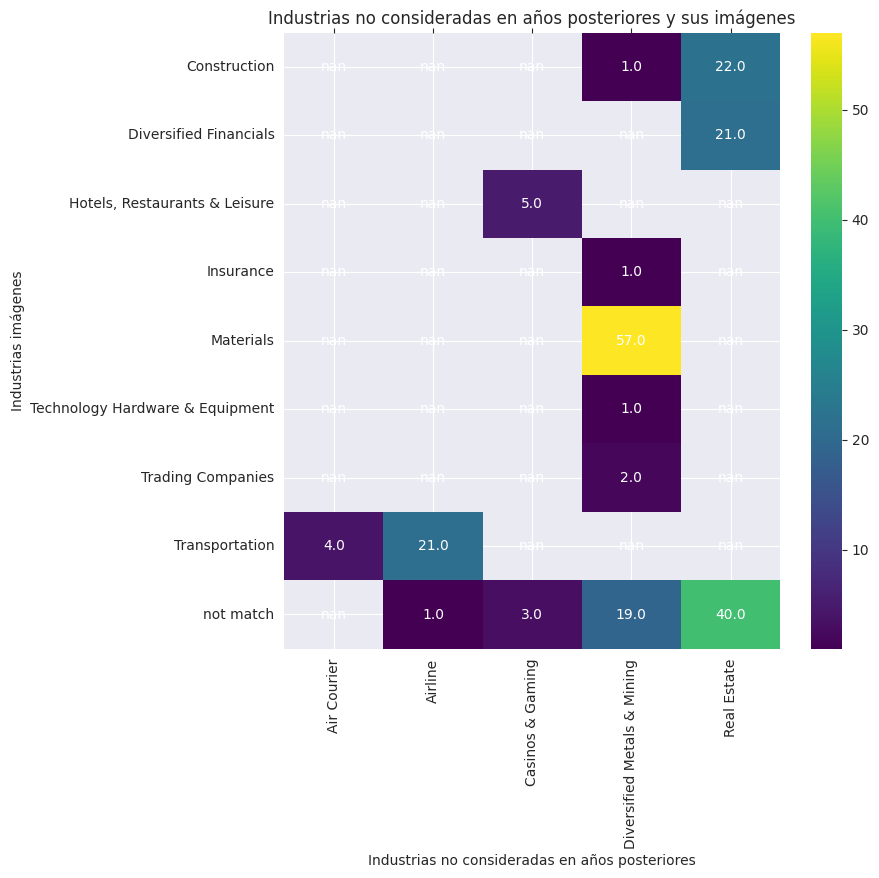

,Company,Industry_x,Industry_y
0,BHP Billiton,Diversified Metals & Mining,NaN
1,Citic Pacific,Diversified Metals & Mining,NaN
2,Rio Tinto,Diversified Metals & Mining,Materials
3,Glencore International,Diversified Metals & Mining,Materials
4,China Shenhua Energy,Diversified Metals & Mining,Materials
...,...,...,...
193,Umicore,Diversified Metals & Mining,Materials
194,Yuexiu Property Co.,Real Estate,NaN
195,Xinhu Zhongbao,Diversified Metals & Mining,Construction
196,Alrosa,Diversified Metals & Mining,Materials


In [ ]:
graficando_heat_map_match_industria(industrias_desaparecidas,df_2015,df_2019)

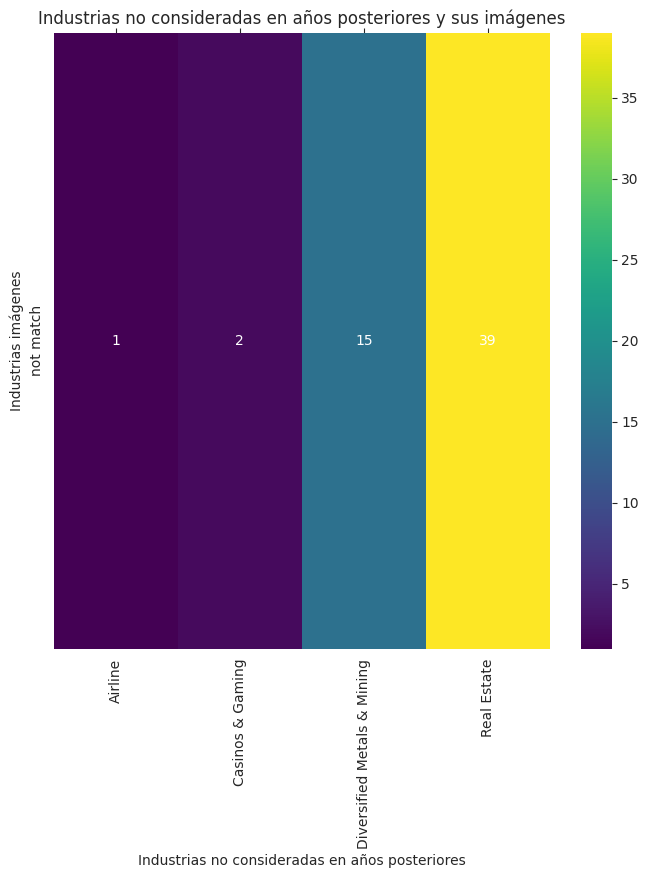

,Company,Industry_x,Industry_y
0,BHP Billiton,Diversified Metals & Mining,NaN
1,Citic Pacific,Diversified Metals & Mining,NaN
2,Nippon Steel & Sumitomo Metal,Diversified Metals & Mining,NaN
3,Poly Real Estate,Real Estate,NaN
4,United Continental Holdings,Airline,NaN
5,Evergrande Real Estate,Real Estate,NaN
6,Wheelock & Co,Real Estate,NaN
7,Freeport,Diversified Metals & Mining,NaN
8,Longfor Properties,Real Estate,NaN
9,China Merchants Property,Real Estate,NaN


In [ ]:
reducir_numero_industrias_matching(industrias_desaparecidas,df_2015,df_26)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2015,df_2019)

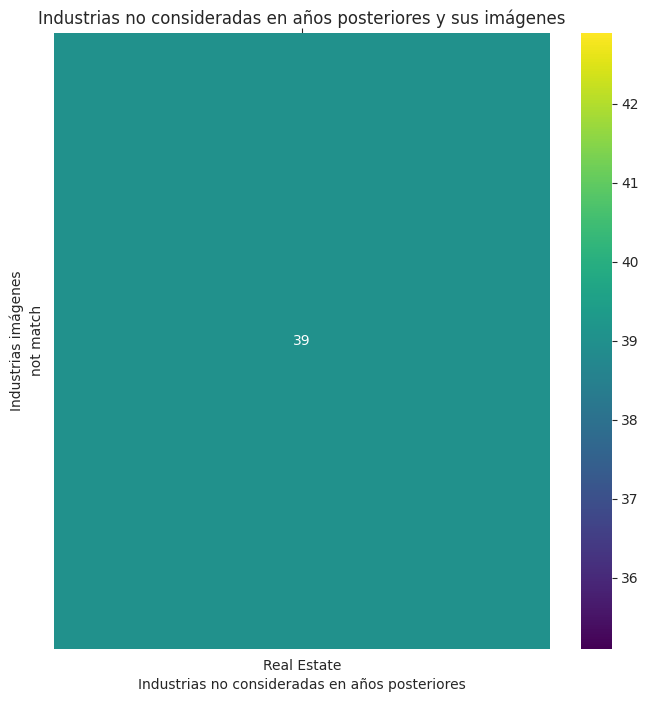

,Company,Industry_x,Industry_y
0,Poly Real Estate,Real Estate,NaN
1,Evergrande Real Estate,Real Estate,NaN
2,Wheelock & Co,Real Estate,NaN
3,Longfor Properties,Real Estate,NaN
4,China Merchants Property,Real Estate,NaN
5,General Growth Properties,Real Estate,NaN
6,HCP,Real Estate,NaN
7,British Land,Real Estate,NaN
8,Health Care REIT,Real Estate,NaN
9,Lend Lease Group,Real Estate,NaN


In [ ]:
reducir_numero_industrias_replacing(df_2015)
graficando_heat_map_match_industria(industrias_desaparecidas,df_2015,df_2019)

In [ ]:
for key in empresas_industria_desconocida_2018:
  df_2015.loc[df_2015.Company==key, 'Industry'] = empresas_industria_desconocida_2018[key]

for key in empresas_industria_desconocida_2017:
  df_2015.loc[df_2015.Company==key, 'Industry'] = empresas_industria_desconocida_2017[key]

for key in empresas_industria_desconocida_2016:
  df_2015.loc[df_2015.Company==key, 'Industry'] = empresas_industria_desconocida_2016[key]

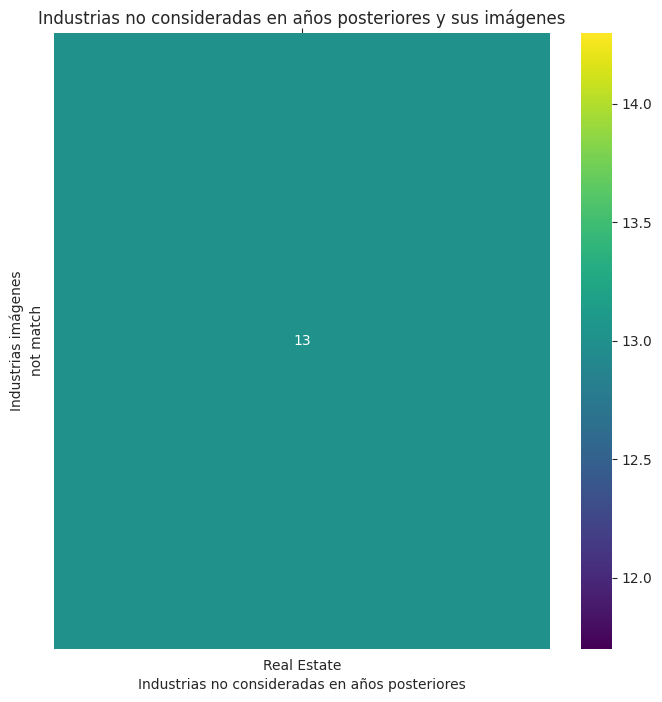

,Company,Industry_x,Industry_y
0,Wheelock & Co,Real Estate,NaN
1,China Merchants Property,Real Estate,NaN
2,Health Care REIT,Real Estate,NaN
3,Hammerson plc,Real Estate,NaN
4,Intu Properties plc,Real Estate,NaN
5,American Realty Capital Properties,Real Estate,NaN
6,Tokyo Tatemono,Real Estate,NaN
7,SOHO China,Real Estate,NaN
8,Jones Lang LaSalle Inc.,Real Estate,NaN
9,CYS Investments,Real Estate,NaN


In [ ]:
graficando_heat_map_match_industria(industrias_desaparecidas,df_2015,df_2019)

In [ ]:
empresas_industria_desconocida_2015={'Wheelock & Co': 'Diversified Financials',
'China Merchants Property': 'Construction',
'Health Care REIT': 'Diversified Financials',
'Hammerson plc': 'Diversified Financials',
'Intu Properties plc': 'Diversified Financials',
'American Realty Capital Properties': 'Diversified Financials',
'Tokyo Tatemono': 'Construction',
'SOHO China': 'Construction',
'Jones Lang LaSalle Inc.': 'Diversified Financials',
'CYS Investments': 'Diversified Financials',
'Shui On Land': 'Construction',
'Hysan Development': 'Construction',
'Yuexiu Property Co.': 'Construction'}

In [ ]:
for key in empresas_industria_desconocida_2015:
  df_2015.loc[df_2015.Company==key, 'Industry'] = empresas_industria_desconocida_2015[key]

In [ ]:
len(df_2015.Industry.unique())

26

### 3.1.3 Imputación valores nulos y reducir número de industrias (dataset 2023)

In [ ]:
dataframes_forbes_from_2015_ckecked = [df_2015,df_2016,df_2017,df_2018,df_2019,df_2020, df_2021, df_2022]

In [ ]:
forbes_2023.head()

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
0,1,JPMorgan Chase,Banking,United States,179933.0,41795.0,3744305,399594
1,2,Saudi Arabian Oil Company (Saudi Aramco),Oil & Gas Operations,Saudi Arabia,589467.0,156357.0,660990,2055222
2,3,ICBC,Banking and Financial Services,China,216767.0,52470.8,6116824,203012
3,4,China Construction Bank,Banking,China,203083.0,48252.5,4977476,172992
4,5,Agricultural Bank of China,Banking,China,186144.0,37924.7,5356862,141822


In [ ]:
forbes_2023.isnull().sum()

Rank_nr         0
Company         0
Industry        0
Country         0
Sales           0
Profits         0
Assets          0
Market_Value    0
dtype: int64

In [ ]:
len(forbes_2023.Industry.unique())

40

In [ ]:
industries_2023_set=set(forbes_2023.Industry.unique())
industries_2022=set(df_2022.Industry.unique())
industrias_adicionales_2023=industries_2023_set.difference(industries_2022)
industrias_adicionales_2023=list(industrias_adicionales_2023)
industrias_adicionales_2023

['Banking and Financial Services',
 'Technology Hardware',
 'Automobiles',
 'Household & Personal Products',
 'United States',
 'Recruiting',
 'Professional Service',
 'Technology, IT Solutions & Distribution',
 'Construction, Oil & Gas Operations, Mining and Chemicals',
 'Telecommunications Services, Cable Supplier',
 'Semiconductors, Electronics, Electrical Engineering, Technology Hardware & Equipment',
 'Food Products',
 'Engineering, Manufacturing',
 'Food & Drink']

In [ ]:
forbes_2023[forbes_2023.Industry=='United States']

,Rank_nr,Company,Industry,Country,Sales,Profits,Assets,Market_Value
647,648,New York,United States,12489,616.6,41086.0,98798,1490


**Buscando en la página de Forbes, encontré que la empresa de la posición 648 es "Blackstone" por lo cual procedo a cambiar los datos de esa fila**

In [ ]:
forbes_2023.columns

Index(['Rank_nr', 'Company', 'Industry', 'Country', 'Sales', 'Profits',
       'Assets', 'Market_Value'],
      dtype='object')

In [ ]:
blackstone= [648,'Blackstone','Diversified Financials','United States',12489,616.6,41086,98800]
blackstone_row=dict(zip(forbes_2023.columns,blackstone))
blackstone_row

{'Rank_nr': 648,
 'Company': 'Blackstone',
 'Industry': 'Diversified Financials',
 'Country': 'United States',
 'Sales': 12489,
 'Profits': 616.6,
 'Assets': 41086,
 'Market_Value': 98800}

In [ ]:
forbes_2023.loc[647]=blackstone_row

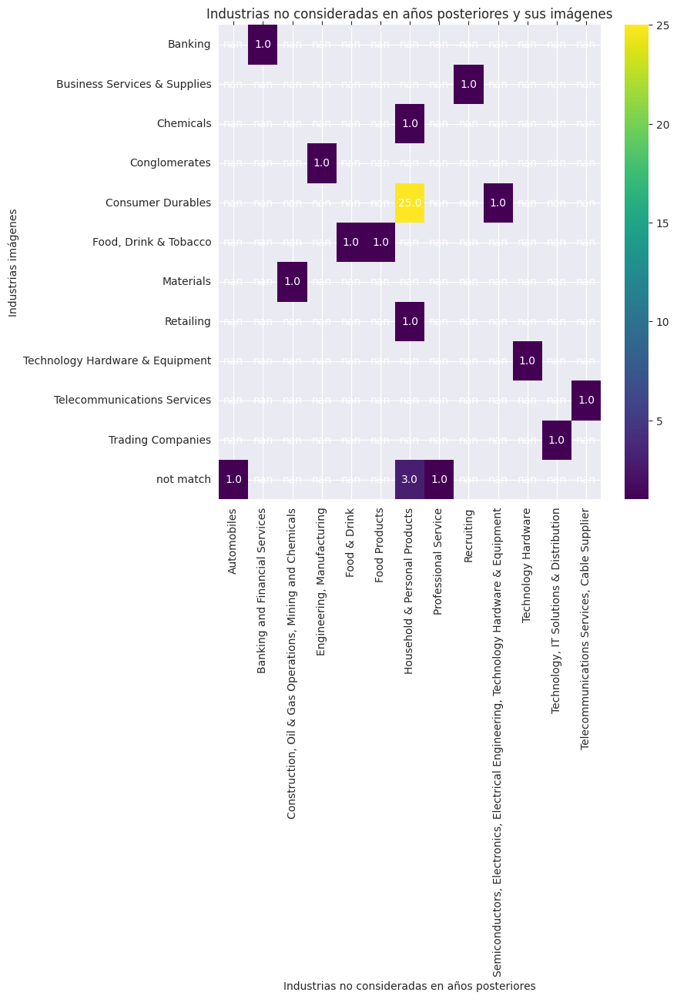

,Company,Industry_x,Industry_y
0,ICBC,Banking and Financial Services,Banking
1,LVMH Moët Hennessy Louis Vuitton,Household & Personal Products,Consumer Durables
2,Procter & Gamble,Household & Personal Products,Consumer Durables
3,Tesla,Automobiles,NaN
4,BHP Group,"Construction, Oil & Gas Operations, Mining and...",Materials
5,Siemens,"Engineering, Manufacturing",Conglomerates
6,Unilever,Household & Personal Products,Consumer Durables
7,Philip Morris International,Food Products,"Food, Drink & Tobacco"
8,L'Oréal,Household & Personal Products,Consumer Durables
9,Nike,Household & Personal Products,Consumer Durables


In [ ]:
graficando_heat_map_match_industria(industrias_adicionales_2023,forbes_2023,df_2022)

In [ ]:
df_2022.Industry.unique()

array(['Diversified Financials', 'Banking', 'Oil & Gas Operations',
       'Retailing', 'Technology Hardware & Equipment',
       'Consumer Durables', 'IT Software & Services', 'Insurance',
       'Telecommunications Services', 'Media', 'Drugs & Biotechnology',
       'Food, Drink & Tobacco', 'Semiconductors', 'Materials',
       'Conglomerates', 'Trading Companies', 'Transportation',
       'Construction', 'Aerospace & Defense', 'Utilities',
       'Health Care Equipment & Services', 'Chemicals', 'Capital Goods',
       'Business Services & Supplies', 'Hotels, Restaurants & Leisure',
       'Food Markets'], dtype=object)

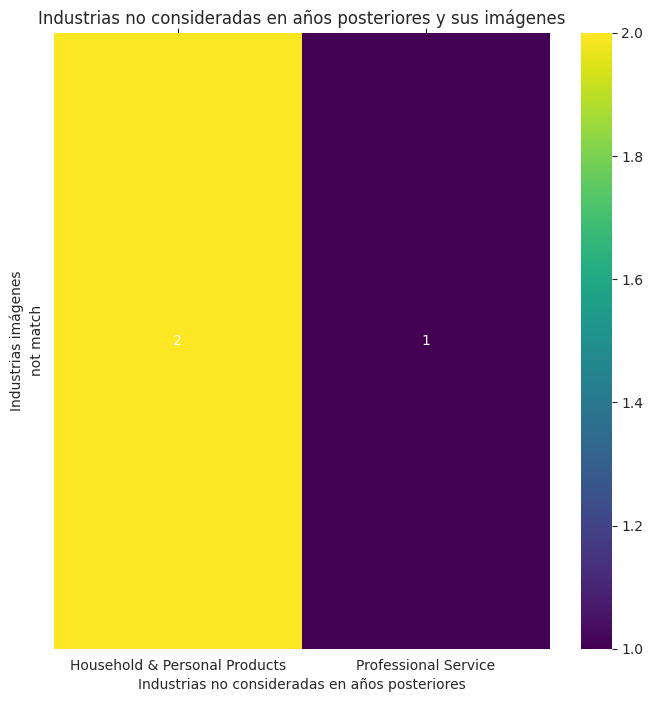

,Company,Industry_x,Industry_y
0,Moncler SpA,Household & Personal Products,NaN
1,AVIC Capital,Professional Service,NaN
2,Sasa Polyester Sanayi,Household & Personal Products,NaN


In [ ]:
reducir_numero_industrias_matching(industrias_adicionales_2023,forbes_2023,dataframes_forbes_from_2015_ckecked)
graficando_heat_map_match_industria(industrias_adicionales_2023,forbes_2023,df_2022)

In [ ]:
empresas_industria_desconocida_2023={
    'Moncler SpA': 'Consumer Durables',
'AVIC Capital': 'Diversified Financials',
'Sasa Polyester Sanayi': 'Materials'}

In [ ]:
for key in empresas_industria_desconocida_2023:
  forbes_2023.loc[forbes_2023.Company==key, 'Industry'] = empresas_industria_desconocida_2023[key]

In [ ]:
len(forbes_2023.Industry.unique())

26

### 3.1.4 Resultado final

In [ ]:
dataframes_forbes_from_2015_ckecked.append(forbes_2023)

In [ ]:
for i in range(len(dataframes_forbes_from_2015_ckecked)):
  print(f'El número total de industrias del dataset del año {i+2015} es {len(dataframes_forbes_from_2015_ckecked[i].Industry.unique())}')

El número total de industrias del dataset del año 2015 es 26
El número total de industrias del dataset del año 2016 es 26
El número total de industrias del dataset del año 2017 es 26
El número total de industrias del dataset del año 2018 es 26
El número total de industrias del dataset del año 2019 es 26
El número total de industrias del dataset del año 2020 es 26
El número total de industrias del dataset del año 2021 es 26
El número total de industrias del dataset del año 2022 es 26
El número total de industrias del dataset del año 2023 es 26


In [ ]:
for index, df in enumerate(dataframes_forbes_from_2015_ckecked, start=2015):
  column_dict= {
 'Company': 'Empresa',
 'Industry': 'Industria',
 'Country': 'Pais',
 'Sales': 'Ingresos',
 'Profits': 'Ganancias',
 'Assets': 'Activos',
 'Market_Value': 'Valor de Mercado'}
  df.rename(columns=column_dict,inplace=True)
  df['Margen de Rentabilidad']=round((df['Ganancias']/df['Ingresos'])*100,2)
  df['ROA']=round((df['Ganancias']/df['Activos'])*100,2)
  df['Año']=index

In [ ]:
dataframes_forbes_from_2015_ckecked[-1].head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año
0,1,JPMorgan Chase,Banking,United States,179933.0,41795.0,3744305,399594,23.23,1.12,2023
1,2,Saudi Arabian Oil Company (Saudi Aramco),Oil & Gas Operations,Saudi Arabia,589467.0,156357.0,660990,2055222,26.53,23.65,2023
2,3,ICBC,Banking,China,216767.0,52470.8,6116824,203012,24.21,0.86,2023
3,4,China Construction Bank,Banking,China,203083.0,48252.5,4977476,172992,23.76,0.97,2023
4,5,Agricultural Bank of China,Banking,China,186144.0,37924.7,5356862,141822,20.37,0.71,2023


## 3.2 Fortune Global 500 datasets (2015 - 2023)

### 3.2.1 Data imputation and data selection (datasets 2015 - 2022)

In [ ]:
for index, df in enumerate(dataframes_fortune,start=2015):
  print(index)
  print('missing values: ',df.isnull().sum().sum())
  print('______________________________________')

2015
missing values:  0
______________________________________
2016
missing values:  0
______________________________________
2017
missing values:  0
______________________________________
2018
missing values:  0
______________________________________
2019
missing values:  0
______________________________________
2020
missing values:  0
______________________________________
2021
missing values:  0
______________________________________
2022
missing values:  0
______________________________________


In [ ]:
dataframes_fortune_to_join=[]
for index, df in enumerate(dataframes_fortune,start=2015):
 df.rename(columns={'RemoveName':'Empresa','RemoveEmployees':'Empleados'},inplace=True)
 df['Año']=index
 df_to_join=df[['Empresa','Empleados','Año']]
 dataframes_fortune_to_join.append(df_to_join)

dataframes_fortune_to_join[7].head(10)

,Empresa,Empleados,Año
0,Walmart,2300000,2022
1,Amazon,1608000,2022
2,State Grid,871145,2022
3,China National Petroleum,1090345,2022
4,Sinopec Group,542286,2022
5,Saudi Aramco,68493,2022
6,Apple,154000,2022
7,Volkswagen,672789,2022
8,China State Construction Engineering,368327,2022
9,CVS Health,258000,2022


### 3.2.2 Data imputation and data selection (dataset 2023)

In [ ]:
fortune_2023.head()

,Rank,Company Name,Country,Number of Employees,Previous \nRank,Revenues\n($millions),Revenue \nChange,Profits\n($millions),Profit \nChange,Assets\n($millions)
0,1,Walmart,U.S.,2100000,1,611289,0.067,11680,-0.146,243197
1,2,Saudi Aramco,Saudi Arabia,70496,6,603651,0.508,159069,0.51,663541
2,3,State Grid,China,870287,3,530009,0.151,8192,0.148,710763
3,4,Amazon,U.S.,1541000,2,513983,0.094,-2722,-1.082,462675
4,5,China National Petroleum,China,1087049,4,483019,0.173,21080,1.187,637223


In [ ]:
fortune_2023.rename(columns={'Company Name':'Empresa','Number of Employees':'Empleados'},inplace=True)
fortune_2023['Año']=2023
fortune_2023=fortune_2023[['Empresa','Empleados','Año']]
fortune_2023.head()


,Empresa,Empleados,Año
0,Walmart,2100000,2023
1,Saudi Aramco,70496,2023
2,State Grid,870287,2023
3,Amazon,1541000,2023
4,China National Petroleum,1087049,2023


### 3.2.3 Final Result

In [ ]:
dataframes_fortune_to_join.append(fortune_2023)

## 3.3 Geography datasets

### 3.3.1 Preparation of data dataset "continents"

In [ ]:
continentes.head()

,Continent_Name,Continent_Code,Three_Letter_Country_Code,Country_Name
0,Asia,AS,AFG,"Afghanistan, Islamic Republic of"
1,Europe,EU,ALB,"Albania, Republic of"
2,Antarctica,AN,ATA,Antarctica (the territory South of 60 deg S)
3,Africa,AF,DZA,"Algeria, People's Democratic Republic of"
4,Oceania,OC,ASM,American Samoa


In [ ]:
continentes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 258 entries, 0 to 257
Data columns (total 4 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   Continent_Name             258 non-null    object
 1   Continent_Code             215 non-null    object
 2   Three_Letter_Country_Code  258 non-null    object
 3   Country_Name               258 non-null    object
dtypes: object(4)
memory usage: 8.2+ KB


In [ ]:
continentes.rename(columns={'Continent_Name':'Continente','Three_Letter_Country_Code':'Codigo','Country_Name':'Pais'},inplace=True)
continentes=continentes[['Continente','Codigo','Pais']]
continentes.head()

,Continente,Codigo,Pais
0,Asia,AFG,"Afghanistan, Islamic Republic of"
1,Europe,ALB,"Albania, Republic of"
2,Antarctica,ATA,Antarctica (the territory South of 60 deg S)
3,Africa,DZA,"Algeria, People's Democratic Republic of"
4,Oceania,ASM,American Samoa


In [ ]:
continentes[continentes.duplicated(subset=['Codigo'], keep=False)]

,Continente,Codigo,Pais
8,Europe,AZE,"Azerbaijan, Republic of"
9,Asia,AZE,"Azerbaijan, Republic of"
16,Europe,ARM,"Armenia, Republic of"
17,Asia,ARM,"Armenia, Republic of"
58,Europe,CYP,"Cyprus, Republic of"
59,Asia,CYP,"Cyprus, Republic of"
83,Europe,GEO,Georgia
84,Asia,GEO,Georgia
116,Europe,KAZ,"Kazakhstan, Republic of"
117,Asia,KAZ,"Kazakhstan, Republic of"


In [ ]:
continentes.drop_duplicates(subset=['Codigo'],inplace=True)
continentes.reset_index(drop=True)

,Continente,Codigo,Pais
0,Asia,AFG,"Afghanistan, Islamic Republic of"
1,Europe,ALB,"Albania, Republic of"
2,Antarctica,ATA,Antarctica (the territory South of 60 deg S)
3,Africa,DZA,"Algeria, People's Democratic Republic of"
4,Oceania,ASM,American Samoa
...,...,...,...
245,South America,VEN,"Venezuela, Bolivarian Republic of"
246,Oceania,WLF,Wallis and Futuna
247,Oceania,WSM,"Samoa, Independent State of"
248,Asia,YEM,Yemen


### 3.3.2 Preparation of data dataset "countries"

In [ ]:
paises.head()

,Country,Code
0,Afghanistan,AFG
1,Albania,ALB
2,Algeria,DZA
3,American Samoa,ASM
4,Andorra,AND


In [ ]:
paises.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 222 entries, 0 to 221
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   Country  222 non-null    object
 1   Code     222 non-null    object
dtypes: object(2)
memory usage: 3.6+ KB


In [ ]:
paises.rename(columns={'Country':'Pais','Code':'Codigo'},inplace=True)

In [ ]:
paises.head()

,Pais,Codigo
0,Afghanistan,AFG
1,Albania,ALB
2,Algeria,DZA
3,American Samoa,ASM
4,Andorra,AND


---
# 4. Table Summarisation and Exploratory Analysis
---



## 4.1 Part-1

In [ ]:
forbes_2023.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año
0,1,JPMorgan Chase,Banking,United States,179933.0,41795.0,3744305,399594,23.23,1.12,2023
1,2,Saudi Arabian Oil Company (Saudi Aramco),Oil & Gas Operations,Saudi Arabia,589467.0,156357.0,660990,2055222,26.53,23.65,2023
2,3,ICBC,Banking,China,216767.0,52470.8,6116824,203012,24.21,0.86,2023
3,4,China Construction Bank,Banking,China,203083.0,48252.5,4977476,172992,23.76,0.97,2023
4,5,Agricultural Bank of China,Banking,China,186144.0,37924.7,5356862,141822,20.37,0.71,2023


In [ ]:
paises.head()

,Pais,Codigo
0,Afghanistan,AFG
1,Albania,ALB
2,Algeria,DZA
3,American Samoa,ASM
4,Andorra,AND


In [ ]:
forbes_2023_join_paises=pd.merge(forbes_2023,paises,how='left',on=['Pais'])
forbes_2023_join_paises.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo
0,1,JPMorgan Chase,Banking,United States,179933.0,41795.0,3744305,399594,23.23,1.12,2023,USA
1,2,Saudi Arabian Oil Company (Saudi Aramco),Oil & Gas Operations,Saudi Arabia,589467.0,156357.0,660990,2055222,26.53,23.65,2023,SAU
2,3,ICBC,Banking,China,216767.0,52470.8,6116824,203012,24.21,0.86,2023,CHN
3,4,China Construction Bank,Banking,China,203083.0,48252.5,4977476,172992,23.76,0.97,2023,CHN
4,5,Agricultural Bank of China,Banking,China,186144.0,37924.7,5356862,141822,20.37,0.71,2023,CHN


In [ ]:
forbes_2023_join_paises.isnull().sum()

Rank_nr                    0
Empresa                    0
Industria                  0
Pais                       0
Ingresos                   0
Ganancias                  0
Activos                    0
Valor de Mercado           0
Margen de Rentabilidad     0
ROA                        0
Año                        0
Codigo                    59
dtype: int64

In [ ]:
forbes_2023_join_paises[forbes_2023_join_paises.isnull().any(axis=1)]['Pais'].value_counts()

South Korea    59
Name: Pais, dtype: int64

In [ ]:
paises.Pais.unique()

array(['Afghanistan', 'Albania', 'Algeria', 'American Samoa', 'Andorra',
       'Angola', 'Anguilla', 'Antigua and Barbuda', 'Argentina',
       'Armenia', 'Aruba', 'Australia', 'Austria', 'Azerbaijan',
       'Bahamas, The', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus',
       'Belgium', 'Belize', 'Benin', 'Bermuda', 'Bhutan', 'Bolivia',
       'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'British Virgin Islands', 'Brunei', 'Bulgaria', 'Burkina Faso',
       'Burma', 'Burundi', 'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Cayman Islands', 'Central African Republic', 'Chad', 'Chile',
       'China', 'Colombia', 'Comoros',
       'Congo, Democratic Republic of the', 'Congo, Republic of the',
       'Cook Islands', 'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba',
       'Curacao', 'Cyprus', 'Czech Republic', 'Denmark', 'Djibouti',
       'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'E

In [ ]:
paises[paises['Pais']=='Korea, South']

,Pais,Codigo
108,"Korea, South",KOR


In [ ]:
forbes_2023_join_paises.Codigo.fillna('KOR',inplace=True)
forbes_2023_join_paises.isnull().sum()

Rank_nr                   0
Empresa                   0
Industria                 0
Pais                      0
Ingresos                  0
Ganancias                 0
Activos                   0
Valor de Mercado          0
Margen de Rentabilidad    0
ROA                       0
Año                       0
Codigo                    0
dtype: int64

In [ ]:
df_part_1=pd.merge(forbes_2023_join_paises,continentes[['Codigo','Continente']],how='left',on=['Codigo'])
df_part_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2000 entries, 0 to 1999
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 2000 non-null   int64  
 1   Empresa                 2000 non-null   object 
 2   Industria               2000 non-null   object 
 3   Pais                    2000 non-null   object 
 4   Ingresos                2000 non-null   float64
 5   Ganancias               2000 non-null   float64
 6   Activos                 2000 non-null   int64  
 7   Valor de Mercado        2000 non-null   int64  
 8   Margen de Rentabilidad  2000 non-null   float64
 9   ROA                     2000 non-null   float64
 10  Año                     2000 non-null   int64  
 11  Codigo                  2000 non-null   object 
 12  Continente              2000 non-null   object 
dtypes: float64(4), int64(4), object(5)
memory usage: 218.8+ KB


## 4.2 Part-2

In [ ]:
for index, df in enumerate(dataframes_forbes_from_2015_ckecked,start=2015):
  print (index)
  print(df.info())
  print('______________________________________________________________')

2015
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 11 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 2000 non-null   int64  
 1   Empresa                 2000 non-null   object 
 2   Industria               2000 non-null   object 
 3   Pais                    2000 non-null   object 
 4   Ingresos                2000 non-null   float64
 5   Ganancias               2000 non-null   float64
 6   Activos                 2000 non-null   float64
 7   Valor de Mercado        2000 non-null   int64  
 8   Margen de Rentabilidad  2000 non-null   float64
 9   ROA                     2000 non-null   float64
 10  Año                     2000 non-null   int64  
dtypes: float64(5), int64(3), object(3)
memory usage: 172.0+ KB
None
______________________________________________________________
2016
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1999 entries

In [ ]:
dataframes_forbes_from_2015_ckecked[-3].head()


,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año
0,1,ICBC,Banking,China,190467,45768.7,4914670.0,249532,24.03,0.93,2021
1,2,JPMorgan Chase,Diversified Financials,United States,136187,40371.0,3689336.0,464822,29.64,1.09,2021
2,3,Berkshire Hathaway,Diversified Financials,United States,245510,42521.0,873729.0,624408,17.32,4.87,2021
3,4,China Construction Bank,Banking,China,173478,39299.2,4301700.0,210435,22.65,0.91,2021
4,5,Saudi Arabian Oil Company (Saudi Aramco),Oil & Gas Operations,Saudi Arabia,229747,49282.8,510252.0,1897165,21.45,9.66,2021


In [ ]:
# Replace boolean values with the string 'boolean'
dataframes_forbes_from_2015_ckecked[-3].loc[dataframes_forbes_from_2015_ckecked[-3]['Rank_nr'].apply(lambda x: isinstance(x, bool)), 'Rank_nr'] = 'boolean'

# Convert column to numeric, coercing errors to NaN for non-numeric values
numeric_values = pd.to_numeric(dataframes_forbes_from_2015_ckecked[-3]['Rank_nr'], errors='coerce')

# Check if values are within the desired range (1 to 2000)
is_within_range = (numeric_values >= 1) & (numeric_values <= 2000)

#print(is_within_range.all())

for value in is_within_range:
  if value==False:
    print(is_within_range[is_within_range==value].index)

Int64Index([1469], dtype='int64')


In [ ]:
dataframes_forbes_from_2015_ckecked[-3].loc[1469]

Rank_nr                                             True
Empresa                   fred/companies/F2K/2021/105837
Industria                         IT Software & Services
Pais                                                5855
Ingresos                                           68126
Ganancias                                         1793.0
Activos                                           7869.0
Valor de Mercado                                     235
Margen de Rentabilidad                              2.63
ROA                                                22.79
Año                                                 2021
Name: 1469, dtype: object

In [ ]:
dataframes_forbes_from_2015_ckecked[-3].drop(1469,inplace=True)

In [ ]:
dataframes_forbes_from_2015_ckecked[-3] = dataframes_forbes_from_2015_ckecked[-3].reset_index(drop=True)

In [ ]:
# Replace boolean values with the string 'boolean'
dataframes_forbes_from_2015_ckecked[-3].loc[dataframes_forbes_from_2015_ckecked[-3]['Rank_nr'].apply(lambda x: isinstance(x, bool)), 'Rank_nr'] = 'boolean'

# Convert column to numeric, coercing errors to NaN for non-numeric values
numeric_values = pd.to_numeric(dataframes_forbes_from_2015_ckecked[-3]['Rank_nr'], errors='coerce')

# Check if values are within the desired range (1 to 2000)
is_within_range = (numeric_values >= 1) & (numeric_values <= 2000)

#print(is_within_range.all())

for value in is_within_range:
  if value==False:
    print(is_within_range[is_within_range==value].index)

In [ ]:
# Replace boolean values with the string 'boolean'
dataframes_forbes_from_2015_ckecked[-2].loc[dataframes_forbes_from_2015_ckecked[-2]['Rank_nr'].apply(lambda x: isinstance(x, bool)), 'Rank_nr'] = 'boolean'

# Convert column to numeric, coercing errors to NaN for non-numeric values
numeric_values = pd.to_numeric(dataframes_forbes_from_2015_ckecked[-2]['Rank_nr'], errors='coerce')

# Check if values are within the desired range (1 to 2000)
is_within_range = (numeric_values >= 1) & (numeric_values <= 2000)

#print(is_within_range.all())

for value in is_within_range:
  if value==False:
    print(is_within_range[is_within_range==value].index)

Int64Index([735], dtype='int64')


In [ ]:
dataframes_forbes_from_2015_ckecked[-2].loc[735]

Rank_nr                                             True
Empresa                   fred/companies/F2K/2022/105837
Industria                         IT Software & Services
Pais                                               21274
Ingresos                                           28636
Ganancias                                          370.0
Activos                                             1468
Valor de Mercado                                     632
Margen de Rentabilidad                              1.29
ROA                                                 25.2
Año                                                 2022
Name: 735, dtype: object

In [ ]:
dataframes_forbes_from_2015_ckecked[-2].drop(735,inplace=True)

In [ ]:
dataframes_forbes_from_2015_ckecked[-2] = dataframes_forbes_from_2015_ckecked[-2].reset_index(drop=True)

In [ ]:
# Replace boolean values with the string 'boolean'
dataframes_forbes_from_2015_ckecked[-2].loc[dataframes_forbes_from_2015_ckecked[-2]['Rank_nr'].apply(lambda x: isinstance(x, bool)), 'Rank_nr'] = 'boolean'

# Convert column to numeric, coercing errors to NaN for non-numeric values
numeric_values = pd.to_numeric(dataframes_forbes_from_2015_ckecked[-2]['Rank_nr'], errors='coerce')

# Check if values are within the desired range (1 to 2000)
is_within_range = (numeric_values >= 1) & (numeric_values <= 2000)

#print(is_within_range.all())

for value in is_within_range:
  if value==False:
    print(is_within_range[is_within_range==value].index)

In [ ]:
paises[paises['Pais']=='Korea, South']

,Pais,Codigo
108,"Korea, South",KOR


In [ ]:
paises.at[108,'Pais']='South Korea'

In [ ]:
paises[paises['Pais']=='South Korea']

,Pais,Codigo
108,South Korea,KOR


In [ ]:
def merging_dataframes(df):

  merged_df_1 = pd.merge(df,paises,how='left',on=['Pais'])
  merged_df_2= pd.merge(merged_df_1,continentes[['Codigo','Continente']],how='left',on=['Codigo'])

  return merged_df_2

In [ ]:
dataframes_part_2_final=[]
for df in dataframes_forbes_from_2015_ckecked:
  final_df= merging_dataframes(df)
  dataframes_part_2_final.append(final_df)
len(dataframes_part_2_final)

9

In [ ]:
for index, df in enumerate(dataframes_part_2_final,start=2015):
  print(index)
  print(df.shape)
  print(df.isnull().sum())
  print('___________________________')

2015
(2000, 13)
Rank_nr                   0
Empresa                   0
Industria                 0
Pais                      0
Ingresos                  0
Ganancias                 0
Activos                   0
Valor de Mercado          0
Margen de Rentabilidad    0
ROA                       0
Año                       0
Codigo                    0
Continente                0
dtype: int64
___________________________
2016
(1999, 13)
Rank_nr                   0
Empresa                   0
Industria                 0
Pais                      0
Ingresos                  0
Ganancias                 0
Activos                   0
Valor de Mercado          0
Margen de Rentabilidad    0
ROA                       0
Año                       0
Codigo                    0
Continente                0
dtype: int64
___________________________
2017
(1999, 13)
Rank_nr                   0
Empresa                   0
Industria                 0
Pais                      0
Ingresos                  0
Ga

In [ ]:
df_part_2 = pd.concat(dataframes_part_2_final,ignore_index=True)

df_part_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17996 entries, 0 to 17995
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 17996 non-null  object 
 1   Empresa                 17996 non-null  object 
 2   Industria               17996 non-null  object 
 3   Pais                    17996 non-null  object 
 4   Ingresos                17996 non-null  float64
 5   Ganancias               17996 non-null  float64
 6   Activos                 17996 non-null  float64
 7   Valor de Mercado        17996 non-null  float64
 8   Margen de Rentabilidad  17996 non-null  float64
 9   ROA                     17996 non-null  float64
 10  Año                     17996 non-null  int64  
 11  Codigo                  17996 non-null  object 
 12  Continente              17996 non-null  object 
dtypes: float64(6), int64(1), object(6)
memory usage: 1.8+ MB


In [ ]:
df_part_2.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,1,ICBC,Banking,China,166796.0,44757.2,3322043.0,278327.0,26.83,1.35,2015,CHN,Asia
1,2,China Construction Bank,Banking,China,130473.0,37038.9,2698925.0,212945.0,28.39,1.37,2015,CHN,Asia
2,3,Agricultural Bank of China,Banking,China,129221.0,29124.5,2574815.0,189879.0,22.54,1.13,2015,CHN,Asia
3,4,Bank of China,Banking,China,120297.0,27526.8,2458336.0,199130.0,22.88,1.12,2015,CHN,Asia
4,5,Berkshire Hathaway,Diversified Financials,United States,194673.0,19872.0,534618.0,354813.0,10.21,3.72,2015,USA,North America


## 4.3 Part-3

In [ ]:
for index, df in enumerate(dataframes_fortune_to_join,start=2015):
  print(index)
  print(df.shape)
  print('______________________________________')

2015
(500, 3)
______________________________________
2016
(500, 3)
______________________________________
2017
(500, 3)
______________________________________
2018
(501, 3)
______________________________________
2019
(500, 3)
______________________________________
2020
(500, 3)
______________________________________
2021
(500, 3)
______________________________________
2022
(500, 3)
______________________________________
2023
(500, 3)
______________________________________


In [ ]:
dataframes_fortune_to_join[3]['Empresa'].value_counts()

KDDI                                    2
Walmart                                 1
Iberdrola                               1
China Aerospace Science & Technology    1
Daiwa House Industry                    1
                                       ..
China Baowu Steel Group                 1
Aviation Industry Corp. of China        1
Prudential Financial                    1
United Technologies                     1
Ericsson                                1
Name: Empresa, Length: 500, dtype: int64

In [ ]:
dataframes_fortune_to_join[3][dataframes_fortune_to_join[3]['Empresa']=='KDDI']

,Empresa,Empleados,Año
235,KDDI,38826,2018
236,KDDI,38826,2018


In [ ]:
dataframes_fortune_to_join[3].drop([235],inplace=True)
dataframes_fortune_to_join[3]=dataframes_fortune_to_join[3].reset_index(drop=True)

In [ ]:
for index, df in enumerate(dataframes_fortune_to_join,start=2015):
  print(index)
  print(df.shape)
  print('______________________________________')

2015
(500, 3)
______________________________________
2016
(500, 3)
______________________________________
2017
(500, 3)
______________________________________
2018
(500, 3)
______________________________________
2019
(500, 3)
______________________________________
2020
(500, 3)
______________________________________
2021
(500, 3)
______________________________________
2022
(500, 3)
______________________________________
2023
(500, 3)
______________________________________


In [ ]:
df_fortune= pd.concat(dataframes_fortune_to_join,ignore_index=True)
df_fortune.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4500 entries, 0 to 4499
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Empresa    4500 non-null   object
 1   Empleados  4500 non-null   int64 
 2   Año        4500 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 105.6+ KB


In [ ]:
df_fortune.head()

,Empresa,Empleados,Año
0,Walmart,2200000,2015
1,Sinopec Group,897488,2015
2,Royal Dutch Shell,94000,2015
3,China National Petroleum,1636532,2015
4,Exxon Mobil,83700,2015


In [ ]:
df_part_3=pd.merge(df_part_2,df_fortune,how='inner',on=['Empresa','Año'])
df_part_3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2473 entries, 0 to 2472
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 2473 non-null   object 
 1   Empresa                 2473 non-null   object 
 2   Industria               2473 non-null   object 
 3   Pais                    2473 non-null   object 
 4   Ingresos                2473 non-null   float64
 5   Ganancias               2473 non-null   float64
 6   Activos                 2473 non-null   float64
 7   Valor de Mercado        2473 non-null   float64
 8   Margen de Rentabilidad  2473 non-null   float64
 9   ROA                     2473 non-null   float64
 10  Año                     2473 non-null   int64  
 11  Codigo                  2473 non-null   object 
 12  Continente              2473 non-null   object 
 13  Empleados               2473 non-null   int64  
dtypes: float64(6), int64(2), object(6)
memor

In [ ]:
df_part_3[df_part_3.Empresa=='Walmart']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
868,24,Walmart,Retailing,United States,500343.0,9862.0,204522.0,246178.0,1.97,4.82,2018,USA,North America,2300000
1156,29,Walmart,Retailing,United States,514405.0,6670.0,219295.0,296094.0,1.30,3.04,2019,USA,North America,2200000
1427,19,Walmart,Retailing,United States,523964.0,14881.0,236495.0,344436.0,2.84,6.29,2020,USA,North America,2200000
1693,18,Walmart,Retailing,United States,559151.0,13510.0,252496.0,396108.0,2.42,5.35,2021,USA,North America,2300000
1961,23,Walmart,Retailing,United States,572754.0,13673.0,244860.0,431644.0,2.39,5.58,2022,USA,North America,2300000
2222,23,Walmart,Retailing,United States,611289.0,11680.0,243197.0,409120.0,1.91,4.80,2023,USA,North America,2100000


## 4.4 Extra!

In [ ]:
df_fortune_copy, df_part_2_copy, df_part_3_copy = df_fortune.copy() , df_part_2.copy(), df_part_3.copy()

### 4.4.1 Creando las funciones

In [ ]:
global matches
global dict_name_company_to_change
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change

In [ ]:
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2473 non-null   object  
 4   Industria               2473 non-null   object  
 5   Pais                    2473 non-null   object  
 6   Ingresos                2473 non-null   float64 
 7   Ganancias               2473 non-null   float64 
 8   Activos                 2473 non-null   float64 
 9   Valor de Mercado        2473 non-null   float64 
 10  Margen de Rentabilidad  2473 non-null   float64 
 11  ROA                     2473 non-null   float64 
 12  Codigo                  2473 non-null   object  
 13  Continente              2473 non-null   object  
 14  _merge                  

In [ ]:
# Function to find the best match using fuzzywuzzy
def find_best_match(name, choices):
    best_match, score = None, 0
    for choice in choices:
        current_score = fuzz.token_sort_ratio(name, choice)
        if current_score > score:
            best_match, score = choice, current_score
    return best_match, score

In [ ]:
def creating_matches(year):
  merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)

  left_df = merged_df[merged_df['_merge'] == 'left_only'].drop(columns='_merge')

  # len(left_df.Empresa.unique())

  # Iterate over each name in the list
  for name in left_df[left_df.Año==year]['Empresa']:
    # Find the best match in the DataFrame column 'Company'
    best_match, score = find_best_match(name,df_part_2_copy[df_part_2_copy.Año==year]['Empresa'])

    # Store the match and score in the dictionary
    matches[name] = {'Match': best_match, 'Score': score}

  return matches

In [ ]:
def find_name_company(name_company):

  new_name=matches[name_company]['Match']
  dict_name_company_to_change[name_company]=new_name

In [ ]:
def save_matches(companies_list):
  for name, match_info in matches.items():
    if match_info['Score']== 100:
      dict_name_company_to_change[name]=match_info['Match']

  for company in companies_list:
    find_name_company(company)

  return dict_name_company_to_change


In [ ]:
def apply_matches(year):
  for company in dict_name_company_to_change:
    condition_1 = (df_fortune_copy.Empresa ==  company)
    condition_2=(df_fortune_copy.Año==year)
    df_fortune_copy.loc[condition_1 & condition_2,'Empresa']= dict_name_company_to_change[company]

    merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
  return merged_df.info()

### 4.4.2 año 2015

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change

merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2473 non-null   object  
 4   Industria               2473 non-null   object  
 5   Pais                    2473 non-null   object  
 6   Ingresos                2473 non-null   float64 
 7   Ganancias               2473 non-null   float64 
 8   Activos                 2473 non-null   float64 
 9   Valor de Mercado        2473 non-null   float64 
 10  Margen de Rentabilidad  2473 non-null   float64 
 11  ROA                     2473 non-null   float64 
 12  Codigo                  2473 non-null   object  
 13  Continente              2473 non-null   object  
 14  _merge                  

In [ ]:
left_df = merged_df[merged_df['_merge'] == 'left_only'].drop(columns='_merge')
left_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2029 entries, 0 to 4501
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Empresa                 2029 non-null   object 
 1   Empleados               2029 non-null   int64  
 2   Año                     2029 non-null   int64  
 3   Rank_nr                 0 non-null      object 
 4   Industria               0 non-null      object 
 5   Pais                    0 non-null      object 
 6   Ingresos                0 non-null      float64
 7   Ganancias               0 non-null      float64
 8   Activos                 0 non-null      float64
 9   Valor de Mercado        0 non-null      float64
 10  Margen de Rentabilidad  0 non-null      float64
 11  ROA                     0 non-null      float64
 12  Codigo                  0 non-null      object 
 13  Continente              0 non-null      object 
dtypes: float64(6), int64(2), object(6)
memor

In [ ]:
creating_matches(2015)

{'Walmart': {'Match': 'Almarai', 'Score': 71},
 'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'China National Petroleum': {'Match': 'Occidental Petroleum', 'Score': 73},
 'State Grid': {'Match': 'National Grid', 'Score': 61},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Glencore': {'Match': 'Telenor', 'Score': 67},
 'Industrial & Commer. Bank of China': {'Match': 'China Construction Bank',
  'Score': 70},
 'EXOR Group': {'Match': 'Evraz Group', 'Score': 76},
 'AXA': {'Match': 'A2A', 'Score': 67},
 'ENI': {'Match': 'Eni', 'Score': 100},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision', 'Score': 79},
 'Japan Post Holdings': {'Match': 'Pepco Holdings', 'Score': 73},
 'PDVSA': {'Match': 'Visa', 'Score': 67},
 'Trafigura Beheer': {'Match': 'Thai Beverage', 'Score': 55},
 'Verizon': {'Match': 'Ericsson', 'Score': 67},
 'Lukoil': {'Match': 'LukOil', 'Score': 100},
 'Pemex': {'Match': 'Cemex', 'Score': 80},
 'Assicurazioni Generali': {'Match': 'Cattol

In [ ]:
companies_list=['Volkswagen',
'Hon Hai Precision Industry',
'Societe Generale',
'Rosneft Oil',
'JP Morgan Chase',
'Nippon Tel. & Tel.',
'Express Scripts Holding',
'NestlÃ©',
'Bank of America Corp.',
'PTT',
'Ping An Insurance',
'SoftBank Group',
'Vodafone Group',
'Telefonica',
'America Movil',
"People's Insurance Co. of China",
"Lowe's",
'ThyssenKrupp',
'Repsol',
'Mitsubishi UFJ Financial Group',
'Mitsui',
'Banco Bilbao Vizcaya Argentaria',
'Rio Tinto Group',
'HeBei Iron & Steel Group',
'Sumitomo Mitsui Financial Group',
'Volvo',
'Sinopharm',
'Shanghai Pudong Devel. Bank',
'Royal Bank of Scotland Group',
'Alimentation Couche-Tard',
'Deere',
'China Metallurgical Group',
'Westpac Banking',
'Mondelez International',
'Sumitomo',
'PKN ORLEN Group',
'Mitsubishi Chemical Holdings',
'Guangzhou Automobile Industry Group',
'Air France-KLM Group',
'Twenty-First Century Fox',
'Royal Philips',
'Unipol',
'TJX',
'Shaanxi Coal & Chemical Industry',
'Energie Baden-WÃ¼rttemberg',
'Travelers',
'International Airlines Group',
'Michelin',
'Sumitomo Electric Industries']

In [ ]:
save_matches(companies_list)

{'ENI': 'Eni',
 'Lukoil': 'LukOil',
 'GDF Suez': 'GDF SUEZ',
 'ItaÃº Unibanco Holding': 'Itaú Unibanco Holding',
 'Mitsubishi Corp.': 'Mitsubishi Corp',
 'AEON': 'Aeon',
 'POSCO': 'Posco',
 'Vinci': 'VINCI',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'Kia Motors': 'KIA Motors',
 'Power Corp. of Canada': 'Power Corp of Canada',
 'DirecTV': 'Directv',
 'KoÃ§ Holding': 'Koç Holding',
 'Nike': 'NIKE',
 'Volkswagen': 'Volkswagen Group',
 'Hon Hai Precision Industry': 'Hon Hai Precision',
 'Societe Generale': 'Société Générale',
 'Rosneft Oil': 'Rosneft',
 'JP Morgan Chase': 'JPMorgan Chase',
 'Nippon Tel. & Tel.': 'Nippon Telegraph & Tel',
 'Express Scripts Holding': 'Express Scripts',
 'NestlÃ©': 'Nestle',
 'Bank of America Corp.': 'Bank of America',
 'PTT': 'PTT PCL',
 'Ping An Insurance': 'Ping An Insurance Group',
 'SoftBank Group': 'Softbank',
 'Vodafone Group': 'Vodafone',
 'Telefonica': 'Telefónica',
 'America Movil': 'América Móvil',
 "People's Insurance Co. of China": "

In [ ]:
len(save_matches(companies_list))

63

In [ ]:
df_fortune_copy.loc[df_fortune_copy.Empresa=='AXA','Empresa']='AXA Group'

In [ ]:
apply_matches(2015)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2545 non-null   object  
 4   Industria               2545 non-null   object  
 5   Pais                    2545 non-null   object  
 6   Ingresos                2545 non-null   float64 
 7   Ganancias               2545 non-null   float64 
 8   Activos                 2545 non-null   float64 
 9   Valor de Mercado        2545 non-null   float64 
 10  Margen de Rentabilidad  2545 non-null   float64 
 11  ROA                     2545 non-null   float64 
 12  Codigo                  2545 non-null   object  
 13  Continente              2545 non-null   object  
 14  _merge                  

In [ ]:
df_part_2_copy.loc[df_part_2_copy.Empresa=='Wal-Mart Stores','Empresa']='Walmart'

In [ ]:
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2548 non-null   object  
 4   Industria               2548 non-null   object  
 5   Pais                    2548 non-null   object  
 6   Ingresos                2548 non-null   float64 
 7   Ganancias               2548 non-null   float64 
 8   Activos                 2548 non-null   float64 
 9   Valor de Mercado        2548 non-null   float64 
 10  Margen de Rentabilidad  2548 non-null   float64 
 11  ROA                     2548 non-null   float64 
 12  Codigo                  2548 non-null   object  
 13  Continente              2548 non-null   object  
 14  _merge                  

### 4.4.3 año 2016

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2548 non-null   object  
 4   Industria               2548 non-null   object  
 5   Pais                    2548 non-null   object  
 6   Ingresos                2548 non-null   float64 
 7   Ganancias               2548 non-null   float64 
 8   Activos                 2548 non-null   float64 
 9   Valor de Mercado        2548 non-null   float64 
 10  Margen de Rentabilidad  2548 non-null   float64 
 11  ROA                     2548 non-null   float64 
 12  Codigo                  2548 non-null   object  
 13  Continente              2548 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2016)

{'State Grid': {'Match': 'National Grid', 'Score': 61},
 'China National Petroleum': {'Match': 'Occidental Petroleum', 'Score': 73},
 'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'Exxon Mobil': {'Match': 'ExxonMobil', 'Score': 95},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Glencore': {'Match': 'GFNorte', 'Score': 67},
 'Industrial & Commercial Bank of China': {'Match': 'Commercial International Bank',
  'Score': 72},
 'EXOR Group': {'Match': 'AXA Group', 'Score': 74},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision ', 'Score': 79},
 'Verizon': {'Match': 'Ericsson', 'Score': 67},
 'Costco': {'Match': 'Comcast', 'Score': 62},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'SociÃ©tÃ© GÃ©nÃ©rale': {'Match': 'Société Générale', 'Score': 100},
 'China Mobile Communications': {'Match': 'China Communications Services',
  'Score': 82},
 'Assicurazioni Generali': {'Match': 'Cattolica Assicurazioni', 'Score': 76},
 'BMW': {

In [ ]:
companies_list=['Exxon Mobil',
                'Volkswagen',
                'Hon Hai Precision Industry',
                'Ping An Insurance',
                'Express Scripts Holding',
                'J.P. Morgan Chase',
                'Nippon Telegraph & Telephone',
                'Bank of America Corp.',
                'NestlÃ©',
                'CrÃ©dit Agricole',
                'SoftBank Group',
                'Rosneft Oil',
                "People's Insurance Co. of China",
                'Vodafone Group',
                'PTT',
                'Mitsubishi',
                'Disney',
                'ThyssenKrupp',
                'Mitsubishi UFJ Financial Group',
                'Sinopharm',
                'Banco Bilbao Vizcaya Argentaria',
                'Shanghai Pudong Development Bank',
                'Sumitomo Mitsui Financial Group',
                'China Pacific Insurance (Group)',
                'Commonwealth Bank of Australia',
                'Volvo',
                'China Metallurgical Group',
                'Rio Tinto Group',
                'Alimentation Couche-Tard',
                'Guangzhou Automobile Industry Group',
                'Sumitomo',
                'China Energy Engineering Group',
                'Greenland Holding Group',
                'Mitsubishi Chemical Holdings',
                'Westpac Banking',
                'TJX',
                'Shaanxi Coal & Chemical Industry',
                'Mondelez International',
                'LM Ericsson',
                'Royal Bank of Scotland Group',
                'Air France-KLM Group',
                'Deere',
                'Royal Philips',
                'Travelers Cos.',
                'Taiwan Semiconductor Manufacturing',
                'International Airlines Group',
                'Sumitomo Electric Industries',
                'Michelin',
                'Energie Baden-WÃ¼rttemberg',
                'PKN ORLEN Group',
                'China COSCO Shipping',
                'CK Hutchison Holdings',
                'U.S. Bancorp',
                'Unipol Group',
                'Evergrande Real Estate Group'
]

In [ ]:
save_matches(companies_list)

{'SociÃ©tÃ© GÃ©nÃ©rale': 'Société Générale',
 'ENI': 'Eni',
 'Lukoil': 'LukOil',
 'AEON': 'Aeon',
 'TelefÃ³nica': 'Telefónica',
 'AmÃ©rica MÃ³vil': 'América Móvil',
 'ItaÃº Unibanco Holding': 'Itaú Unibanco Holding',
 'Bayer': 'Bayer ',
 'POSCO': 'Posco',
 'Industrial Bank': 'Industrial Bank ',
 'Kia Motors': 'KIA Motors',
 'Vinci': 'VINCI',
 'Sanofi': 'Sanofi ',
 'Nippon Steel & Sumitomo Metal': 'Nippon Steel & Sumitomo Metal ',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'Swiss Re': 'Swiss Re ',
 'J. Sainsbury': 'J Sainsbury',
 'SK Holdings': 'SK Holdings ',
 'Power Corp. of Canada': 'Power Corp of Canada',
 'KoÃ§ Holding': 'Koç Holding',
 'Wm. Morrison Supermarkets': 'Wm Morrison Supermarkets',
 'WH Group': 'WH Group ',
 'Exxon Mobil': 'ExxonMobil',
 'Volkswagen': 'Volkswagen Group',
 'Hon Hai Precision Industry': 'Hon Hai Precision ',
 'Ping An Insurance': 'Ping An Insurance Group',
 'Express Scripts Holding': 'Express Scripts',
 'J.P. Morgan Chase': 'JPMorgan Chase',
 '

In [ ]:
len(save_matches(companies_list))

77

In [ ]:
apply_matches(2016)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2625 non-null   object  
 4   Industria               2625 non-null   object  
 5   Pais                    2625 non-null   object  
 6   Ingresos                2625 non-null   float64 
 7   Ganancias               2625 non-null   float64 
 8   Activos                 2625 non-null   float64 
 9   Valor de Mercado        2625 non-null   float64 
 10  Margen de Rentabilidad  2625 non-null   float64 
 11  ROA                     2625 non-null   float64 
 12  Codigo                  2625 non-null   object  
 13  Continente              2625 non-null   object  
 14  _merge                  

### 4.4.4 año 2017

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2625 non-null   object  
 4   Industria               2625 non-null   object  
 5   Pais                    2625 non-null   object  
 6   Ingresos                2625 non-null   float64 
 7   Ganancias               2625 non-null   float64 
 8   Activos                 2625 non-null   float64 
 9   Valor de Mercado        2625 non-null   float64 
 10  Margen de Rentabilidad  2625 non-null   float64 
 11  ROA                     2625 non-null   float64 
 12  Codigo                  2625 non-null   object  
 13  Continente              2625 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2017)

{'State Grid': {'Match': 'National Grid', 'Score': 61},
 'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'China National Petroleum': {'Match': 'Occidental Petroleum', 'Score': 73},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Exxon Mobil': {'Match': 'ExxonMobil', 'Score': 95},
 'Glencore': {'Match': 'GFNorte', 'Score': 67},
 'EXOR Group': {'Match': 'AXA Group', 'Score': 74},
 'Industrial & Commercial Bank of China': {'Match': 'Commercial International Bank',
  'Score': 72},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision', 'Score': 79},
 'Verizon': {'Match': 'VEON', 'Score': 73},
 'Costco': {'Match': 'Comcast', 'Score': 62},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'China Mobile Communications': {'Match': 'China Communications Services',
  'Score': 82},
 'J.P. Morgan Chase': {'Match': 'JPMorgan Chase', 'Score': 87},
 'Nippon Telegraph & Telephone': {'Match': 'Nippon Telegraph & Tel',
  'Score': 70},
 'Express Scr

In [ ]:
companies_list=['Volkswagen',
                'Exxon Mobil',
                'Hon Hai Precision Industry',
                'Ping An Insurance',
                'J.P. Morgan Chase',
                'Nippon Telegraph & Telephone',
                'Express Scripts Holding',
                'Bank of America Corp.',
                'Dongfeng Motor',
                'SoftBank Group',
                'Societe Generale',
                'Itau Unibanco Holding',
                "People's Insurance Co. of China",
                'Deutsche Post DHL Group',
                'Vodafone Group',
                'Telefonica',
                'Rosneft Oil',
                'Disney',
                'Mitsubishi UFJ Financial Group',
                'Royal Ahold Delhaize',
                'America Movil',
                'PTT',
                'Sinopharm',
                'Sumitomo Mitsui Financial Group',
                'Banco Bilbao Vizcaya Argentaria',
                'ThyssenKrupp',
                'Guangzhou Automobile Industry Group',
                'China Pacific Insurance (Group)',
                'China National Building Material Group',
                'Greenland Holding Group',
                'Volvo',
                'Alimentation Couche-Tard',
                'China Energy Engineering Group',
                'Rio Tinto Group',
                'CK Hutchison Holdings',
                'TJX',
                'Commonwealth Bank of Australia',
                'Shaanxi Coal & Chemical Industry',
                'Mitsubishi Chemical Holdings',
                'China COSCO Shipping',
                'Taiwan Semiconductor Manufacturing',
                'Royal Philips',
                'Air France-KLM Group',
                'Westpac Banking',
                'Travelers Cos.',
                'Kraft Heinz',
                'LM Ericsson',
                'Sumitomo Electric Industries',
                'Mondelez International',
                'International Airlines Group',
                'Mercantil Servicios Financieros',
                'Koc Holding',
                'Michelin',
                'U.S. Bancorp',
                'Teva Pharmaceutical Industries'
]

In [ ]:
save_matches(companies_list)

{'AEON': 'Aeon',
 'Engie': 'ENGIE',
 'Lukoil': 'LukOil',
 'ENI': 'Eni',
 'POSCO': 'Posco',
 'Kia Motors': 'KIA Motors',
 'Vinci': 'VINCI',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'Power Corp. of Canada': 'Power Corp of Canada',
 'J. Sainsbury': 'J Sainsbury',
 'Wm. Morrison Supermarkets': 'Wm Morrison Supermarkets',
 'Volkswagen': 'Volkswagen Group',
 'Exxon Mobil': 'ExxonMobil',
 'Hon Hai Precision Industry': 'Hon Hai Precision',
 'Ping An Insurance': 'Ping An Insurance Group',
 'J.P. Morgan Chase': 'JPMorgan Chase',
 'Nippon Telegraph & Telephone': 'Nippon Telegraph & Tel',
 'Express Scripts Holding': 'Express Scripts',
 'Bank of America Corp.': 'Bank of America',
 'Dongfeng Motor': 'Dongfeng Motor Group',
 'SoftBank Group': 'Softbank',
 'Societe Generale': 'Société Générale',
 'Itau Unibanco Holding': 'Itaú Unibanco Holding',
 "People's Insurance Co. of China": "People's Insurance Company",
 'Deutsche Post DHL Group': 'Deutsche Post',
 'Vodafone Group': 'Vodafone',
 '

In [ ]:
len(save_matches(companies_list))

66

In [ ]:
apply_matches(2017)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2691 non-null   object  
 4   Industria               2691 non-null   object  
 5   Pais                    2691 non-null   object  
 6   Ingresos                2691 non-null   float64 
 7   Ganancias               2691 non-null   float64 
 8   Activos                 2691 non-null   float64 
 9   Valor de Mercado        2691 non-null   float64 
 10  Margen de Rentabilidad  2691 non-null   float64 
 11  ROA                     2691 non-null   float64 
 12  Codigo                  2691 non-null   object  
 13  Continente              2691 non-null   object  
 14  _merge                  

### 4.4.5 año 2018

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change

merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2691 non-null   object  
 4   Industria               2691 non-null   object  
 5   Pais                    2691 non-null   object  
 6   Ingresos                2691 non-null   float64 
 7   Ganancias               2691 non-null   float64 
 8   Activos                 2691 non-null   float64 
 9   Valor de Mercado        2691 non-null   float64 
 10  Margen de Rentabilidad  2691 non-null   float64 
 11  ROA                     2691 non-null   float64 
 12  Codigo                  2691 non-null   object  
 13  Continente              2691 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2018)

{'State Grid': {'Match': 'National Grid', 'Score': 61},
 'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'China National Petroleum': {'Match': 'China Petroleum Engineering',
  'Score': 75},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Exxon Mobil': {'Match': 'ExxonMobil', 'Score': 95},
 'Glencore': {'Match': 'Telenor', 'Score': 67},
 'EXOR Group': {'Match': 'Evraz Group', 'Score': 76},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision', 'Score': 79},
 'Industrial & Commercial Bank of China': {'Match': 'Siam Commercial Bank',
  'Score': 69},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'Trafigura Group': {'Match': 'Transurban Group', 'Score': 77},
 'Costco': {'Match': 'Covestro', 'Score': 71},
 'Verizon': {'Match': 'VEON', 'Score': 73},
 'JPMorgan Chase & Co.': {'Match': 'JPMorgan Chase', 'Score': 90},
 'China Mobile Communications': {'Match': 'China Communications Services',
  'Score': 82},
 'Nippon Telegraph & Telepho

In [ ]:
companies_list=['Volkswagen',
                'Exxon Mobil',
                'Hon Hai Precision Industry',
                'Ping An Insurance',
                'JPMorgan Chase & Co.',
                'Nippon Telegraph & Telephone',
                'Bank of America Corp.',
                'Express Scripts Holding',
                'Dongfeng Motor',
                'SoftBank Group',
                'Rosneft Oil',
                "People's Insurance Co. of China",
                'Royal Ahold Delhaize',
                'Deutsche Post DHL Group',
                'Societe Generale',
                'Itau Unibanco Holding',
                'Vodafone Group',
                'PTT',
                'Telefonica',
                'Disney',
                'Mitsubishi UFJ Financial Group',
                'America Movil',
                'Sumitomo Mitsui Financial Group',
                'Sinopharm',
                'Guangzhou Automobile Industry Group',
                'ThyssenKrupp',
                'China Pacific Insurance (Group)',
                'Banco Bilbao Vizcaya Argentaria',
                'Shanghai Pudong Development Bank',
                'Woolworths Group',
                'China National Building Material Group',
                'Greenland Holding Group',
                'Rio Tinto Group',
                'Volvo',
                'Shaanxi Coal & Chemical Industry',
                'Alimentation Couche-Tard',
                'TJX',
                'China Energy Engineering Group',
                'China COSCO Shipping',
                'Commonwealth Bank of Australia',
                'Mitsubishi Chemical Holdings',
                'Taiwan Semiconductor Manufacturing',
                'CK Hutchison Holdings',
                'Xiamen Xiangyu Group',
                'Air France-KLM Group',
                'Travelers Cos.',
                'Westpac Banking',
                'Royal Philips',
                'Sumitomo Electric Industries',
                'Koc Holding',
                'Kraft Heinz',
                'Mondelez International',
                'International Airlines Group',
                'China Taiping Insurance Group',
                'PKN ORLEN Group',
                'Energie Baden-Wurttemberg',
                'Michelin',
                'U.S. Bancorp',
                'CJ Corp.'
]

In [ ]:
save_matches(companies_list)

{'Lukoil': 'LukOil',
 'ENI': 'Eni',
 'AEON': 'Aeon',
 'Engie': 'ENGIE',
 'POSCO': 'Posco',
 'Kia Motors': 'KIA Motors',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'Vinci': 'VINCI',
 'J. Sainsbury': 'J Sainsbury',
 'Volkswagen': 'Volkswagen Group',
 'Exxon Mobil': 'ExxonMobil',
 'Hon Hai Precision Industry': 'Hon Hai Precision',
 'Ping An Insurance': 'Ping An Insurance Group',
 'JPMorgan Chase & Co.': 'JPMorgan Chase',
 'Nippon Telegraph & Telephone': 'Nippon Telegraph & Tel',
 'Bank of America Corp.': 'Bank of America',
 'Express Scripts Holding': 'Express Scripts',
 'Dongfeng Motor': 'Dongfeng Motor Group',
 'SoftBank Group': 'Softbank',
 'Rosneft Oil': 'Rosneft',
 "People's Insurance Co. of China": "People's Insurance",
 'Royal Ahold Delhaize': 'Royal Ahold Delhaize N.V.',
 'Deutsche Post DHL Group': 'Deutsche Post',
 'Societe Generale': 'Société Générale',
 'Itau Unibanco Holding': 'Itaú Unibanco Holding',
 'Vodafone Group': 'Vodafone',
 'PTT': 'PTT PCL',
 'Telefonica': 

In [ ]:
len(save_matches(companies_list))

68

In [ ]:
apply_matches(2018)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2759 non-null   object  
 4   Industria               2759 non-null   object  
 5   Pais                    2759 non-null   object  
 6   Ingresos                2759 non-null   float64 
 7   Ganancias               2759 non-null   float64 
 8   Activos                 2759 non-null   float64 
 9   Valor de Mercado        2759 non-null   float64 
 10  Margen de Rentabilidad  2759 non-null   float64 
 11  ROA                     2759 non-null   float64 
 12  Codigo                  2759 non-null   object  
 13  Continente              2759 non-null   object  
 14  _merge                  

### 4.4.6 año 2019

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2759 non-null   object  
 4   Industria               2759 non-null   object  
 5   Pais                    2759 non-null   object  
 6   Ingresos                2759 non-null   float64 
 7   Ganancias               2759 non-null   float64 
 8   Activos                 2759 non-null   float64 
 9   Valor de Mercado        2759 non-null   float64 
 10  Margen de Rentabilidad  2759 non-null   float64 
 11  ROA                     2759 non-null   float64 
 12  Codigo                  2759 non-null   object  
 13  Continente              2759 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2019)

{'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'China National Petroleum': {'Match': 'China Petroleum Engineering',
  'Score': 75},
 'State Grid': {'Match': 'National Grid', 'Score': 61},
 'Saudi Aramco': {'Match': 'Saudi Arabian Mining', 'Score': 62},
 'Exxon Mobil': {'Match': 'ExxonMobil', 'Score': 95},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Amazon.com': {'Match': 'Amazon', 'Score': 75},
 'Glencore': {'Match': 'Telenor', 'Score': 67},
 'Trafigura Group': {'Match': 'Transurban Group', 'Score': 77},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision', 'Score': 79},
 'EXOR Group': {'Match': 'Evraz Group', 'Score': 76},
 'Industrial & Commercial Bank of China': {'Match': 'Qingdao Rural Commercial Bank',
  'Score': 72},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'JPMorgan Chase & Co.': {'Match': 'JPMorgan Chase', 'Score': 90},
 'Lukoil': {'Match': 'LukOil', 'Score': 100},
 'China Railway Engineering Group': {'Mat

In [ ]:
companies_list=['Exxon Mobil',
                'Volkswagen',
                'Amazon.com',
                'Hon Hai Precision Industry',
                'Ping An Insurance',
                'JPMorgan Chase & Co.',
                'Bank of America Corp.',
                'Nippon Telegraph & Telephone',
                'Dongfeng Motor',
                'Banco Santander',
                'Rosneft Oil',
                'CrÃ©dit Agricole',
                'SoftBank Group',
                'Deutsche Post DHL Group',
                'Royal Ahold Delhaize',
                'Mitsubishi UFJ Financial Group',
                'Sinopharm',
                'Guangzhou Automobile Industry Group',
                'China Pacific Insurance (Group)',
                'Greenland Holding Group',
                'China National Building Material Group',
                'Sumitomo Mitsui Financial Group',
                'Alimentation Couche-Tard',
                'ThyssenKrupp',
                'Shanghai Pudong Development Bank',
                'Vodafone Group',
                'China Minsheng Banking',
                'Woolworths Group',
                'Banco Bilbao Vizcaya Argentaria',
                'Volvo',
                'China COSCO Shipping',
                'Shaanxi Coal & Chemical Industry',
                'Merck',
                'Rio Tinto Group',
                'TJX',
                'Suning.com Group',
                'Mitsubishi Chemical Holdings',
                'CK Hutchison Holdings',
                'Taiwan Semiconductor Manufacturing',
                'China Energy Engineering Group',
                'Commonwealth Bank of Australia',
                'Air France-KLM Group',
                'PKN ORLEN Group',
                'Travelers Cos.',
                'UniCredit Group',
                'Westpac Banking',
                'International Airlines Group',
                'Sumitomo Electric Industries',
                'Anhui Conch Group',
                'Randstad',
                'China Taiping Insurance Group',
                "FinanciÃ¨re de l'Odet",
                'TongLing Nonferrous Metals Group',
                'Kraft Heinz',
                'Michelin',
                'National Australia Bank',
                'U.S. Bancorp'
]

In [ ]:
save_matches(companies_list)

{'Lukoil': 'LukOil',
 'NestlÃ©': 'Nestlé',
 'ENI': 'Eni',
 'AEON': 'Aeon',
 'Airbus': 'AIRBUS',
 'Engie': 'ENGIE',
 'POSCO': 'Posco',
 'SociÃ©tÃ© GÃ©nÃ©rale': 'Société Générale',
 'TelefÃ³nica': 'Telefónica',
 'ItaÃº Unibanco Holding': 'Itaú Unibanco Holding',
 'AmÃ©rica MÃ³vil': 'América Móvil',
 'Vinci': 'VINCI',
 'Kia Motors': 'KIA Motors',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'J. Sainsbury': 'J Sainsbury',
 'Power Corp. of Canada': 'Power Corp of Canada',
 "L'OrÃ©al": "L'Oréal",
 'KoÃ§ Holding': 'Koç Holding',
 'Exxon Mobil': 'ExxonMobil',
 'Volkswagen': 'Volkswagen Group',
 'Amazon.com': 'Amazon',
 'Hon Hai Precision Industry': 'Hon Hai Precision',
 'Ping An Insurance': 'Ping An Insurance Group',
 'JPMorgan Chase & Co.': 'JPMorgan Chase',
 'Bank of America Corp.': 'Bank of America',
 'Nippon Telegraph & Telephone': 'Nippon Telegraph & Tel',
 'Dongfeng Motor': 'Dongfeng Motor Group',
 'Banco Santander': 'Santander',
 'Rosneft Oil': 'Rosneft',
 'CrÃ©dit Agricole': 

In [ ]:
len(save_matches(companies_list))

75

In [ ]:
apply_matches(2019)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2834 non-null   object  
 4   Industria               2834 non-null   object  
 5   Pais                    2834 non-null   object  
 6   Ingresos                2834 non-null   float64 
 7   Ganancias               2834 non-null   float64 
 8   Activos                 2834 non-null   float64 
 9   Valor de Mercado        2834 non-null   float64 
 10  Margen de Rentabilidad  2834 non-null   float64 
 11  ROA                     2834 non-null   float64 
 12  Codigo                  2834 non-null   object  
 13  Continente              2834 non-null   object  
 14  _merge                  

### 4.4.7 año 2020

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2834 non-null   object  
 4   Industria               2834 non-null   object  
 5   Pais                    2834 non-null   object  
 6   Ingresos                2834 non-null   float64 
 7   Ganancias               2834 non-null   float64 
 8   Activos                 2834 non-null   float64 
 9   Valor de Mercado        2834 non-null   float64 
 10  Margen de Rentabilidad  2834 non-null   float64 
 11  ROA                     2834 non-null   float64 
 12  Codigo                  2834 non-null   object  
 13  Continente              2834 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2020)

{'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'State Grid': {'Match': 'National Grid', 'Score': 61},
 'China National Petroleum': {'Match': 'Occidental Petroleum', 'Score': 73},
 'Shell': {'Match': 'Henkel', 'Score': 55},
 'Saudi Aramco': {'Match': 'Saudi Arabian Mining', 'Score': 62},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Glencore': {'Match': 'Telenor', 'Score': 67},
 'Mercedes-Benz Group': {'Match': 'WEC Energy Group', 'Score': 63},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'Industrial & Commercial Bank of China': {'Match': 'Commercial International Bank',
  'Score': 72},
 'TotalEnergies': {'Match': 'AGL Energy', 'Score': 61},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision', 'Score': 79},
 'Trafigura Group': {'Match': 'Transurban Group', 'Score': 77},
 'EXOR Group': {'Match': 'AXA Group', 'Score': 74},
 'Huawei Investment & Holding': {'Match': 'Korea Investment Holdings',
  'Score': 72},
 'China Railw

In [ ]:
companies_list=['Volkswagen',
                'Ping An Insurance',
                'Hon Hai Precision Industry',
                'NTT (Nippon Telegraph & Telephone)',
                'Rosneft Oil',
                'Banco Santander',
                'SoftBank Group',
                'Dongfeng Motor',
                'Royal Ahold Delhaize',
                'Deutsche Post DHL Group',
                'Mitsubishi UFJ Financial Group',
                'Greenland Holding Group',
                'Alimentation Couche-Tard',
                'China National Building Material Group',
                'China Pacific Insurance (Group)',
                'Guangzhou Automobile Industry Group',
                'Shanghai Pudong Development Bank',
                'Lenovo',
                'Vodafone Group',
                'Sumitomo Mitsui Financial Group',
                'China Minsheng Banking',
                'ThyssenKrupp',
                'Banco Bilbao Vizcaya Argentaria',
                'Merck',
                'Volvo',
                'Woolworths Group',
                'Shaanxi Coal & Chemical Industry',
                'Rio Tinto Group',
                'TJX',
                'Suning.com Group',
                'CK Hutchison Holdings',
                'China Energy Engineering Group',
                'Yango Longking Group',
                'Anhui Conch Group',
                'Cathay Financial Holding',
                'Mitsubishi Chemical Holdings',
                'China Taiping Insurance Group',
                'Air France-KLM Group',
                'Commonwealth Bank of Australia',
                'Shanghai Construction Group',
                'CJ Corp.',
                'PKN ORLEN Group',
                'Johnson Controls',
                'Sumitomo Electric Industries',
                'International Airlines Group',
                'TongLing Nonferrous Metals Group',
                "FinanciÃ¨re de l'Odet",
                'U.S. Bancorp',
                'UniCredit Group',
                'Michelin',
                'Shanghai Pharmaceuticals Holding',
                'Holcim',
                'Randstad',
                'Westpac Banking'
]

In [ ]:
save_matches(companies_list)

{'Lukoil': 'LukOil',
 'NestlÃ©': 'Nestlé',
 'ENI': 'Eni',
 'AEON': 'Aeon',
 'Airbus': 'AIRBUS',
 'Engie': 'ENGIE',
 'SociÃ©tÃ© GÃ©nÃ©rale': 'Société Générale',
 'Vinci': 'VINCI',
 'TelefÃ³nica': 'Telefónica',
 'AmÃ©rica MÃ³vil': 'América Móvil',
 'ItaÃº Unibanco Holding': 'Itaú Unibanco Holding',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'COSCO Shipping': 'Cosco Shipping',
 'J. Sainsbury': 'J Sainsbury',
 'Power Corp. of Canada': 'Power Corp of Canada',
 "L'OrÃ©al": "L'Oréal",
 'KoÃ§ Holding': 'Koç Holding',
 'Volkswagen': 'Volkswagen Group',
 'Ping An Insurance': 'Ping An Insurance Group',
 'Hon Hai Precision Industry': 'Hon Hai Precision',
 'NTT (Nippon Telegraph & Telephone)': 'Nippon Telegraph & Tel',
 'Rosneft Oil': 'Rosneft',
 'Banco Santander': 'Santander',
 'SoftBank Group': 'Softbank',
 'Dongfeng Motor': 'Dongfeng Motor Group',
 'Royal Ahold Delhaize': 'Royal Ahold Delhaize N.V.',
 'Deutsche Post DHL Group': 'Deutsche Post',
 'Mitsubishi UFJ Financial Group': 'Mit

In [ ]:
len(save_matches(companies_list))

71

In [ ]:
apply_matches(2020)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2905 non-null   object  
 4   Industria               2905 non-null   object  
 5   Pais                    2905 non-null   object  
 6   Ingresos                2905 non-null   float64 
 7   Ganancias               2905 non-null   float64 
 8   Activos                 2905 non-null   float64 
 9   Valor de Mercado        2905 non-null   float64 
 10  Margen de Rentabilidad  2905 non-null   float64 
 11  ROA                     2905 non-null   float64 
 12  Codigo                  2905 non-null   object  
 13  Continente              2905 non-null   object  
 14  _merge                  

### 4.4.8 año 2021

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2905 non-null   object  
 4   Industria               2905 non-null   object  
 5   Pais                    2905 non-null   object  
 6   Ingresos                2905 non-null   float64 
 7   Ganancias               2905 non-null   float64 
 8   Activos                 2905 non-null   float64 
 9   Valor de Mercado        2905 non-null   float64 
 10  Margen de Rentabilidad  2905 non-null   float64 
 11  ROA                     2905 non-null   float64 
 12  Codigo                  2905 non-null   object  
 13  Continente              2905 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2021)

{'State Grid': {'Match': 'National Grid', 'Score': 61},
 'China National Petroleum': {'Match': 'China Petroleum Engineering',
  'Score': 75},
 'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Saudi Aramco': {'Match': 'Saudi Arabian Mining', 'Score': 62},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'Shell': {'Match': 'Henkel', 'Score': 55},
 'Industrial & Commercial Bank of China': {'Match': 'Qingdao Rural Commercial Bank',
  'Score': 72},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision ', 'Score': 79},
 'Mercedes-Benz Group': {'Match': 'WEC Energy Group', 'Score': 63},
 'Trafigura Group': {'Match': 'Transurban Group', 'Score': 77},
 'Glencore': {'Match': 'Telenor', 'Score': 67},
 'China Railway Engineering Group': {'Match': 'China Railway Group',
  'Score': 76},
 'Walgreens Boots Alliance': {'Match': 'Western Alliance Bancorp.',
  'Score': 62},
 'EXOR Group': {'Match': 'Evr

In [ ]:
companies_list=['Volkswagen',
                'Ping An Insurance',
                'Hon Hai Precision Industry',
                'NTT (Nippon Telegraph & Telephone)',
                'Dongfeng Motor',
                'Royal Ahold Delhaize',
                'Sinopharm',
                'Deutsche Post DHL Group',
                'Banco Santander',
                'Greenland Holding Group',
                'China Pacific Insurance (Group)',
                'Lenovo',
                'Guangzhou Automobile Industry Group',
                'Mitsubishi UFJ Financial Group',
                'SoftBank Group',
                'Alimentation Couche-Tard',
                'Rosneft Oil',
                'Shanghai Pudong Development Bank',
                'Vodafone Group',
                'Shaanxi Coal & Chemical Industry',
                'China Minsheng Banking',
                'Merck',
                'Rio Tinto Group',
                'Woolworths Group',
                'ThyssenKrupp',
                'China Energy Engineering Group',
                'Anhui Conch Group',
                'Sumitomo Mitsui Financial Group',
                'Volvo',
                'Suning.com Group',
                'Yango Longking Group',
                'Banco Bilbao Vizcaya Argentaria',
                'China Taiping Insurance Group',
                'Cathay Financial Holding',
                'CK Hutchison Holdings',
                'Shanghai Construction Group',
                'TJX',
                'Shenzhen Investment Holdings',
                'Mitsubishi Chemical Holdings',
                'TongLing Nonferrous Metals Group',
                'Shanghai Pharmaceuticals Holding',
                'Sumitomo Electric Industries',
                "FinanciÃ¨re de l'Odet",
                'Jabil',
                'CJ Corp.',
                'Kraft Heinz',
                'Guangzhou Pharmaceutical Holdings',
                'U.S. Bancorp',
                'UniCredit Group',
                'Holcim',
                'Commonwealth Bank of Australia'
]

In [ ]:
save_matches(companies_list)

{'NestlÃ©': 'Nestlé',
 'AEON': 'Aeon',
 'Lukoil': 'LukOil',
 'Engie': 'ENGIE ',
 'Airbus': 'AIRBUS',
 'Industrial Bank': 'Industrial Bank ',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'SociÃ©tÃ© GÃ©nÃ©rale': 'Société Générale',
 'PTT': 'PTT ',
 'Vinci': 'VINCI',
 'Kia': 'KIA',
 'ENI': 'Eni',
 'TelefÃ³nica': 'Telefónica',
 'Bayer': 'Bayer ',
 'Power Corp. of Canada': 'Power Corp of Canada',
 'COSCO Shipping': 'Cosco Shipping',
 'AmÃ©rica MÃ³vil': 'América Móvil',
 'Nippon Steel': 'Nippon Steel ',
 'Swiss Re': 'Swiss Re ',
 'Sanofi': 'Sanofi ',
 'Bristol-Myers Squibb': 'Bristol Myers Squibb',
 'J. Sainsbury': 'J Sainsbury',
 'ItaÃº Unibanco Holding': 'Itaú Unibanco Holding',
 'Xiaomi': 'Xiaomi  ',
 'Repsol': 'Repsol ',
 "L'OrÃ©al": "L'Oréal",
 'KoÃ§ Holding': 'Koç Holding',
 'WH Group': 'WH Group ',
 'China Reinsurance (Group)': 'China Reinsurance Group',
 'Volkswagen': 'Volkswagen Group',
 'Ping An Insurance': 'Ping An Insurance Group',
 'Hon Hai Precision Industry': 'Hon Ha

In [ ]:
len(save_matches(companies_list))

80

In [ ]:
apply_matches(2020)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2897 non-null   object  
 4   Industria               2897 non-null   object  
 5   Pais                    2897 non-null   object  
 6   Ingresos                2897 non-null   float64 
 7   Ganancias               2897 non-null   float64 
 8   Activos                 2897 non-null   float64 
 9   Valor de Mercado        2897 non-null   float64 
 10  Margen de Rentabilidad  2897 non-null   float64 
 11  ROA                     2897 non-null   float64 
 12  Codigo                  2897 non-null   object  
 13  Continente              2897 non-null   object  
 14  _merge                  

### 4.4.9 año 2022

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2897 non-null   object  
 4   Industria               2897 non-null   object  
 5   Pais                    2897 non-null   object  
 6   Ingresos                2897 non-null   float64 
 7   Ganancias               2897 non-null   float64 
 8   Activos                 2897 non-null   float64 
 9   Valor de Mercado        2897 non-null   float64 
 10  Margen de Rentabilidad  2897 non-null   float64 
 11  ROA                     2897 non-null   float64 
 12  Codigo                  2897 non-null   object  
 13  Continente              2897 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2022)

{'State Grid': {'Match': 'National Grid', 'Score': 61},
 'China National Petroleum': {'Match': 'China Petroleum Engineering',
  'Score': 75},
 'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'Saudi Aramco': {'Match': 'Saudi Arabian Mining', 'Score': 62},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Samsung Electronics': {'Match': 'Samsung Electro-Mechanics', 'Score': 86},
 'Trafigura Group': {'Match': 'Transurban Group', 'Score': 77},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision ', 'Score': 79},
 'Industrial & Commercial Bank of China': {'Match': 'Commercial International Bank',
  'Score': 72},
 'Glencore': {'Match': 'Telenor', 'Score': 67},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'TotalEnergies': {'Match': 'Tenaris', 'Score': 60},
 'Sinochem Holdings': {'Match': 'Roche Holding', 'Score': 80},
 'China Railway Engineering Group': {'Match': 'China Railway Group',
  'Score': 76},
 'Home Depot': {'Match': 'The Ho

In [ ]:
companies_list=['Volkswagen',
                'Hon Hai Precision Industry',
                'Ping An Insurance',
                'Home Depot',
                'Sinopharm',
                'NTT (Nippon Telegraph & Telephone)',
                'Deutsche Post DHL Group',
                'Royal Ahold Delhaize',
                'Rosneft Oil',
                'Dongfeng Motor',
                'Greenland Holding Group',
                'Banco Santander',
                'Lenovo',
                'China Pacific Insurance (Group)',
                'Guangzhou Automobile Industry Group',
                'Rio Tinto Group',
                'Shaanxi Coal & Chemical Industry',
                'Shanghai Pudong Development Bank',
                'SoftBank Group',
                'Mitsubishi UFJ Financial Group',
                'Vodafone Group',
                'Merck',
                'China Energy Engineering Group',
                'Woolworths Group',
                'China Minsheng Banking',
                'TJX',
                'Alimentation Couche-Tard',
                'Shanghai Construction Group',
                'Volvo',
                'Shandong Iron & Steel Group',
                'China Taiping Insurance Group',
                'ThyssenKrupp',
                'Banco Bilbao Vizcaya Argentaria',
                'Anhui Conch Group',
                'Energie Baden-Wurttemberg',
                'Cathay Financial Holding',
                'Sumitomo Mitsui Financial Group',
                'CK Hutchison Holdings',
                'RaÃ\xadzen',
                'TongLing Nonferrous Metals Group',
                'Mitsubishi Chemical Holdings',
                'PKN ORLEN Group',
                'Shanghai Pharmaceuticals Holding',
                'Investor',
                'CJ Corp.',
                'Sumitomo Electric Industries',
                'Jabil',
                'Randstad'
]

In [ ]:
save_matches(companies_list)

{'Lukoil': 'LukOil',
 'NestlÃ©': 'Nestlé',
 'ENI': 'Eni',
 'COSCO Shipping': 'Cosco Shipping',
 'Engie': 'ENGIE ',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'AEON': 'Aeon',
 'PTT': 'PTT ',
 'Airbus': 'AIRBUS',
 'Industrial Bank': 'Industrial Bank ',
 'Kia': 'KIA',
 'Nippon Steel': 'Nippon Steel ',
 'Vinci': 'VINCI',
 'SociÃ©tÃ© GÃ©nÃ©rale': 'Société Générale',
 'Power Corp. of Canada': 'Power Corp of Canada',
 'Tesla': 'tesla',
 'Repsol': 'Repsol ',
 'Bayer': 'Bayer ',
 'Xiaomi': 'Xiaomi  ',
 'AmÃ©rica MÃ³vil': 'América Móvil',
 'Swiss Re': 'Swiss Re ',
 'TelefÃ³nica': 'Telefónica',
 'Bristol-Myers Squibb': 'Bristol Myers Squibb',
 'Sanofi': 'Sanofi ',
 'ItaÃº Unibanco Holding': 'Itaú Unibanco Holding',
 'J. Sainsbury': 'J Sainsbury',
 'KoÃ§ Holding': 'Koç Holding',
 "L'OrÃ©al": "L'Oréal",
 'Kuehne + Nagel International': 'Kuehne & Nagel International',
 'TD Synnex': 'TD SYNNEX',
 'Volkswagen': 'Volkswagen Group',
 'Hon Hai Precision Industry': 'Hon Hai Precision ',
 'Ping

In [ ]:
len(save_matches(companies_list))

78

In [ ]:
apply_matches(2022)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2975 non-null   object  
 4   Industria               2975 non-null   object  
 5   Pais                    2975 non-null   object  
 6   Ingresos                2975 non-null   float64 
 7   Ganancias               2975 non-null   float64 
 8   Activos                 2975 non-null   float64 
 9   Valor de Mercado        2975 non-null   float64 
 10  Margen de Rentabilidad  2975 non-null   float64 
 11  ROA                     2975 non-null   float64 
 12  Codigo                  2975 non-null   object  
 13  Continente              2975 non-null   object  
 14  _merge                  

### 4.4.10 año 2023

In [ ]:
matches={}  # Create a dictionary to store matches
dict_name_company_to_change={} # Create a dictionary to store the companies to change
merged_df = pd.merge(df_fortune_copy, df_part_2_copy, on=['Empresa','Año'], how='left', indicator=True)
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 2975 non-null   object  
 4   Industria               2975 non-null   object  
 5   Pais                    2975 non-null   object  
 6   Ingresos                2975 non-null   float64 
 7   Ganancias               2975 non-null   float64 
 8   Activos                 2975 non-null   float64 
 9   Valor de Mercado        2975 non-null   float64 
 10  Margen de Rentabilidad  2975 non-null   float64 
 11  ROA                     2975 non-null   float64 
 12  Codigo                  2975 non-null   object  
 13  Continente              2975 non-null   object  
 14  _merge                  

In [ ]:
creating_matches(2023)

{'Saudi Aramco': {'Match': 'Saudi Arabian Mining', 'Score': 62},
 'State Grid': {'Match': 'National Grid', 'Score': 61},
 'China National Petroleum': {'Match': 'Occidental Petroleum', 'Score': 73},
 'Sinopec Group': {'Match': 'Sinopharm Group', 'Score': 79},
 'Exxon Mobil': {'Match': 'ExxonMobil', 'Score': 95},
 'Trafigura Group': {'Match': 'Transurban Group', 'Score': 77},
 'Volkswagen': {'Match': 'Volkswagen Group', 'Score': 77},
 'Uniper': {'Match': 'Unilever', 'Score': 71},
 'Glencore': {'Match': 'Telenor', 'Score': 67},
 'Hon Hai Precision Industry': {'Match': 'Hon Hai Precision ', 'Score': 79},
 'Industrial & Commercial Bank of China': {'Match': 'Commercial International Bank',
  'Score': 72},
 'Ping An Insurance': {'Match': 'Ping An Insurance Group', 'Score': 85},
 'Sinochem Holdings': {'Match': 'Roche Holding', 'Score': 80},
 'China Railway Engineering Group': {'Match': 'China Railway Group',
  'Score': 76},
 'Gazprom': {'Match': 'Garmin', 'Score': 62},
 'China National Offshor

In [ ]:
companies_list=['Exxon Mobil',
'Volkswagen',
'Hon Hai Precision Industry',
'Ping An Insurance',
'Home Depot',
'Deutsche Post DHL Group',
'Banco Santander',
'Nippon Telegraph and Telephone',
'Sinopharm',
'Brookfield',
'Royal Ahold Delhaize',
'Crédit Agricole',
'Guangzhou Automobile Industry Group',
'Mitsubishi UFJ Financial Group',
'Dongfeng Motor',
'China Pacific Insurance (Group)',
'Greenland Holding Group',
 'Alimentation Couche-Tard',
'PKN ORLEN Group',
'Merck',
'Energie Baden-Wurttemberg',
'China National Building Material Group',
'Rio Tinto Group',
 'China Energy Engineering Group',
'Shanghai Pudong Development Bank',
'TJX',
'SoftBank Group',
'Raízen',
'Vodafone Group',
'Volvo',
'Banco Bilbao Vizcaya Argentaria',
'Sumitomo Mitsui Financial Group',
 'China Minsheng Banking',
'ThyssenKrupp',
'Woolworths Group',
'America Movil',
 'Shanghai Construction Group',
 'Shanxi Coking Coal Group',
'China National Nuclear',
'China Taiping Insurance Group',
'Shaanxi Construction Engineering Holding',
'TongLing Nonferrous Metals Group',
'Shanghai Pharmaceuticals Holding',
'Mitsubishi Chemical Group',
'CK Hutchison Holdings',
'Jabil',
 'Anhui Conch Group',
'CJ Corp.'
]

In [ ]:
save_matches(companies_list)

{'ENI': 'Eni',
 'Engie': 'ENGIE ',
 'PTT': 'PTT ',
 'COSCO Shipping': 'Cosco Shipping',
 'Aluminum Corp. of China': 'Aluminum Corp of China',
 'Repsol': 'Repsol ',
 'AEON': 'Aeon',
 'Kia': 'KIA',
 'Vinci': 'VINCI',
 'TD Synnex': 'TD SYNNEX',
 'Airbus': 'AIRBUS',
 'Industrial Bank': 'Industrial Bank ',
 'Bayer': 'Bayer ',
 'Sanofi': 'Sanofi ',
 'HD Hyundai': 'HD HYUNDAI',
 'Bristol-Myers Squibb': 'Bristol Myers Squibb',
 'Swiss Re': 'Swiss Re ',
 'Xiaomi': 'Xiaomi  ',
 'Kuehne + Nagel International': 'Kuehne & Nagel International',
 'J. Sainsbury': 'J Sainsbury',
 'Power Corp. of Canada': 'Power Corp of Canada',
 'Meituan': 'Meituan ',
 'Exxon Mobil': 'ExxonMobil',
 'Volkswagen': 'Volkswagen Group',
 'Hon Hai Precision Industry': 'Hon Hai Precision ',
 'Ping An Insurance': 'Ping An Insurance Group',
 'Home Depot': 'The Home Depot',
 'Deutsche Post DHL Group': 'Deutsche Post',
 'Banco Santander': 'Santander',
 'Nippon Telegraph and Telephone': 'Nippon Telegraph & Tel',
 'Sinopharm': 'Sin

In [ ]:
len(save_matches(companies_list))

70

In [ ]:
apply_matches(2023)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4502 entries, 0 to 4501
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Empresa                 4502 non-null   object  
 1   Empleados               4502 non-null   int64   
 2   Año                     4502 non-null   int64   
 3   Rank_nr                 3045 non-null   object  
 4   Industria               3045 non-null   object  
 5   Pais                    3045 non-null   object  
 6   Ingresos                3045 non-null   float64 
 7   Ganancias               3045 non-null   float64 
 8   Activos                 3045 non-null   float64 
 9   Valor de Mercado        3045 non-null   float64 
 10  Margen de Rentabilidad  3045 non-null   float64 
 11  ROA                     3045 non-null   float64 
 12  Codigo                  3045 non-null   object  
 13  Continente              3045 non-null   object  
 14  _merge                  

### 4.4.11 Resultado final

In [ ]:
df_extra= pd.merge(df_part_2_copy,df_fortune_copy,how='inner',on=['Empresa','Año'])
df_extra.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3045 entries, 0 to 3044
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 3045 non-null   object 
 1   Empresa                 3045 non-null   object 
 2   Industria               3045 non-null   object 
 3   Pais                    3045 non-null   object 
 4   Ingresos                3045 non-null   float64
 5   Ganancias               3045 non-null   float64
 6   Activos                 3045 non-null   float64
 7   Valor de Mercado        3045 non-null   float64
 8   Margen de Rentabilidad  3045 non-null   float64
 9   ROA                     3045 non-null   float64
 10  Año                     3045 non-null   int64  
 11  Codigo                  3045 non-null   object 
 12  Continente              3045 non-null   object 
 13  Empleados               3045 non-null   int64  
dtypes: float64(6), int64(2), object(6)
memor

In [ ]:
pd.set_option('display.max_rows', None)

In [ ]:
df_extra['Empresa']=df_extra['Empresa'].str.strip()
df_extra['Empresa'].value_counts().sort_index()

3M                                        9
ABB                                       8
AIA Group                                 8
AIRBUS                                    4
AT&T                                      9
AXA Group                                 9
AbbVie                                    8
Abbott Laboratories                       6
Accenture                                 9
Adidas                                    3
Aegon                                     7
Aeon                                      8
Aetna                                     4
Aflac                                     1
Agricultural Bank of China                9
Air France-KLM                            6
Air Liquide                               2
Aisin Seiki                               5
Albertsons                                3
Alcoa                                     1
Alfresa Holdings                          3
Allianz                                   9
Allstate                        

In [ ]:
df_extra.loc[df_extra.Empresa=='Amazon.com','Empresa']='Amazon'
df_extra.loc[df_extra.Empresa=='BHP Group','Empresa']='BHP Billiton'
df_extra.loc[df_extra.Empresa=='China Minsheng Banking','Empresa']='China Minsheng Bank'
df_extra.loc[df_extra.Empresa=='Dow Chemical','Empresa']='Dow'
df_extra.loc[df_extra.Empresa=='DowDuPont','Empresa']='Dow'
df_extra.loc[df_extra.Empresa=='Exxon Mobil','Empresa']='ExxonMobil'
df_extra.loc[df_extra.Empresa=='Guangzhou Automobile Group Co. Ltd.','Empresa']='Guangzhou Automobile Group'
df_extra.loc[df_extra.Empresa=='HCA Holdings','Empresa']='HCA Healthcare'
df_extra.loc[df_extra.Empresa=='Johnson Controls','Empresa']='Johnson Controls International'
df_extra.loc[df_extra.Empresa=='KIA','Empresa']='KIA Motors'
df_extra.loc[df_extra.Empresa=="Lowe's Cos",'Empresa']="Lowe's"
df_extra.loc[df_extra.Empresa=='KIA','Empresa']='KIA Motors'
df_extra.loc[(df_extra.Empresa=='Merck') & (df_extra.Continente=='North America'),'Empresa']='Merck & Co.'
df_extra.loc[df_extra.Empresa=='Mitsubishi','Empresa']='Mitsubishi Corp'
df_extra.loc[df_extra.Empresa=='Mitsui & Co','Empresa']='Mitsui'
df_extra.loc[df_extra.Empresa=='Mondelēz International','Empresa']='Mondelez International'
df_extra.loc[df_extra.Empresa=='Nestlé','Empresa']='Nestle'
df_extra.loc[df_extra.Empresa=='Nippon Steel','Empresa']='Nippon Steel & Sumitomo Metal'
df_extra.loc[df_extra.Empresa=='PTT','Empresa']='PTT PCL'
df_extra.loc[df_extra.Empresa=="People's Insurance",'Empresa']="People's Insurance Company"
df_extra.loc[df_extra.Empresa=='Randstad Holding','Empresa']='Randstad N.V.'
df_extra.loc[df_extra.Empresa=='Raytheon','Empresa']='Raytheon Technologies'
df_extra.loc[df_extra.Empresa=='Repsol YPF','Empresa']='Repsol'
df_extra.loc[df_extra.Empresa=='Royal Ahold','Empresa']='Royal Ahold Delhaize N.V.'
df_extra.loc[df_extra.Empresa=='SK','Empresa']='SK Holdings'
df_extra.loc[df_extra.Empresa=='Sumitomo Corp','Empresa']='Sumitomo'
df_extra.loc[df_extra.Empresa=='Travelers Cos','Empresa']='Travelers'
df_extra.loc[df_extra.Empresa=='Twenty-First Century Fox, Inc.','Empresa']='Twenty-First Century Fox'
df_extra.loc[df_extra.Empresa=='UniCredit Group','Empresa']='UniCredit'
df_extra.loc[df_extra.Empresa=='Volvo Car','Empresa']='Volvo Group'

In [ ]:
df_extra['Empresa'].value_counts().sort_index()

3M                                        9
ABB                                       8
AIA Group                                 8
AIRBUS                                    4
AT&T                                      9
AXA Group                                 9
AbbVie                                    8
Abbott Laboratories                       6
Accenture                                 9
Adidas                                    3
Aegon                                     7
Aeon                                      8
Aetna                                     4
Aflac                                     1
Agricultural Bank of China                9
Air France-KLM                            6
Air Liquide                               2
Aisin Seiki                               5
Albertsons                                3
Alcoa                                     1
Alfresa Holdings                          3
Allianz                                   9
Allstate                        

In [ ]:
df_extra.loc[df_extra.Empresa=="Santander"]

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
1444,30,Santander,Banking,Spain,89455.0,9214.0,1668166.0,84077.0,10.30,0.55,2019,ESP,Europe,194015
1812,55,Santander,Banking,Spain,89159.0,7291.9,1709225.0,37067.0,8.18,0.43,2020,ESP,Europe,189769
2411,57,Santander,Banking,Spain,78221.0,9602.4,1814784.0,58211.0,12.28,0.53,2022,ESP,Europe,194479
2744,49,Santander,Banking,Spain,87736.0,10094.6,1900638.0,56184.0,11.51,0.53,2023,ESP,Europe,204300


In [ ]:
df_extra.loc[df_extra.Empresa=="Banco Santander"]

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
25,31,Banco Santander,Banking,Spain,56361.0,7714.6,1532282.0,109351.0,13.69,0.50,2015,ESP,Europe,185405
378,37,Banco Santander,Banking,Spain,49786.0,6622.3,1455924.0,72526.0,13.30,0.45,2016,ESP,Europe,191038
735,33,Banco Santander,Banking,Spain,48336.0,6862.8,1412442.0,89409.0,14.20,0.49,2017,ESP,Europe,185606
1089,31,Banco Santander,Banking,Spain,56068.0,7953.6,1769144.0,106323.0,14.19,0.45,2018,ESP,Europe,198960


In [ ]:
df_extra.loc[df_extra.Empresa=="Santander",'Empresa']='Banco Santander'

In [ ]:
df_extra.loc[df_extra.Empresa=="tesla"]

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
2486,151,tesla,Consumer Durables,United States,53823.0,5519.0,62131.0,1038729.0,10.25,8.88,2022,USA,North America,99290


In [ ]:
df_extra.loc[df_extra.Empresa=="Tesla"]

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
2246,262,Tesla,Consumer Durables,United States,31536.0,690.0,52148.0,710081.0,2.19,1.32,2021,USA,North America,70757
2762,69,Tesla,Consumer Durables,United States,86035.0,11788.0,86833.0,539005.0,13.70,13.58,2023,USA,North America,127855


In [ ]:
df_extra.loc[df_extra.Empresa=="tesla",'Empresa']='Tesla'

In [ ]:
df_extra.loc[df_extra.Empresa=='TotalEnergies']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
2723,21,TotalEnergies,Oil & Gas Operations,France,257588.0,21120.7,293032.0,151640.0,8.2,7.21,2023,FRA,Europe,101279


In [ ]:
df_extra.loc[df_extra.Empresa=='Total']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
29,35,Total,Oil & Gas Operations,France,211355.0,4244.0,229798.0,120222.0,2.01,1.85,2015,FRA,Europe,100307
372,30,Total,Oil & Gas Operations,France,143359.0,5034.1,224484.0,121917.0,3.51,2.24,2016,FRA,Europe,96019
728,26,Total,Oil & Gas Operations,France,128067.0,6156.1,230978.0,128122.0,4.81,2.67,2017,FRA,Europe,102168
1086,26,Total,Oil & Gas Operations,France,155776.0,8391.1,257022.0,168012.0,5.39,3.26,2018,FRA,Europe,98277
1440,25,Total,Oil & Gas Operations,France,184202.0,11401.0,256762.0,149486.0,6.19,4.44,2019,FRA,Europe,104460


In [ ]:
df_extra.loc[df_extra.Empresa=='TotalEnergies','Empresa']='Total'

In [ ]:
df_extra.loc[df_extra.Empresa=='JX Holdings']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
298,707,JX Holdings,Oil & Gas Operations,Japan,111026.0,-1500.7,65624.0,9716.0,-1.35,-2.29,2015,JPN,Asia,26415
652,668,JX Holdings,Oil & Gas Operations,Japan,76222.0,-2119.5,58713.0,10737.0,-2.78,-3.61,2016,JPN,Asia,26339


In [ ]:
df_extra.loc[df_extra.Empresa=='JXTG Holdings']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
1006,624,JXTG Holdings,Oil & Gas Operations,Japan,72026.0,-649.6,58001.0,16602.0,-0.90,-1.12,2017,JPN,Asia,26247
1237,223,JXTG Holdings,Oil & Gas Operations,Japan,92943.0,3265.5,79526.0,22027.0,3.51,4.11,2018,JPN,Asia,39784
1612,257,JXTG Holdings,Oil & Gas Operations,Japan,101754.0,3358.0,80926.0,16608.0,3.30,4.15,2019,JPN,Asia,40695


In [ ]:
df_extra.loc[df_extra.Empresa=='JX Holdings','Empresa']='JXTG Holdings'

In [ ]:
df_extra.loc[df_extra.Empresa=='Home Depot']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
106,134,Home Depot,Retailing,United States,83176.0,6345.0,39946.0,149246.0,7.63,15.88,2015,USA,North America,371000
443,112,Home Depot,Retailing,United States,88519.0,7009.0,42549.0,169777.0,7.92,16.47,2016,USA,North America,385000
807,114,Home Depot,Retailing,United States,94595.0,7957.0,42966.0,176728.0,8.41,18.52,2017,USA,North America,406000
1167,121,Home Depot,Retailing,United States,100904.0,8630.0,44529.0,219374.0,8.55,19.38,2018,USA,North America,413000
1525,126,Home Depot,Retailing,United States,108203.0,11121.0,44003.0,226790.0,10.28,25.27,2019,USA,North America,413000
1854,106,Home Depot,Retailing,United States,110225.0,11242.0,51236.0,236124.0,10.20,21.94,2020,USA,North America,415700
2147,67,Home Depot,Retailing,United States,132110.0,12866.0,70581.0,352758.0,9.74,18.23,2021,USA,North America,504800


In [ ]:
df_extra.loc[df_extra.Empresa=='The Home Depot']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
2428,76,The Home Depot,Retailing,Canada,151157.0,16433.0,71876.0,310125.0,10.87,22.86,2022,CAN,North America,490600
2760,67,The Home Depot,Retailing,United States,157403.0,17105.0,76445.0,293953.0,10.87,22.38,2023,USA,North America,471600


In [ ]:
df_extra.loc[df_extra.Empresa=='Home Depot','Empresa']='The Home Depot'

In [ ]:
df_extra.loc[df_extra.Empresa=='Flextronics International']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
323,979,Flextronics International,Consumer Durables,Singapore,26920.0,508.7,12090.0,7206.0,1.89,4.21,2015,SGP,Asia,150000
677,931,Flextronics International,Consumer Durables,Singapore,24598.0,517.8,13050.0,6704.0,2.11,3.97,2016,SGP,Asia,200000


In [ ]:
df_extra.loc[df_extra.Empresa=='Flex']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
1404,1176,Flex,Consumer Durables,Singapore,25441.0,428.5,13716.0,7809.0,1.68,3.12,2018,SGP,Asia,200000
1759,1442,Flex,Technology Hardware & Equipment,Singapore,26490.0,138.0,13975.0,5845.0,0.52,0.99,2019,SGP,Asia,200000
2353,1156,Flex,Technology Hardware & Equipment,Singapore,23343.0,421.1,15668.0,9265.0,1.80,2.69,2021,SGP,Asia,167201


In [ ]:
df_extra.loc[df_extra.Empresa=='Flextronics International','Empresa']='Flex'

In [ ]:
df_extra.loc[df_extra.Empresa=='Daimler Truck Holding']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
2898,282,Daimler Truck Holding,Consumer Durables,Germany,53542.0,2800.8,68271.0,26349.0,5.23,4.1,2023,DEU,Europe,102888


In [ ]:
df_extra.loc[df_extra.Empresa=='Daimler']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
20,26,Daimler,Consumer Durables,Germany,172268.0,9234.7,229468.0,103272.0,5.36,4.02,2015,DEU,Europe,279972
367,24,Daimler,Consumer Durables,Germany,165747.0,9341.5,235907.0,75406.0,5.64,3.96,2016,DEU,Europe,284015
730,28,Daimler,Consumer Durables,Germany,169537.0,9431.4,256292.0,76099.0,5.56,3.68,2017,DEU,Europe,282488
1088,29,Daimler,Consumer Durables,Germany,193217.0,11793.6,323196.0,85678.0,6.10,3.65,2018,DEU,Europe,289321
1450,37,Daimler,Consumer Durables,Germany,197445.0,8552.0,321933.0,71342.0,4.33,2.66,2019,DEU,Europe,298683


In [ ]:
df_extra.loc[df_extra.Empresa=='Daimler Truck Holding','Empresa']='Daimler'

In [ ]:
df_extra.loc[df_extra.Empresa=='China Cosco Holdings']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
693,1167,China Cosco Holdings,Transportation,China,9143.0,50.4,22821.0,8070.0,0.55,0.22,2016,CHN,Asia,82708


In [ ]:
df_extra.loc[df_extra.Empresa=='Cosco Shipping']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
1051,1281,Cosco Shipping,Transportation,China,10669.0,-1505.3,17217.0,7856.0,-14.11,-8.74,2017,CHN,Asia,106478
1405,1183,Cosco Shipping,Transportation,China,13903.0,380.0,20560.0,8048.0,2.73,1.85,2018,CHN,Asia,100550
1745,977,Cosco Shipping,Transportation,China,18082.0,180.0,33230.0,9884.0,1.00,0.54,2019,CHN,Asia,111397
2085,1133,Cosco Shipping,Transportation,China,21781.0,-13.5,37645.0,3542.0,-0.06,-0.04,2020,CHN,Asia,118243
2543,245,Cosco Shipping,Transportation,China,51774.0,13854.9,64906.0,25801.0,26.76,21.35,2022,CHN,Asia,107551
2881,252,Cosco Shipping,Transportation,China,58337.0,16423.5,73619.0,18500.0,28.15,22.31,2023,CHN,Asia,107793


In [ ]:
df_extra.loc[df_extra.Empresa=='China Cosco Holdings','Empresa']='Cosco Shipping'

<Axes: >

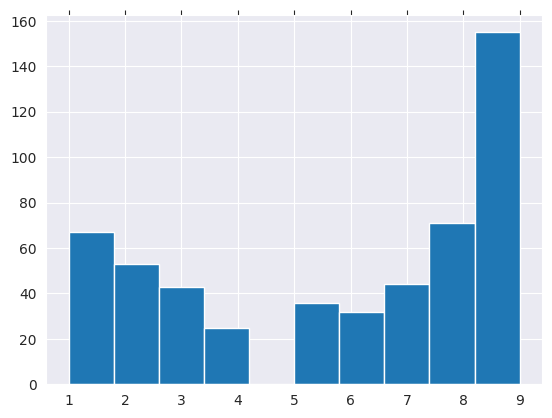

In [ ]:
df_extra['Empresa'].value_counts().sort_index().hist()

In [ ]:
len(df_extra.Empresa.unique())

526

In [ ]:
df_extra.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3045 entries, 0 to 3044
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 3045 non-null   object 
 1   Empresa                 3045 non-null   object 
 2   Industria               3045 non-null   object 
 3   Pais                    3045 non-null   object 
 4   Ingresos                3045 non-null   float64
 5   Ganancias               3045 non-null   float64
 6   Activos                 3045 non-null   float64
 7   Valor de Mercado        3045 non-null   float64
 8   Margen de Rentabilidad  3045 non-null   float64
 9   ROA                     3045 non-null   float64
 10  Año                     3045 non-null   int64  
 11  Codigo                  3045 non-null   object 
 12  Continente              3045 non-null   object 
 13  Empleados               3045 non-null   int64  
dtypes: float64(6), int64(2), object(6)
memor

In [ ]:
df_extra.to_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/df_extra.csv')

<Axes: >

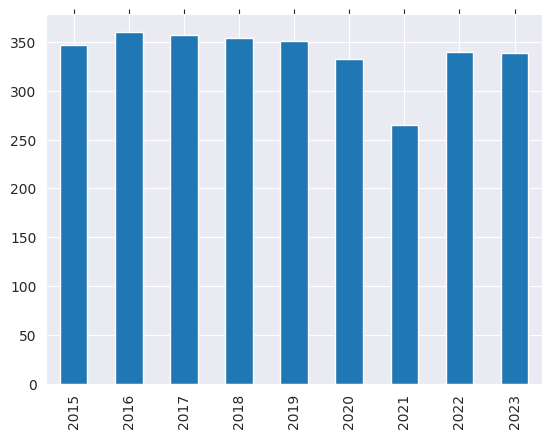

In [ ]:
df_extra['Año'].value_counts().sort_index().plot(kind='bar')

In [ ]:
df_extra.to_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/df_extra.csv')

---
# 5. Data query
---



## 5.1 Questionnaire A

**The following questions refer to the Forbes 2000 ranking for the year 2023:**

In [ ]:
df_part_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2000 entries, 0 to 1999
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 2000 non-null   int64  
 1   Empresa                 2000 non-null   object 
 2   Industria               2000 non-null   object 
 3   Pais                    2000 non-null   object 
 4   Ingresos                2000 non-null   float64
 5   Ganancias               2000 non-null   float64
 6   Activos                 2000 non-null   int64  
 7   Valor de Mercado        2000 non-null   int64  
 8   Margen de Rentabilidad  2000 non-null   float64
 9   ROA                     2000 non-null   float64
 10  Año                     2000 non-null   int64  
 11  Codigo                  2000 non-null   object 
 12  Continente              2000 non-null   object 
dtypes: float64(4), int64(4), object(5)
memory usage: 218.8+ KB


In [ ]:
df_part_1.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,1,JPMorgan Chase,Banking,United States,179933.0,41795.0,3744305,399594,23.23,1.12,2023,USA,North America
1,2,Saudi Arabian Oil Company (Saudi Aramco),Oil & Gas Operations,Saudi Arabia,589467.0,156357.0,660990,2055222,26.53,23.65,2023,SAU,Asia
2,3,ICBC,Banking,China,216767.0,52470.8,6116824,203012,24.21,0.86,2023,CHN,Asia
3,4,China Construction Bank,Banking,China,203083.0,48252.5,4977476,172992,23.76,0.97,2023,CHN,Asia
4,5,Agricultural Bank of China,Banking,China,186144.0,37924.7,5356862,141822,20.37,0.71,2023,CHN,Asia


### 5.1.1 ¿What are the Top 10 countries with the most companies in Forbes for the period indicated??

In [ ]:
top_countries=df_part_1.groupby('Pais').agg(number_companies=('Pais', 'count')).sort_values(by=['number_companies'],ascending=False).head(10).reset_index()
top_countries

,Pais,number_companies
0,United States,610
1,China,302
2,Japan,192
3,United Kingdom,67
4,South Korea,59
5,Canada,57
6,India,55
7,Germany,53
8,France,52
9,Taiwan,45


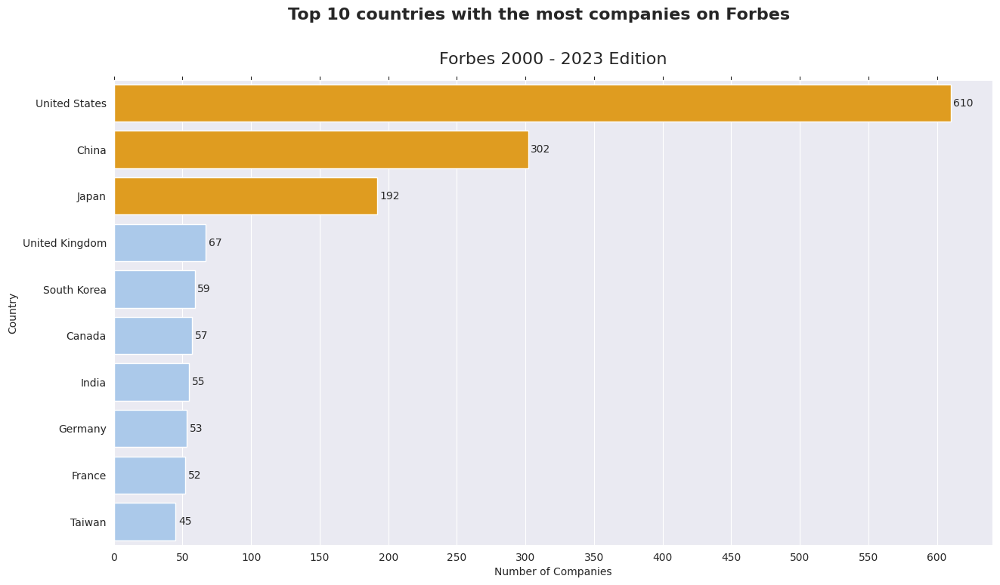

In [ ]:
# Create a custom color list
top_3 = top_countries[:3]
colors = ['orange' if country in top_3.index else '#a1c9f4' for country in top_countries.index]

# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(15, 8))
sns.set_style('darkgrid')
sns.barplot(y='Pais', x='number_companies', data=top_countries, palette=colors, ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(top_countries['number_companies']):
    ax.text(value+2, i, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('Number of Companies')
ax.set_ylabel('Country')
ax.set_title('Forbes 2000 - 2023 Edition', fontsize=16, pad=15)
fig.suptitle('Top 10 countries with the most companies on Forbes', y=1, fontsize=16,weight='bold')

# Set the x-axis ticks to increase the number of vertical lines
ax.set_xticks(range(0, max(top_countries['number_companies']) + 1, 50))

# Show the plot
plt.show()

### 5.1.2 What is the Top 4 countries with the most technology and telecommunications companies?

In [ ]:
df_part_1.Industria.unique()

array(['Banking', 'Oil & Gas Operations', 'IT Software & Services',
       'Technology Hardware & Equipment', 'Consumer Durables',
       'Insurance', 'Telecommunications Services', 'Retailing',
       'Diversified Financials', 'Drugs & Biotechnology',
       'Semiconductors', 'Food, Drink & Tobacco', 'Media',
       'Trading Companies', 'Business Services & Supplies',
       'Capital Goods', 'Construction', 'Aerospace & Defense',
       'Materials', 'Transportation', 'Conglomerates', 'Utilities',
       'Chemicals', 'Health Care Equipment & Services', 'Food Markets',
       'Hotels, Restaurants & Leisure'], dtype=object)

In [ ]:
df_part_1[(df_part_1.Industria=='Technology Hardware & Equipment')|(df_part_1.Industria=='Telecommunications Services')|(df_part_1.Industria=='IT Software & Services')]

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
6,7,Alphabet,IT Software & Services,United States,282845.0,58587.0,369491,1340528,20.71,15.86,2023,USA,North America
8,9,Microsoft,IT Software & Services,United States,207591.0,69020.0,380088,2309835,33.25,18.16,2023,USA,North America
9,10,Apple,Technology Hardware & Equipment,United States,385095.0,94321.0,332160,2746207,24.49,28.40,2023,USA,North America
13,14,Samsung Electronics,Technology Hardware & Equipment,South Korea,220069.0,34492.5,348805,334306,15.67,9.89,2023,KOR,Asia
21,21,Verizon Communications,Telecommunications Services,United States,136193.0,21585.0,377716,159037,15.85,5.71,2023,USA,North America
24,25,China Mobile,Telecommunications Services,Hong Kong,140529.0,18764.4,290003,186411,13.35,6.47,2023,HKG,Asia
30,31,Meta Platforms,IT Software & Services,United States,117346.0,21443.0,184491,599818,18.27,11.62,2023,USA,North America
34,35,Tencent Holdings,IT Software & Services,China,82414.0,27255.1,227014,415355,33.07,12.01,2023,CHN,Asia
40,41,Deutsche Telekom,Telecommunications Services,Germany,120715.0,8407.8,342619,117181,6.97,2.45,2023,DEU,Europe
55,56,Nippon Telegraph & Tel,Telecommunications Services,Japan,97362.0,8996.3,190656,106806,9.24,4.72,2023,JPN,Asia


In [ ]:
top_countries_tech_telcom=df_part_1[(df_part_1.Industria=='Technology Hardware & Equipment')|(df_part_1.Industria=='Telecommunications Services')|(df_part_1.Industria=='IT Software & Services')].groupby('Pais').agg(number_companies=('Pais', 'count')).sort_values(by=['number_companies'],ascending=False).head(10).reset_index()
top_countries_tech_telcom

,Pais,number_companies
0,United States,62
1,China,22
2,Japan,16
3,Taiwan,9
4,South Korea,8
5,India,6
6,Canada,6
7,France,5
8,Sweden,4
9,Hong Kong,3


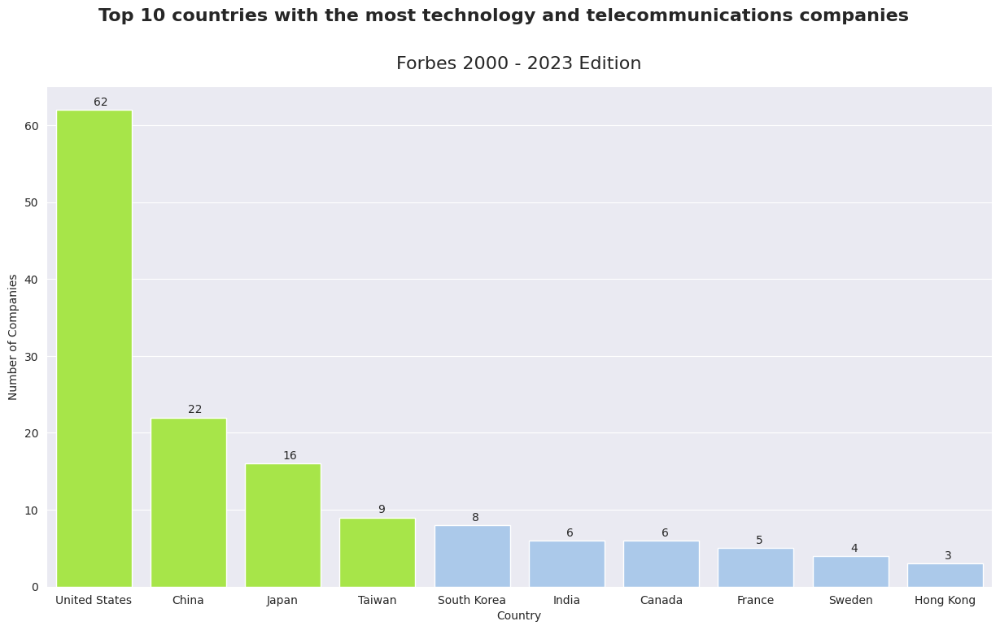

In [ ]:
# Create a custom color list
top_4 = top_countries_tech_telcom[:4]
colors = ['greenyellow' if country in top_4.index else '#a1c9f4' for country in top_countries_tech_telcom.index]

# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(15, 8))
sns.set_style('darkgrid')
sns.barplot(x= 'Pais', y='number_companies', data=top_countries_tech_telcom, palette=colors, ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(top_countries_tech_telcom['number_companies']):
    ax.text(i, value+1, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('Country')
ax.set_ylabel('Number of Companies')
ax.set_title('Forbes 2000 - 2023 Edition', fontsize=16, pad=15)
fig.suptitle('Top 10 countries with the most technology and telecommunications companies', y=1, fontsize=16,weight='bold')

plt.show()

### 5.1.3 What was the loss margin of the 5 most loss making companies considering the total losses recorded in the Hotels, Restaurants and Entertainment Industry?

In [ ]:
condition_1= df_part_1['Industria']=='Hotels, Restaurants & Leisure'
condition_2=df_part_1['Margen de Rentabilidad']<0
df_part_1.loc[(condition_1) & (condition_2)].sort_values(by=['Margen de Rentabilidad'])

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
1769,1769,Galaxy Entertainment,"Hotels, Restaurants & Leisure",Hong Kong,1073.0,-438.5,10373,29974,-40.87,-4.23,2023,HKG,Asia
960,961,Carnival Corporation,"Hotels, Restaurants & Leisure",United States,14977.0,-4895.0,51985,12622,-32.68,-9.42,2023,USA,North America
1292,1293,Las Vegas Sands,"Hotels, Restaurants & Leisure",United States,5287.0,-542.0,22715,47117,-10.25,-2.39,2023,USA,North America
1052,1053,Royal Caribbean Group,"Hotels, Restaurants & Leisure",United States,10666.0,-1036.7,32870,19336,-9.72,-3.15,2023,USA,North America
1077,1078,Flutter Entertainment,"Hotels, Restaurants & Leisure",Ireland,9476.0,-372.0,24638,34438,-3.93,-1.51,2023,IRL,Europe
1279,1280,Caesars Entertainment,"Hotels, Restaurants & Leisure",United States,11359.0,-355.0,33349,9615,-3.13,-1.06,2023,USA,North America


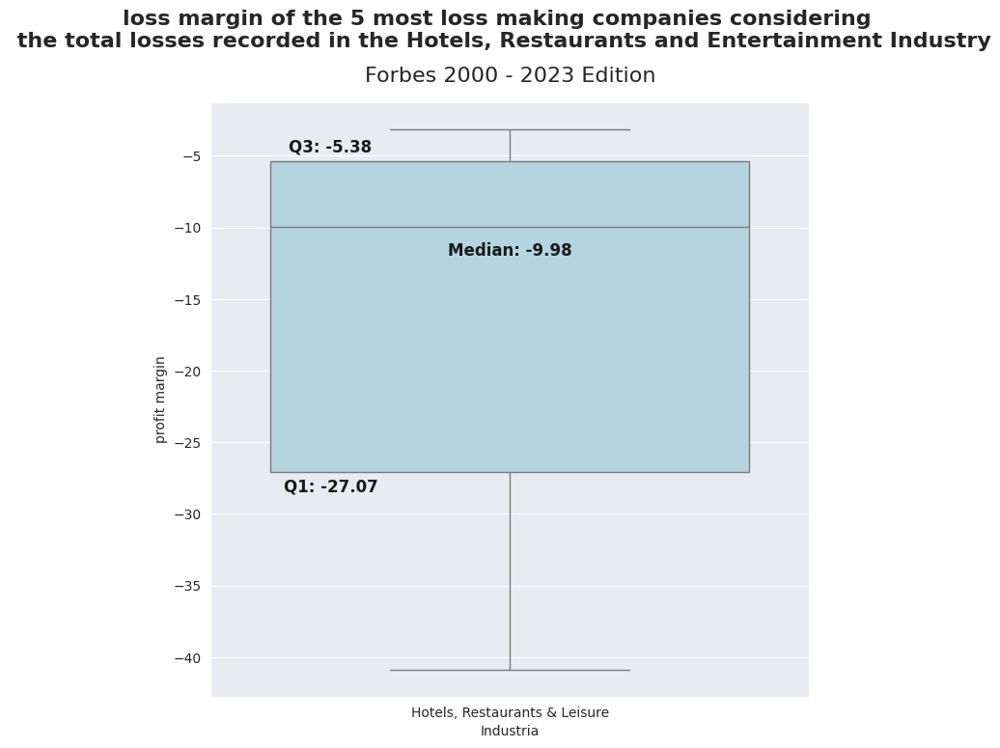

In [ ]:
fig, ax = plt.subplots(figsize=(8, 8))

sns.set(style="darkgrid")

# Create a boxplot
ax = sns.boxplot(x='Industria', y='Margen de Rentabilidad', data=df_part_1.loc[(condition_1) & (condition_2)],color='lightblue')

# Calculate median and quartiles
median = df_part_1.loc[(condition_1) & (condition_2)]['Margen de Rentabilidad'].median()
q1 = df_part_1.loc[(condition_1) & (condition_2)]['Margen de Rentabilidad'].quantile(0.25)
q3 = df_part_1.loc[(condition_1) & (condition_2)]['Margen de Rentabilidad'].quantile(0.75)

# Add annotations
ax.text(0, median-1, f'Median: {median:.2f}', horizontalalignment='center', verticalalignment='top', color='k', weight='semibold')
ax.text(-0.3, q1-1, f'Q1: {q1:.2f}', horizontalalignment='center', verticalalignment='center', color='k', weight='semibold')
ax.text(-0.3, q3+1, f'Q3: {q3:.2f}', horizontalalignment='center', verticalalignment='center', color='k', weight='semibold')


# Add labels and title

ax.set_title('Forbes 2000 - 2023 Edition', fontsize=16, pad=15)
fig.suptitle('loss margin of the 5 most loss making companies considering \n the total losses recorded in the Hotels, Restaurants and Entertainment Industry', y=1, fontsize=16,weight='bold')
#ax.set_xlabel('Number of Companies')
ax.set_ylabel('profit margin')

plt.show()

### 5.1.4 Considering the Oil Industry in Asia, which company or companies exceeded their profitability margin by more than 20%?

In [ ]:
condition_1= df_part_1['Industria']=='Oil & Gas Operations'
condition_2=df_part_1['Continente']=='Asia'
condition_3=df_part_1['Margen de Rentabilidad']>0
query_0 = df_part_1.loc[(condition_1) & (condition_2)&(condition_3)][['Empresa','Margen de Rentabilidad']].sort_values(by=['Margen de Rentabilidad'],ascending=False).reset_index(drop=True)
query_0

,Empresa,Margen de Rentabilidad
0,CNOOC,35.70
1,ADNOC Drilling,30.00
2,Saudi Arabian Oil Company (Saudi Aramco),26.53
3,Inpex,18.85
4,Guanghui Energy Co. Ltd.,17.57
5,Towngas,8.61
6,Tokyo Gas,8.54
7,Beijing Enterprises,8.20
8,Reliance Industries,7.58
9,China Gas Holdings,7.39


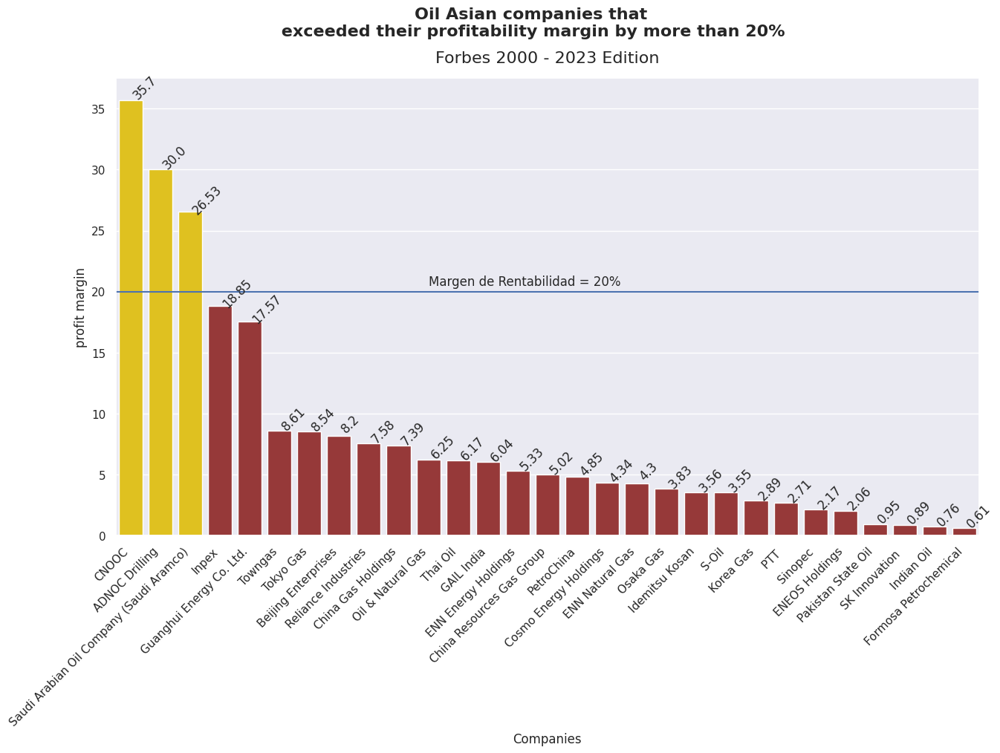

In [ ]:
# Create a custom color list
top_3 = query_0[:3]
colors = ['gold' if country in top_3.index else 'brown' for country in query_0.index]

# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(15, 8))
sns.set_style('darkgrid')
sns.barplot(x= 'Empresa', y='Margen de Rentabilidad', data=query_0, palette=colors, ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')

plt.axhline(y=20)

# Add number labels at the end of each bar
for i, value in enumerate(query_0['Margen de Rentabilidad']):
    ax.text(i, value+1, f'{value}', va='center',rotation=45)

ax.text(10,20.5,'Margen de Rentabilidad = 20%')
# Add labels and title
ax.set_xlabel('Companies')
ax.set_ylabel('profit margin')
ax.set_title('Forbes 2000 - 2023 Edition', fontsize=16, pad=15)
fig.suptitle('Oil Asian companies that \n exceeded their profitability margin by more than 20% ', y=1, fontsize=16,weight='bold')

plt.show()

### 5.1.5 Which US companies had the highest percentage of profitability by industry?

In [ ]:
# Define the condition for 'Codigo'=='USA'
condition_1 = df_part_1['Codigo'] == 'USA'

# Apply the condition and find the indices of the maximum 'Margen de Rentabilidad' within each group
idx = df_part_1[condition_1].groupby('Industria')['Margen de Rentabilidad'].idxmax()

# Use the indices to extract the corresponding rows
df_helper = df_part_1.loc[idx].reset_index(drop=True)

# Display the result
df_helper

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,1898,Heico,Aerospace & Defense,United States,2339.0,357.8,4805,23284,15.30,7.45,2023,USA,North America
1,925,New York Community Bancorp,Banking,United States,3026.0,2495.0,123754,6870,82.45,2.02,2023,USA,North America
2,122,Visa,Business Services & Supplies,United States,30983.0,15485.0,86755,477381,49.98,17.85,2023,USA,North America
3,447,Lam Research,Capital Goods,United States,18839.0,4917.3,19243,71168,26.10,25.55,2023,USA,North America
4,443,DuPont De Nemours,Chemicals,United States,12761.0,5567.0,41208,30070,43.63,13.51,2023,USA,North America
5,242,3M,Conglomerates,United States,33431.0,5454.0,46886,57015,16.31,11.63,2023,USA,North America
6,943,NVR,Construction,United States,10137.0,1643.8,6076,19017,16.22,27.05,2023,USA,North America
7,1501,Snap-on,Consumer Durables,United States,4933.0,943.0,7126,13805,19.12,13.23,2023,USA,North America
8,782,Public Storage,Diversified Financials,United States,4308.0,4352.9,17508,52025,101.04,24.86,2023,USA,North America
9,1951,United Therapeutics,Drugs & Biotechnology,United States,1981.0,728.3,6346,10031,36.76,11.48,2023,USA,North America


Text(0.5, 1, 'US companies with the highest percentage of profitability by industry')

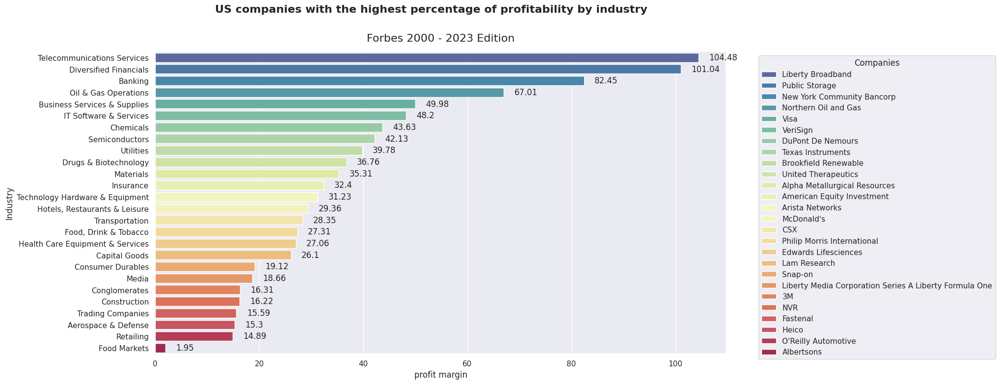

In [ ]:
# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(15, 8))
sns.set_style('darkgrid')
sns.barplot(y='Industria', x='Margen de Rentabilidad', data=df_helper.sort_values(by=['Margen de Rentabilidad'],ascending=False),hue='Empresa',palette="Spectral_r",ax=ax)
# Move the legend outside the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Companies')
for i, value in enumerate(df_helper.sort_values(by=['Margen de Rentabilidad'],ascending=False)['Margen de Rentabilidad']):
    ax.text(value+2, i, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('profit margin')
ax.set_ylabel('Industry')
ax.set_title('Forbes 2000 - 2023 Edition', fontsize=16, pad=15)
fig.suptitle('US companies with the highest percentage of profitability by industry', y=1, fontsize=16,weight='bold')

### 5.1.6 Excluding the Banking industry, which European companies recorded the largest losses by industry globally?

In [ ]:
condition_1 = df_part_1['Continente']=='Europe'
condition_2 = df_part_1['Industria']!='Banking'

idx=df_part_1[(condition_1)&((condition_2))].groupby(by=['Industria'])['Ganancias'].idxmin()

df_helper = df_part_1.loc[idx].reset_index(drop=True)

df_helper

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,654,Safran,Aerospace & Defense,France,20518.0,-2584.3,49977,64348,-12.60,-5.17,2023,FRA,Europe
1,1700,TUI,Business Services & Supplies,Germany,18876.0,-149.8,15554,3399,-0.79,-0.96,2023,DEU,Europe
2,1000,Vestas Wind Systems,Capital Goods,Denmark,15224.0,-1652.2,21441,28150,-10.85,-7.71,2023,DNK,Europe
3,1541,Covestro,Chemicals,Germany,17708.0,-742.5,15850,8390,-4.19,-4.68,2023,DEU,Europe
4,97,Siemens,Conglomerates,Germany,77298.0,3737.3,153608,130646,4.83,2.43,2023,DEU,Europe
5,1044,Vonovia,Construction,Germany,6881.0,-2719.6,106189,16354,-39.52,-2.56,2023,DEU,Europe
6,1203,Faurecia,Consumer Durables,France,26756.0,-401.3,34385,3823,-1.50,-1.17,2023,FRA,Europe
7,1858,Segro,Diversified Financials,United Kingdom,824.0,-2373.6,20868,12776,-288.06,-11.37,2023,GBR,Europe
8,1928,arGEN-X,Drugs & Biotechnology,Netherlands,419.0,-703.3,3134,22337,-167.85,-22.44,2023,NLD,Europe
9,1587,Metro Group,Food Markets,Germany,31798.0,-7.4,14173,3064,-0.02,-0.05,2023,DEU,Europe


Text(0.5, 1, 'European companies recorded the largest losses by industry globally \n (Excluding the Banking industry)')

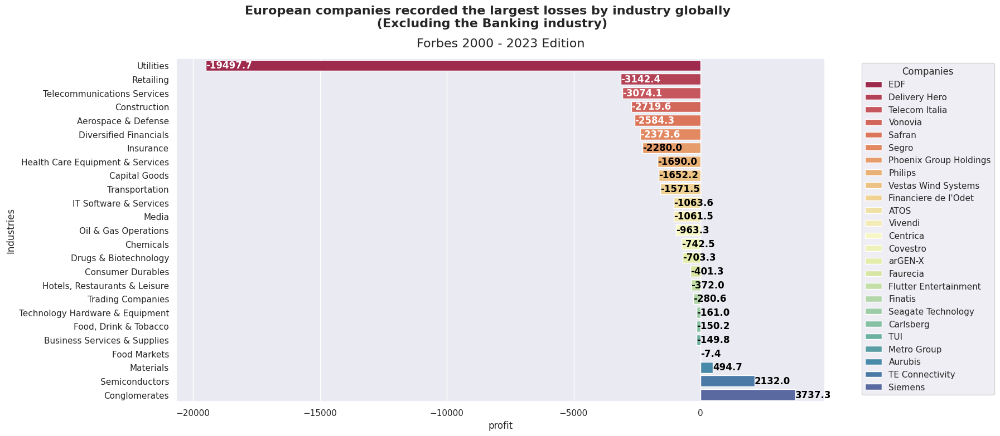

In [ ]:
# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(15, 8))
sns.set_style("darkgrid")
sns.barplot(y='Industria', x='Ganancias', data=df_helper.sort_values(by=['Ganancias'],ascending=True),palette="Spectral",hue='Empresa' ,ax=ax)
for i, value in enumerate(df_helper.sort_values(by=['Ganancias'],ascending=True)['Ganancias']):
    if i<=5:
      ax.text(value+2, i, f'{value}', va='center', color='white',weight='bold')
    else:
      ax.text(value+2, i, f'{value}', va='center', color='black',weight='bold')
# Move the legend outside the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Companies')

# Add labels and title
ax.set_xlabel('profit')
ax.set_ylabel('Industries')
ax.set_title('Forbes 2000 - 2023 Edition', fontsize=16, pad=15)
fig.suptitle('European companies recorded the largest losses by industry globally \n (Excluding the Banking industry)', y=1, fontsize=16,weight='bold')

### 5.1.7 What was the distribution of Income and Assets with respect to profits for banks whose assets do not exceed USD 30 billion?

In [ ]:
condition_1 = df_part_1['Industria']=='Banking'
condition_2 = df_part_1['Activos']< 30000

df_part_1[(condition_1)&((condition_2))].groupby(by=['Industria'])[['Margen de Rentabilidad','ROA']].describe()

Margen de Rentabilidad                                               \
                           count    mean        std   min    25%    50%   75%   
Industria                                                                       
Banking                      5.0  27.926  12.859171  6.86  24.81  33.38  36.1   

                   ROA                                              
             max count  mean      std   min   25%   50%  75%   max  
Industria                                                           
Banking    38.48   5.0  2.33  0.75591  1.35  2.06  2.08  2.9  3.26

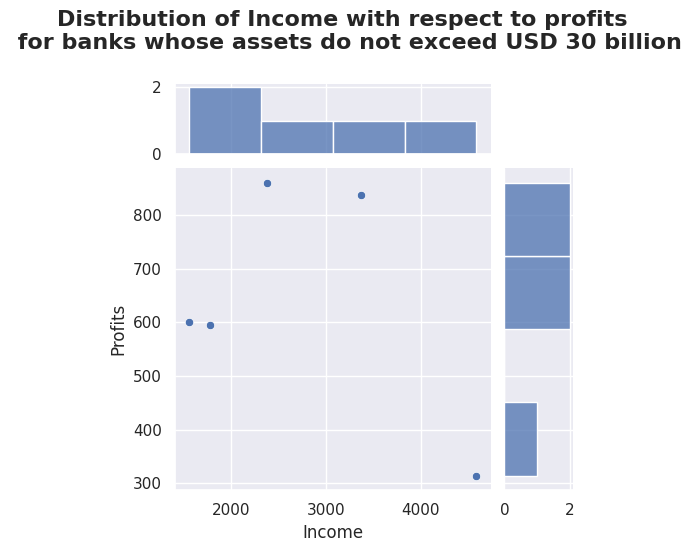

In [ ]:
fig=sns.jointplot(data=df_part_1[(condition_1) & (condition_2)], x='Ingresos', y='Ganancias',height=5, ratio=4, marginal_ticks=True)
sns.set(style="darkgrid")
plt.suptitle('Distribution of Income with respect to profits \n for banks whose assets do not exceed USD 30 billion', y = 1.1, fontsize=16,weight='bold')
fig.set_axis_labels('Income', 'Profits')


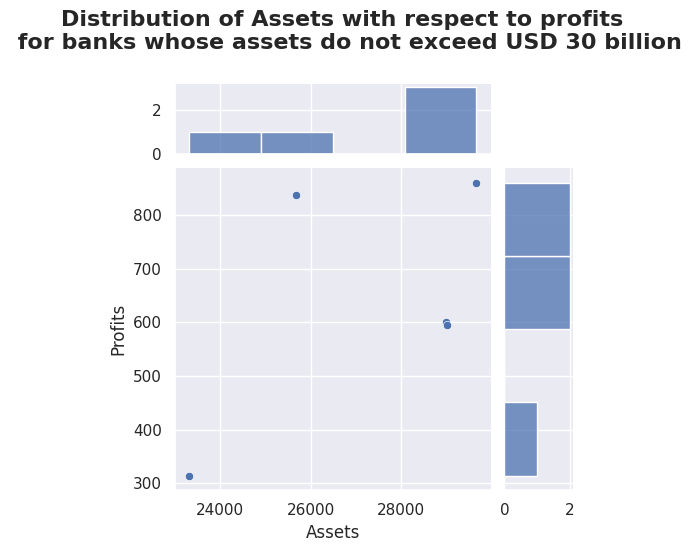

In [ ]:
fig=sns.jointplot(data=df_part_1[(condition_1) & (condition_2)], x='Activos', y='Ganancias',height=5, ratio=4, marginal_ticks=True)
sns.set(style="darkgrid")
plt.suptitle('Distribution of Assets with respect to profits \n for banks whose assets do not exceed USD 30 billion', y = 1.1, fontsize=16,weight='bold')
fig.set_axis_labels('Assets', 'Profits')

### 5.1.8 Considering the historical stock values in the year 2023 of the 5 companies of your choice (Step 2), indicate which was the best week to buy and which was the best week to sell respectively.

In [ ]:
df_walmart_copy=df_walmart.copy()
df_amazon_copy=df_amazon.copy()
df_the_home_depot_copy=df_the_home_depot.copy()
df_costco_copy=df_costco.copy()
df_lowes_copy=df_lowes.copy()

In [ ]:
retail_companies=[df_walmart_copy,
df_amazon_copy,
df_the_home_depot_copy,
df_costco_copy,
df_lowes_copy]

In [ ]:
for df in retail_companies:
  df['date']=pd.to_datetime(df['date'])
  df['weeks']=df['date'].dt.isocalendar().week
  df.set_index('date',inplace=True)

In [ ]:
df_walmart_copy.head()

,simbolo,precio_apertura,precio_cierre,precio_max,precio_min,weeks
date,,,,,,
2024-02-21,walmart,175.00,173.70,175.580,172.80,8
2024-02-20,walmart,178.48,175.86,181.350,175.23,8
2024-02-16,walmart,170.29,170.36,171.930,169.29,7
2024-02-15,walmart,169.80,169.29,169.850,167.97,7
2024-02-14,walmart,168.75,168.60,168.875,167.54,7


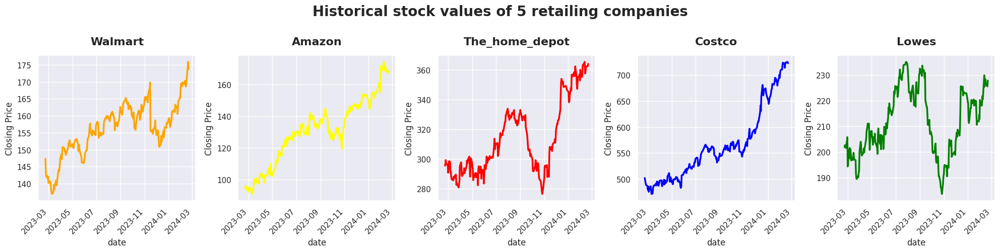

In [ ]:
# Create a figure and axis for the subplots
fig, axs = plt.subplots(1, 5, figsize=(20, 5), sharex=True)

# Assuming df_source1, df_source2, df_source3, and df_source4 have the same structure
titles = ['Walmart',
'Amazon',
'The_home_depot',
'Costco',
'Lowes']

colors=['orange','yellow','red','blue','green']

fig.suptitle('Historical stock values of 5 retailing companies', y=1, fontsize=20,weight='bold')

# Plot each data source on a separate subplot
for i, (company, title,color) in enumerate(zip(retail_companies, titles,colors)):
    sns.lineplot(data=company.precio_cierre, color=colors[i],linewidth=2.5, ax=axs[i])
    axs[i].set_title(title,fontsize=16,weight='bold', pad=15)
    axs[i].set_xticklabels(axs[i].get_xticklabels(), rotation=45, horizontalalignment='right')
    axs[i].set_ylabel('Closing Price')
plt.tight_layout()
plt.show()

In [ ]:
def comprar_vender_semana(df,opcion):

  if opcion == 'buy':
    condition=df['precio_cierre'].min()
    week=df[df['precio_cierre']==condition]['weeks'][0]

  else:
    condition=df['precio_cierre'].max()
    week=df[df['precio_cierre']==condition]['weeks'][0]

  company_name= df.simbolo.unique()[0]

  return company_name, week

In [ ]:
option_list=['buy','sell']

for company in retail_companies:
  for option in option_list:
    result = comprar_vender_semana(company,option)

    print('The best week to', option, result[0],
        ' was week # ', result[1], ' \n')

The best week to buy walmart  was week #  10  

The best week to sell walmart  was week #  8  

The best week to buy amazon  was week #  10  

The best week to sell amazon  was week #  6  

The best week to buy the_home_depot  was week #  43  

The best week to sell the_home_depot  was week #  7  

The best week to buy costco  was week #  10  

The best week to sell costco  was week #  8  

The best week to buy lowes  was week #  43  

The best week to sell lowes  was week #  30  



## 5.2 Questionnaire B

**The next questions refers to the Forbes 2000 ranking from 2015 to 2023**


In [ ]:
df_part_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17996 entries, 0 to 17995
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Rank_nr                 17996 non-null  object 
 1   Empresa                 17996 non-null  object 
 2   Industria               17996 non-null  object 
 3   Pais                    17996 non-null  object 
 4   Ingresos                17996 non-null  float64
 5   Ganancias               17996 non-null  float64
 6   Activos                 17996 non-null  float64
 7   Valor de Mercado        17996 non-null  float64
 8   Margen de Rentabilidad  17996 non-null  float64
 9   ROA                     17996 non-null  float64
 10  Año                     17996 non-null  int64  
 11  Codigo                  17996 non-null  object 
 12  Continente              17996 non-null  object 
dtypes: float64(6), int64(1), object(6)
memory usage: 1.8+ MB


### 5.2.1 What is the Top 10 countries with the most companies in Forbes for the period indicated?

In [ ]:
query_1 = df_part_2.groupby(by=['Pais'])['Empresa'].nunique().sort_values(ascending=False).to_frame().head(10)

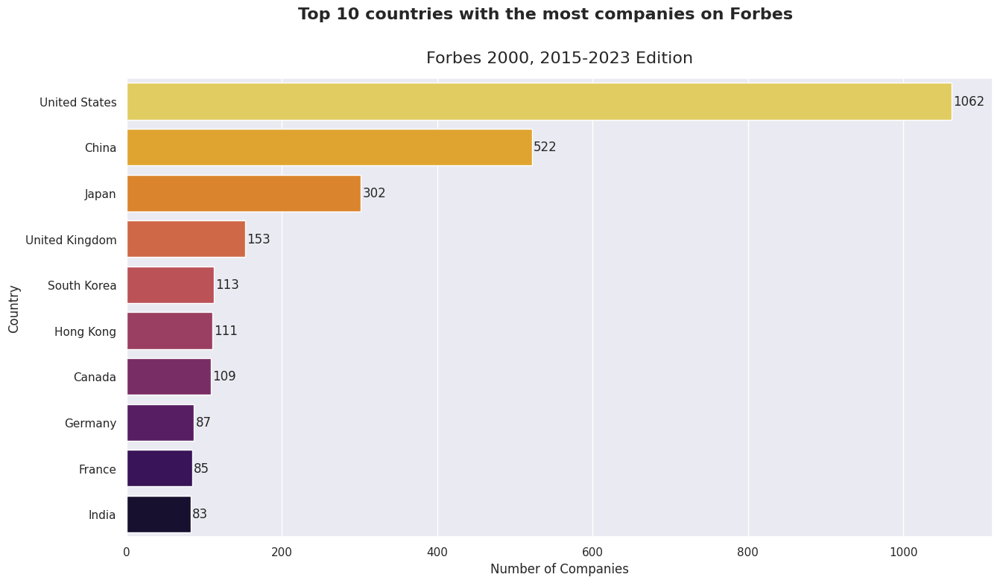

In [ ]:
# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(15, 8))
sns.set_style('darkgrid')
sns.barplot(y=query_1.index,x='Empresa', data=query_1, palette='inferno_r', ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(query_1['Empresa']):
    ax.text(value+2, i, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('Number of Companies')
ax.set_ylabel('Country')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle('Top 10 countries with the most companies on Forbes', y=1, fontsize=16,weight='bold')


# Show the plot
plt.show()

### 5.2.2 What is the Top 5 countries with the most technology and telecommunications companies?

In [ ]:
df_part_2[(df_part_2.Industria=='Technology Hardware & Equipment')|(df_part_2.Industria=='Telecommunications Services')|(df_part_2.Industria=='IT Software & Services')].head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
11,12,Apple,Technology Hardware & Equipment,United States,199378.0,44462.0,261894.0,741782.0,22.30,16.98,2015,USA,North America
19,20,China Mobile,Telecommunications Services,China,104086.0,17724.0,208970.0,271486.0,17.03,8.48,2015,CHN,Asia
21,22,Verizon Communications,Telecommunications Services,United States,127079.0,9625.0,232708.0,202490.0,7.57,4.14,2015,USA,North America
24,25,Microsoft,IT Software & Services,United States,93268.0,20675.0,174848.0,340826.0,22.17,11.82,2015,USA,North America
26,27,AT&T,Telecommunications Services,United States,132447.0,6224.0,292829.0,172988.0,4.70,2.13,2015,USA,North America


In [ ]:
top_countries_tech_telcom=df_part_2[(df_part_2.Industria=='Technology Hardware & Equipment')|(df_part_2.Industria=='Telecommunications Services')|(df_part_2.Industria=='IT Software & Services')].groupby('Pais').agg(number_companies=('Pais', 'count')).sort_values(by=['number_companies'],ascending=False).head(10).reset_index()
top_countries_tech_telcom

,Pais,number_companies
0,United States,477
1,China,162
2,Japan,97
3,Taiwan,89
4,South Korea,64
5,India,61
6,France,52
7,Canada,47
8,United Kingdom,26
9,Netherlands,25


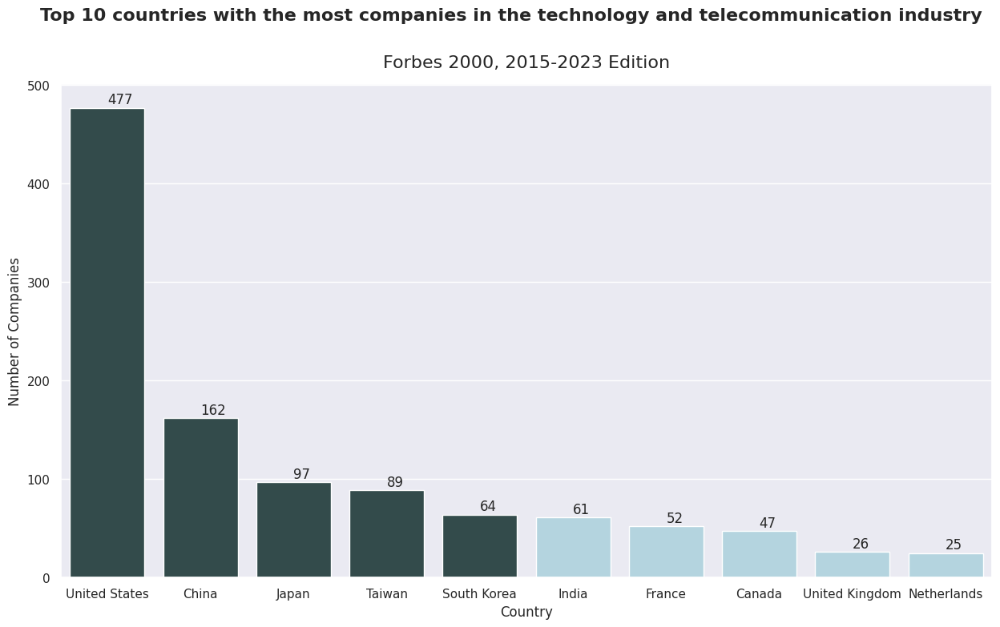

In [ ]:
# Create a custom color list
top_5 = top_countries_tech_telcom[:5]
colors = ['darkslategrey' if country in top_5.index else 'lightblue' for country in top_countries_tech_telcom.index]

# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(15, 8))
sns.set_style('darkgrid')
sns.barplot(x= 'Pais', y='number_companies', data=top_countries_tech_telcom, palette=colors, ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(top_countries_tech_telcom['number_companies']):
    ax.text(i, value+8, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('Country')
ax.set_ylabel('Number of Companies')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle('Top 10 countries with the most companies in the technology and telecommunication industry', y=1, fontsize=16,weight='bold')

plt.show()

### 5.2.3 What was the loss margin of the 10 most loss making companies considering the total losses recorded in the Hotels, Restaurants and Entertainment Industry?

In [ ]:
condition_1= df_part_2['Industria']=='Hotels, Restaurants & Leisure'
condition_2=df_part_2['Margen de Rentabilidad']<0
query_2= df_part_2.loc[(condition_1) & (condition_2)].sort_values(by=['Margen de Rentabilidad']).head(10)
query_2

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
13111,1114,Carnival,"Hotels, Restaurants & Leisure",United States,831.0,-11427.0,57226.0,30595.0,-1375.09,-19.97,2021,USA,North America
15372,1376,Royal Caribbean Group,"Hotels, Restaurants & Leisure",United States,1532.0,-5260.5,32258.0,20821.0,-343.37,-16.31,2022,USA,North America
15215,1220,Carnival Corporation,"Hotels, Restaurants & Leisure",United States,3506.0,-9419.0,53281.0,21455.0,-268.65,-17.68,2022,USA,North America
13395,1398,Royal Caribbean Group,"Hotels, Restaurants & Leisure",United States,2209.0,-5797.5,32465.0,21737.0,-262.45,-17.86,2021,USA,North America
13388,1391,Caesars Entertainment,"Hotels, Restaurants & Leisure",United States,3474.0,-1756.6,36385.0,19503.0,-50.56,-4.83,2021,USA,North America
13765,1769,Galaxy Entertainment,"Hotels, Restaurants & Leisure",Hong Kong,1082.0,-512.3,11959.0,38644.0,-47.35,-4.28,2021,HKG,Asia
13332,1335,Las Vegas Sands,"Hotels, Restaurants & Leisure",United States,3612.0,-1685.0,20807.0,46596.0,-46.65,-8.10,2021,USA,North America
17765,1769,Galaxy Entertainment,"Hotels, Restaurants & Leisure",Hong Kong,1073.0,-438.5,10373.0,29974.0,-40.87,-4.23,2023,HKG,Asia
16956,961,Carnival Corporation,"Hotels, Restaurants & Leisure",United States,14977.0,-4895.0,51985.0,12622.0,-32.68,-9.42,2023,USA,North America
1463,1464,Caesars Entertainment,"Hotels, Restaurants & Leisure",United States,8630.0,-2771.9,23535.0,1604.0,-32.12,-11.78,2015,USA,North America


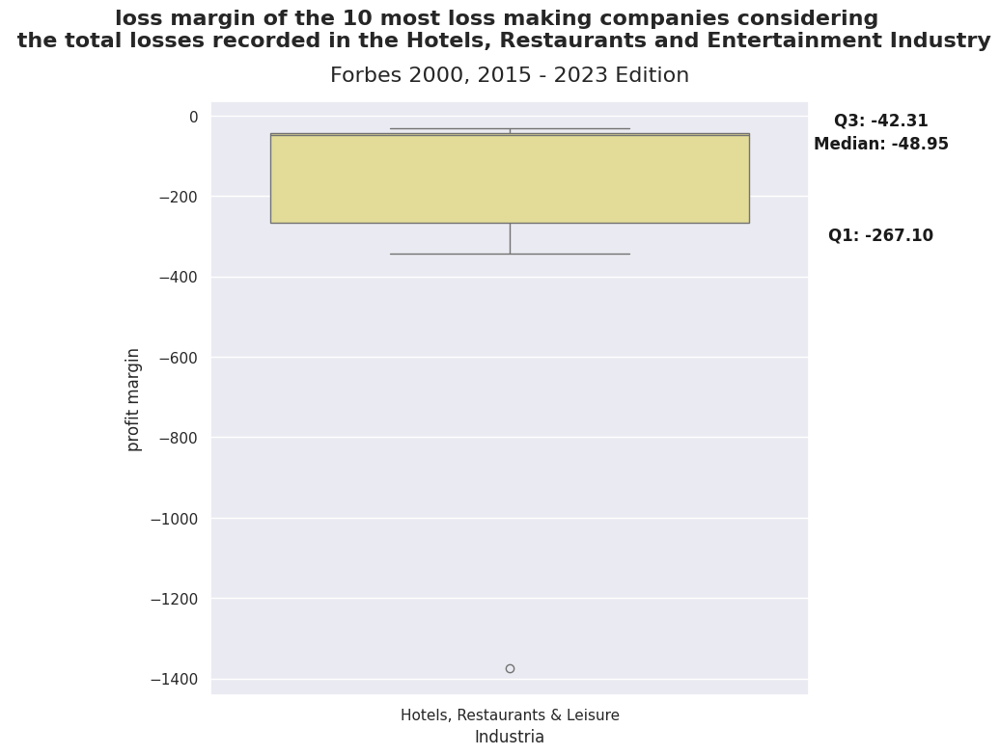

In [ ]:
fig, ax = plt.subplots(figsize=(8, 8))

sns.set(style="darkgrid")

# Create a boxplot
ax = sns.boxplot(x='Industria', y='Margen de Rentabilidad', data=query_2,color='khaki')

# Calculate median and quartiles
median = query_2['Margen de Rentabilidad'].median()
q1 = query_2['Margen de Rentabilidad'].quantile(0.25)
q3 = query_2['Margen de Rentabilidad'].quantile(0.75)

# Add annotations
ax.text(0.62, median, f'Median: {median:.2f}', horizontalalignment='center', verticalalignment='top', color='k', weight='semibold')
ax.text(0.62, q1-30, f'Q1: {q1:.2f}', horizontalalignment='center', verticalalignment='center', color='k', weight='semibold')
ax.text(0.62, q3+30, f'Q3: {q3:.2f}', horizontalalignment='center', verticalalignment='center', color='k', weight='semibold')


# Add labels and title

ax.set_title('Forbes 2000, 2015 - 2023 Edition', fontsize=16, pad=15)
fig.suptitle('loss margin of the 10 most loss making companies considering \n the total losses recorded in the Hotels, Restaurants and Entertainment Industry', y=1, fontsize=16,weight='bold')
ax.set_ylabel('profit margin')
plt.show()

### 5.2.4 Considering the Oil Industry in the Americas, which company or companies outperformed their return on assets by more than 20%?

In [ ]:
df_part_2['Continente'].unique()

array(['Asia', 'North America', 'Europe', 'South America', 'Oceania',
       'Africa'], dtype=object)

In [ ]:
condition_1= df_part_2['Industria']=='Oil & Gas Operations'
condition_2=df_part_2['Continente']=='North America'
condition_3=df_part_2['Continente']=='South America'
condition_4=df_part_2['ROA']>20
query_3=df_part_2.loc[(condition_1) & (condition_2 | condition_3)&(condition_4)].sort_values(by=['ROA']).sort_values(by=['Año','ROA'],ascending=False)
query_3

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
17571,1576,Seadrill,Oil & Gas Operations,Bermuda,1069.0,3623.2,2801.0,1853.0,338.93,129.35,2023,BMU,North America
17952,1957,Gulfport Energy,Oil & Gas Operations,United States,2203.0,1301.8,2527.0,1678.0,59.09,51.52,2023,USA,North America
17054,1058,Southwestern Energy,Oil & Gas Operations,United States,14177.0,6463.0,12937.0,5220.0,45.59,49.96,2023,USA,North America
17944,1949,Northern Oil and Gas,Oil & Gas Operations,United States,1970.0,1320.0,3343.0,2714.0,67.01,39.49,2023,USA,North America
16815,820,Chesapeake Energy,Oil & Gas Operations,United States,14123.0,4936.0,15726.0,10527.0,34.95,31.39,2023,USA,North America
17726,1731,Range Resources,Oil & Gas Operations,United States,5034.0,2070.3,6882.0,6105.0,41.13,30.08,2023,USA,North America
17705,1710,Pdc Energy,Oil & Gas Operations,United States,4238.0,2224.2,8259.0,5631.0,52.48,26.93,2023,USA,North America
17481,1486,ARC Resources,Oil & Gas Operations,Canada,6272.0,2226.9,8507.0,7859.0,35.51,26.18,2023,CAN,North America
17806,1811,Chord Energy,Oil & Gas Operations,United States,3890.0,1687.2,6615.0,5774.0,43.37,25.51,2023,USA,North America
16440,445,Devon Energy,Oil & Gas Operations,United States,20643.0,5958.0,23721.0,32935.0,28.86,25.12,2023,USA,North America


In [ ]:
years = query_3.Año.unique()
years

array([2023, 2022, 2020, 2018, 2017, 2015])

<Axes: ylabel='ROA'>

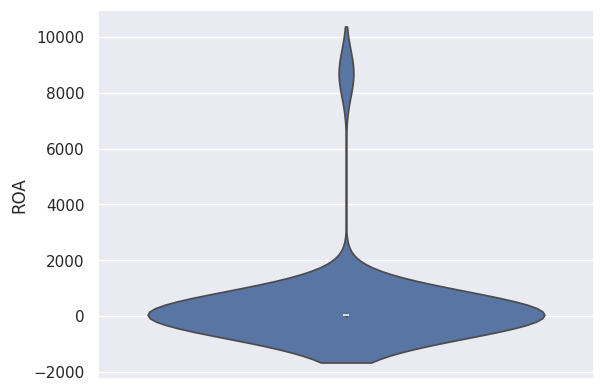

In [ ]:
sns.violinplot(y='ROA', data=query_3)

# There is an outlier

Text(0.5, 1, 'Companies outperformed their return on assets by more than 20% \n in the Oil Industry in the Americas')

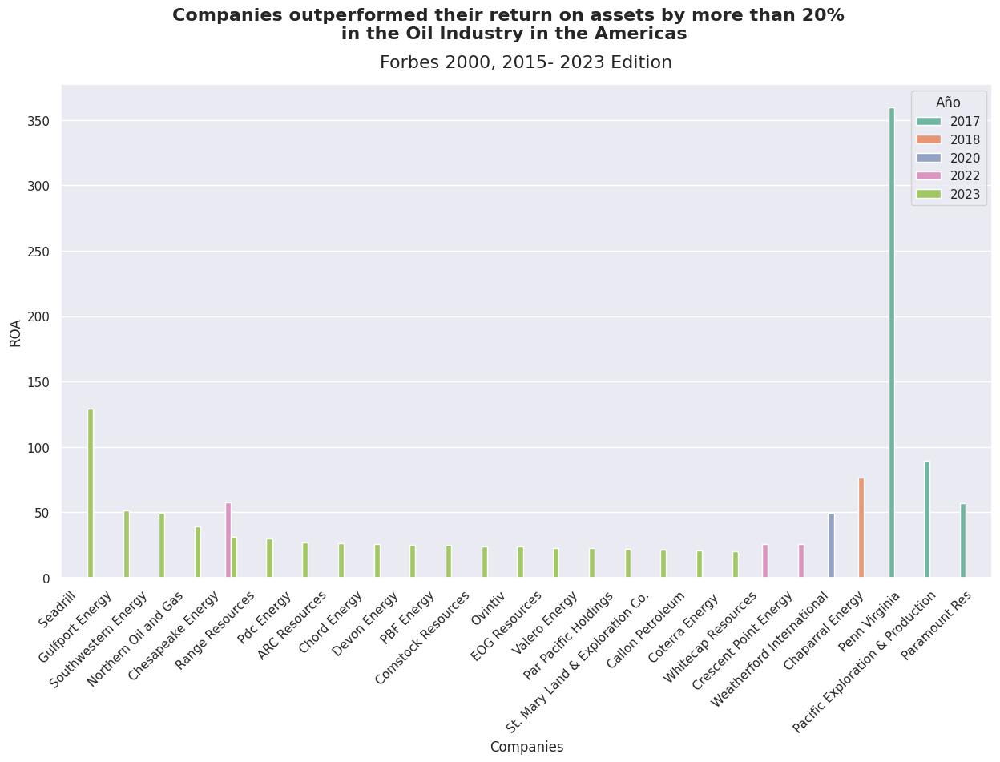

In [ ]:
fig, ax = plt.subplots(figsize=(15, 8))
sns.barplot(x='Empresa', y='ROA', data=query_3.loc[query_3.Año>2015], hue='Año',palette="Set2")

ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
ax.set_xlabel('Companies')
ax.set_ylabel('ROA')
ax.set_title('Forbes 2000, 2015- 2023 Edition', fontsize=16, pad=15)
fig.suptitle('Companies outperformed their return on assets by more than 20% \n in the Oil Industry in the Americas', y=1, fontsize=16,weight='bold')

### 5.2.5 Which European companies had the highest percentage of profitability by industry?

In [ ]:
condition_1 = df_part_2['Continente'] == 'Europe'

# Apply the condition and find the indices of the maximum 'Margen de Rentabilidad' within each group
idx = df_part_2[condition_1].groupby(['Industria'])['Margen de Rentabilidad'].idxmax()

# Use the indices to extract the corresponding rows
df_helper = df_part_2.loc[idx].reset_index(drop=True)

# Display the result
df_helper.sort_values(by='Año')




,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
12,1663,Rhoen-Klinikum,Health Care Equipment & Services,Germany,2003.0,1631.6,4328.0,1880.0,81.46,37.70,2015,DEU,Europe
17,1628,Seat-Pagine Gialle,Media,Italy,541.0,1829.4,913.0,303.0,338.15,200.37,2015,ITA,Europe
10,701,Magnit,Food Markets,Russia,19836.0,1241.7,6128.0,20386.0,6.26,20.26,2015,RUS,Europe
25,585,Fortum,Utilities,Finland,6301.0,4183.6,25865.0,17727.0,66.40,16.17,2015,FIN,Europe
20,1300,ARM Holdings,Semiconductors,United Kingdom,1532.0,521.4,3207.0,18979.0,34.03,16.26,2016,GBR,Europe
5,1896,Latour Investment,Conglomerates,Sweden,935.0,488.0,2524.0,6683.0,52.19,19.33,2016,SWE,Europe
18,242,Surgutneftegas,Oil & Gas Operations,Russia,19020.0,20164.6,61459.0,19665.0,106.02,32.81,2016,RUS,Europe
13,1287,InterContinental Hotels,"Hotels, Restaurants & Leisure",United Kingdom,1803.0,1220.5,3769.0,9524.0,67.69,32.38,2016,GBR,Europe
7,788,Porsche Automobil Holding,Consumer Durables,Germany,1.0,1519.9,29963.0,16129.0,151990.00,5.07,2017,DEU,Europe
9,149,Allergan,Drugs & Biotechnology,Ireland,14967.0,14973.4,128986.0,80068.0,100.04,11.61,2017,IRL,Europe


Text(0.5, 1, ' European companies with the highest percentage of profitability by industry')

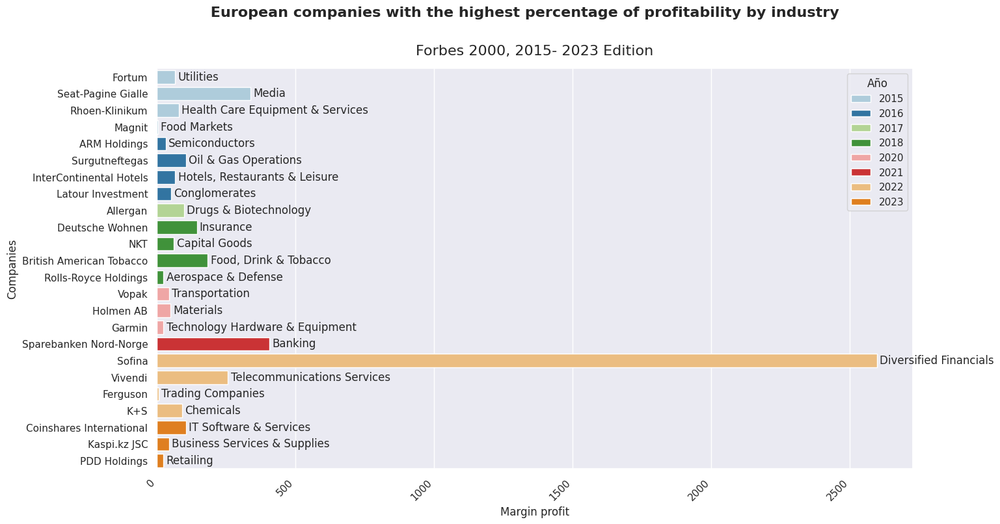

In [ ]:
# NO tuve en  cuenta estas dos empresas, porque eran outliers ('Porsche Automobil Holding','Aroundtown')
data=df_helper.loc[~df_helper.Empresa.isin(['Porsche Automobil Holding','Aroundtown'])].sort_values(by='Año')

fig, ax = plt.subplots(figsize=(15, 8))
sns.barplot(y='Empresa', x='Margen de Rentabilidad', data=data, hue='Año',palette="Paired")

# Add number labels at the end of each bar
for i, value in enumerate(data['Industria'].values):
    ax.text(data.loc[data.Industria==value]['Margen de Rentabilidad']+10, i, f'{value}', va='center')

ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
ax.set_xlabel('Margin profit')
ax.set_ylabel('Companies')
ax.set_title('Forbes 2000, 2015- 2023 Edition', fontsize=16, pad=15)
fig.suptitle(' European companies with the highest percentage of profitability by industry', y=1, fontsize=16,weight='bold')

### 5.2.6 What were the top 10 US companies with the largest losses by industry globally?

In [ ]:
# Filter for 'North America' continent
condition_1 = df_part_2['Pais'] == 'United States'

# Use groupby and apply to get the smallest values within each group
df_result = df_part_2[condition_1].groupby('Industria').apply(lambda x: x.nsmallest(10, 'Margen de Rentabilidad')).reset_index(drop=True)

df_result

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,381,Boeing,Aerospace & Defense,United States,58161.0,-11873.0,152136.0,144848.0,-20.41,-7.80,2021,USA,North America
1,427,Boeing,Aerospace & Defense,United States,70537.0,-4130.0,136347.0,119320.0,-5.86,-3.03,2023,USA,North America
2,378,Raytheon Technologies,Aerospace & Defense,United States,63519.0,-3519.0,162153.0,118584.0,-5.54,-2.17,2021,USA,North America
3,413,Boeing,Aerospace & Defense,United States,70556.0,-3414.0,143075.0,79581.0,-4.84,-2.39,2020,USA,North America
4,1251,L-3 Communications,Aerospace & Defense,United States,11194.0,-240.0,12085.0,9615.0,-2.14,-1.99,2016,USA,North America
5,1541,Motorola Solutions,Aerospace & Defense,United States,6567.0,-115.0,9051.0,17571.0,-1.75,-1.27,2018,USA,North America
6,1227,Howmet Aerospace,Aerospace & Defense,United States,14192.0,470.0,17578.0,5700.0,3.31,2.67,2020,USA,North America
7,1893,Leidos,Aerospace & Defense,United States,7043.0,240.0,9132.0,7619.0,3.41,2.63,2017,USA,North America
8,1943,Howmet Aerospace,Aerospace & Defense,United States,6834.0,261.0,11443.0,14179.0,3.82,2.28,2021,USA,North America
9,1502,Leidos,Aerospace & Defense,United States,10033.0,396.0,8913.0,9603.0,3.95,4.44,2018,USA,North America


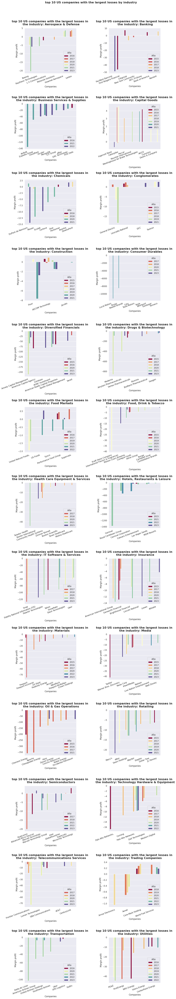

In [ ]:
industries = df_result.Industria.unique()

fig, axes = plt.subplots(nrows=13, ncols=2, figsize=(15, 6*13))
fig.tight_layout(pad=12.0)
fig.suptitle('top 10 US companies with the largest losses by industry', y=1, fontsize=16,weight='bold')
for i, industry in enumerate(industries):
  row = i // 2
  col = i % 2
  fig = sns.barplot(x='Empresa',y='Margen de Rentabilidad',data=df_result.loc[df_result.Industria==industry].sort_values(by='Margen de Rentabilidad'), hue='Año',palette='Spectral', ax=axes[row,col])
  axes[row,col].set_xticklabels(axes[row,col].get_xticklabels(), rotation=20, horizontalalignment='right')
  axes[row,col].set_title(f'top 10 US companies with the largest losses in \n the industry: {industry}', fontsize=16, pad=15,weight='bold')
  axes[row,col].set_xlabel('Companies')
  axes[row,col].set_ylabel('Margin profit')
plt.show()

### 5.2.7 What was the distribution of Income and Assets with respect to profits for banks whose assets do not exceed USD 15 billion?

In [ ]:
condition_1 = df_part_2['Industria']=='Banking'
condition_2 = df_part_2['Activos']< 15000

df_part_2[(condition_1)&((condition_2))].groupby(by=['Industria'])[['Margen de Rentabilidad','ROA']].describe()

Margen de Rentabilidad                                            \
                           count       mean        std   min    25%    50%   
Industria                                                                    
Banking                     19.0  66.893158  97.762388  0.01  18.51  33.34   

                           ROA                                             \
             75%     max count        mean         std   min    25%   50%   
Industria                                                                   
Banking    65.81  406.74  19.0  192.794211  602.056685  0.07  3.545  4.61   

                          
            75%      max  
Industria                 
Banking    32.6  2594.59

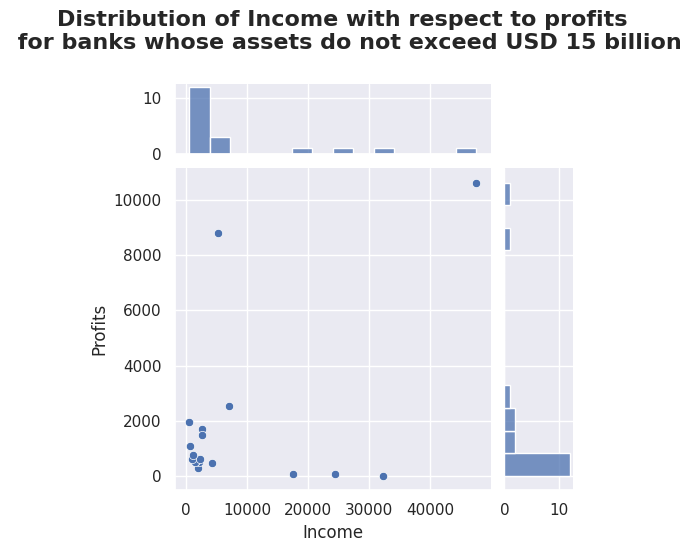

In [ ]:
fig=sns.jointplot(data=df_part_2[(condition_1) & (condition_2)], x='Ingresos', y='Ganancias',height=5, ratio=4, marginal_ticks=True)
sns.set(style="darkgrid")
plt.suptitle('Distribution of Income with respect to profits \n for banks whose assets do not exceed USD 15 billion', y = 1.1, fontsize=16,weight='bold')
fig.set_axis_labels('Income', 'Profits')

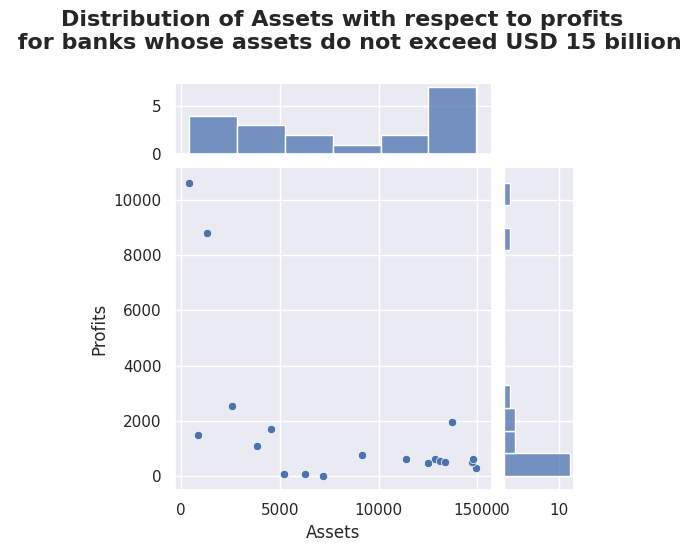

In [ ]:
fig=sns.jointplot(data=df_part_2[(condition_1) & (condition_2)], x='Activos', y='Ganancias',height=5, ratio=4, marginal_ticks=True)
sns.set(style="darkgrid")
plt.suptitle('Distribution of Assets with respect to profits \n for banks whose assets do not exceed USD 15 billion', y = 1.1, fontsize=16,weight='bold')
fig.set_axis_labels('Assets', 'Profits')

### 5.2.8 What were the annual profits of the main companies in the automotive industry?

In [ ]:
df_part_2.Industria.unique()

array(['Banking', 'Diversified Financials', 'Oil & Gas Operations',
       'Conglomerates', 'Consumer Durables',
       'Technology Hardware & Equipment', 'Retailing', 'Semiconductors',
       'Telecommunications Services', 'Insurance',
       'IT Software & Services', 'Food, Drink & Tobacco',
       'Health Care Equipment & Services', 'Media',
       'Drugs & Biotechnology', 'Materials', 'Utilities', 'Chemicals',
       'Aerospace & Defense', 'Construction', 'Trading Companies',
       'Capital Goods', 'Transportation', 'Hotels, Restaurants & Leisure',
       'Business Services & Supplies', 'Food Markets'], dtype=object)

In [ ]:
condition_1 = df_part_2['Industria']=='Consumer Durables'

df_result = df_part_2[condition_1].groupby('Año').apply(lambda x: x.nlargest(10, 'Ganancias')).reset_index(drop=True)

In [ ]:
df_result[df_result['Empresa']=='Daimler']

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
3,26,Daimler,Consumer Durables,Germany,172268.0,9234.7,229468.0,103272.0,5.36,4.02,2015,DEU,Europe
12,24,Daimler,Consumer Durables,Germany,165747.0,9341.5,235907.0,75406.0,5.64,3.96,2016,DEU,Europe
22,28,Daimler,Consumer Durables,Germany,169537.0,9431.4,256292.0,76099.0,5.56,3.68,2017,DEU,Europe
32,29,Daimler,Consumer Durables,Germany,193217.0,11793.6,323196.0,85678.0,6.10,3.65,2018,DEU,Europe
44,37,Daimler,Consumer Durables,Germany,197445.0,8552.0,321933.0,71342.0,4.33,2.66,2019,DEU,Europe
68,41,Daimler,Consumer Durables,Germany,175908.0,4134.7,349614.0,99184.0,2.35,1.18,2021,DEU,Europe


In [ ]:
for year in  range(2015,2024,1):
  x=df_result[df_result['Año']==year]
  print(year)
  print(x.Empresa)

2015
0               Toyota Motor
1           Volkswagen Group
2           Procter & Gamble
3                    Daimler
4                  BMW Group
5              Hyundai Motor
6                   Unilever
7              L'Oréal Group
8                Honda Motor
9    Reckitt Benckiser Group
Name: Empresa, dtype: object
2016
10        Toyota Motor
11      General Motors
12             Daimler
13    Procter & Gamble
14          Ford Motor
15           BMW Group
16    Volkswagen Group
17       Hyundai Motor
18            Unilever
19        Nissan Motor
Name: Empresa, dtype: object
2017
20         Toyota Motor
21     Procter & Gamble
22              Daimler
23       General Motors
24            BMW Group
25             Unilever
26     Volkswagen Group
27           SAIC Motor
28        Hyundai Motor
29    Hon Hai Precision
Name: Empresa, dtype: object
2018
30        Toyota Motor
31    Volkswagen Group
32             Daimler
33           BMW Group
34    Procter & Gamble
35         Honda M

In [ ]:
condition_1= df_result.Empresa=='Toyota Motor'
condition_2= df_result.Empresa=='Volkswagen Group'
condition_3= df_result.Empresa=='Daimler'
condition_4= df_result.Empresa=='BMW Group'
condition_5= df_result.Empresa=='Hyundai Motor'
condition_6= df_result.Empresa=='Honda Motor'
condition_7= df_result.Empresa=='General Motors'
condition_8= df_result.Empresa=='Ford Motor'
condition_9= df_result.Empresa=='Nissan Motor'
condition_10= df_result.Empresa=='Renault'
condition_11= df_result.Empresa=='Porsche Automobil Holding'
condition_12= df_result.Empresa=='Stellantis'
condition_13= df_result.Empresa=='Mercedes-Benz Group'


df_cars = df_result.loc[condition_1 |condition_2 | condition_3 | condition_4 | condition_5 | condition_6 | condition_7 | condition_8 | condition_9 | condition_10 | condition_11 |condition_12 | condition_13]

In [ ]:
df_cars.Empresa=df_cars.Empresa.replace('Daimler','Mercedes-Benz Group')

In [ ]:
df_cars.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,11,Toyota Motor,Consumer Durables,Japan,252185.0,19120.4,389693.0,239045.0,7.58,4.91,2015,JPN,Asia
1,14,Volkswagen Group,Consumer Durables,Germany,268549.0,14388.0,424980.0,126017.0,5.36,3.39,2015,DEU,Europe
3,26,Mercedes-Benz Group,Consumer Durables,Germany,172268.0,9234.7,229468.0,103272.0,5.36,4.02,2015,DEU,Europe
4,45,BMW Group,Consumer Durables,Germany,106648.0,7690.7,187319.0,81445.0,7.21,4.11,2015,DEU,Europe
5,117,Hyundai Motor,Consumer Durables,South Korea,84791.0,6979.3,133945.0,32854.0,8.23,5.21,2015,KOR,Asia


In [ ]:
df_cars.Empresa.nunique()

12

Text(0.5, 1, 'Annual profits of the main companies in the automotive industry')

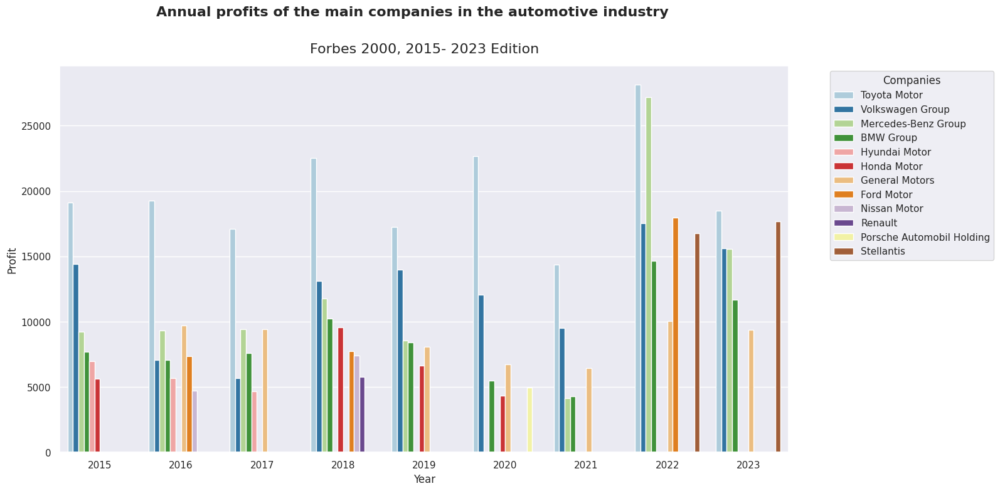

In [ ]:
fig, ax = plt.subplots(figsize=(15, 8))
sns.barplot(y='Ganancias',x='Año',data=df_cars,hue='Empresa',palette="Paired")
# Move the legend outside the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Companies')
ax.set_xlabel('Year')
ax.set_ylabel('Profit')
ax.set_title('Forbes 2000, 2015- 2023 Edition', fontsize=16, pad=15)
fig.suptitle('Annual profits of the main companies in the automotive industry', y=1, fontsize=16,weight='bold')

## 5.3 Extra

In [ ]:
df_part_2.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,1,ICBC,Banking,China,166796.0,44757.2,3322043.0,278327.0,26.83,1.35,2015,CHN,Asia
1,2,China Construction Bank,Banking,China,130473.0,37038.9,2698925.0,212945.0,28.39,1.37,2015,CHN,Asia
2,3,Agricultural Bank of China,Banking,China,129221.0,29124.5,2574815.0,189879.0,22.54,1.13,2015,CHN,Asia
3,4,Bank of China,Banking,China,120297.0,27526.8,2458336.0,199130.0,22.88,1.12,2015,CHN,Asia
4,5,Berkshire Hathaway,Diversified Financials,United States,194673.0,19872.0,534618.0,354813.0,10.21,3.72,2015,USA,North America


### 5.3.1 Create a racing bar chart showing the change in market value by industry over the period 2015 - 2023.  

In [ ]:
df_bar_race_1 = pd.crosstab(df_part_2.Año, df_part_2.Industria,values=df_part_2['Valor de Mercado'], aggfunc='mean').round(0)

In [ ]:
bcr.bar_chart_race(
    df=df_bar_race_1,
    title='Change in market value by industry over the period 2015 - 2023',
    orientation='h',
    sort='desc',
    n_bars=5,
    steps_per_period=40,
    period_length=3000,
    perpendicular_bar_func='median'
  )


### 5.3.2 Create another bar chart showing the change in the number of employees by industry over the period 2015 - 2023.

In [ ]:
df_extra=pd.read_csv('/content/drive/MyDrive/data science/boot camp - data science - ALURA/challenge_2_datainsider/df_extra.csv')

In [ ]:
df_extra.head()

,Unnamed: 0,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Empleados
0,0,2,China Construction Bank,Banking,China,130473.0,37038.9,2698925.0,212945.0,28.39,1.37,2015,CHN,Asia,372321
1,1,3,Agricultural Bank of China,Banking,China,129221.0,29124.5,2574815.0,189879.0,22.54,1.13,2015,CHN,Asia,505627
2,2,4,Bank of China,Banking,China,120297.0,27526.8,2458336.0,199130.0,22.88,1.12,2015,CHN,Asia,308128
3,3,5,Berkshire Hathaway,Diversified Financials,United States,194673.0,19872.0,534618.0,354813.0,10.21,3.72,2015,USA,North America,316000
4,4,6,JPMorgan Chase,Banking,United States,97817.0,21219.0,2593562.0,225451.0,21.69,0.82,2015,USA,North America,241359


In [ ]:
df_bar_race_2 = pd.crosstab(df_extra.Año, df_extra.Industria,values=df_extra['Empleados'], aggfunc='mean').round(0)
df_bar_race_2

Industria,Aerospace & Defense,Banking,Business Services & Supplies,Capital Goods,Chemicals,Conglomerates,Construction,Consumer Durables,Diversified Financials,Drugs & Biotechnology,...,Materials,Media,Oil & Gas Operations,Retailing,Semiconductors,Technology Hardware & Equipment,Telecommunications Services,Trading Companies,Transportation,Utilities
Año,,,,,,,,,,,,,,,,,,,,,
2015,95233.0,147087.0,229505.0,109583.0,73352.0,184070.0,157000.0,164146.0,76527.0,65409.0,...,89653.0,80505.0,53498.0,338340.0,122148.0,95422.0,124695.0,58757.0,145242.0,52618.0
2016,91257.0,140212.0,179550.0,115804.0,71266.0,191926.0,123862.0,164411.0,79320.0,58458.0,...,83239.0,95825.0,60220.0,314002.0,126143.0,115255.0,138194.0,67809.0,142945.0,44831.0
2017,92057.0,142147.0,186265.0,118270.0,72601.0,190846.0,143023.0,158306.0,85932.0,58524.0,...,81198.0,98400.0,71392.0,306069.0,127117.0,104577.0,139454.0,52727.0,158551.0,50810.0
2018,91567.0,134674.0,126676.0,129522.0,78312.0,193195.0,150798.0,162093.0,94816.0,64947.0,...,79595.0,105760.0,68827.0,376602.0,124993.0,92400.0,144683.0,55437.0,151839.0,53207.0
2019,112485.0,133061.0,69583.0,134421.0,62714.0,248235.0,148175.0,149779.0,121564.0,75288.0,...,69395.0,161000.0,69402.0,365701.0,56288.0,147602.0,156508.0,57972.0,177917.0,51220.0
2020,133939.0,137010.0,65936.0,115533.0,64545.0,241221.0,138827.0,145182.0,110886.0,67269.0,...,78962.0,169367.0,76983.0,421158.0,81048.0,156458.0,153715.0,60181.0,163628.0,59765.0
2021,119117.0,156692.0,65506.0,93992.0,55929.0,219207.0,143341.0,127671.0,115888.0,52847.0,...,66201.0,119125.0,71270.0,499756.0,68095.0,120436.0,146404.0,67078.0,499718.0,55078.0
2022,124599.0,146841.0,83079.0,118596.0,57993.0,201792.0,141164.0,153340.0,114903.0,78020.0,...,66741.0,116250.0,78422.0,490170.0,67401.0,163687.0,150191.0,58944.0,240693.0,56264.0
2023,111661.0,154178.0,31040.0,140314.0,53577.0,276000.0,125794.0,158250.0,127109.0,83168.0,...,76503.0,106760.0,41793.0,415513.0,58711.0,176417.0,144428.0,78893.0,190627.0,71023.0


In [ ]:
bcr.bar_chart_race(
    df=df_bar_race_2,
    title='change in the number of employees by industry over the period 2015 - 2023',
    orientation='h',
    sort='desc',
    n_bars=5,
    steps_per_period=40,
    period_length=3000,
    perpendicular_bar_func='median'
  )

### 5.3.3 Using Plotly's Choropleth library, generate a map of total global sales by country in 2020.




In [ ]:
ventas_por_pais=df_part_2.loc[df_part_2.Año==2020].groupby(by='Pais')['Ingresos'].mean().reset_index()

In [ ]:
fig = px.choropleth(
    data_frame=ventas_por_pais,
    locations='Pais',
    locationmode='country names',
    color='Ingresos',
    color_continuous_scale='Viridis',
    title='Sales by Country',
    labels={'Ingresos': 'Sales in USD'},  # Label for the color bar
    hover_name='Pais',  # Set what appears when hovering over each country
    hover_data={'Ingresos': ':,.2f'},  # Format the hover data
    projection='natural earth'  # Choose a map projection
)

fig.show()

---
# 6. Insights
---



## 6.1 Number of companies

In [ ]:
query_1 = df_part_2.groupby(by=['Pais'])['Empresa'].nunique().sort_values(ascending=False).reset_index()

In [ ]:
query_1.head(20)

,Pais,Empresa
0,United States,1062
1,China,522
2,Japan,302
3,United Kingdom,153
4,South Korea,113
5,Hong Kong,111
6,Canada,109
7,Germany,87
8,France,85
9,India,83


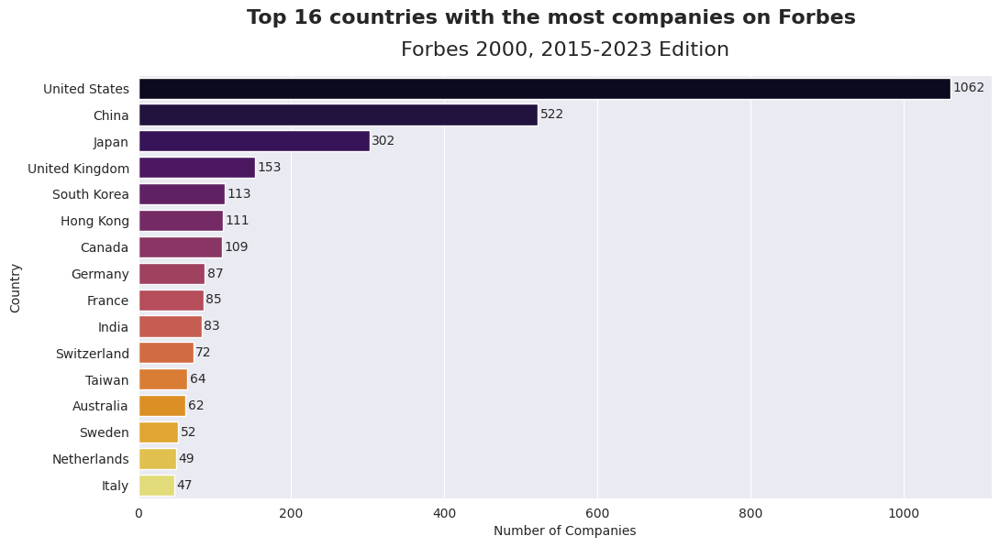

In [ ]:
# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(12, 6))
sns.set_style('darkgrid')
sns.barplot(y='Pais',x='Empresa', data=query_1.head(16), palette='inferno', ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(query_1['Empresa'].head(16)):
    ax.text(value+3, i, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('Number of Companies')
ax.set_ylabel('Country')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle('Top 16 countries with the most companies on Forbes', y=1, fontsize=16,weight='bold')


# Show the plot
plt.show()

In [ ]:
fig = px.choropleth(
    data_frame=query_1,
    locations='Pais',
    locationmode='country names',
    color='Empresa',
    color_continuous_scale='inferno_r',
    title='Number of unique companies by country',
    labels={'Empresa': 'Number of companies'},  # Label for the color bar
    hover_name='Empresa',  # Set what appears when hovering over each country
    hover_data={'Empresa': ':,.2f'},  # Format the hover data
    projection='natural earth'  # Choose a map projection
)

fig.show()

In [ ]:
query_2 = df_part_2.loc[df_part_2.Continente=='Europe'].groupby(by=['Pais'])['Empresa'].nunique().sort_values(ascending=False).reset_index()
query_2.head(10)

,Pais,Empresa
0,United Kingdom,153
1,Germany,87
2,France,85
3,Switzerland,72
4,Sweden,52
5,Netherlands,49
6,Italy,47
7,Russia,43
8,Spain,38
9,Ireland,36


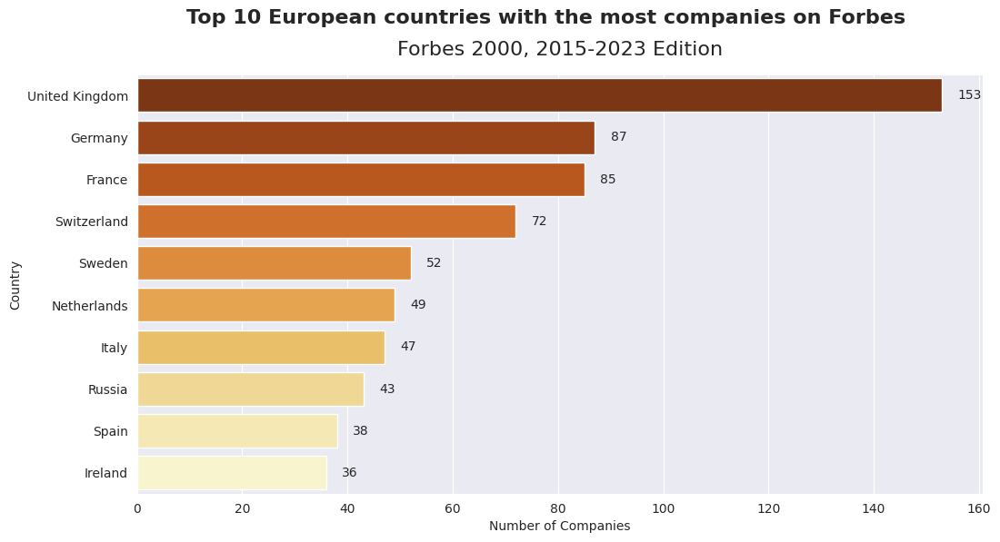

In [ ]:
# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(12, 6))
sns.set_style('darkgrid')
sns.barplot(y='Pais',x='Empresa', data=query_2.head(10), palette="YlOrBr_r", ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(query_2['Empresa'].head(10)):
    ax.text(value+3, i, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('Number of Companies')
ax.set_ylabel('Country')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle('Top 10 European countries with the most companies on Forbes', y=1, fontsize=16,weight='bold')


# Show the plot
plt.show()

In [ ]:
fig = px.choropleth(
    data_frame=query_2,
    locations='Pais',
    locationmode='country names',
    color='Empresa',
    color_continuous_scale="YlOrBr",
    title='Number of unique companies by country in Europe',
    labels={'Empresa': 'Number of companies'},  # Label for the color bar
    hover_name='Empresa',  # Set what appears when hovering over each country
    hover_data={'Empresa': ':,.2f'},  # Format the hover data
    projection='natural earth'  # Choose a map projection
)

fig.show()

## 6.2 Income

In [ ]:
median_income_by_industry_and_year=df_part_2.groupby(['Año','Industria'])['Ingresos'].median().rename('median income').reset_index()

In [ ]:
median_income_by_industry_and_year

,Año,Industria,median income
0,2015,Aerospace & Defense,17209.0
1,2015,Banking,3465.5
2,2015,Business Services & Supplies,7199.0
3,2015,Capital Goods,10219.0
4,2015,Chemicals,12780.5
...,...,...,...
229,2023,Technology Hardware & Equipment,17082.0
230,2023,Telecommunications Services,16011.5
231,2023,Trading Companies,25549.5
232,2023,Transportation,12609.0


### 6.2.1 Revenue growth

In [ ]:
median_income_by_industry_and_year.loc[(median_income_by_industry_and_year.Año==2023)&(median_income_by_industry_and_year.Industria=='Aerospace & Defense')]['median income'].values[0]

16654.0

In [ ]:
df_var_median=pd.DataFrame(columns=['Industria','var_median'])

for industry in median_income_by_industry_and_year.Industria.unique():
  median_2015 = median_income_by_industry_and_year.loc[(median_income_by_industry_and_year.Año==2015)&(median_income_by_industry_and_year.Industria==industry)]['median income'].values[0]
  median_2023 = median_income_by_industry_and_year.loc[(median_income_by_industry_and_year.Año==2023)&(median_income_by_industry_and_year.Industria==industry)]['median income'].values[0]
  var = (median_2023/median_2015)-1
  new_row = {'Industria':industry,'var_median':var}
  df_var_median = df_var_median.append(new_row, ignore_index=True)

In [ ]:
df_var_median.sort_values(by='var_median',ascending=False)

,Industria,var_median
5,Conglomerates,1.286819
20,Semiconductors,1.284924
8,Diversified Financials,0.896883
17,Media,0.642624
7,Consumer Durables,0.640583
3,Capital Goods,0.571533
25,Utilities,0.530408
6,Construction,0.490335
1,Banking,0.438032
13,"Hotels, Restaurants & Leisure",0.426873


In [ ]:
df_var_median.sort_values(by='var_median',ascending=False).Industria[:7]

5              Conglomerates
20            Semiconductors
8     Diversified Financials
17                     Media
7          Consumer Durables
3              Capital Goods
25                 Utilities
Name: Industria, dtype: object

In [ ]:
df_var_median.sort_values(by='var_median',ascending=False).Industria[7:13]

6                      Construction
1                           Banking
13    Hotels, Restaurants & Leisure
15                        Insurance
10                     Food Markets
22      Telecommunications Services
Name: Industria, dtype: object

In [ ]:
df_var_median.sort_values(by='var_median',ascending=False).Industria[13:19]

19                       Retailing
2     Business Services & Supplies
9            Drugs & Biotechnology
18            Oil & Gas Operations
16                       Materials
11           Food, Drink & Tobacco
Name: Industria, dtype: object

In [ ]:
df_var_median.sort_values(by='var_median',ascending=False).Industria[19:]

21     Technology Hardware & Equipment
23                   Trading Companies
12    Health Care Equipment & Services
14              IT Software & Services
24                      Transportation
4                            Chemicals
0                  Aerospace & Defense
Name: Industria, dtype: object

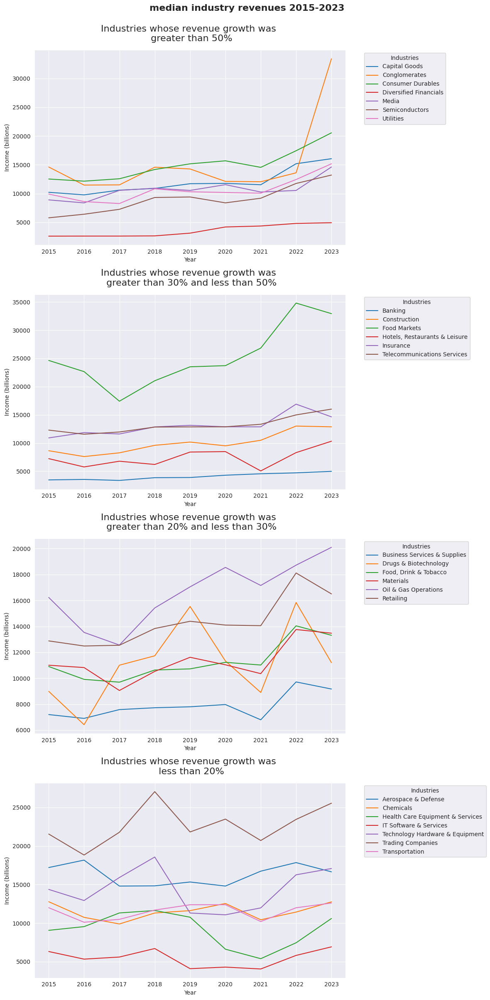

In [ ]:
# Determine the groups of industries based on your criteria
group1 = df_var_median.sort_values(by='var_median',ascending=False).Industria[:7] # Define your industries for group 1
group2 = df_var_median.sort_values(by='var_median',ascending=False).Industria[7:13]
group3 = df_var_median.sort_values(by='var_median',ascending=False).Industria[13:19]
group4 = df_var_median.sort_values(by='var_median',ascending=False).Industria[19:]  # Define your industries for group 2

# Filter the DataFrame based on groups
group1_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group1)]
group2_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group2)]
group3_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group3)]
group4_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group4)]
# Create subplots
fig, axes = plt.subplots(4, 1, figsize=(12, 8*3))
fig.suptitle('median industry revenues 2015-2023', y=1, fontsize=16,weight='bold')

# Plot for group 1
sns.lineplot(data=group1_data, x='Año', y='median income', hue='Industria',palette="tab10" ,ax=axes[0])
axes[0].set_title('Industries whose revenue growth was \n greater than 50%', fontsize=16, pad=15)
axes[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[0].set_xlabel('Year')
axes[0].set_ylabel('Income (billions)')


# Plot for group 2
sns.lineplot(data=group2_data, x='Año', y='median income', hue='Industria',palette="tab10", ax=axes[1])
axes[1].set_title('Industries whose revenue growth was \n greater than 30% and less than 50%', fontsize=16, pad=15)
axes[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[1].set_xlabel('Year')
axes[1].set_ylabel('Income (billions)')


# Plot for group 2
sns.lineplot(data=group3_data, x='Año', y='median income', hue='Industria',palette="tab10", ax=axes[2])
axes[2].set_title('Industries whose revenue growth was \n greater than 20% and less than 30%', fontsize=16, pad=15)
axes[2].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[2].set_xlabel('Year')
axes[2].set_ylabel('Income (billions)')


# Plot for group 2
sns.lineplot(data=group4_data, x='Año', y='median income', hue='Industria',palette="tab10", ax=axes[3])
axes[3].set_title('Industries whose revenue growth was \n less than 20%', fontsize=16, pad=15)
axes[3].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[3].set_xlabel('Year')
axes[3].set_ylabel('Income (billions)')


plt.tight_layout()
plt.show()


### 6.2.2 Avg of Revenue 2015-2023

In [ ]:
median_income_by_industry_and_year.head()

,Año,Industria,median income
0,2015,Aerospace & Defense,17209.0
1,2015,Banking,3465.5
2,2015,Business Services & Supplies,7199.0
3,2015,Capital Goods,10219.0
4,2015,Chemicals,12780.5


In [ ]:
avg_of_median_income_by_industry_and_year=median_income_by_industry_and_year.groupby('Industria')['median income'].mean().rename('avg of median income').reset_index().sort_values(by='avg of median income',ascending=False)
avg_of_median_income_by_industry_and_year

,Industria,avg of median income
10,Food Markets,25279.444444
23,Trading Companies,22693.666667
18,Oil & Gas Operations,16594.500000
0,Aerospace & Defense,16268.944444
5,Conglomerates,15296.000000
7,Consumer Durables,14984.166667
21,Technology Hardware & Equipment,14392.666667
19,Retailing,14326.777778
22,Telecommunications Services,13189.444444
15,Insurance,13072.500000


In [ ]:
avg_of_median_income_by_industry_and_year.Industria[:5]

10            Food Markets
23       Trading Companies
18    Oil & Gas Operations
0      Aerospace & Defense
5            Conglomerates
Name: Industria, dtype: object

In [ ]:
avg_of_median_income_by_industry_and_year.Industria[5:10]

7                   Consumer Durables
21    Technology Hardware & Equipment
19                          Retailing
22        Telecommunications Services
15                          Insurance
Name: Industria, dtype: object

In [ ]:
avg_of_median_income_by_industry_and_year.Industria[10:19]

3             Capital Goods
24           Transportation
4                 Chemicals
16                Materials
11    Food, Drink & Tobacco
9     Drugs & Biotechnology
17                    Media
25                Utilities
6              Construction
Name: Industria, dtype: object

In [ ]:
avg_of_median_income_by_industry_and_year.Industria[19:]

12    Health Care Equipment & Services
20                      Semiconductors
2         Business Services & Supplies
13       Hotels, Restaurants & Leisure
14              IT Software & Services
1                              Banking
8               Diversified Financials
Name: Industria, dtype: object

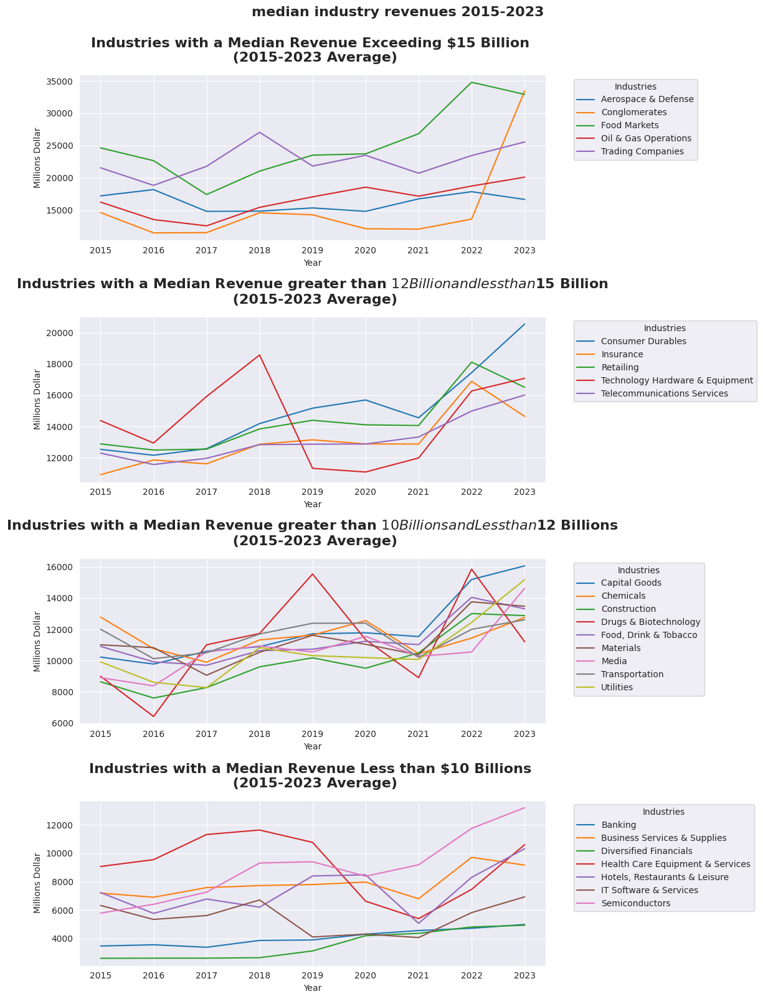

In [ ]:
# Determine the groups of industries based on your criteria
group1 = avg_of_median_income_by_industry_and_year.Industria[:5]
group2 = avg_of_median_income_by_industry_and_year.Industria[5:10]
group3 = avg_of_median_income_by_industry_and_year.Industria[10:19]
group4 = avg_of_median_income_by_industry_and_year.Industria[19:]

# Filter the DataFrame based on groups
group1_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group1)]
group2_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group2)]
group3_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group3)]
group4_data = median_income_by_industry_and_year[median_income_by_industry_and_year['Industria'].isin(group4)]
# Create subplots
fig, axes = plt.subplots(4, 1, figsize=(12, 8*2))
fig.suptitle('median industry revenues 2015-2023', y=1, fontsize=16,weight='bold')

# Plot for group 1
sns.lineplot(data=group1_data, x='Año', y='median income', hue='Industria',palette="tab10" ,ax=axes[0])
axes[0].set_title("Industries with a Median Revenue Exceeding $15 Billion \n (2015-2023 Average)", fontsize=16, pad=15, weight='bold')
axes[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[0].set_xlabel('Year')
axes[0].set_ylabel('Millions Dollar')


# Plot for group 2
sns.lineplot(data=group2_data, x='Año', y='median income', hue='Industria',palette="tab10", ax=axes[1])
axes[1].set_title('Industries with a Median Revenue greater than $12 Billion and less than $15 Billion \n (2015-2023 Average)', fontsize=16, pad=15, weight='bold')
axes[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[1].set_xlabel('Year')
axes[1].set_ylabel('Millions Dollar')


# Plot for group 2
sns.lineplot(data=group3_data, x='Año', y='median income', hue='Industria',palette="tab10", ax=axes[2])
axes[2].set_title('Industries with a Median Revenue greater than $10 Billions and Less than $12 Billions \n (2015-2023 Average)', fontsize=16, pad=15, weight='bold')
axes[2].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[2].set_xlabel('Year')
axes[2].set_ylabel('Millions Dollar')


# Plot for group 2
sns.lineplot(data=group4_data, x='Año', y='median income', hue='Industria',palette="tab10", ax=axes[3])
axes[3].set_title('Industries with a Median Revenue Less than $10 Billions \n (2015-2023 Average)', fontsize=16, pad=15, weight='bold')
axes[3].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[3].set_xlabel('Year')
axes[3].set_ylabel('Millions Dollar')


plt.tight_layout()
plt.show()

In [ ]:
df_part_2[df_part_2.Año==2023].Ingresos.sum()

50844895.0

In [ ]:
df_part_2[df_part_2.Año==2023].head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
15996,1,JPMorgan Chase,Banking,United States,179933.0,41795.0,3744305.0,399594.0,23.23,1.12,2023,USA,North America
15997,2,Saudi Arabian Oil Company (Saudi Aramco),Oil & Gas Operations,Saudi Arabia,589467.0,156357.0,660990.0,2055222.0,26.53,23.65,2023,SAU,Asia
15998,3,ICBC,Banking,China,216767.0,52470.8,6116824.0,203012.0,24.21,0.86,2023,CHN,Asia
15999,4,China Construction Bank,Banking,China,203083.0,48252.5,4977476.0,172992.0,23.76,0.97,2023,CHN,Asia
16000,5,Agricultural Bank of China,Banking,China,186144.0,37924.7,5356862.0,141822.0,20.37,0.71,2023,CHN,Asia


## 6.3 Profit Margin

In [ ]:
median_profit_margin_by_industry_and_year=df_part_2.groupby(['Año','Industria'])['Margen de Rentabilidad'].median().rename('Profit Margin (median)').reset_index()

In [ ]:
median_profit_margin_by_industry_and_year.head()

,Año,Industria,Profit Margin (median)
0,2015,Aerospace & Defense,5.550
1,2015,Banking,18.060
2,2015,Business Services & Supplies,9.500
3,2015,Capital Goods,6.960
4,2015,Chemicals,7.645


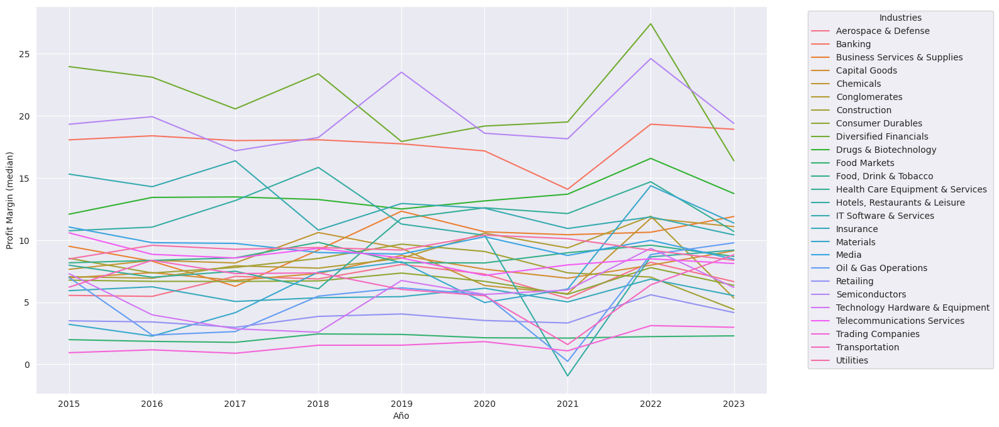

In [ ]:
fig,ax =plt.subplots(figsize=(15,8))
sns.lineplot(data=median_profit_margin_by_industry_and_year,x='Año',y='Profit Margin (median)',hue='Industria')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')

In [ ]:
avg_of_Profit_Margin_median=median_profit_margin_by_industry_and_year.groupby('Industria')['Profit Margin (median)'].mean().rename('avg of Profit Margin median').reset_index().sort_values(by='avg of Profit Margin median',ascending=False)
avg_of_Profit_Margin_median

,Industria,avg of Profit Margin median
8,Diversified Financials,21.260556
20,Semiconductors,19.876111
1,Banking,17.748333
9,Drugs & Biotechnology,13.543333
14,IT Software & Services,12.831111
12,Health Care Equipment & Services,10.045556
13,"Hotels, Restaurants & Leisure",9.933333
2,Business Services & Supplies,9.913333
17,Media,9.545556
25,Utilities,9.331111


In [ ]:
avg_of_Profit_Margin_median.Industria[:6]

8               Diversified Financials
20                      Semiconductors
1                              Banking
9                Drugs & Biotechnology
14              IT Software & Services
12    Health Care Equipment & Services
Name: Industria, dtype: object

In [ ]:
avg_of_Profit_Margin_median.Industria[6:14]

13    Hotels, Restaurants & Leisure
2      Business Services & Supplies
17                            Media
25                        Utilities
4                         Chemicals
11            Food, Drink & Tobacco
22      Telecommunications Services
5                     Conglomerates
Name: Industria, dtype: object

In [ ]:
avg_of_Profit_Margin_median.Industria[14:20]

6            Construction
3           Capital Goods
16              Materials
7       Consumer Durables
0     Aerospace & Defense
24         Transportation
Name: Industria, dtype: object

In [ ]:
avg_of_Profit_Margin_median.Industria[20:]

15                          Insurance
21    Technology Hardware & Equipment
18               Oil & Gas Operations
19                          Retailing
10                       Food Markets
23                  Trading Companies
Name: Industria, dtype: object

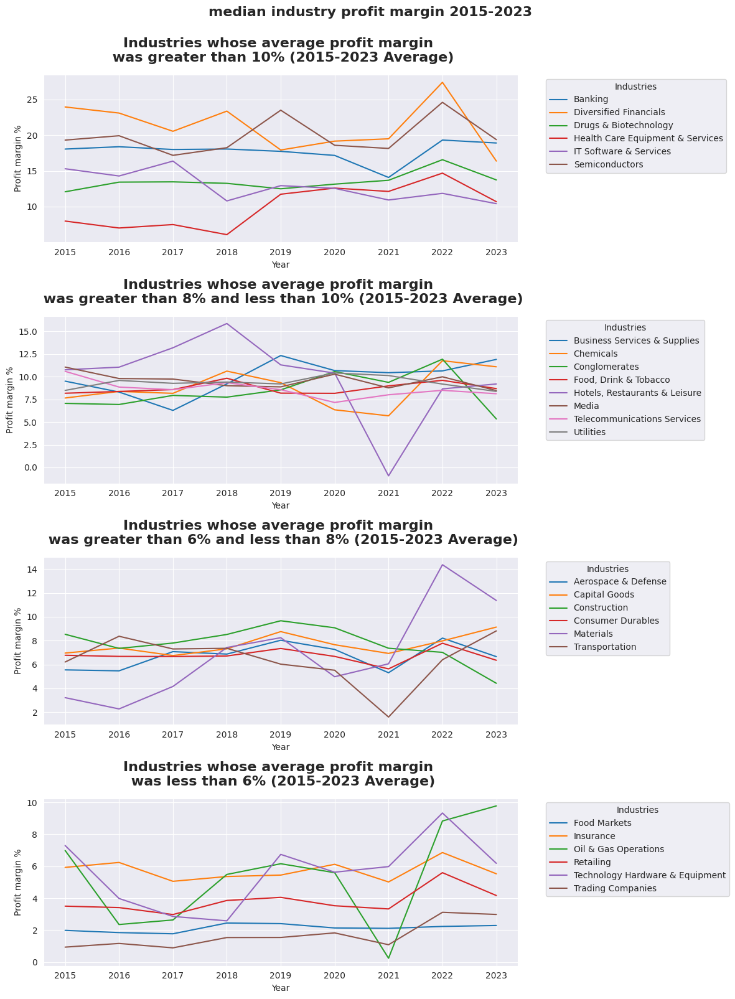

In [ ]:
# Determine the groups of industries based on your criteria
group1 = avg_of_Profit_Margin_median.Industria[:6]
group2 = avg_of_Profit_Margin_median.Industria[6:14]
group3 = avg_of_Profit_Margin_median.Industria[14:20]
group4 = avg_of_Profit_Margin_median.Industria[20:]

# Filter the DataFrame based on groups
group1_data = median_profit_margin_by_industry_and_year[median_profit_margin_by_industry_and_year['Industria'].isin(group1)]
group2_data = median_profit_margin_by_industry_and_year[median_profit_margin_by_industry_and_year['Industria'].isin(group2)]
group3_data = median_profit_margin_by_industry_and_year[median_profit_margin_by_industry_and_year['Industria'].isin(group3)]
group4_data = median_profit_margin_by_industry_and_year[median_profit_margin_by_industry_and_year['Industria'].isin(group4)]
# Create subplots
fig, axes = plt.subplots(4, 1, figsize=(12, 8*2))
fig.suptitle('median industry profit margin 2015-2023', y=1, fontsize=16,weight='bold')

# Plot for group 1
sns.lineplot(data=group1_data, x='Año', y='Profit Margin (median)', hue='Industria',palette="tab10" ,ax=axes[0])
axes[0].set_title('Industries whose average profit margin \n was greater than 10% (2015-2023 Average)', fontsize=16, pad=15, weight='bold')
axes[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[0].set_xlabel('Year')
axes[0].set_ylabel('Profit margin %')


# Plot for group 2
sns.lineplot(data=group2_data, x='Año', y='Profit Margin (median)', hue='Industria',palette="tab10", ax=axes[1])
axes[1].set_title('Industries whose average profit margin \n was greater than 8% and less than 10% (2015-2023 Average)', fontsize=16, pad=15, weight='bold')
axes[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[1].set_xlabel('Year')
axes[1].set_ylabel('Profit margin %')


# Plot for group 2
sns.lineplot(data=group3_data, x='Año', y='Profit Margin (median)', hue='Industria',palette="tab10", ax=axes[2])
axes[2].set_title('Industries whose average profit margin \n was greater than 6% and less than 8% (2015-2023 Average)', fontsize=16, pad=15, weight='bold')
axes[2].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[2].set_xlabel('Year')
axes[2].set_ylabel('Profit margin %')


# Plot for group 2
sns.lineplot(data=group4_data, x='Año', y='Profit Margin (median)', hue='Industria',palette="tab10", ax=axes[3])
axes[3].set_title('Industries whose average profit margin \n was less than 6% (2015-2023 Average)', fontsize=16, pad=15, weight='bold')
axes[3].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Industries')
axes[3].set_xlabel('Year')
axes[3].set_ylabel('Profit margin %')


plt.tight_layout()
plt.show()

## 6.4 Continents

In [ ]:
df_europe = df_part_2[(df_part_2.Continente=='Europe')]

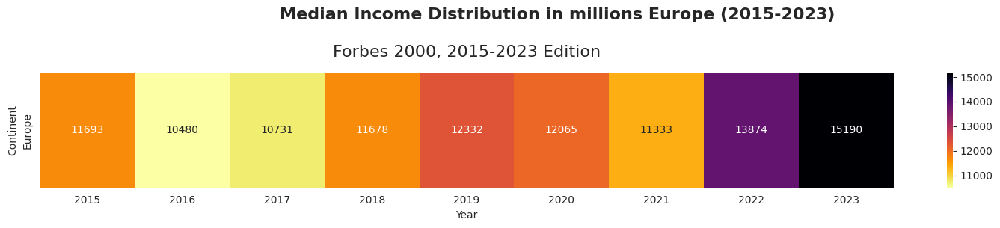

In [ ]:
# Create the heatmap
fig, ax = plt.subplots(figsize=(15, 3))
sns.heatmap(
    pd.crosstab(df_europe.Continente, df_europe.Año, values=df_part_2.Ingresos, aggfunc='median').round(0),
    cmap="inferno_r",
    cbar= True,
    annot=True,
    fmt='.0f'  # Set the format to avoid scientific notation
)

# Add labels and title
ax.set_xlabel('Year')
ax.set_ylabel('Continent')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle( 'Median Income Distribution in millions Europe (2015-2023)', y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()

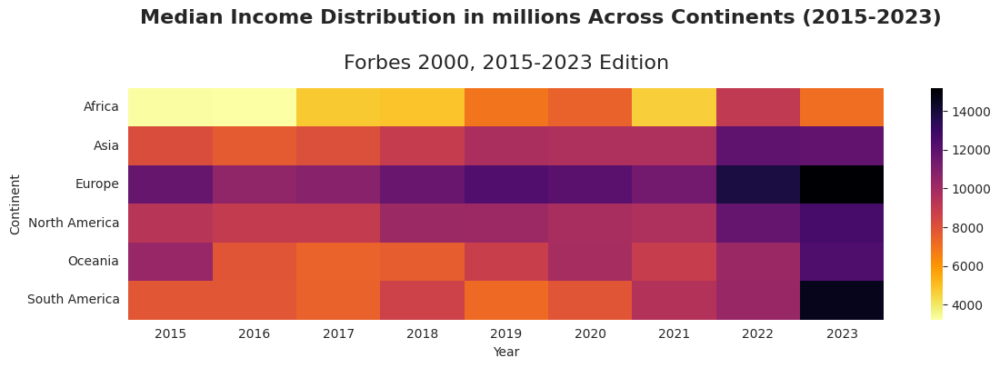

In [ ]:
# Create the heatmap
fig, ax = plt.subplots(figsize=(12, 4))
sns.heatmap(
    pd.crosstab(df_part_2.Continente, df_part_2.Año, values=df_part_2.Ingresos, aggfunc='median').round(0),
    cmap="inferno_r",
    cbar= True,
    fmt='.0f'  # Set the format to avoid scientific notation
)

# Add labels and title
ax.set_xlabel('Year')
ax.set_ylabel('Continent')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle( 'Median Income Distribution in millions Across Continents (2015-2023)', y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()

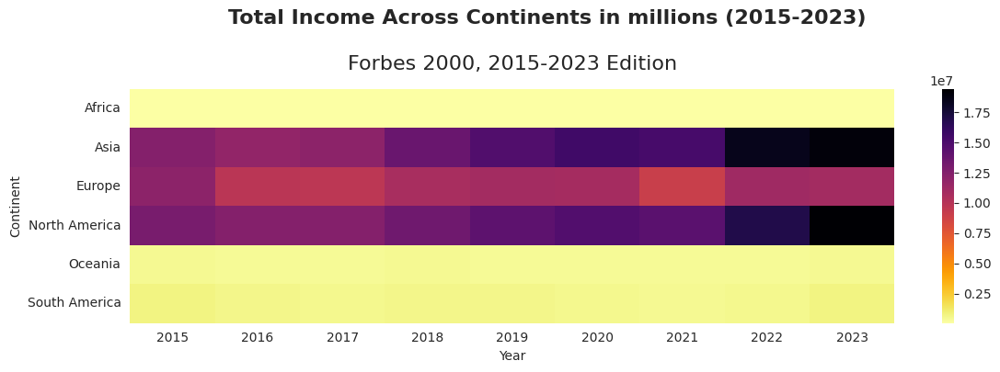

In [ ]:
# Create the heatmap
fig, ax = plt.subplots(figsize=(12, 4))
sns.heatmap(
    pd.crosstab(df_part_2.Continente, df_part_2.Año, values=df_part_2.Ingresos, aggfunc='sum').round(0),
    cmap="inferno_r",
    cbar=True,
    fmt='.0f')  # Set the format to avoid scientific notation

# Add labels and title
ax.set_xlabel('Year')
ax.set_ylabel('Continent')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle("Total Income Across Continents in millions (2015-2023)", y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()

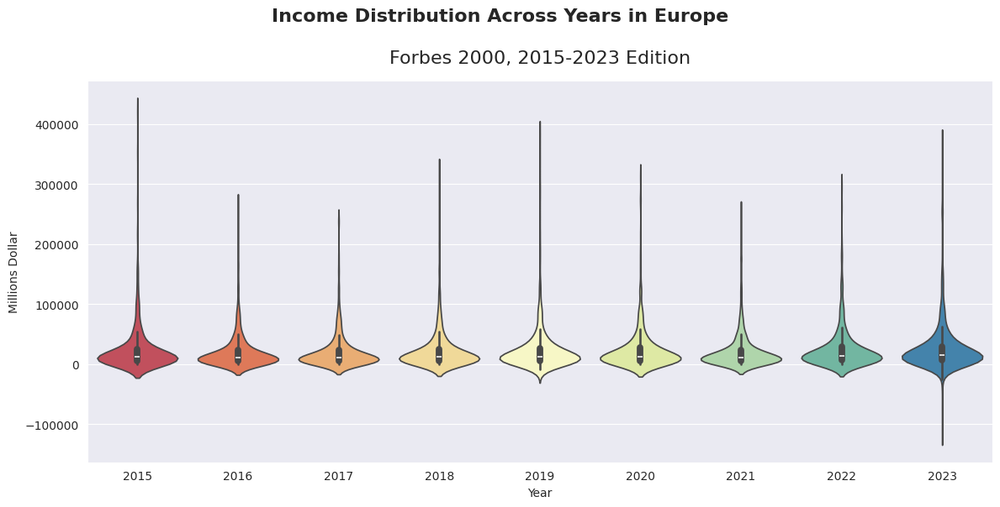

In [ ]:
# Calculate medians for each year
medians = df_part_2[df_part_2['Continente'] == 'Europe'].groupby('Año')['Ingresos'].median()
sns.set_style('darkgrid')
# Create violin plot
fig, ax = plt.subplots(figsize=(12, 6))
sns.violinplot(data=df_part_2[df_part_2['Continente'] == 'Europe'], y='Ingresos', x='Año', palette='Spectral')

# Add labels and title
ax.set_xlabel('Year')
ax.set_ylabel('Millions Dollar')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle("Income Distribution Across Years in Europe", y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()

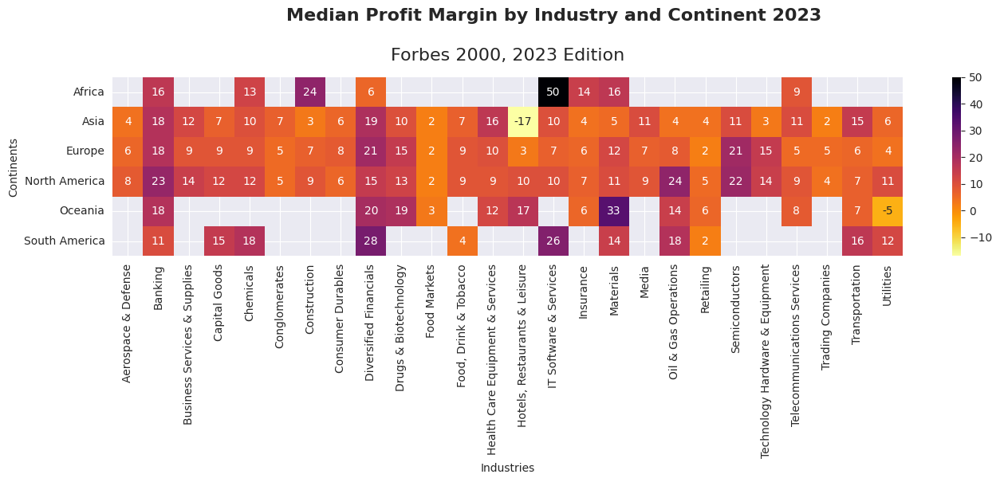

In [ ]:
# Create the heatmap
sns.set_style('darkgrid')
fig, ax = plt.subplots(figsize=(14, 6))

sns.heatmap(
    pd.crosstab(df_part_2.Continente, df_part_2.Industria, values=df_part_2[df_part_2.Año==2023]['Margen de Rentabilidad'], aggfunc='median').round(0),
    cmap="inferno_r",
    annot=True,
    cbar=True
)

# Add labels and title
ax.set_xlabel('Industries')
ax.set_ylabel('Continents')
ax.set_title('Forbes 2000, 2023 Edition', fontsize=16, pad=15)
fig.suptitle("Median Profit Margin by Industry and Continent 2023", y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()

## 6.5 Europe

In [ ]:
df_europe = df_part_2.loc[df_part_2.Continente=='Europe']

In [ ]:
european_countries = df_europe.Pais.unique()

In [ ]:
df_diversified = pd.DataFrame(columns=['pais','numero de empresas','numero de industrias','numero de años','industria n.1','participacion industria n.1'])
for country in european_countries:
  df_country=df_europe.loc[df_europe.Pais==country].groupby(['Empresa','Industria'])['Año'].count().sort_values(ascending=False).reset_index()
  number_companies=df_country.shape[0]
  number_industries= df_country.Industria.nunique()
  number_of_years =df_country.Año.sum()
  best_industry= df_country.Industria.value_counts().reset_index()['index'].head(1).values[0]
  number_of_companies_best_industry= df_country.Industria.value_counts().reset_index()['Industria'].head(1).values[0]
  participation_industry= int(round(number_of_companies_best_industry/number_companies,2)*100)
  new_row = {'pais':country,'numero de empresas':number_companies,'numero de industrias':number_industries,'numero de años': number_of_years,'industria n.1':best_industry,'participacion industria n.1':participation_industry}

  df_diversified = df_diversified.append(new_row, ignore_index=True)

df_diversified.head()

,pais,numero de empresas,numero de industrias,numero de años,industria n.1,participacion industria n.1
0,Netherlands,55,22,212,Insurance,9
1,Germany,100,23,471,Consumer Durables,17
2,United Kingdom,157,25,725,Diversified Financials,16
3,Russia,43,11,197,Materials,23
4,France,97,24,512,Consumer Durables,14


In [ ]:
df_diversified=df_diversified.sort_values(by='numero de años',ascending=False).reset_index(drop=True)


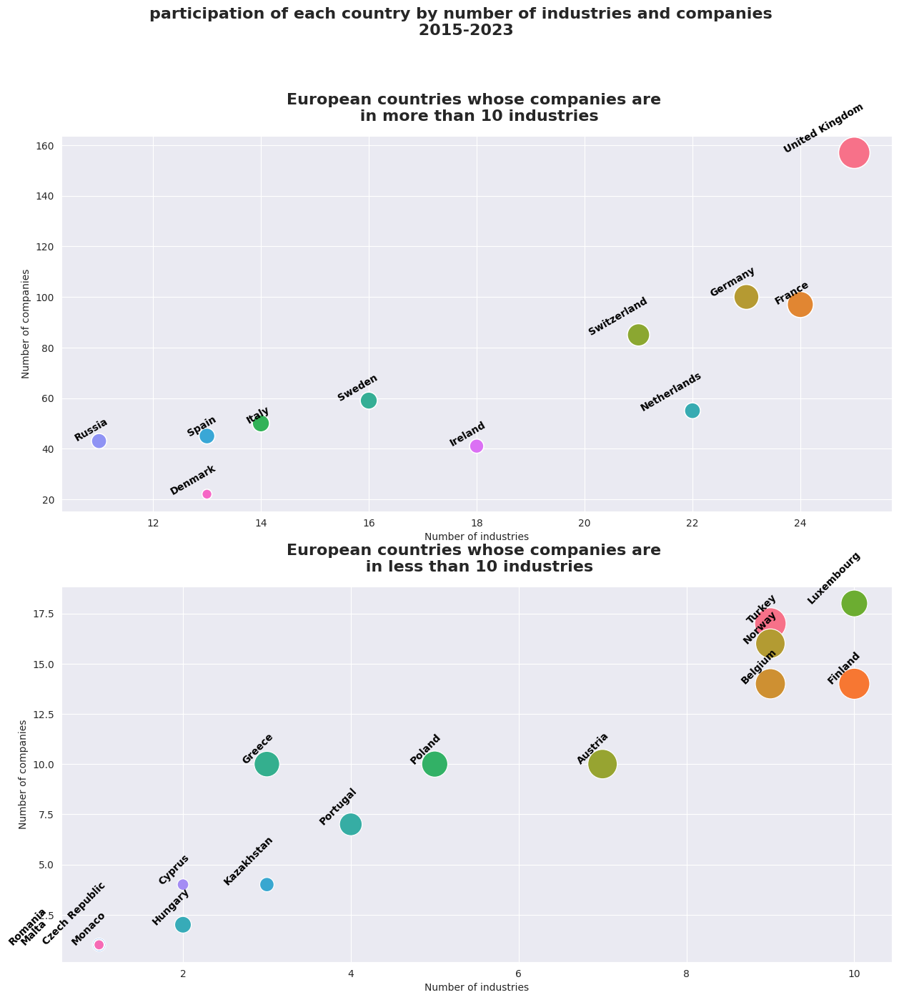

In [ ]:
fig,axes =plt.subplots(2,1,figsize=(15,15))
fig.suptitle('participation of each country by number of industries and companies \n 2015-2023', y=1, fontsize=16,weight='bold')
sns.scatterplot( data=df_diversified.head(11), y="numero de empresas", x="numero de industrias", hue="pais", size="numero de años",sizes=(100,1000),legend=False,ax=axes[0])
axes[0].set_title('European countries whose companies are \n in more than 10 industries', fontsize=16, pad=15,weight='bold')
axes[0].set_xlabel('Number of industries')
axes[0].set_ylabel('Number of companies')
for line in range(0, df_diversified.head(11).shape[0]):
    axes[0].text(df_diversified.head(11)["numero de industrias"][line] + 0.2,
                 df_diversified.head(11)["numero de empresas"][line],
                 df_diversified.head(11)["pais"][line],
                 horizontalalignment='right',
                 size='medium',
                 color='black',
                 weight='semibold',
                 rotation=30)

sns.scatterplot( data=df_diversified.tail(16), y="numero de empresas", x="numero de industrias", hue="pais", size="numero de años",sizes=(100,1000),legend=False,ax=axes[1])
axes[1].set_title('European countries whose companies are \n in less than 10 industries', fontsize=16, pad=15,weight='bold')
axes[1].set_xlabel('Number of industries')
axes[1].set_ylabel('Number of companies')
for line in range(11, df_diversified.tail(16).shape[0]+11):
    if (line < 25):
      axes[1].text(df_diversified.tail(16)["numero de industrias"][line] + 0.1,
                  df_diversified.tail(16)["numero de empresas"][line],
                  df_diversified.tail(16)["pais"][line],
                  horizontalalignment='right',
                  size='medium',
                  color='black',
                  weight='semibold',
                  rotation=45)
    else:
      axes[1].text(df_diversified.tail(16)["numero de industrias"][line]-0.6,
                  df_diversified.tail(16)["numero de empresas"][line],
                  df_diversified.tail(16)["pais"][line],
                  horizontalalignment='right',
                  size='medium',
                  color='black',
                  weight='semibold',
                  rotation=45)
plt.show()

In [ ]:
df_diversified.head()

,pais,numero de empresas,numero de industrias,numero de años,industria n.1,participacion industria n.1
0,United Kingdom,157,25,725,Diversified Financials,16
1,France,97,24,512,Consumer Durables,14
2,Germany,100,23,471,Consumer Durables,17
3,Switzerland,85,21,385,Banking,15
4,Italy,50,14,240,Banking,40


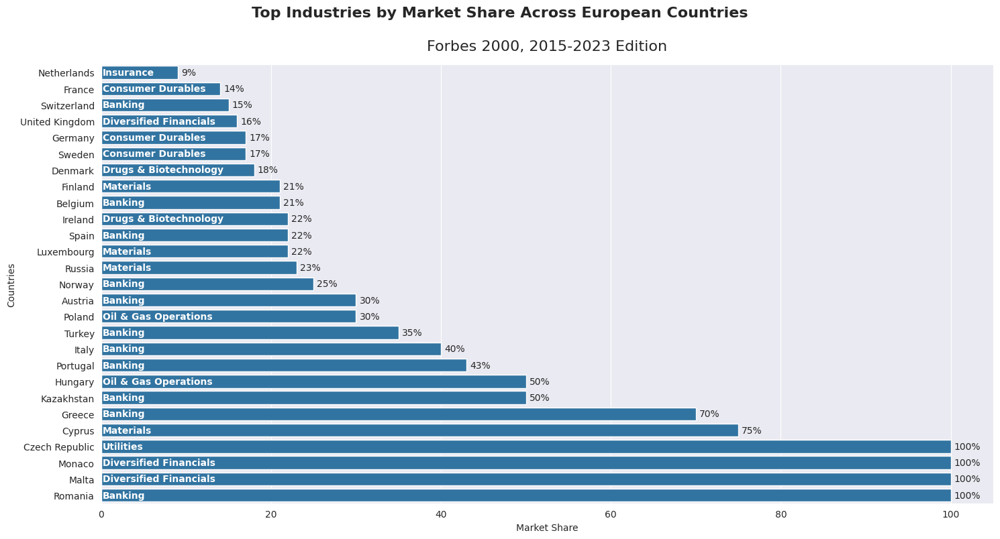

In [ ]:
fig,ax =plt.subplots(figsize=(15,8))
sns.barplot(data=df_diversified.sort_values(by='participacion industria n.1'),x='participacion industria n.1',y='pais')

# Add number labels at the end of each bar
for i, value in enumerate(df_diversified.sort_values(by='participacion industria n.1')['industria n.1'].values):
    ax.text(0.2, i, f'{value}', va='center',color='white',fontsize=10,weight='bold')

for i, value in enumerate(df_diversified.sort_values(by='participacion industria n.1')['participacion industria n.1'].values):
    ax.text(value+0.4, i, f'{value}%', va='center')

# Add labels and title
ax.set_xlabel('Market Share')
ax.set_ylabel('Countries')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle("Top Industries by Market Share Across European Countries", y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()




## 6.5 Italy

In [ ]:
italy_df=df_part_2.loc[df_part_2.Pais=='Italy']
italy_df.Industria.value_counts()

Banking                        93
Insurance                      40
Utilities                      28
Oil & Gas Operations           21
Consumer Durables              17
Telecommunications Services     9
Aerospace & Defense             9
Transportation                  8
Retailing                       4
Capital Goods                   4
Diversified Financials          3
IT Software & Services          2
Media                           1
Construction                    1
Name: Industria, dtype: int64

In [ ]:
numero_empresas_italianas_per_industria = italy_df.groupby(['Empresa','Industria'])['Año'].count().sort_values(ascending=False).reset_index().Industria.value_counts().reset_index()

In [ ]:
numero_empresas_italianas_per_industria.head()

,index,Industria
0,Banking,20
1,Insurance,6
2,Utilities,5
3,Consumer Durables,5
4,Oil & Gas Operations,4


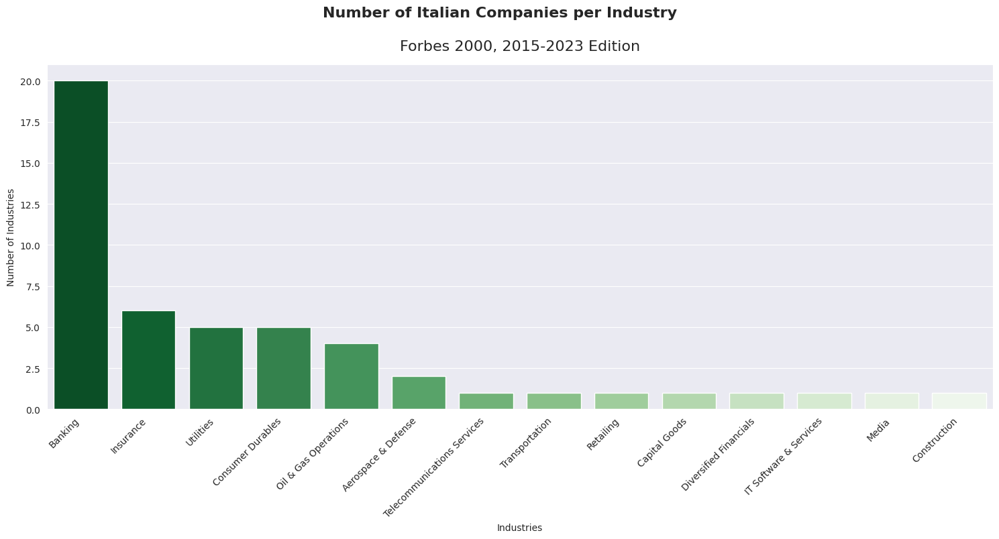

In [ ]:
fig,ax =plt.subplots(figsize=(15,8))

sns.barplot(data=numero_empresas_italianas_per_industria,x='index',y='Industria',palette="Greens_r")
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')

# Add labels and title
ax.set_xlabel('Industries')
ax.set_ylabel('Number of Industries')
ax.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=15)
fig.suptitle("Number of Italian Companies per Industry", y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()

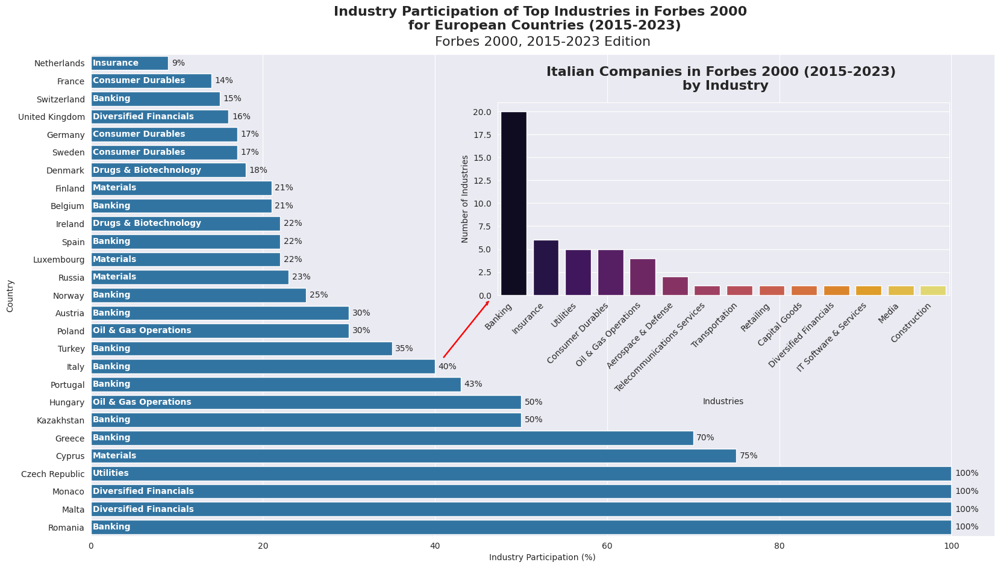

In [ ]:
fig = plt.figure(figsize=(15,8))
ax1 = fig.add_axes([0,0,1,1])
ax2= fig.add_axes([0.45,0.5,0.5,0.4])
ax1.grid(True)

ax1.arrow(41, 16.5, 5, -3,
          head_width = 0.2,
          width = 0.05,
          ec ='red')

sns.barplot(data=df_diversified.sort_values(by='participacion industria n.1'),x='participacion industria n.1',y='pais',ax=ax1)

# Add number labels at the end of each bar
for i, value in enumerate(df_diversified.sort_values(by='participacion industria n.1')['industria n.1'].values):
    ax1.text(0.2, i, f'{value}', va='center',color='white',fontsize=10,weight='bold')

for i, value in enumerate(df_diversified.sort_values(by='participacion industria n.1')['participacion industria n.1'].values):
    ax1.text(value+0.4, i, f'{value}%', va='center')

# Add labels and title
ax1.set_xlabel('Industry Participation (%)')
ax1.set_ylabel('Country')
ax1.set_title('Forbes 2000, 2015-2023 Edition', fontsize=16, pad=10)
fig.suptitle("Industry Participation of Top Industries in Forbes 2000 \n for European Countries (2015-2023)", y=1.1, fontsize=16,weight='bold')
plt.tight_layout()

ax2.grid(True)
sns.barplot(data=numero_empresas_italianas_per_industria,x='index',y='Industria',palette="inferno",ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=45, horizontalalignment='right')

# Add labels and title
ax2.set_xlabel('Industries')
ax2.set_ylabel('Number of Industries')
ax2.set_title("Italian Companies in Forbes 2000 (2015-2023) \n by Industry", fontsize=16, pad=15,weight='bold')


plt.show()

In [ ]:
query=df_europe[df_europe.Año==2023].groupby('Pais')['Ingresos'].sum().rename('Total Ingresos').sort_values(ascending=False).reset_index()
query['Total Ingresos']=round(query['Total Ingresos']/1000,2)
query.head(10)

,Pais,Total Ingresos
0,Germany,2328.70
1,France,2035.12
2,United Kingdom,1684.15
3,Switzerland,951.49
4,Italy,636.80
5,Netherlands,546.22
6,Spain,522.54
7,Ireland,363.90
8,Sweden,283.14
9,Finland,230.40


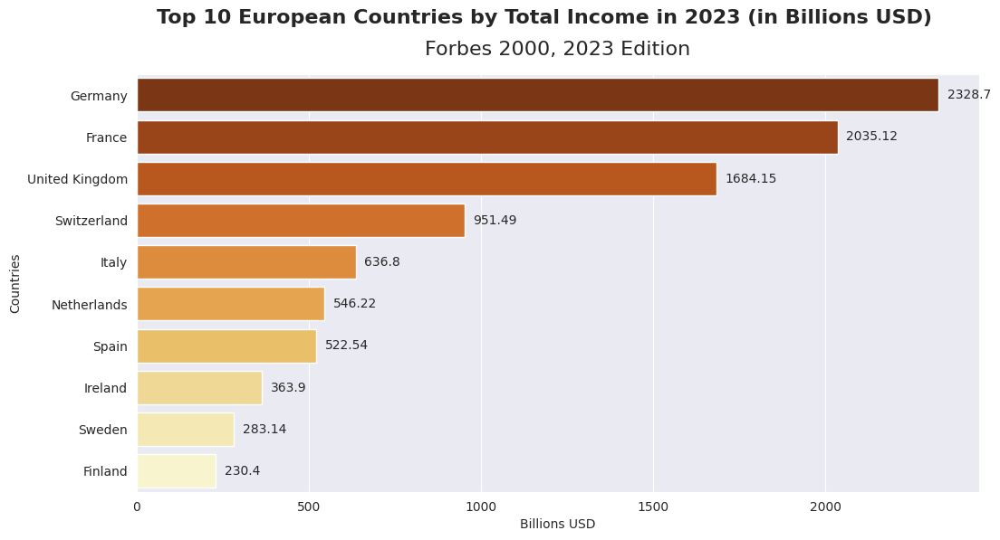

In [ ]:
# Create a bar plot using Seaborn with the custom color list
fig, ax = plt.subplots(figsize=(12, 6))
sns.set_style('darkgrid')
sns.barplot(y='Pais',x='Total Ingresos', data=query.head(10), palette="YlOrBr_r", ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(query['Total Ingresos'].head(10)):
    ax.text(value+25, i, f'{value}', va='center')

# Add labels and title
ax.set_xlabel('Billions USD')
ax.set_ylabel('Countries')
ax.set_title('Forbes 2000, 2023 Edition', fontsize=16, pad=15)
fig.suptitle("Top 10 European Countries by Total Income in 2023 (in Billions USD)", y=1, fontsize=16,weight='bold')


# Show the plot
plt.show()

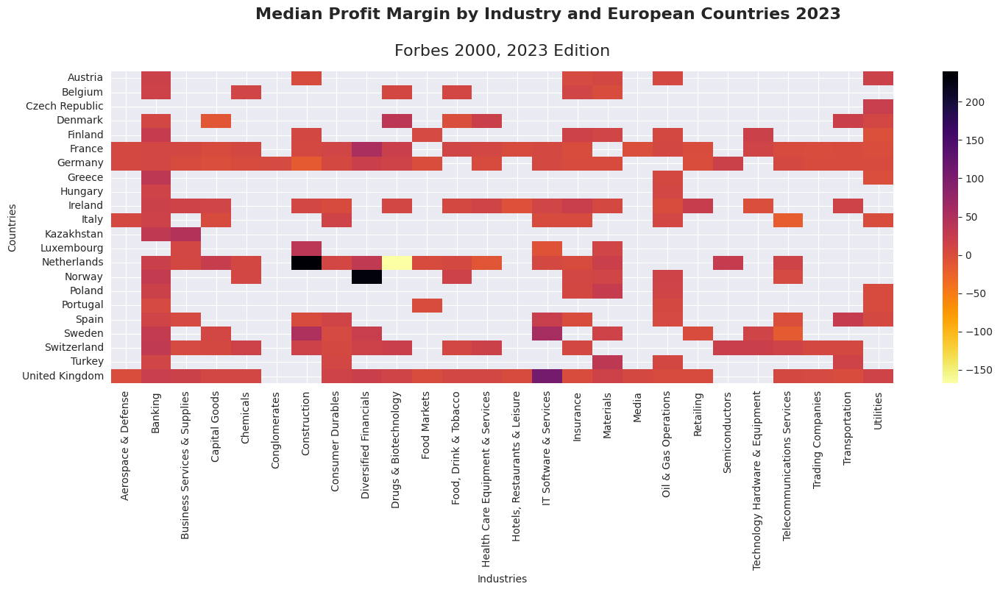

In [ ]:
# Create the heatmap
sns.set_style('darkgrid')
fig, ax = plt.subplots(figsize=(15, 8))

sns.heatmap(
    pd.crosstab(df_europe.Pais, df_part_2.Industria, values=df_europe[df_europe.Año==2023]['Margen de Rentabilidad'], aggfunc='median').round(0),
    cmap="inferno_r",
    annot=False,
    cbar=True
)

# Add labels and title
ax.set_xlabel('Industries')
ax.set_ylabel('Countries')
ax.set_title('Forbes 2000, 2023 Edition', fontsize=16, pad=15)
fig.suptitle("Median Profit Margin by Industry and European Countries 2023", y=1, fontsize=16,weight='bold')
plt.tight_layout()

plt.show()

<Axes: xlabel='Año', ylabel='Margen de Rentabilidad'>

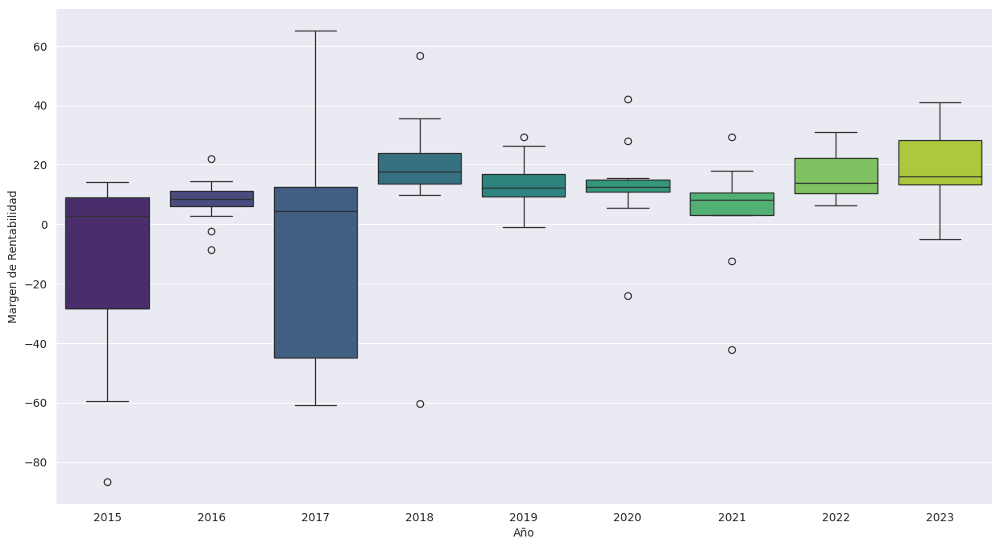

In [ ]:
fig, axes = plt.subplots(figsize=(15,8))
sns.boxplot(italy_df.loc[italy_df.Industria=='Banking'],y='Margen de Rentabilidad',x='Año',palette='viridis')


<Axes: xlabel='Año', ylabel='Margen de Rentabilidad'>

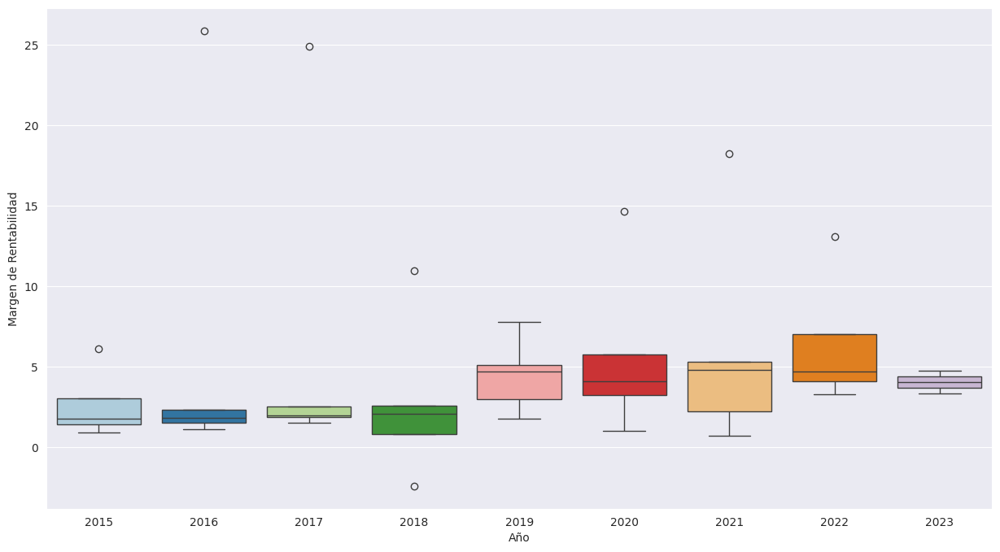

In [ ]:

fig, axes = plt.subplots(figsize=(15,8))
sns.boxplot(italy_df.loc[italy_df.Industria=='Insurance'],y='Margen de Rentabilidad',x='Año',palette="Paired")

In [ ]:
df_part_2.loc[(df_part_2.Continente=='Europe')&(df_part_2.Industria.isin(['Insurance']))].Pais.value_counts()

United Kingdom    74
Switzerland       55
Italy             40
Germany           36
Netherlands       29
France            26
Austria           18
Norway            16
Spain              9
Finland            9
Poland             9
Ireland            7
Belgium            7
Denmark            1
Name: Pais, dtype: int64

<Axes: xlabel='Año', ylabel='Margen de Rentabilidad'>

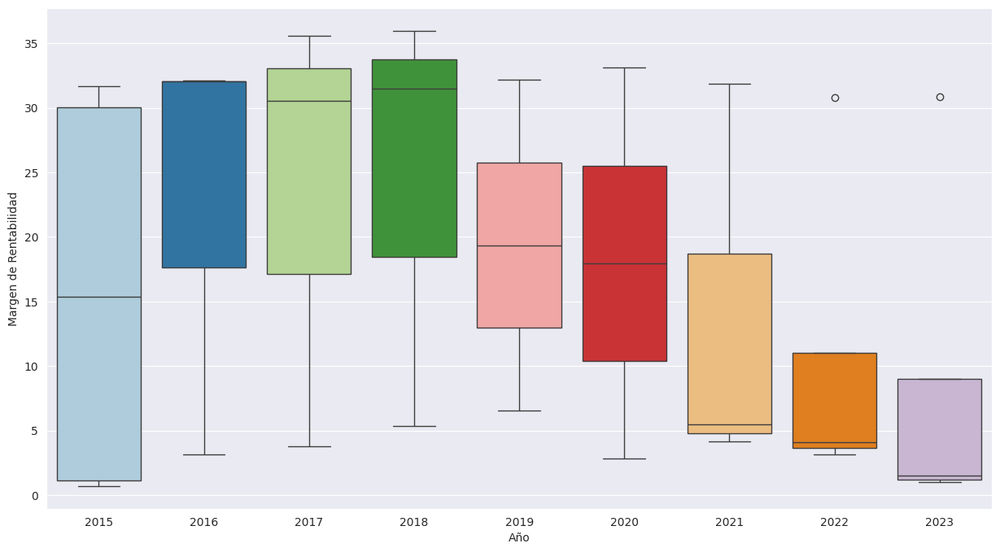

In [ ]:
fig, axes = plt.subplots(figsize=(15,8))
sns.boxplot(italy_df.loc[italy_df.Industria=='Utilities'],y='Margen de Rentabilidad',x='Año',palette="Paired")

In [ ]:
df_part_2.loc[(df_part_2.Continente=='Europe')&(df_part_2.Industria.isin(['Utilities']))].Pais.value_counts()

Germany           30
Italy             28
United Kingdom    27
France            26
Russia            22
Spain             18
Portugal           9
Finland            9
Czech Republic     9
Poland             9
Austria            6
Greece             4
Switzerland        1
Denmark            1
Name: Pais, dtype: int64

---
# 7. Bubble plot
---



In [ ]:
figure = bubbleplot(dataset=df_part_2,x_column='Ingresos', y_column='Ganancias',
                    bubble_column='Empresa', time_column='Año', size_column='Activos',
                    color_column='Industria', x_title="Ingresos", y_title="Ganancias",
                    title='Global indicador', scale_bubble=1, height=650)

# Convert plot to HTML
html_plot = go.Figure(figure).to_html(full_html=False, include_plotlyjs='cdn')

# Display HTML in Colab
HTML(html_plot)

---
# 8. Insights - 2
---



## 8.1 By number of companies

In [ ]:
df_helper = df_part_2.copy()
df_helper.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente
0,1,ICBC,Banking,China,166796.0,44757.2,3322043.0,278327.0,26.83,1.35,2015,CHN,Asia
1,2,China Construction Bank,Banking,China,130473.0,37038.9,2698925.0,212945.0,28.39,1.37,2015,CHN,Asia
2,3,Agricultural Bank of China,Banking,China,129221.0,29124.5,2574815.0,189879.0,22.54,1.13,2015,CHN,Asia
3,4,Bank of China,Banking,China,120297.0,27526.8,2458336.0,199130.0,22.88,1.12,2015,CHN,Asia
4,5,Berkshire Hathaway,Diversified Financials,United States,194673.0,19872.0,534618.0,354813.0,10.21,3.72,2015,USA,North America


In [ ]:
company_and_country_count_by_year=df_helper.groupby(['Empresa','Pais'])['Año'].count().sort_values(ascending=False).reset_index()

In [ ]:
company_and_country_count_by_year.head()

,Empresa,Pais,Año
0,Johnson Matthey,United Kingdom,9
1,Shinhan Financial Group,South Korea,9
2,Sherwin-Williams,United States,9
3,Shiga Bank,Japan,9
4,Shimizu,Japan,9


In [ ]:
df_hist_year=company_and_country_count_by_year.Año.value_counts().reset_index().rename(columns={'index':'number of years','Año':'Count'})

In [ ]:
df_hist_year

,number of years,Count
0,9,1001
1,1,715
2,2,468
3,4,317
4,3,281
5,5,264
6,7,197
7,8,189
8,6,169


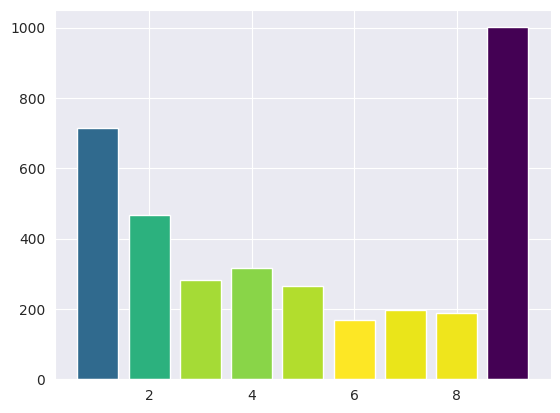

In [ ]:
# Define the colormap and rescale function
my_cmap = plt.get_cmap("viridis_r")
rescale = lambda y: (y - np.min(y)) / (np.max(y) - np.min(y))

# Plot using plt.bar() with DataFrame columns
plt.bar(df_hist_year['number of years'], df_hist_year['Count'], color=my_cmap(rescale(df_hist_year['Count'])))
plt.show()

In [ ]:
plt.rcParams['xtick.top'] = False

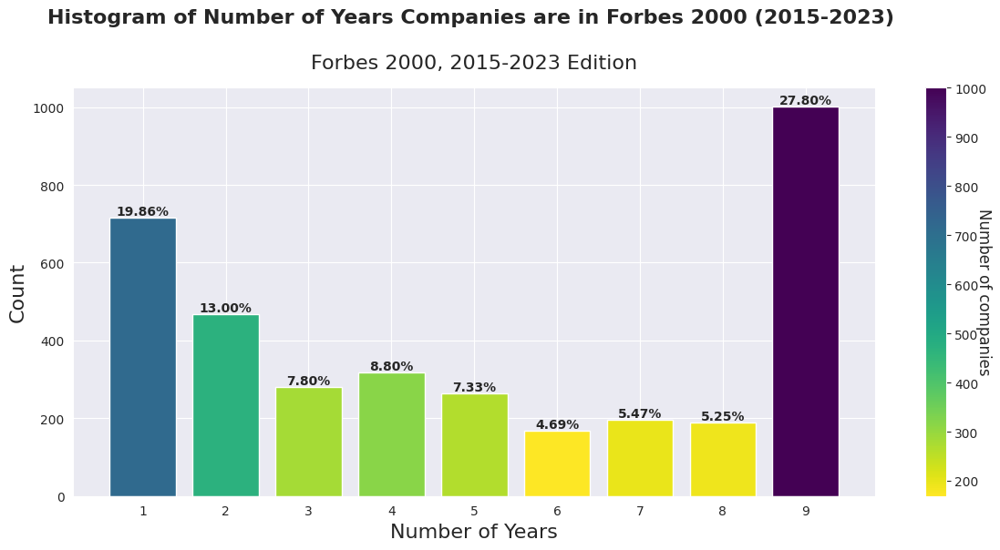

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))
# Define the colormap and rescale function
my_cmap = plt.get_cmap("viridis_r")
rescale = lambda y: (y - np.min(y)) / (np.max(y) - np.min(y))

# Plot using plt.bar() with DataFrame columns
bars = plt.bar(df_hist_year['number of years'], df_hist_year['Count'], color=my_cmap(rescale(df_hist_year['Count'])))

for bar in bars:
    height = bar.get_height()
    percentage = (height / df_hist_year['Count'].sum()) * 100
    plt.text(bar.get_x() + bar.get_width()/2., height, '%.2f%%' % percentage,
             ha='center', va='bottom',weight='bold')

plt.xlabel('Number of Years', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.xticks(np.arange(1, 10))
plt.suptitle('Histogram of Number of Years Companies are in Forbes 2000 (2015-2023)', fontsize=16, fontweight='bold', y=1,x=0.435)

# Add colorbar
norm = Normalize(vmin=df_hist_year['Count'].min(), vmax=df_hist_year['Count'].max())
sm = plt.cm.ScalarMappable(cmap=my_cmap, norm=norm)
sm.set_array([])  # necessary for ScalarMappable to work with bar plots
cbar = plt.colorbar(sm, ax=plt.gca(), pad=0.05)
cbar.set_label('Number of companies', rotation=270, fontsize=12)

plt.tight_layout()
plt.show()


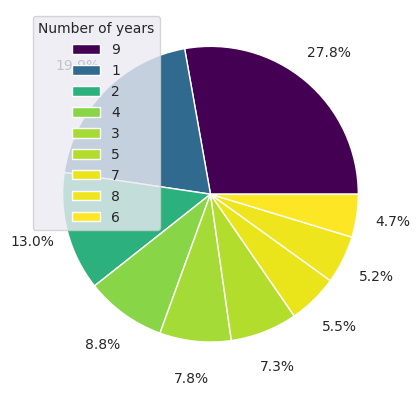

In [ ]:
fig, ax = plt.subplots()
ax.pie(df_hist_year['Count'], labels=df_hist_year['number of years'],
       colors=my_cmap(rescale(df_hist_year['Count'])), autopct='%1.1f%%', pctdistance=1.25,labeldistance=None)
plt.legend(title='Number of years')

In [ ]:
company_and_country_count_by_year.head()

,Empresa,Pais,Año
0,Johnson Matthey,United Kingdom,9
1,Shinhan Financial Group,South Korea,9
2,Sherwin-Williams,United States,9
3,Shiga Bank,Japan,9
4,Shimizu,Japan,9


In [ ]:
country_count_by_year=company_and_country_count_by_year[['Pais','Año']]

In [ ]:
country_count_by_year.Pais.value_counts().head(10).index

Index(['United States', 'China', 'Japan', 'United Kingdom', 'South Korea',
       'Hong Kong', 'Canada', 'Germany', 'France', 'India'],
      dtype='object')

In [ ]:
country_count_by_year_top_10=country_count_by_year.loc[country_count_by_year.Pais.isin(country_count_by_year.Pais.value_counts().head(10).index)]

In [ ]:
cross_tab_1=pd.crosstab(country_count_by_year_top_10.Pais,country_count_by_year_top_10.Año).reindex(country_count_by_year.Pais.value_counts().head(10).index)

In [ ]:
country_count_by_year.head()

,Pais,Año
0,United Kingdom,9
1,South Korea,9
2,United States,9
3,Japan,9
4,Japan,9


In [ ]:
top_10_countries_by_number_companies=df_helper.groupby('Pais')['Empresa'].nunique().sort_values(ascending=False).head(10).reset_index()


In [ ]:
top_10_countries_by_number_companies.head()

,Pais,Empresa
0,United States,1062
1,China,522
2,Japan,302
3,United Kingdom,153
4,South Korea,113


In [ ]:
number=[9,1,2,4,3,5,7,8,6]

colors=dict(zip(number,my_cmap(rescale((df_hist_year['Count'])))))

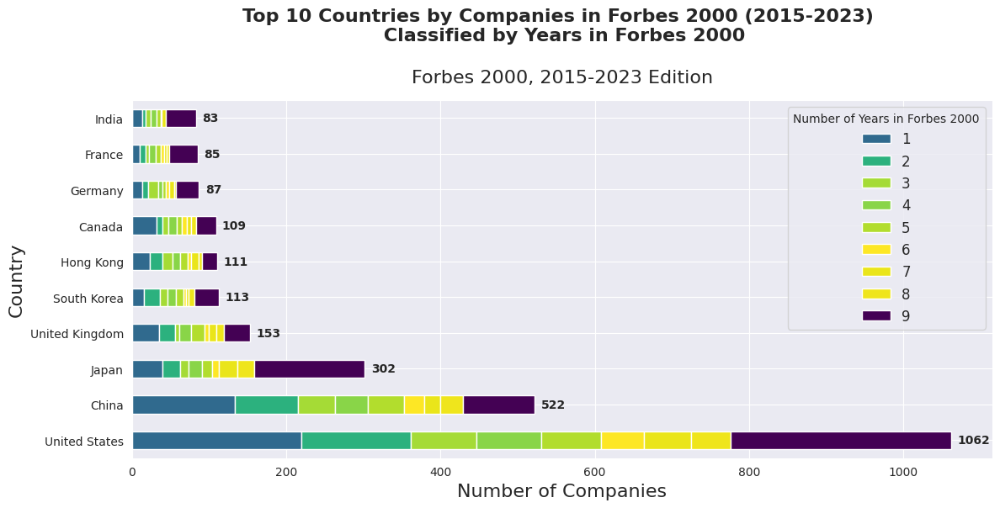

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

number=[9,1,2,4,3,5,7,8,6]
colors=dict(zip(number,my_cmap(rescale((df_hist_year['Count'])))))

cross_tab_1.plot(kind='barh', stacked=True,color=colors, ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(top_10_countries_by_number_companies['Empresa']):
    ax.text(value+8, i, f'{value}', va='center', weight='bold')

plt.legend(title='Number of Years in Forbes 2000', fontsize=12)
plt.xlabel('Number of Companies', fontsize=16)
plt.ylabel('Country', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 10 Countries by Companies in Forbes 2000 (2015-2023) \n Classified by Years in Forbes 2000", fontsize=16, fontweight='bold', y=1,x=0.56)

plt.tight_layout()
plt.show()


In [ ]:
company_count_by_year=company_and_country_count_by_year[['Empresa','Año']].rename(columns={'Año':'Numero de años'})

In [ ]:
company_count_by_year.head()

,Empresa,Numero de años
0,Johnson Matthey,9
1,Shinhan Financial Group,9
2,Sherwin-Williams,9
3,Shiga Bank,9
4,Shimizu,9


In [ ]:
for index, row in company_count_by_year.iterrows():
  df_helper.loc[df_helper.Empresa==row.Empresa,'Numero de años']=row['Numero de años']

In [ ]:
df_helper['Numero de años'].value_counts()

9.0    9009
8.0    1368
4.0    1281
7.0    1274
5.0    1235
2.0    1025
6.0     990
1.0     971
3.0     843
Name: Numero de años, dtype: int64

In [ ]:
number_of_companies_by_year_and_number_of_years=df_helper.groupby(by=['Año','Numero de años'])['Empresa'].count().rename('Numero de Empresas').reset_index()

In [ ]:
number_of_companies_by_year_and_number_of_years.head()

,Año,Numero de años,Numero de Empresas
0,2015,1.0,198
1,2015,2.0,165
2,2015,3.0,111
3,2015,4.0,160
4,2015,5.0,88


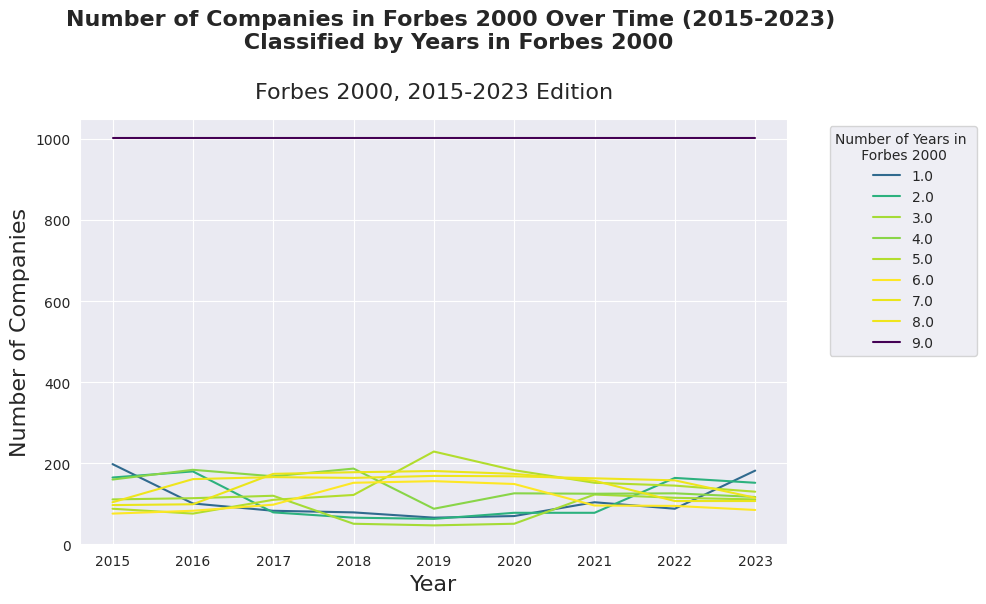

In [ ]:
fig,ax = plt.subplots(figsize=(10,6))
sns.lineplot(data=number_of_companies_by_year_and_number_of_years,x='Año',y='Numero de Empresas',hue='Numero de años',palette=colors)

plt.legend(title='Number of Years in \n      Forbes 2000', bbox_to_anchor=(1.05, 1.0), loc='upper left')
#plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Number of Companies', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Number of Companies in Forbes 2000 Over Time (2015-2023) \n Classified by Years in Forbes 2000", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

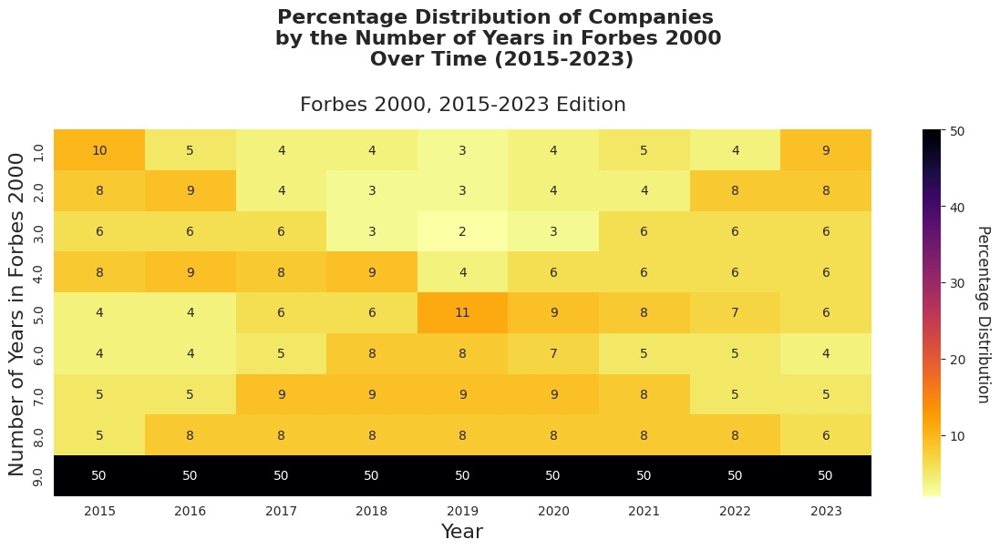

In [ ]:
fig,ax = plt.subplots(figsize=(12,6))

ax=sns.heatmap(pd.crosstab(number_of_companies_by_year_and_number_of_years['Numero de años'],
            number_of_companies_by_year_and_number_of_years['Año'],
            values=number_of_companies_by_year_and_number_of_years['Numero de Empresas'],
            aggfunc='sum',normalize='columns').round(2)*100,cmap="inferno_r", annot=True, cbar=True)

ax.collections[0].colorbar.set_label('Percentage Distribution', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Number of Years in Forbes 2000', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Percentage Distribution of Companies \n by the Number of Years in Forbes 2000 \n Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

In [ ]:
colors_without_9 = colors.copy()

del colors_without_9 [9]

In [ ]:
colors_without_9

{1: array([0.187231, 0.414746, 0.556547, 1.      ]),
 2: array([0.170948, 0.694384, 0.493803, 1.      ]),
 4: array([0.535621, 0.835785, 0.281908, 1.      ]),
 3: array([0.647257, 0.8584  , 0.209861, 1.      ]),
 5: array([0.699415, 0.867117, 0.175971, 1.      ]),
 7: array([0.916242, 0.896091, 0.100717, 1.      ]),
 8: array([0.935904, 0.89857 , 0.108131, 1.      ]),
 6: array([0.993248, 0.906157, 0.143936, 1.      ])}

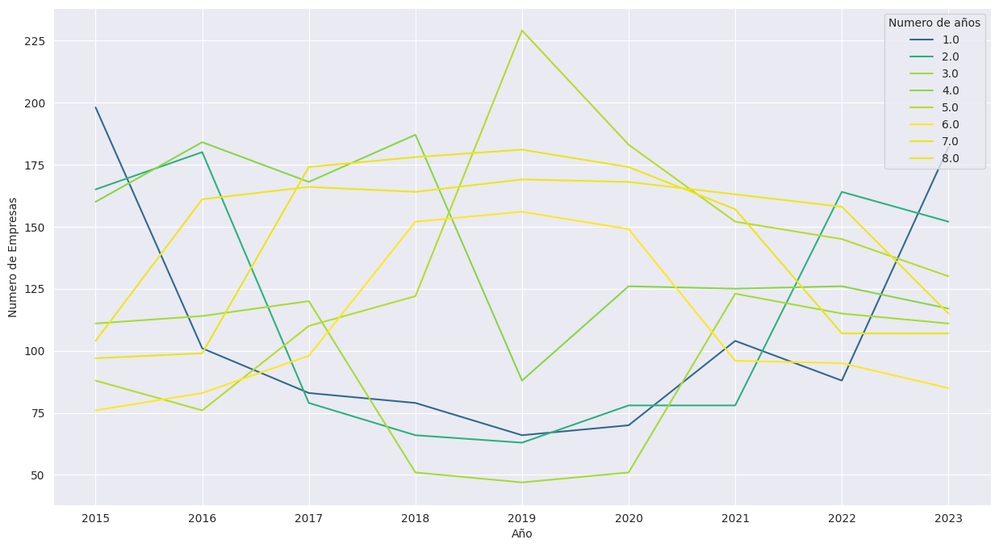

In [ ]:
fig,ax = plt.subplots(figsize=(15,8))
sns.lineplot(data=number_of_companies_by_year_and_number_of_years[number_of_companies_by_year_and_number_of_years['Numero de años']!=9],x='Año',y='Numero de Empresas',hue='Numero de años',palette=colors_without_9)

plt.show()

## 8.2 By income

In [ ]:
total_revenue_by_year_and_number_of_years=df_helper.groupby(by=['Año','Numero de años'])['Ingresos'].median().rename('Total Ingresos').reset_index()

In [ ]:
total_revenue_by_year_and_number_of_years.head()

,Año,Numero de años,Total Ingresos
0,2015,1.0,5649.0
1,2015,2.0,6170.0
2,2015,3.0,6777.0
3,2015,4.0,8285.5
4,2015,5.0,7570.0


In [ ]:
total_revenue_by_year_and_number_of_years['Total Ingresos']= total_revenue_by_year_and_number_of_years['Total Ingresos']/1000

In [ ]:
total_revenue_by_year_and_number_of_years.head()

,Año,Numero de años,Total Ingresos
0,2015,1.0,5.6490
1,2015,2.0,6.1700
2,2015,3.0,6.7770
3,2015,4.0,8.2855
4,2015,5.0,7.5700


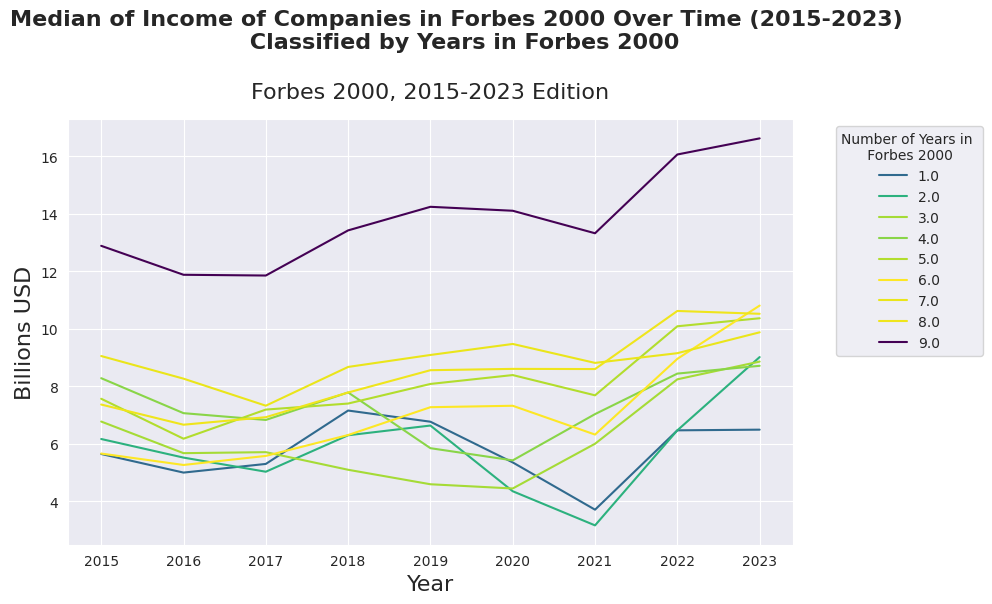

In [ ]:
fig,ax = plt.subplots(figsize=(10,6))
sns.lineplot(data=total_revenue_by_year_and_number_of_years,x='Año',y='Total Ingresos',hue='Numero de años',palette=colors)

plt.legend(title='Number of Years in \n      Forbes 2000',bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Billions USD', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Median of Income of Companies in Forbes 2000 Over Time (2015-2023) \n Classified by Years in Forbes 2000", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

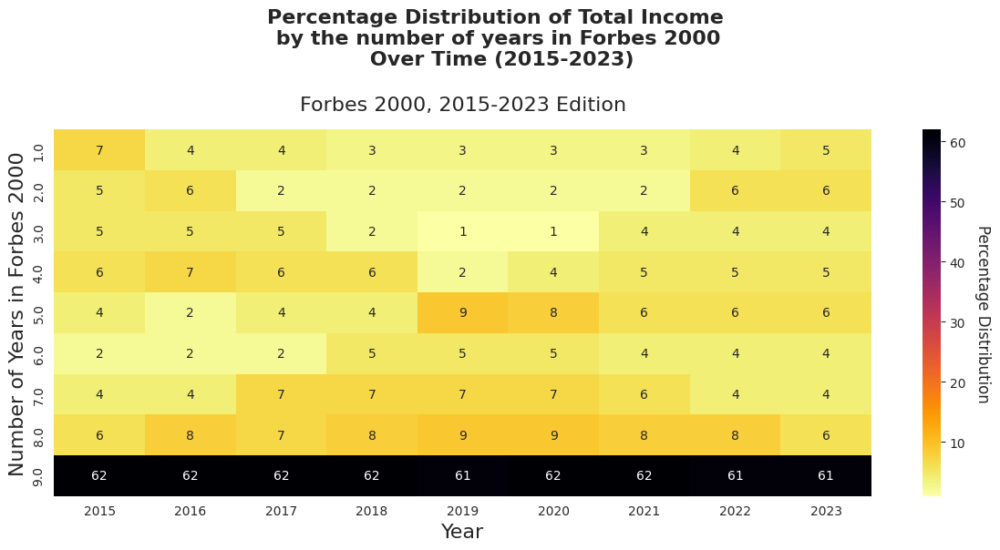

In [ ]:
fig,ax = plt.subplots(figsize=(12,6))

ax=sns.heatmap(pd.crosstab(df_helper['Numero de años'],
            df_helper['Año'],
            values=df_helper['Ingresos'],
            aggfunc='sum',
            normalize='columns').round(2)*100,
            cmap="inferno_r",
            annot=True,
            cbar=True)

ax.collections[0].colorbar.set_label('Percentage Distribution', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Number of Years in Forbes 2000', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Percentage Distribution of Total Income \n by the number of years in Forbes 2000 \n Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

## 8.3 By industry - part 1

In [ ]:
df_helper.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Numero de años
0,1,ICBC,Banking,China,166796.0,44757.2,3322043.0,278327.0,26.83,1.35,2015,CHN,Asia,9.0
1,2,China Construction Bank,Banking,China,130473.0,37038.9,2698925.0,212945.0,28.39,1.37,2015,CHN,Asia,9.0
2,3,Agricultural Bank of China,Banking,China,129221.0,29124.5,2574815.0,189879.0,22.54,1.13,2015,CHN,Asia,9.0
3,4,Bank of China,Banking,China,120297.0,27526.8,2458336.0,199130.0,22.88,1.12,2015,CHN,Asia,9.0
4,5,Berkshire Hathaway,Diversified Financials,United States,194673.0,19872.0,534618.0,354813.0,10.21,3.72,2015,USA,North America,9.0


In [ ]:
count_industry=df_helper.groupby(['Industria'])['Empresa'].nunique().sort_values(ascending=False).reset_index()
count_industry.head()

,Industria,Empresa
0,Banking,489
1,Diversified Financials,308
2,Consumer Durables,281
3,Construction,260
4,Oil & Gas Operations,224


In [ ]:
aux_3=df_helper.groupby(['Industria','Numero de años'])['Empresa'].nunique().rename('Numero de empresas').reset_index()
aux_3.head()

,Industria,Numero de años,Numero de empresas
0,Aerospace & Defense,1.0,9
1,Aerospace & Defense,2.0,7
2,Aerospace & Defense,3.0,3
3,Aerospace & Defense,4.0,4
4,Aerospace & Defense,5.0,2


In [ ]:
cross_tab_2=pd.crosstab(aux_3['Industria'],aux_3['Numero de años'],values=aux_3['Numero de empresas'],aggfunc='sum').reindex(df_helper.groupby(['Industria'])['Empresa'].nunique().sort_values(ascending=False).index)

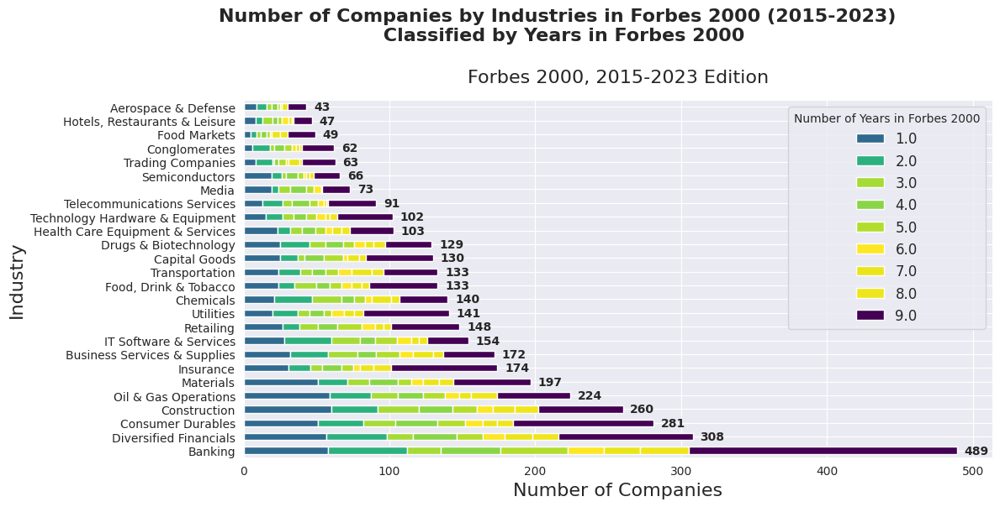

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

number=[9,1,2,4,3,5,7,8,6]
colors=dict(zip(number,my_cmap(rescale((df_hist_year['Count'])))))

cross_tab_2.plot(kind='barh', stacked=True,color=colors, ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(count_industry['Empresa']):
    ax.text(value+5, i, f'{value}', va='center', weight='bold')

plt.legend(title='Number of Years in Forbes 2000', fontsize=12)
plt.xlabel('Number of Companies', fontsize=16)
plt.ylabel('Industry', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Number of Companies by Industries in Forbes 2000 (2015-2023) \n Classified by Years in Forbes 2000", fontsize=16, fontweight='bold', y=1,x=0.56)

plt.tight_layout()
plt.show()

## 8.4 By country -  Companies  with Consistent Presence in Forbes 2000 (2015-2023)

In [ ]:
number_of_companies_by_country_group_9=df_helper[df_helper['Numero de años']==9].groupby(['Pais'])['Empresa'].nunique().sort_values(ascending=False).reset_index()

In [ ]:
number_of_companies_by_country_group_9.head()

,Pais,Empresa
0,United States,286
1,Japan,143
2,China,93
3,India,39
4,France,37


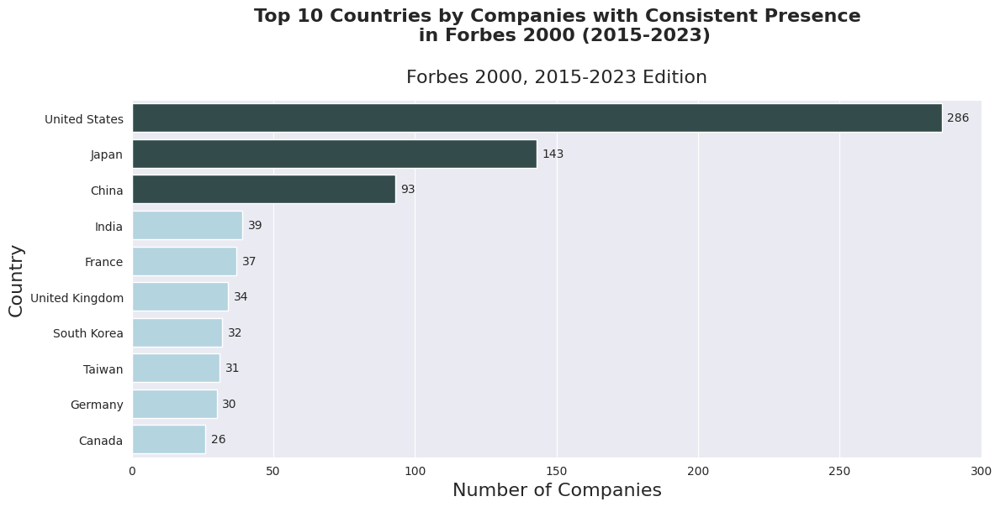

In [ ]:
# Create a custom color list
top_3 = number_of_companies_by_country_group_9[:3]
colors = ['darkslategrey' if country in top_3.Pais.values else 'lightblue' for country in number_of_companies_by_country_group_9.Pais.head(10)]

fig, ax = plt.subplots(figsize=(12, 6))
sns.barplot(data=number_of_companies_by_country_group_9.head(10),x='Empresa',y='Pais',palette=colors,ax=ax)

# Add number labels at the end of each bar
for i, value in enumerate(number_of_companies_by_country_group_9['Empresa'].head(10)):
    ax.text(value+2, i, f'{value}', va='center')

plt.xlabel('Number of Companies', fontsize=16)
plt.ylabel('Country', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 10 Countries by Companies with Consistent Presence \n in Forbes 2000 (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.56)

plt.tight_layout()
plt.show()

## 8.5 By industry - Companies with Consistent Presence in Forbes 2000 (2015-2023)

### 8.5.1 Count by industry

In [ ]:
top_5_companies_group_9_years_in_forbes=df_helper[df_helper['Numero de años']==9].groupby(['Industria'])['Empresa'].nunique().sort_values(ascending=False).index[:5]

In [ ]:
aux=df_helper[df_helper['Numero de años']==9].groupby(['Industria','Año'])['Empresa'].count().rename('Numero de empresas').reset_index()

In [ ]:
aux.head()

,Industria,Año,Numero de empresas
0,Aerospace & Defense,2015,8
1,Aerospace & Defense,2016,8
2,Aerospace & Defense,2017,9
3,Aerospace & Defense,2018,9
4,Aerospace & Defense,2019,9


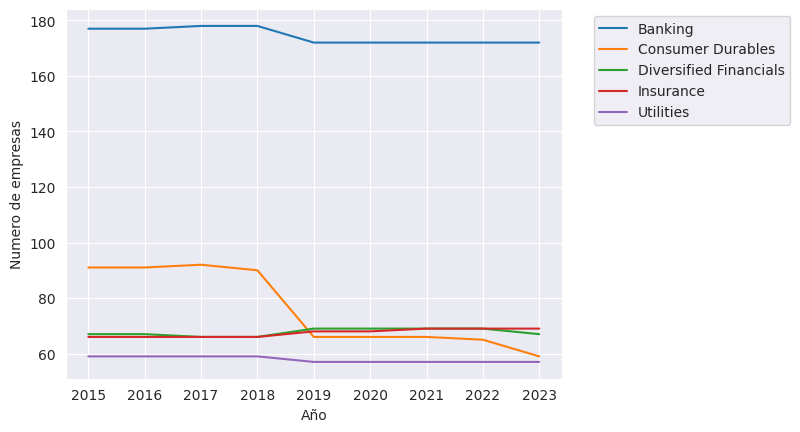

In [ ]:
sns.lineplot(data=aux[aux.Industria.isin(top_5_companies_group_9_years_in_forbes)],x='Año',y='Numero de empresas',hue='Industria')
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')

In [ ]:
pd.crosstab(aux['Industria'],
            aux['Año'],
            values=aux['Numero de empresas'],
            aggfunc='sum',
            normalize='columns').reindex(df_helper[df_helper['Numero de años']==9].groupby(['Industria'])['Empresa'].nunique().sort_values(ascending=False).index).head().round(2)*100

Año,2015,2016,2017,2018,2019,2020,2021,2022,2023
Industria,,,,,,,,,
Banking,18.0,18.0,18.0,18.0,17.0,17.0,17.0,17.0,17.0
Consumer Durables,9.0,9.0,9.0,9.0,7.0,7.0,7.0,6.0,6.0
Diversified Financials,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0
Insurance,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0
Utilities,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0


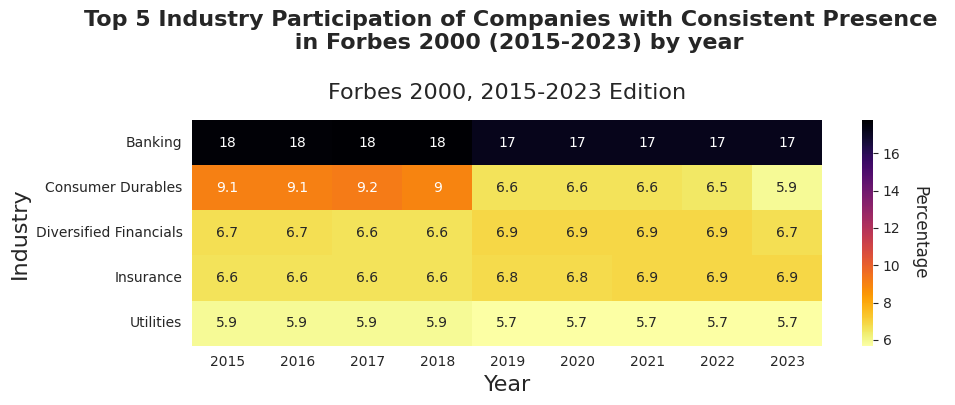

In [ ]:
fig,ax = plt.subplots(figsize=(10,4))

ax= sns.heatmap(pd.crosstab(aux['Industria'],
            aux['Año'],
            values=aux['Numero de empresas'],
            aggfunc='sum',
            normalize='columns').reindex(df_helper[df_helper['Numero de años']==9].groupby(['Industria'])['Empresa'].nunique().sort_values(ascending=False).index).head().round(4)*100,cmap="inferno_r",
            annot=True,
            cbar=True)
ax.collections[0].colorbar.set_label('Percentage', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Industry', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 5 Industry Participation of Companies with Consistent Presence \n in Forbes 2000 (2015-2023) by year", fontsize=16, fontweight='bold', y=1,x=0.52)

plt.tight_layout()
plt.show()

In [ ]:
df_9= df_helper[df_helper['Numero de años']==9]

In [ ]:
df_9.loc[(df_9.Industria=='Banking') & (df_9.Año==2018)]

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Numero de años
5998,1,ICBC,Banking,China,165338.0,43669.4,4210927.0,311014.0,26.41,1.04,2018,CHN,Asia,9.0
5999,2,China Construction Bank,Banking,China,143202.0,37203.1,3631583.0,261166.0,25.98,1.02,2018,CHN,Asia,9.0
6000,3,JPMorgan Chase,Banking,United States,118180.0,26496.0,2609785.0,387668.0,22.42,1.02,2018,USA,North America,9.0
6002,5,Agricultural Bank of China,Banking,China,129345.0,29638.7,3439314.0,184125.0,22.91,0.86,2018,CHN,Asia,9.0
6003,6,Bank of America,Banking,United States,102978.0,20294.0,2328478.0,313510.0,19.71,0.87,2018,USA,North America,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7821,1824,Basler Kantonalbank,Banking,Switzerland,748.0,153.2,41837.0,397.0,20.48,0.37,2018,CHE,Europe,9.0
7824,1827,Banque Centrale Populaire,Banking,Morocco,2707.0,292.9,41036.0,5682.0,10.82,0.71,2018,MAR,Africa,9.0
7845,1848,FIBI Holdings,Banking,Israel,1302.0,90.4,39117.0,883.0,6.94,0.23,2018,ISR,Asia,9.0
7854,1856,Luzerner Kantonalbank,Banking,Switzerland,642.0,207.7,38680.0,4678.0,32.35,0.54,2018,CHE,Europe,9.0


In [ ]:
df_9.loc[(df_9.Industria=='Banking') & (df_9.Año==2019)]

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Numero de años
7998,1,ICBC,Banking,China,175874.0,45223.0,4034482.0,305057.0,25.71,1.12,2019,CHN,Asia,9.0
8000,3,China Construction Bank,Banking,China,150313.0,38841.0,3382422.0,224988.0,25.84,1.15,2019,CHN,Asia,9.0
8001,4,Agricultural Bank of China,Banking,China,137456.0,30894.0,3293105.0,197045.0,22.48,0.94,2019,CHN,Asia,9.0
8002,5,Bank of America,Banking,United States,111904.0,28540.0,2377164.0,287339.0,25.50,1.20,2019,USA,North America,9.0
8005,8,Bank of China,Banking,China,126677.0,27500.0,3097612.0,142958.0,21.71,0.89,2019,CHN,Asia,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9848,1850,JB Financial Group,Banking,South Korea,2166.0,208.0,41925.0,961.0,9.60,0.50,2019,KOR,Asia,9.0
9852,1855,Banque Centrale Populaire,Banking,Morocco,2409.0,313.0,41422.0,5038.0,12.99,0.76,2019,MAR,Africa,9.0
9874,1877,Luzerner Kantonalbank,Banking,Switzerland,619.0,203.0,39728.0,3973.0,32.79,0.51,2019,CHE,Europe,9.0
9884,1886,Indian Bank,Banking,India,3030.0,203.0,38788.0,1838.0,6.70,0.52,2019,IND,Asia,9.0


In [ ]:
y = pd.merge(df_9.loc[(df_9.Industria=='Banking') & (df_9.Año==2018)]['Empresa'], df_9.loc[(df_9.Industria=='Banking') & (df_9.Año==2019)]['Empresa'], how='left', indicator=True)

In [ ]:
y._merge.unique()

['both', 'left_only']
Categories (3, object): ['left_only', 'right_only', 'both']

In [ ]:
y[y['_merge'] == 'left_only'].drop(columns='_merge').values

array([['JPMorgan Chase'],
       ['ING Group'],
       ['Citigroup'],
       ['FirstRand'],
       ['Kotak Mahindra Bank'],
       ['Navient']], dtype=object)

In [ ]:
for empresa in ['JPMorgan Chase',
       'ING Group',
       'Citigroup',
       'FirstRand',
       'Kotak Mahindra Bank',
       'Navient']:
  industry=  df_9.loc[(df_9.Empresa == empresa) & (df_9.Año==2019)]['Industria'].values[0]
  print(industry)

Diversified Financials
Diversified Financials
Diversified Financials
Diversified Financials
Diversified Financials
Diversified Financials


In [ ]:
df_9.loc[(df_9.Empresa == 'JPMorgan Chase') & (df_9.Año==2019)]['Industria'].values[0]

'Diversified Financials'

In [ ]:
y = pd.merge(df_9.loc[(df_9.Industria=='Consumer Durables') & (df_9.Año==2018)]['Empresa'], df_9.loc[(df_9.Industria=='Consumer Durables') & (df_9.Año==2019)]['Empresa'], how='left', indicator=True)

In [ ]:
y[y['_merge'] == 'left_only'].drop(columns='_merge').values

array([['Hitachi'],
       ['Inditex'],
       ['Hyundai Mobis'],
       ['TJX Cos'],
       ['BOE Technology Group'],
       ['TE Connectivity'],
       ['Fast Retailing'],
       ['Sumitomo Electric'],
       ['Kyocera'],
       ['Murata Manufacturing'],
       ['Ross Stores'],
       ['LG Display'],
       ['Keyence'],
       ['Hikvision'],
       ['TDK'],
       ['Gap'],
       ['NEC'],
       ['Amphenol'],
       ['Pegatron'],
       ['Hoya'],
       ['Samsung SDI'],
       ['Arrow Electronics'],
       ['Delta Electronics'],
       ['Jabil Circuit'],
       ['Rexel'],
       ['Avnet'],
       ['WPG Holdings'],
       ['Agilent Technologies']], dtype=object)

In [ ]:
for empresa in ['Hitachi',
       'Inditex',
       'Hyundai Mobis',
       'TJX Cos',
       'BOE Technology Group',
       'TE Connectivity',
       'Fast Retailing',
       'Sumitomo Electric',
       'Kyocera',
       'Murata Manufacturing',
       'Ross Stores',
       'LG Display',
       'Keyence',
       'Hikvision',
       'TDK',
       'Gap',
       'NEC',
       'Amphenol',
       'Pegatron',
       'Hoya',
       'Samsung SDI',
       'Arrow Electronics',
       'Delta Electronics',
       'Jabil Circuit',
       'Rexel',
       'Avnet',
       'WPG Holdings',
       'Agilent Technologies']:
  industry=  df_9.loc[(df_9.Empresa == empresa) & (df_9.Año==2019)]['Industria'].values[0]
  print(industry)

Conglomerates
Retailing
Capital Goods
Retailing
Technology Hardware & Equipment
Technology Hardware & Equipment
Retailing
Capital Goods
Technology Hardware & Equipment
Technology Hardware & Equipment
Retailing
Trading Companies
Technology Hardware & Equipment
Technology Hardware & Equipment
Technology Hardware & Equipment
Retailing
Technology Hardware & Equipment
Technology Hardware & Equipment
Technology Hardware & Equipment
Technology Hardware & Equipment
Technology Hardware & Equipment
Trading Companies
Technology Hardware & Equipment
Technology Hardware & Equipment
Trading Companies
Trading Companies
Trading Companies
Drugs & Biotechnology


### 8.5.2 Income by industry

<Axes: xlabel='Año', ylabel='Margen de Rentabilidad'>

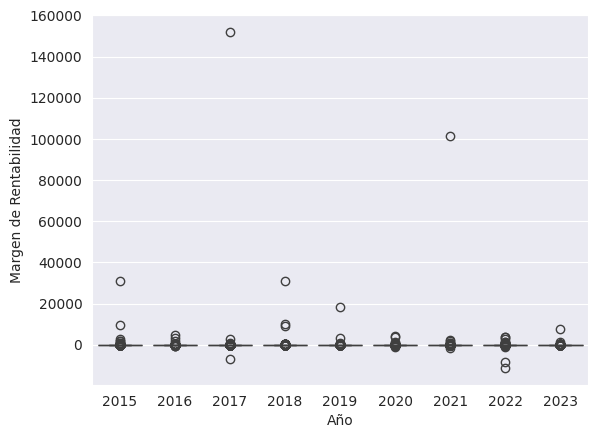

In [ ]:
sns.boxplot(data=df_helper,x='Año',y='Margen de Rentabilidad')

In [ ]:
aux_1=df_helper[df_helper['Numero de años']==9].groupby(['Industria','Año'])['Ingresos'].sum().rename('Total Ingresos').reset_index()
aux_1['Total Ingresos'] = aux_1['Total Ingresos']/1000
aux_1.head()

,Industria,Año,Total Ingresos
0,Aerospace & Defense,2015,167.583
1,Aerospace & Defense,2016,165.215
2,Aerospace & Defense,2017,174.020
3,Aerospace & Defense,2018,182.519
4,Aerospace & Defense,2019,201.871


In [ ]:
companies_group_9_years_in_forbes_by_income=aux_1.groupby(['Industria'])['Total Ingresos'].mean().sort_values(ascending=False).index

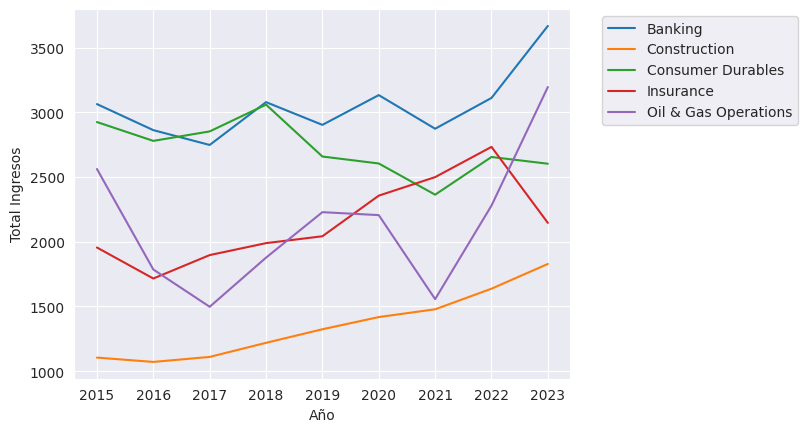

In [ ]:
sns.lineplot(data=aux_1[aux_1.Industria.isin(companies_group_9_years_in_forbes_by_income[:5])],x='Año',y='Total Ingresos',hue='Industria')
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')

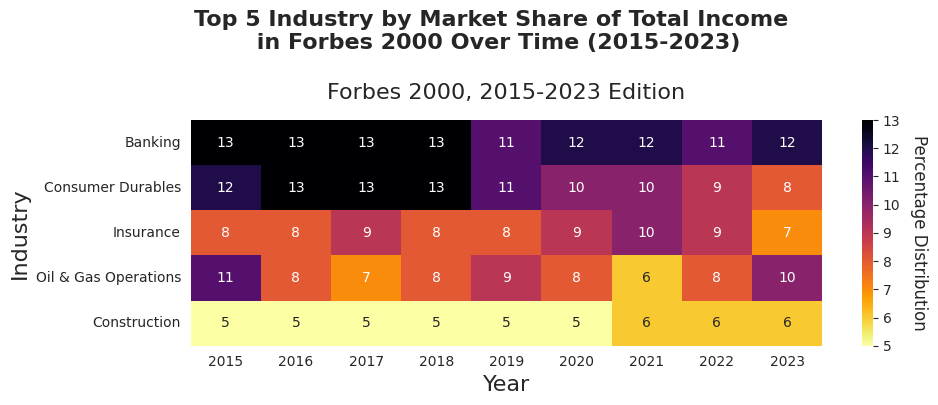

In [ ]:
fig,ax = plt.subplots(figsize=(10,4))

ax= sns.heatmap(pd.crosstab(aux_1['Industria'],
            aux_1['Año'],
            values=aux_1['Total Ingresos'],
            aggfunc='sum',
            normalize='columns').reindex(companies_group_9_years_in_forbes_by_income).head().round(2)*100,cmap="inferno_r",
            annot=True,
            cbar=True)
ax.collections[0].colorbar.set_label('Percentage Distribution', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Industry', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 5 Industry by Market Share of Total Income \n in Forbes 2000 Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.5)

plt.tight_layout()
plt.show()

### 8.5.3 Profit margin by industry

In [ ]:
df_helper.head()

,Rank_nr,Empresa,Industria,Pais,Ingresos,Ganancias,Activos,Valor de Mercado,Margen de Rentabilidad,ROA,Año,Codigo,Continente,Numero de años
0,1,ICBC,Banking,China,166796.0,44757.2,3322043.0,278327.0,26.83,1.35,2015,CHN,Asia,9.0
1,2,China Construction Bank,Banking,China,130473.0,37038.9,2698925.0,212945.0,28.39,1.37,2015,CHN,Asia,9.0
2,3,Agricultural Bank of China,Banking,China,129221.0,29124.5,2574815.0,189879.0,22.54,1.13,2015,CHN,Asia,9.0
3,4,Bank of China,Banking,China,120297.0,27526.8,2458336.0,199130.0,22.88,1.12,2015,CHN,Asia,9.0
4,5,Berkshire Hathaway,Diversified Financials,United States,194673.0,19872.0,534618.0,354813.0,10.21,3.72,2015,USA,North America,9.0


In [ ]:
aux_2=df_helper[df_helper['Numero de años']==9].groupby(['Industria','Año'])['Margen de Rentabilidad'].median().rename('Mediana').reset_index()

aux_2.head()

,Industria,Año,Mediana
0,Aerospace & Defense,2015,7.810
1,Aerospace & Defense,2016,6.625
2,Aerospace & Defense,2017,9.260
3,Aerospace & Defense,2018,9.490
4,Aerospace & Defense,2019,9.390


In [ ]:
aux_2.groupby('Industria')['Mediana'].mean().sort_values(ascending=False).index[:5]

Index(['Semiconductors', 'Diversified Financials', 'Banking',
       'IT Software & Services', 'Drugs & Biotechnology'],
      dtype='object', name='Industria')

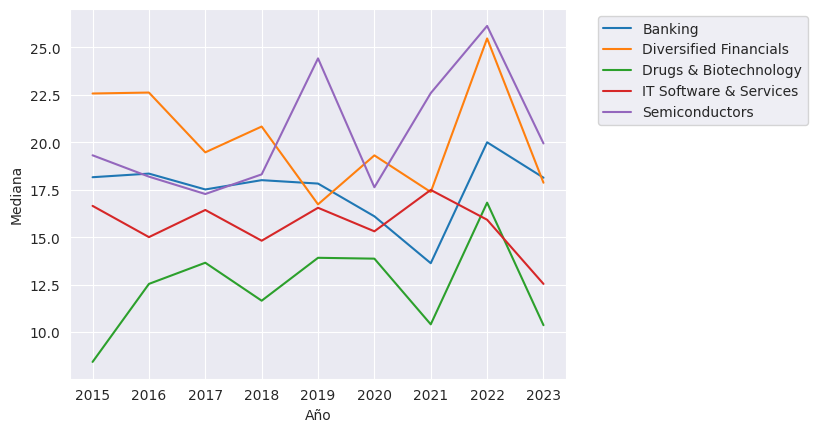

In [ ]:
sns.lineplot(data=aux_2[aux_2.Industria.isin(aux_2.groupby('Industria')['Mediana'].mean().sort_values(ascending=False).index[:5])],x='Año',y='Mediana',hue='Industria')
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')

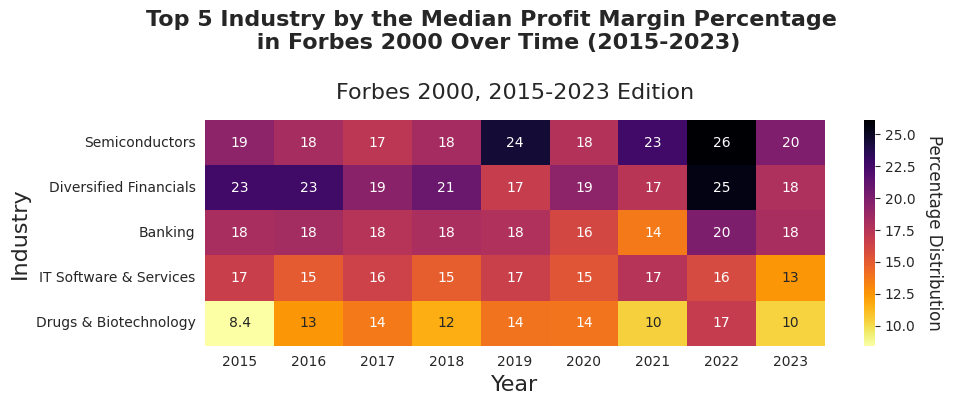

In [ ]:
fig,ax = plt.subplots(figsize=(10,4))

ax= sns.heatmap(pd.crosstab(aux_2.Industria	,
                            aux_2.Año	,
                            values=aux_2.Mediana,
                            aggfunc='mean').reindex(aux_2.groupby('Industria')['Mediana'].mean().sort_values(ascending=False).index).head(),
                cmap="inferno_r",
            annot=True,
            cbar=True)
ax.collections[0].colorbar.set_label('Percentage Distribution', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Industry', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 5 Industry by the Median Profit Margin Percentage \n in Forbes 2000 Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.5)

plt.tight_layout()
plt.show()


## 8.6 By industry - part 2

### 8.6.1 Count by industry

In [ ]:
df_helper.groupby(['Industria'])['Empresa'].nunique().sort_values(ascending=False)

Industria
Banking                             489
Diversified Financials              308
Consumer Durables                   281
Construction                        260
Oil & Gas Operations                224
Materials                           197
Insurance                           174
Business Services & Supplies        172
IT Software & Services              154
Retailing                           148
Utilities                           141
Chemicals                           140
Food, Drink & Tobacco               133
Transportation                      133
Capital Goods                       130
Drugs & Biotechnology               129
Health Care Equipment & Services    103
Technology Hardware & Equipment     102
Telecommunications Services          91
Media                                73
Semiconductors                       66
Trading Companies                    63
Conglomerates                        62
Food Markets                         49
Hotels, Restaurants & Leisure 

In [ ]:
companies_years_in_forbes=df_helper.groupby(['Industria'])['Empresa'].nunique().sort_values(ascending=False).index

In [ ]:
aux_4=df_helper.groupby(['Industria','Año'])['Empresa'].count().rename('Numero de empresas').reset_index()
aux_4.head()

,Industria,Año,Numero de empresas
0,Aerospace & Defense,2015,23
1,Aerospace & Defense,2016,19
2,Aerospace & Defense,2017,22
3,Aerospace & Defense,2018,22
4,Aerospace & Defense,2019,22


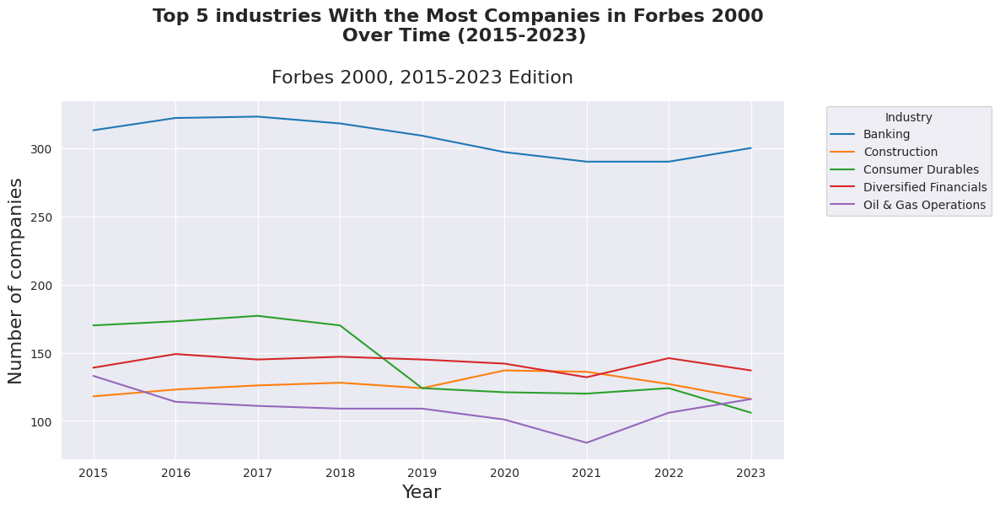

In [ ]:
fig,ax = plt.subplots(figsize=(12,6))
sns.lineplot(data=aux_4[aux_4.Industria.isin(companies_years_in_forbes[:5])],x='Año',y='Numero de empresas',hue='Industria')

plt.legend(title='Industry',bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Number of companies', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 5 industries With the Most Companies in Forbes 2000 \n Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

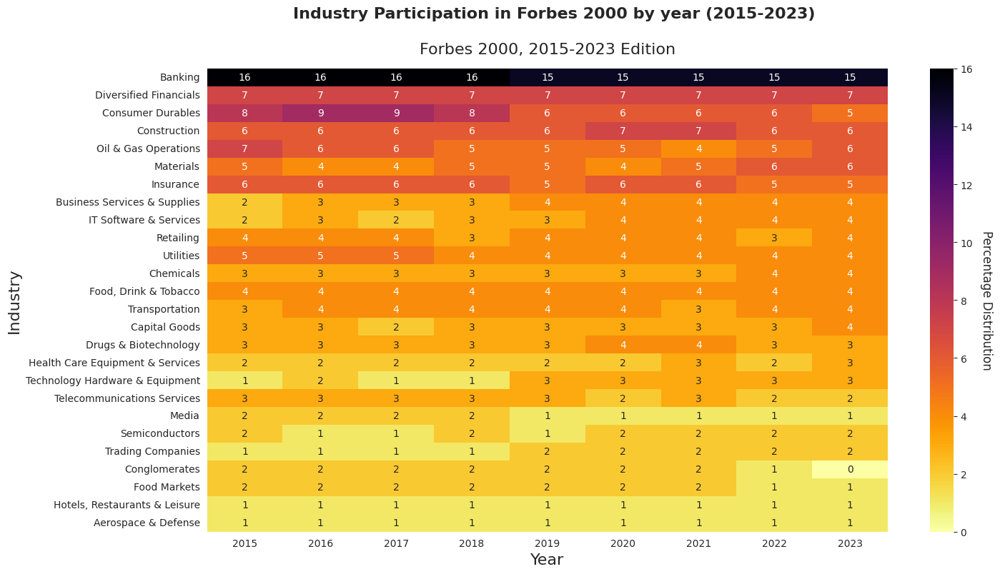

In [ ]:
fig,ax = plt.subplots(figsize=(15,8))

ax= sns.heatmap(pd.crosstab(aux_4['Industria'],
            aux_4['Año'],
            values=aux_4['Numero de empresas'],
            aggfunc='sum',
            normalize='columns').reindex(companies_years_in_forbes).round(2)*100,cmap="inferno_r",
            annot=True,
            cbar=True)

ax.collections[0].colorbar.set_label('Percentage Distribution', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Industry', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Industry Participation in Forbes 2000 by year (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.52)

plt.tight_layout()
plt.show()

### 8.6.2 Income by industry

In [ ]:
aux_5=df_helper.groupby(['Industria','Año'])['Ingresos'].sum().rename('Total Ingresos').reset_index()
aux_5['Total Ingresos'] = aux_5['Total Ingresos']/1000
aux_5.head()

,Industria,Año,Total Ingresos
0,Aerospace & Defense,2015,491.920
1,Aerospace & Defense,2016,448.898
2,Aerospace & Defense,2017,467.695
3,Aerospace & Defense,2018,488.686
4,Aerospace & Defense,2019,515.417


In [ ]:
companies_years_in_forbes_by_income=aux_5.groupby(['Industria'])['Total Ingresos'].mean().sort_values(ascending=False).index

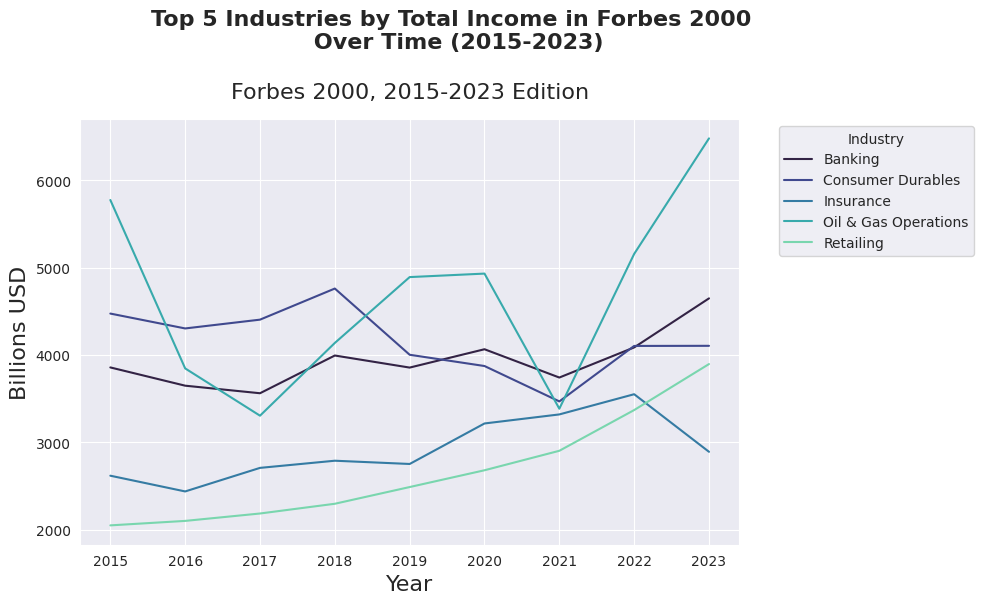

In [ ]:
fig,ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=aux_5[aux_5.Industria.isin(companies_years_in_forbes_by_income[:5])],x='Año',y='Total Ingresos',hue='Industria',palette='mako')

plt.legend(title='Industry',bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Billions USD', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 5 Industries by Total Income in Forbes 2000 \n Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

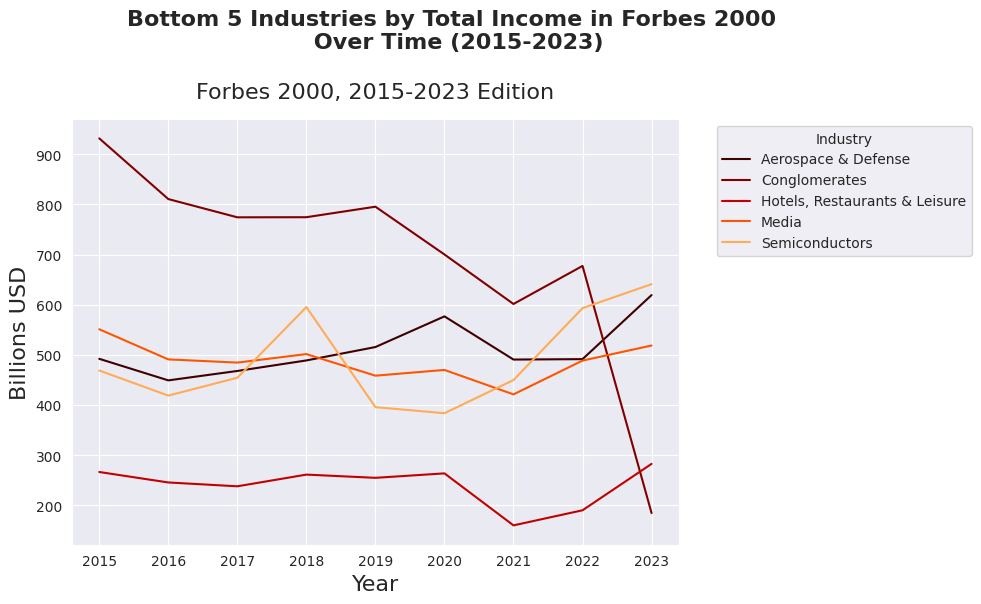

In [ ]:
fig,ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=aux_5[aux_5.Industria.isin(companies_years_in_forbes_by_income[-5:])],x='Año',y='Total Ingresos',hue='Industria',palette='gist_heat')
plt.legend(title='Industry',bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Billions USD', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Bottom 5 Industries by Total Income in Forbes 2000 \n Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

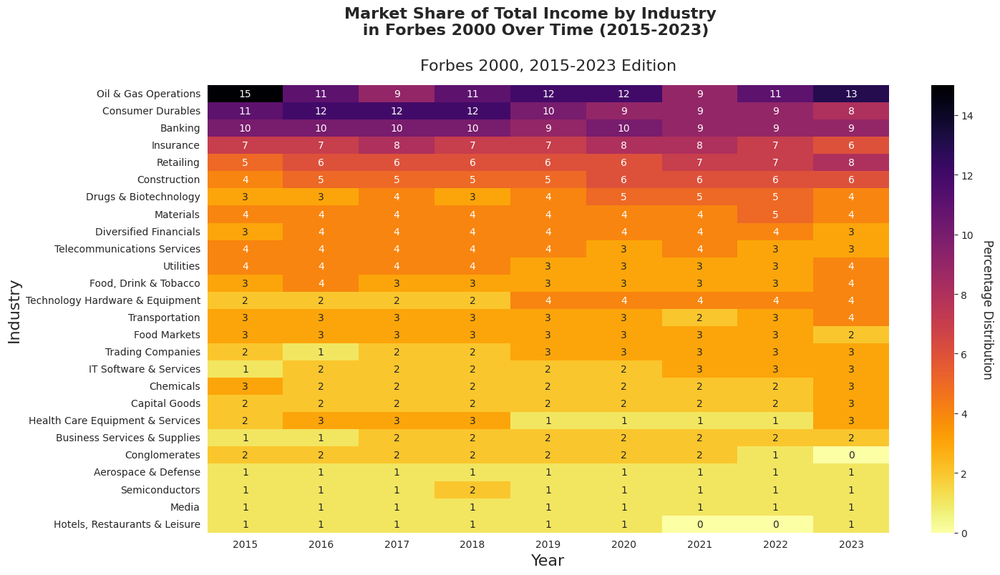

In [ ]:
fig,ax = plt.subplots(figsize=(15,8))

ax= sns.heatmap(pd.crosstab(aux_5['Industria'],
            aux_5['Año'],
            values=aux_5['Total Ingresos'],
            aggfunc='sum',
            normalize='columns').reindex(companies_years_in_forbes_by_income).round(2)*100,cmap="inferno_r",
            annot=True,
            cbar=True)

ax.collections[0].colorbar.set_label('Percentage Distribution', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Industry', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Market Share of Total Income by Industry \n in Forbes 2000 Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.5)

plt.tight_layout()
plt.show()

### 8.6.3 profit margin by industry

In [ ]:
aux_6=df_helper.groupby(['Industria','Año'])['Margen de Rentabilidad'].median().rename('Mediana').reset_index()

aux_6.head()

,Industria,Año,Mediana
0,Aerospace & Defense,2015,5.550
1,Aerospace & Defense,2016,5.470
2,Aerospace & Defense,2017,7.080
3,Aerospace & Defense,2018,6.875
4,Aerospace & Defense,2019,8.035


In [ ]:
aux_6.groupby('Industria')['Mediana'].mean().sort_values(ascending=False).index

Index(['Diversified Financials', 'Semiconductors', 'Banking',
       'Drugs & Biotechnology', 'IT Software & Services',
       'Health Care Equipment & Services', 'Hotels, Restaurants & Leisure',
       'Business Services & Supplies', 'Media', 'Utilities', 'Chemicals',
       'Food, Drink & Tobacco', 'Telecommunications Services', 'Conglomerates',
       'Construction', 'Capital Goods', 'Materials', 'Consumer Durables',
       'Aerospace & Defense', 'Transportation', 'Insurance',
       'Technology Hardware & Equipment', 'Oil & Gas Operations', 'Retailing',
       'Food Markets', 'Trading Companies'],
      dtype='object', name='Industria')

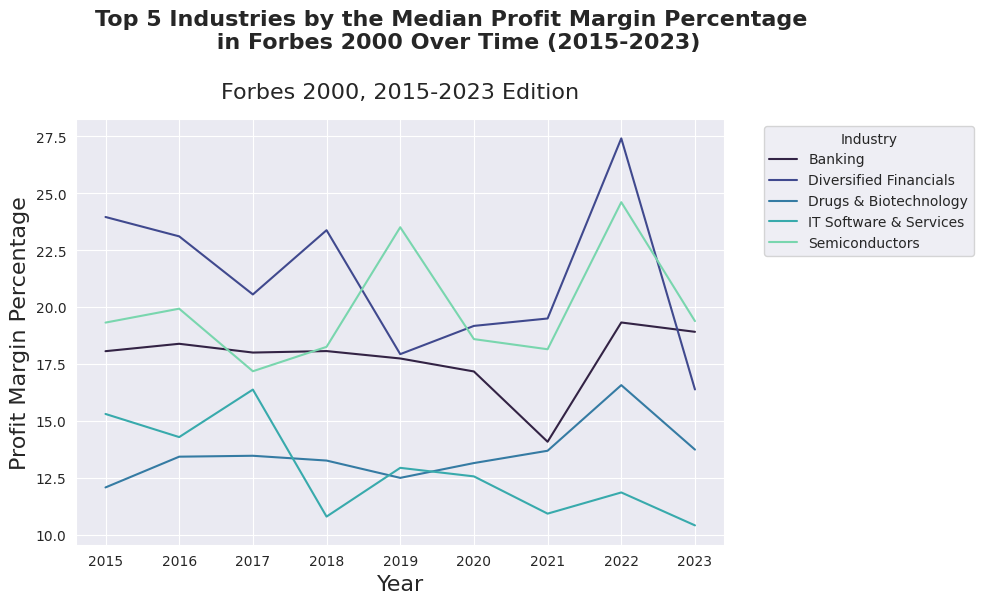

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=aux_6[aux_6.Industria.isin(aux_6.groupby('Industria')['Mediana'].mean().sort_values(ascending=False).index[:5])],x='Año',y='Mediana',hue='Industria', palette='mako')

plt.legend(title='Industry',bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Profit Margin Percentage', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Top 5 Industries by the Median Profit Margin Percentage \n in Forbes 2000 Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

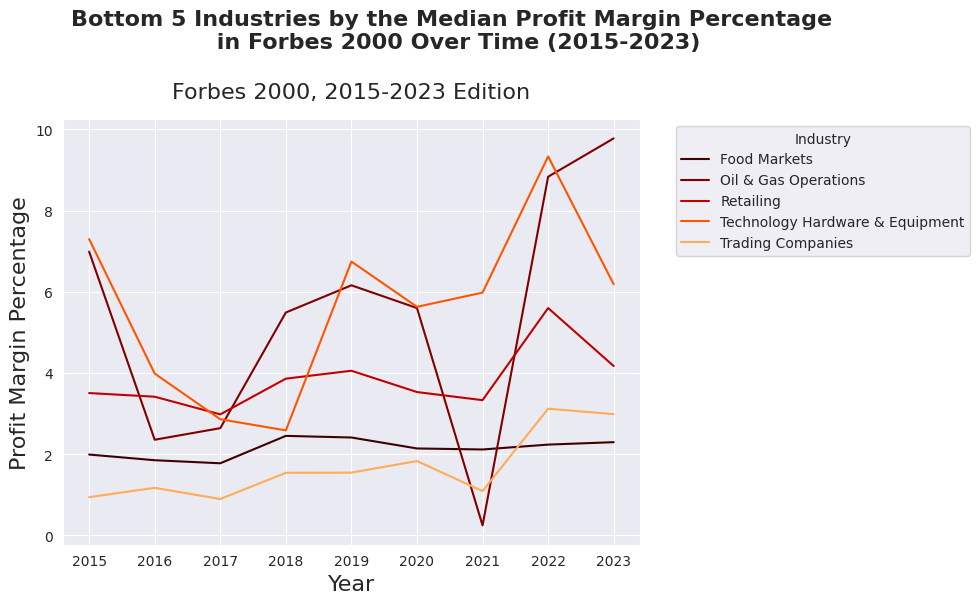

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=aux_6[aux_6.Industria.isin(aux_6.groupby('Industria')['Mediana'].mean().sort_values(ascending=False).index[-5:])],x='Año',y='Mediana',hue='Industria', palette='gist_heat')

plt.legend(title='Industry',bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Year', fontsize=16)
plt.ylabel('Profit Margin Percentage', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Bottom 5 Industries by the Median Profit Margin Percentage \n in Forbes 2000 Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.46)

plt.tight_layout()
plt.show()

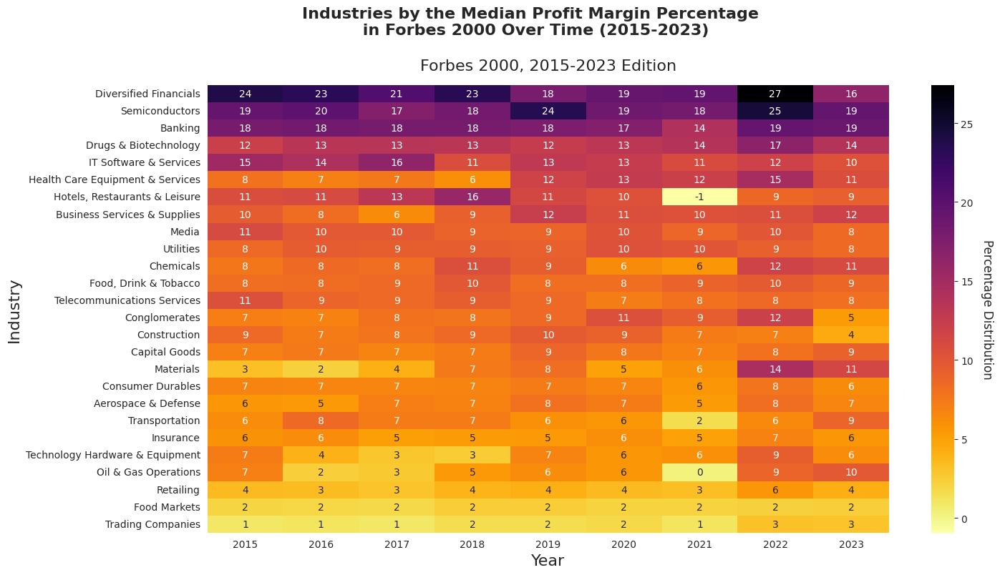

In [ ]:
fig,ax = plt.subplots(figsize=(15,8))

ax= sns.heatmap(pd.crosstab(aux_6.Industria	,
                            aux_6.Año	,
                            values=aux_6.Mediana,
                            aggfunc='mean').reindex(aux_6.groupby('Industria')['Mediana'].mean().sort_values(ascending=False).index),
                cmap="inferno_r",
            annot=True,
            cbar=True,
                fmt='.0f' )
ax.collections[0].colorbar.set_label('Percentage Distribution', labelpad=20, fontsize=12, rotation=270)
plt.xlabel('Year', fontsize=16)
plt.ylabel('Industry', fontsize=16)
plt.title('Forbes 2000, 2015-2023 Edition', pad=15, fontsize=16)
plt.suptitle("Industries by the Median Profit Margin Percentage \n in Forbes 2000 Over Time (2015-2023)", fontsize=16, fontweight='bold', y=1,x=0.5)

plt.tight_layout()
plt.show()